In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import seaborn as sns
import plotly.express as px
import xarray as xr
from pandas.plotting import scatter_matrix
from mpl_toolkits.mplot3d import Axes3D
import os
from matplotlib.colors import TwoSlopeNorm
from matplotlib.colors import Normalize
import xgboost as xgb
from sklearn.linear_model import LinearRegression
import shap
from sklearn.ensemble import RandomForestRegressor
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import itertools
import cftime
import re
import imageio
from skimage.transform import resize

C:\Users\benra\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated and will be removed in a future release
  "class": algorithms.Blowfish,


In [2]:
# Cell 2: Data Loading and Preparation 
netcdf_dir = r"C:\Users\benra\lithk_exp05"
netcdf_files = [os.path.join(netcdf_dir, f) for f in os.listdir(netcdf_dir) if f.endswith('.nc')]

deltas = []
participating_models = []
var_list = []

exp_id = 'exp05'  # Next few lines need to be changed for different datasets
var_name = 'lithk'

n_components = 4
n_clusters = 5  # Change this for expc02 (most likely other tiered experiments too)

# Define the standardization function
def standardize_model_name(model_name_from_netcdf):
    """
    Transforms a model name from the NetCDF derived format
    to match the 'Model ID' format in the characteristics CSV.
    """
    # Specific rules for ILTS_PIK_SICOPOLIS models
    if model_name_from_netcdf == 'ILTS_PIK_SICOPOLIS1':
        return 'ILTSPIK- SICOPOLIS1'
    elif model_name_from_netcdf == 'ILTS_PIK_SICOPOLIS2':
        return 'ILTSPIK- SICOPOLIS2'
    
    # General rule: for all other models, replace underscores with dashes
    return model_name_from_netcdf.replace('_', '-')

print("--- Starting Model Name Extraction and Standardization ---")
print(f"Checking directory: {netcdf_dir}")
print(f"Found {len(netcdf_files)} .nc files.")

# This loop iterates through EACH AND EVERY NetCDF file found
for i, file_path in enumerate(netcdf_files):
    print(f"\nProcessing file {i+1}/{len(netcdf_files)}: {os.path.basename(file_path)}")
    
    base_filename = os.path.basename(file_path)
    
    # --- Step 1: Extract the raw model name from the filename ---
    # This part gets the name like 'ILTS_PIK_SICOPOLIS2' or 'IMAU_IMAUICE1'
    model_id_raw = base_filename.replace('.nc', '')
    model_id_raw = model_id_raw.replace(f'{var_name}_GIS_', '')
    
    if model_id_raw.endswith('_exp05'):                                # Need to change this line for each experiment
        model_id_raw = model_id_raw.replace('_exp05', '')
    
    # Use regex to remove trailing '_<digits>' (like '_05')
    # This targets an underscore followed by one or more digits at the end of the string.
    model_id_raw = re.sub(r'_\d+$', '', model_id_raw)
        
    print(f"  Raw model name extracted (from NetCDF filename): '{model_id_raw}'")

    # --- Step 2: Call the standardization function for THIS specific raw model name ---
    # This line passes the 'model_id_raw' from the current file to the function.
    # The function then returns the standardized name.
    standardized_model_id = standardize_model_name(model_id_raw)
    
    print(f"  Standardized model name (for matching CSV): '{standardized_model_id}'")
    
    # --- Step 3: Add the standardized name to your list ---
    # This list will be used in Cell 6.
    participating_models.append(standardized_model_id)

    # --- Data loading (your existing xarray code) ---
    try:
        ds = xr.open_dataset(file_path, decode_times=False)
        var_dataarray = ds[f'{var_name}'] # Get the variable DataArray
        var_list.append(var_dataarray) # Add it to var_list
        ds.close() # Close the dataset to free up memory
    except Exception as e:
        print(f"  Error loading or processing NetCDF file '{base_filename}': {e}")
        # Consider adding a placeholder to var_list if a file fails,
        # or removing the corresponding model from participating_models,
        # to keep lists aligned. For now, it will just skip.

print("\n--- Finished Model Name Extraction and Standardization ---")
print(f"Total NetCDF files processed: {len(netcdf_files)}")
print(f"Final count of participating models in the list: {len(participating_models)}")
print("List of standardized participating models (ready for Cell 6):")
print(participating_models)

print(f"Total data arrays loaded into var_list: {len(var_list)}")

print("\nFinished initial data loading. Proceed to the next cell for PCA and plotting.")

--- Starting Model Name Extraction and Standardization ---
Checking directory: C:\Users\benra\lithk_exp05
Found 20 .nc files.

Processing file 1/20: lithk_GIS_AWI_ISSM1_exp05.nc
  Raw model name extracted (from NetCDF filename): 'AWI_ISSM1'
  Standardized model name (for matching CSV): 'AWI-ISSM1'

Processing file 2/20: lithk_GIS_AWI_ISSM2_exp05.nc
  Raw model name extracted (from NetCDF filename): 'AWI_ISSM2'
  Standardized model name (for matching CSV): 'AWI-ISSM2'

Processing file 3/20: lithk_GIS_AWI_ISSM3_exp05.nc
  Raw model name extracted (from NetCDF filename): 'AWI_ISSM3'
  Standardized model name (for matching CSV): 'AWI-ISSM3'

Processing file 4/20: lithk_GIS_BGC_BISICLES_exp05.nc
  Raw model name extracted (from NetCDF filename): 'BGC_BISICLES'
  Standardized model name (for matching CSV): 'BGC-BISICLES'

Processing file 5/20: lithk_GIS_GSFC_ISSM_exp05.nc
  Raw model name extracted (from NetCDF filename): 'GSFC_ISSM'
  Standardized model name (for matching CSV): 'GSFC-ISSM'


In [3]:
# Define time windows (decades as suggested)
time_windows = { 
    '2015-2025': (0, 10),   # indices for 2015-2025
    '2015-2035': (0, 20),   # indices for 2015-2035  
    '2015-2045': (0, 30),   # indices for 2015-2045
    '2015-2055': (0, 40),   # indices for 2015-2055
    '2015-2065': (0, 50),   # indices for 2015-2065
    '2015-2075': (0, 60),   # indices for 2015-2075
    '2015-2085': (0, 70),   # indices for 2015-2085
    '2015-2100': (0, 85)    # full time series
}


 Processing: 2015-2025...


C:\Users\benra\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\benra\AppData\Local\Temp\ipykernel_5940\2842842716.py:91: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cluster_colors = [cm.get_cmap('Set1')(i) for i in range(n_clusters)]


K-Means cluster results saved to: Research_Plots\exp05_lithk_plots\2015-2025\lithk_exp05_KMeans_Clusters_2015-2025.csv


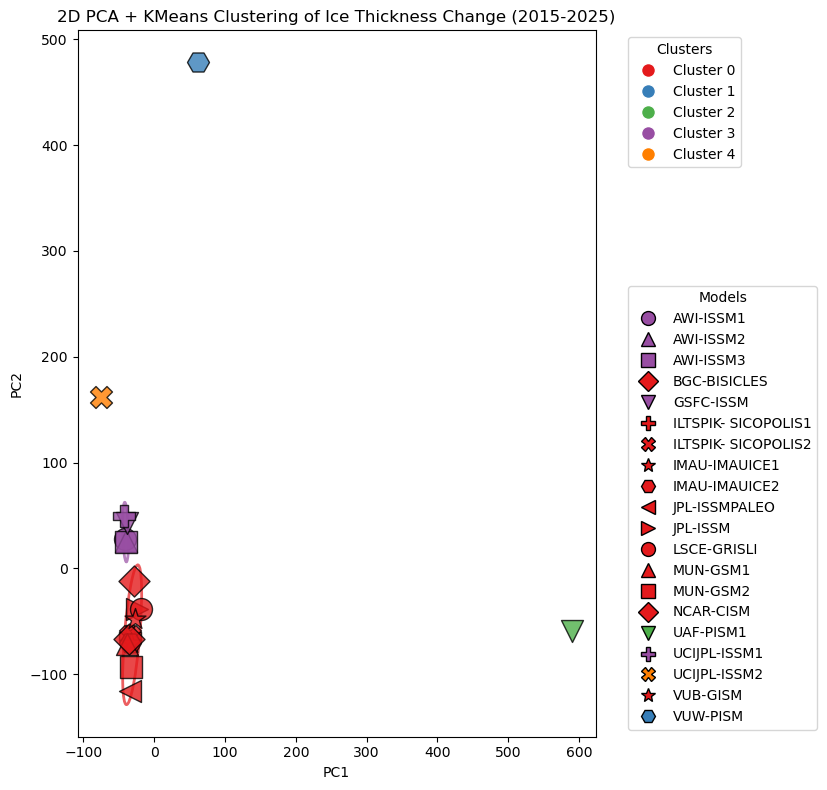

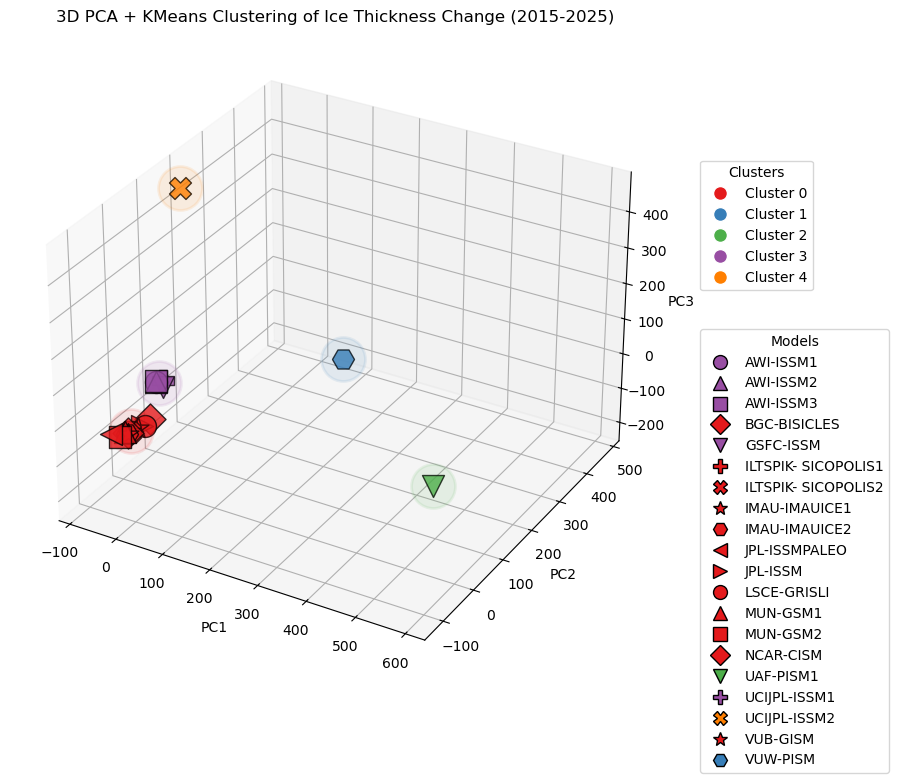

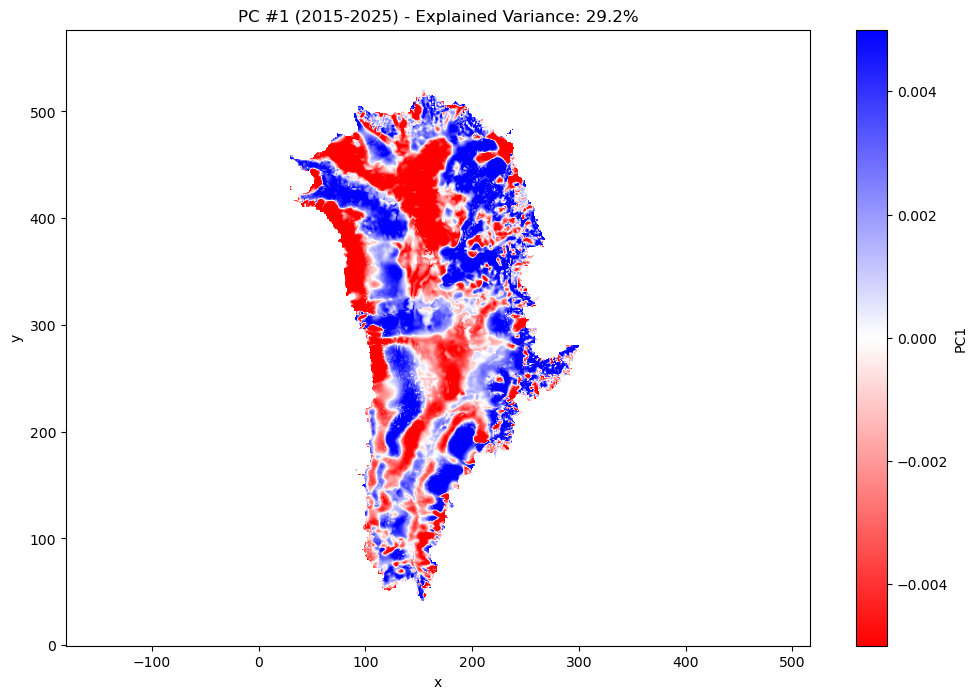

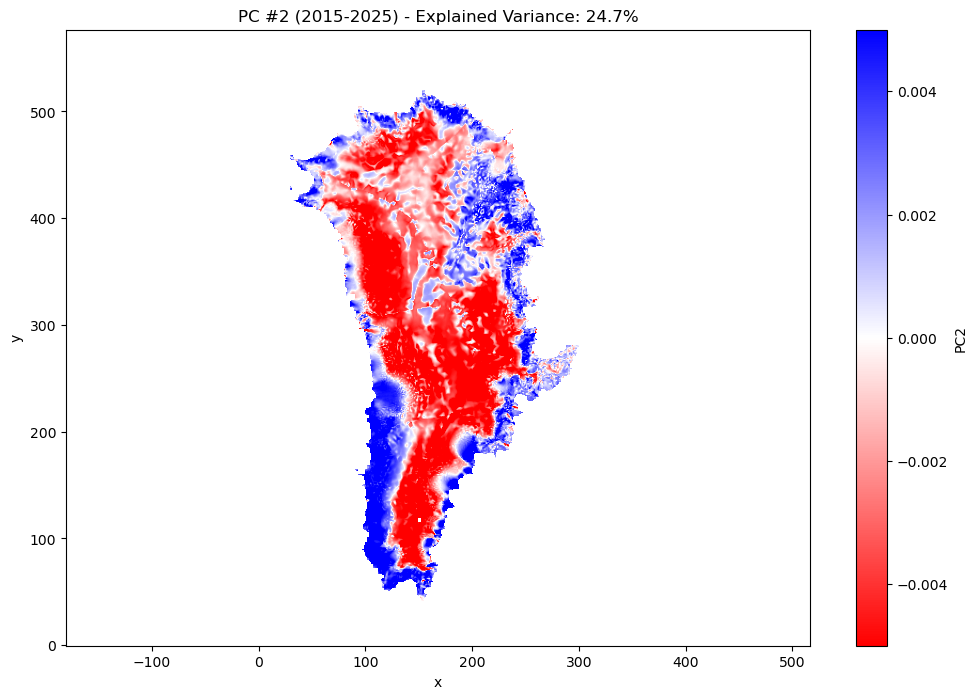

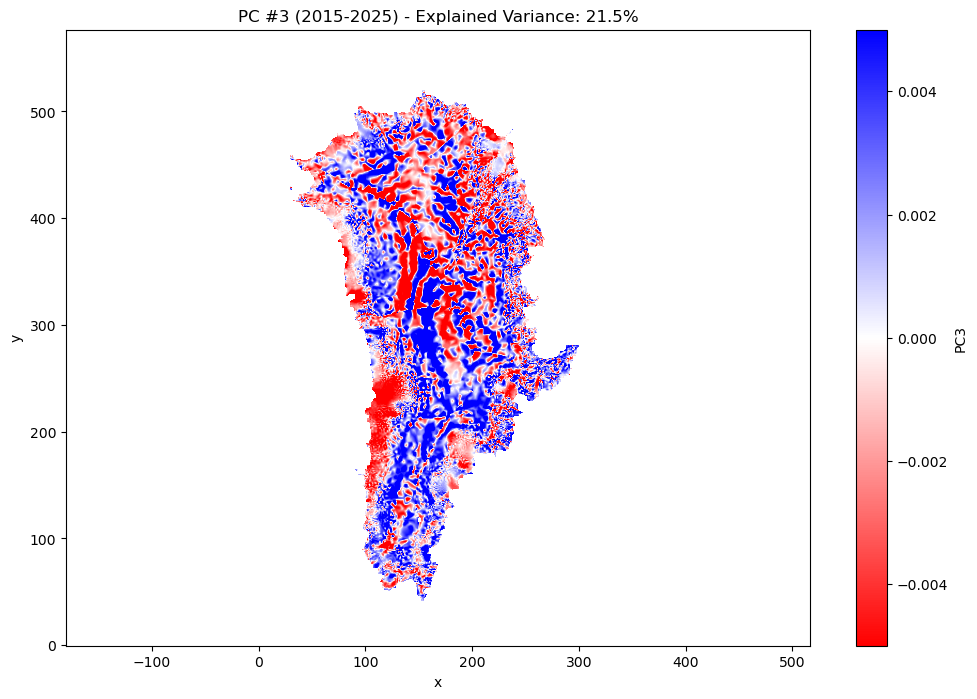

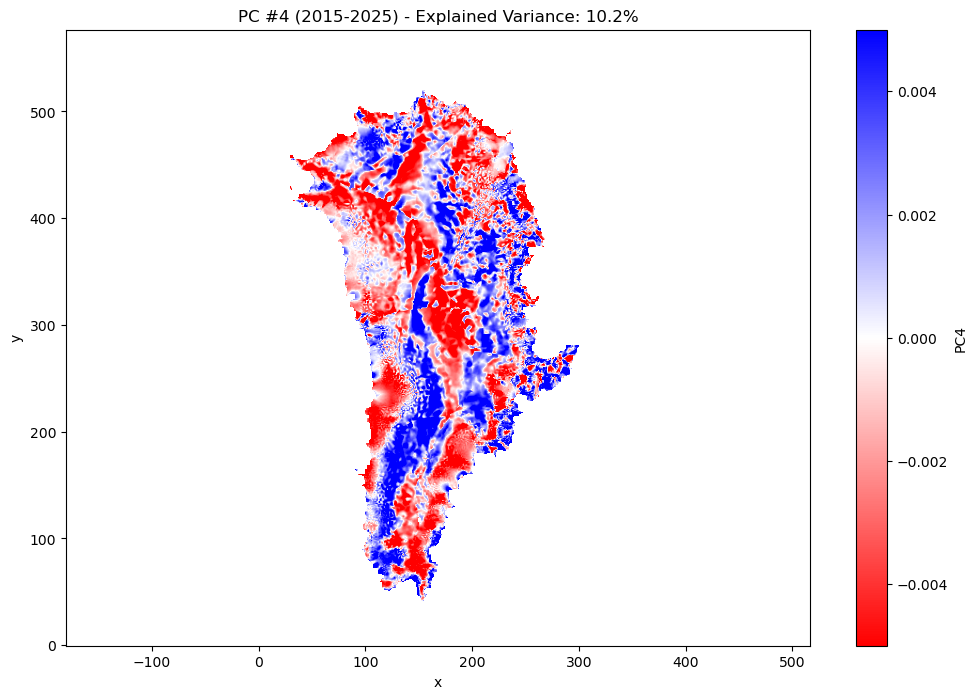

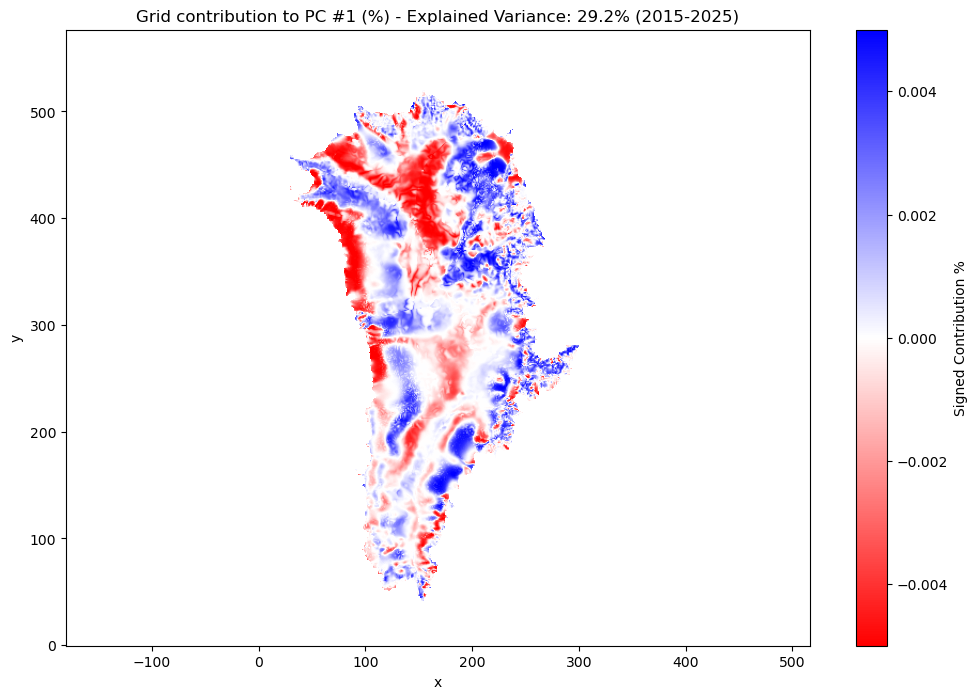

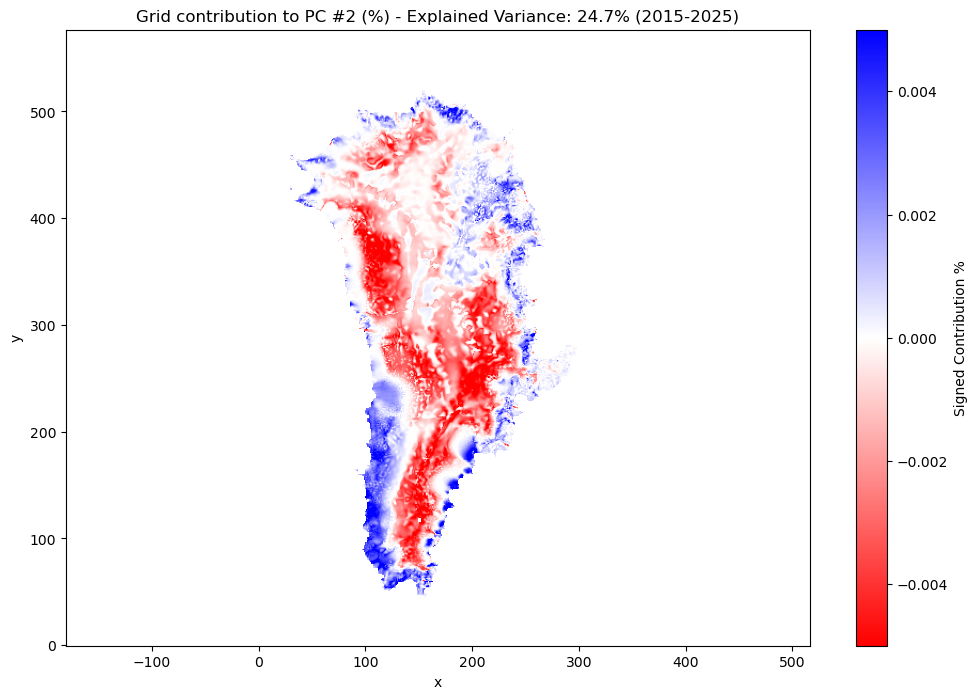

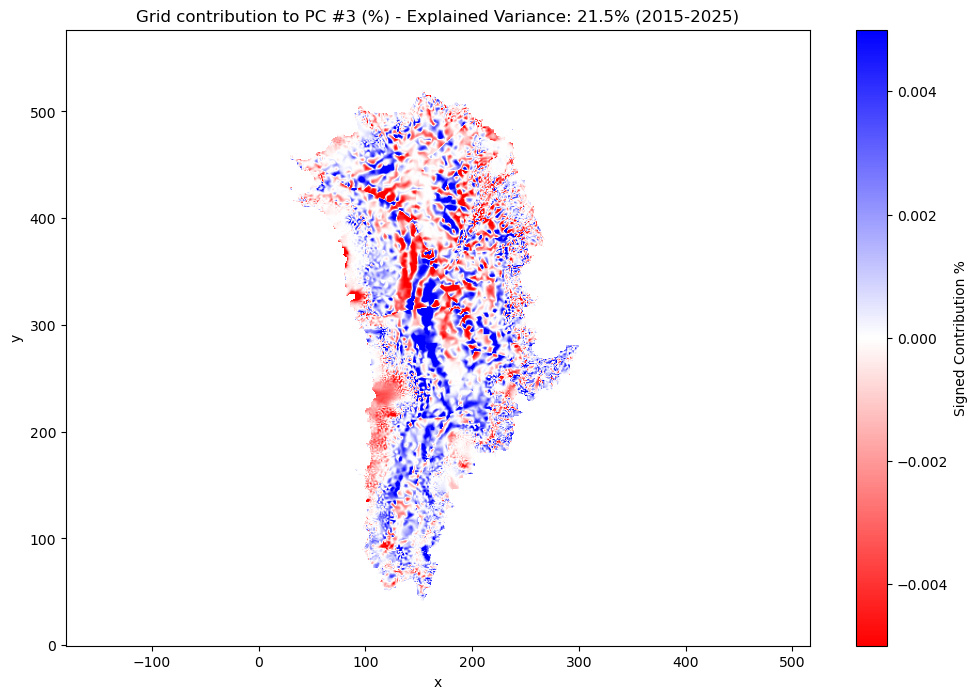

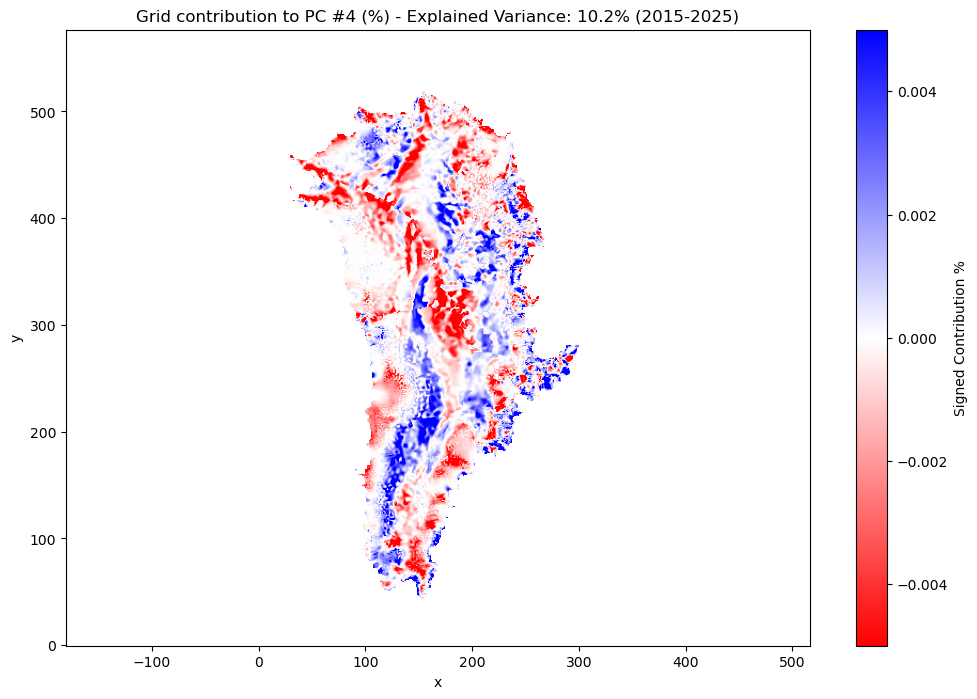


 Generating Sum of PC Vectors plot for 2015-2025...


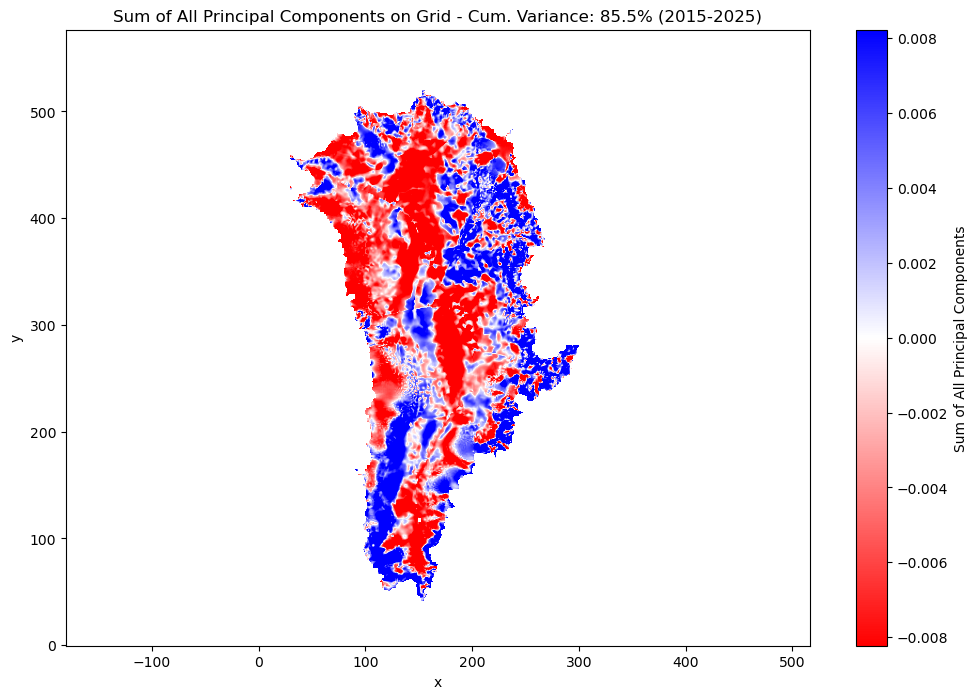


 Processing: 2015-2035...


C:\Users\benra\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\benra\AppData\Local\Temp\ipykernel_5940\2842842716.py:91: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cluster_colors = [cm.get_cmap('Set1')(i) for i in range(n_clusters)]


K-Means cluster results saved to: Research_Plots\exp05_lithk_plots\2015-2035\lithk_exp05_KMeans_Clusters_2015-2035.csv


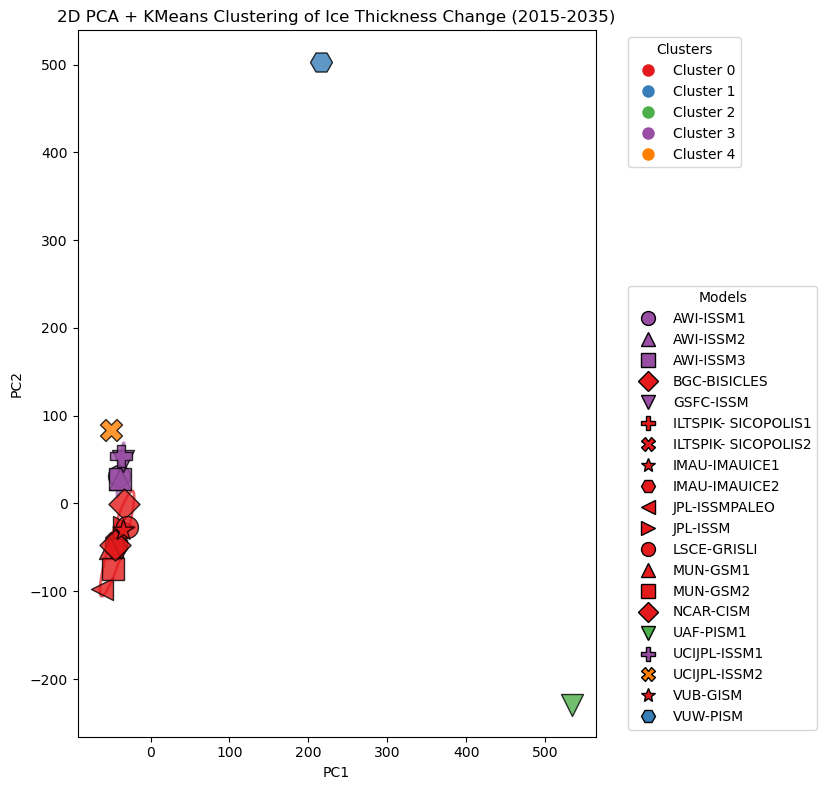

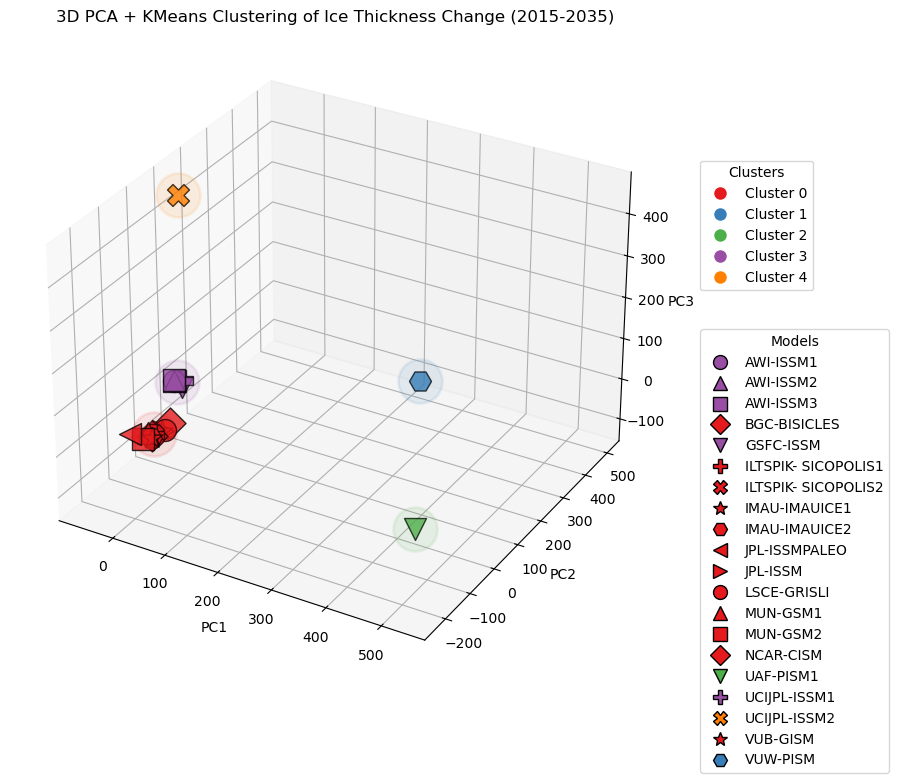

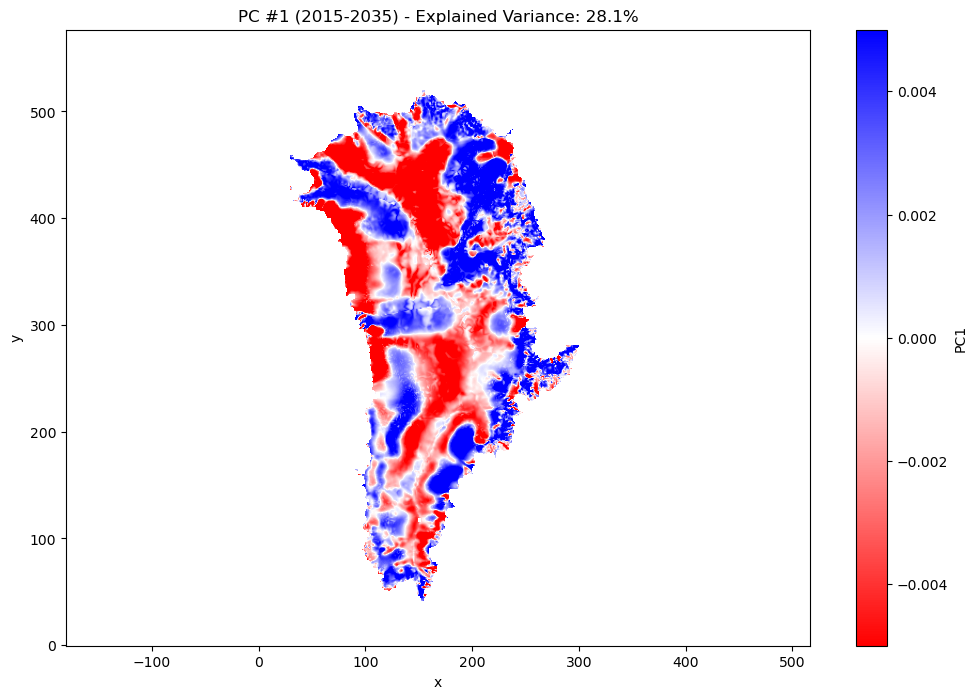

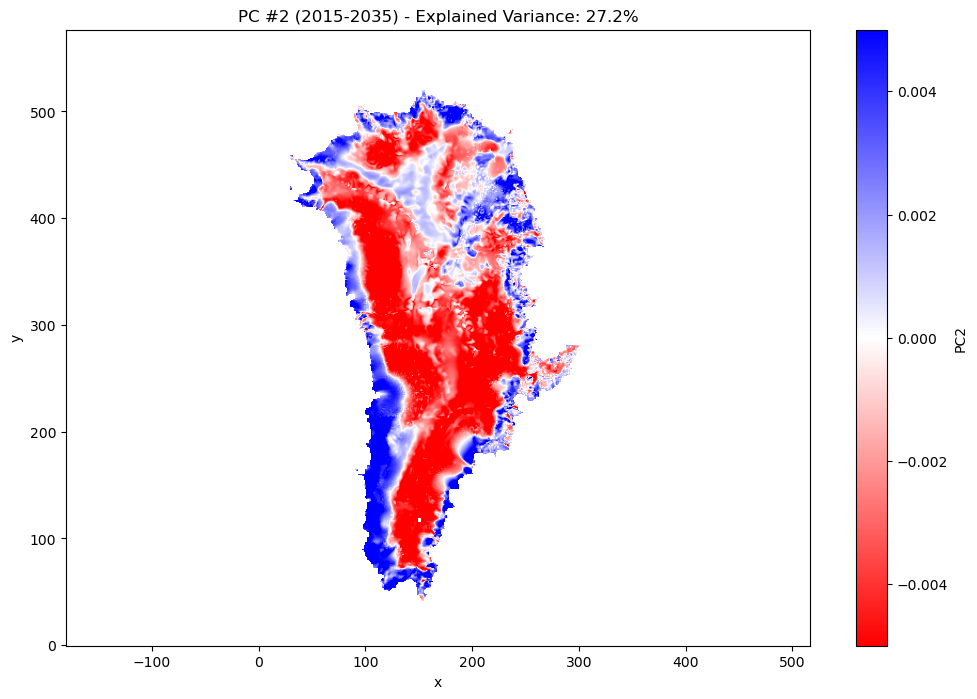

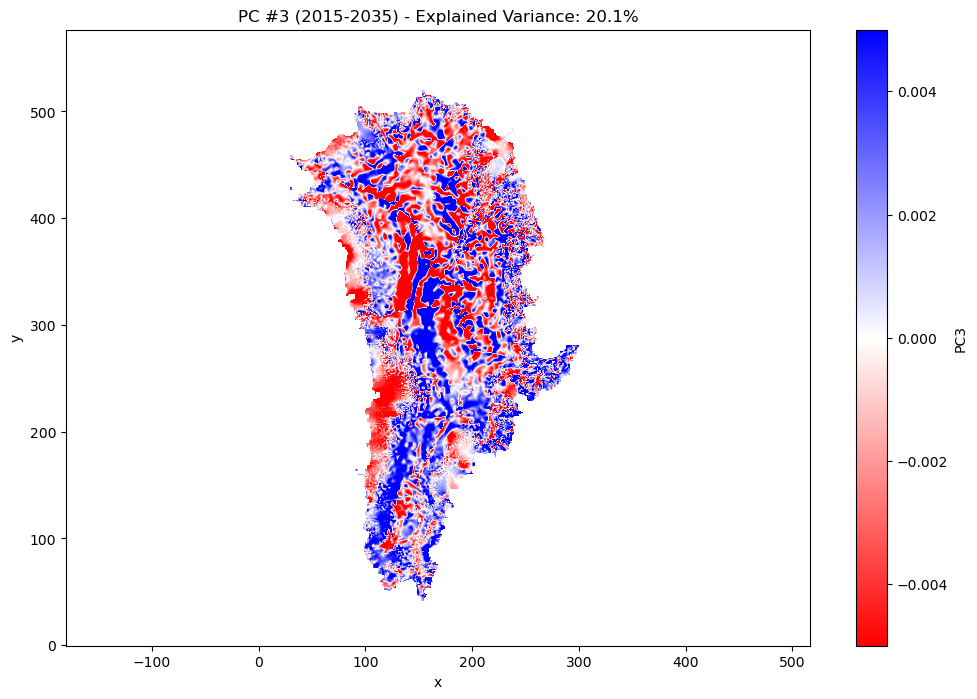

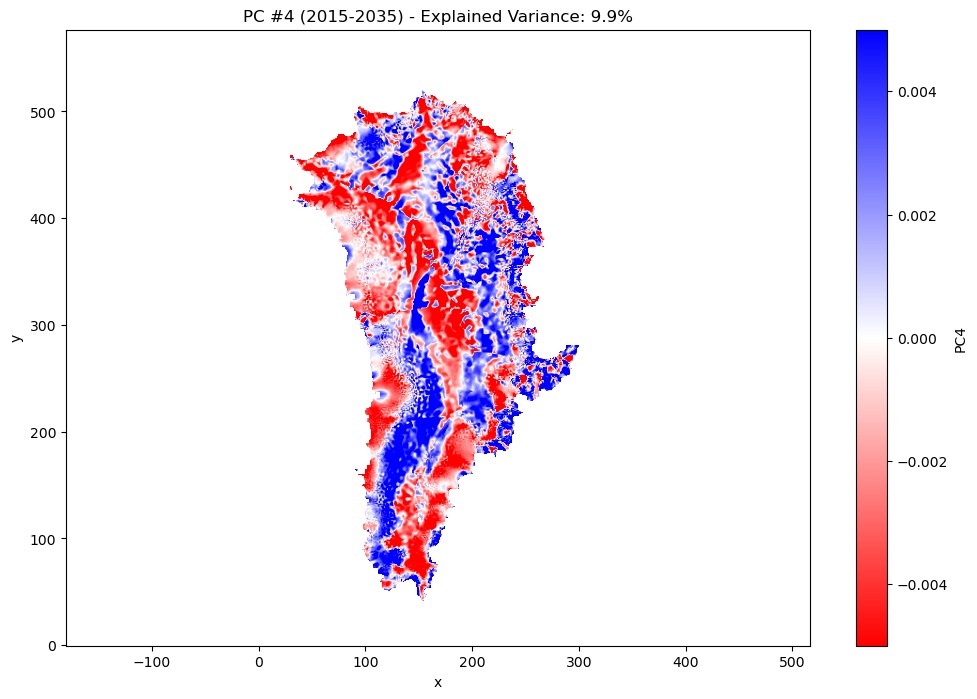

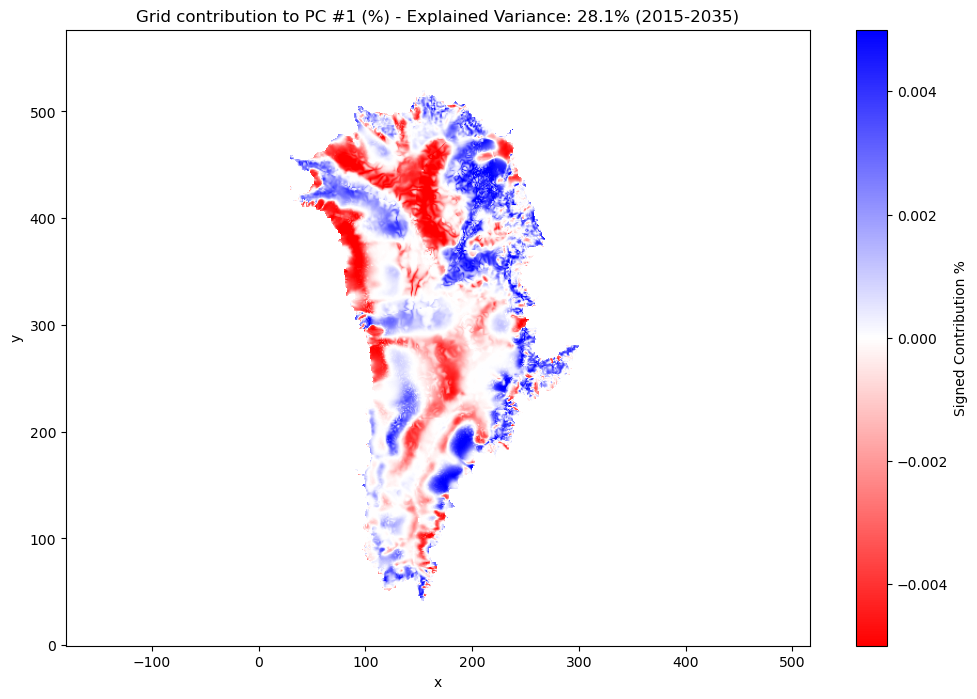

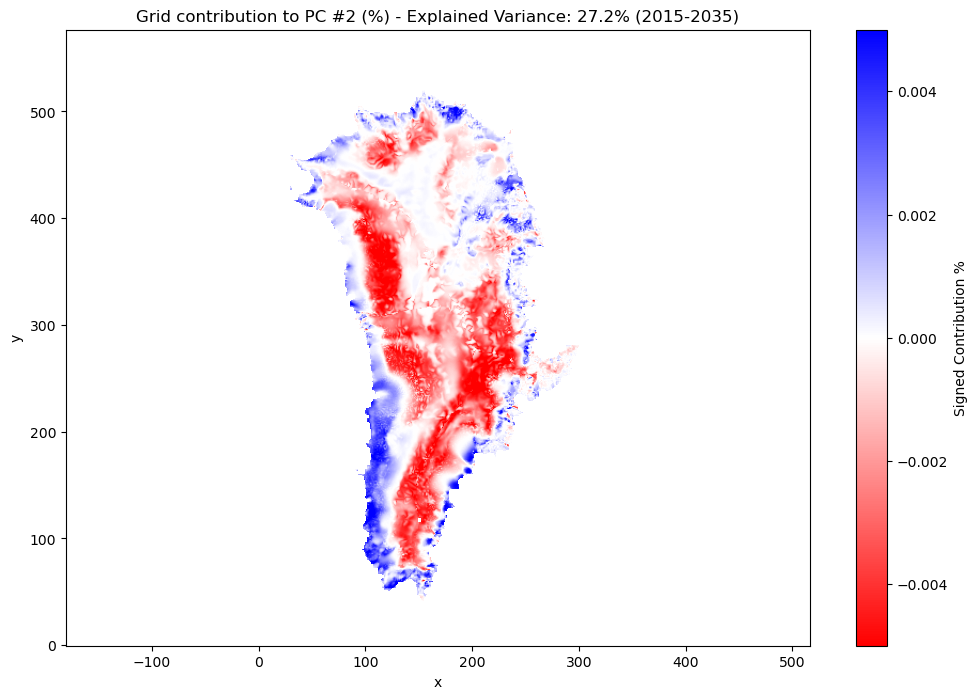

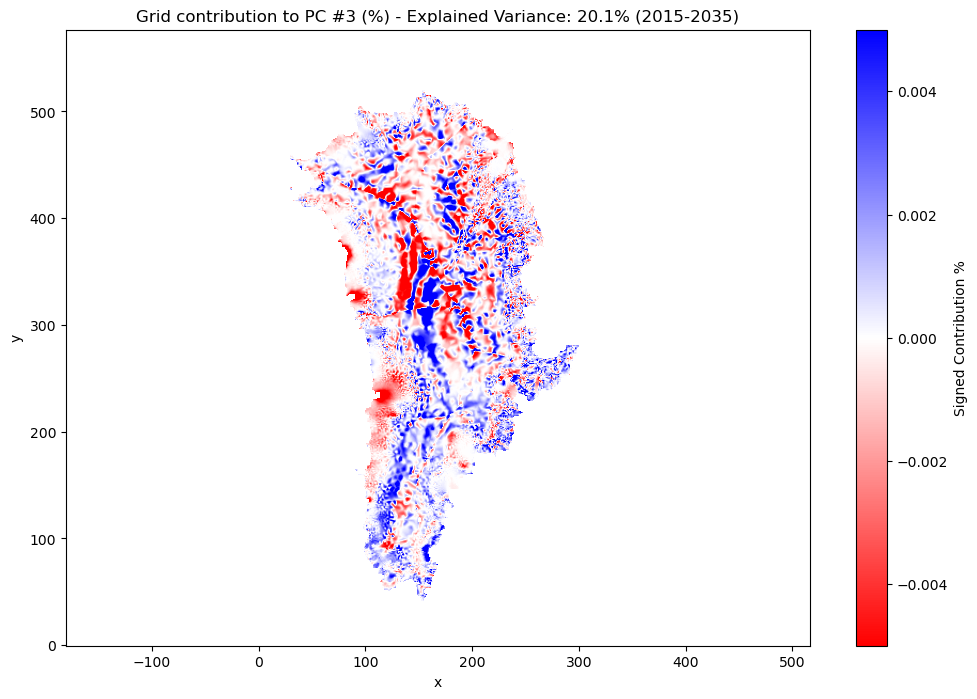

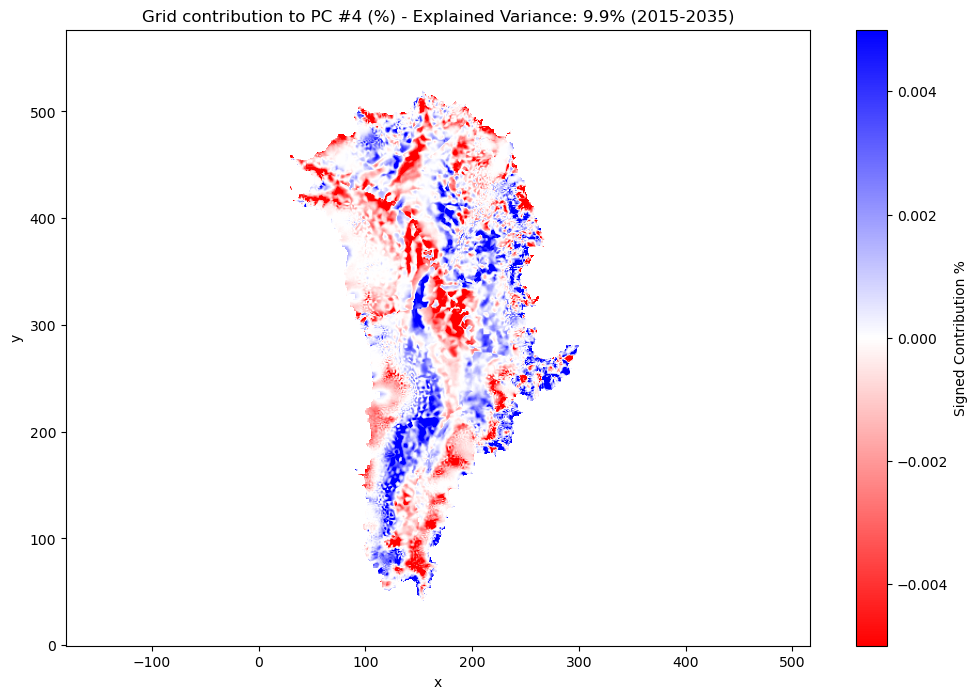


 Generating Sum of PC Vectors plot for 2015-2035...


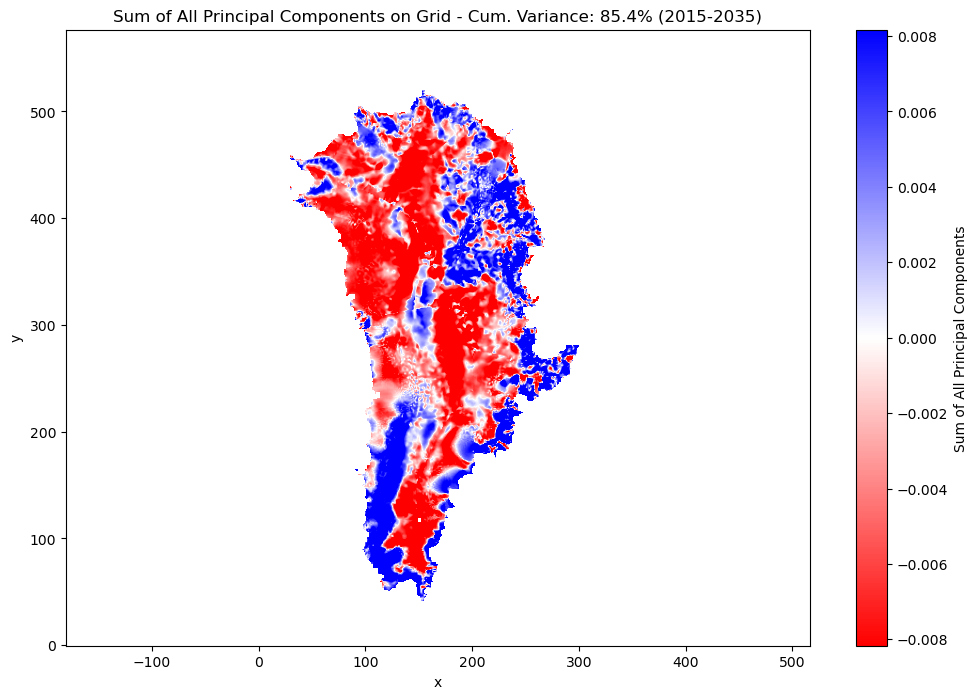


 Processing: 2015-2045...


C:\Users\benra\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\benra\AppData\Local\Temp\ipykernel_5940\2842842716.py:91: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cluster_colors = [cm.get_cmap('Set1')(i) for i in range(n_clusters)]


K-Means cluster results saved to: Research_Plots\exp05_lithk_plots\2015-2045\lithk_exp05_KMeans_Clusters_2015-2045.csv


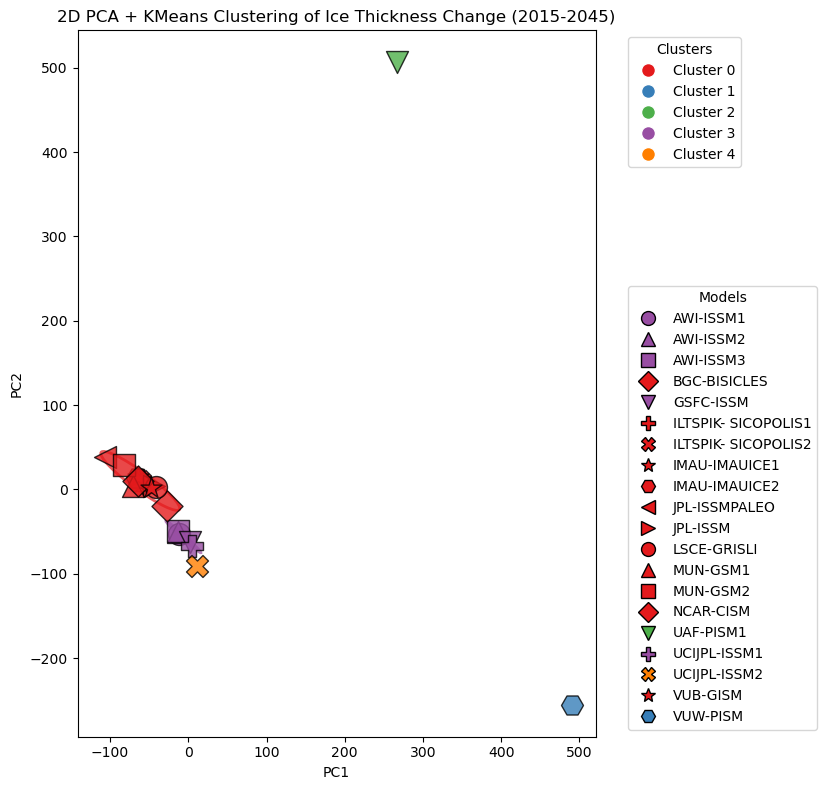

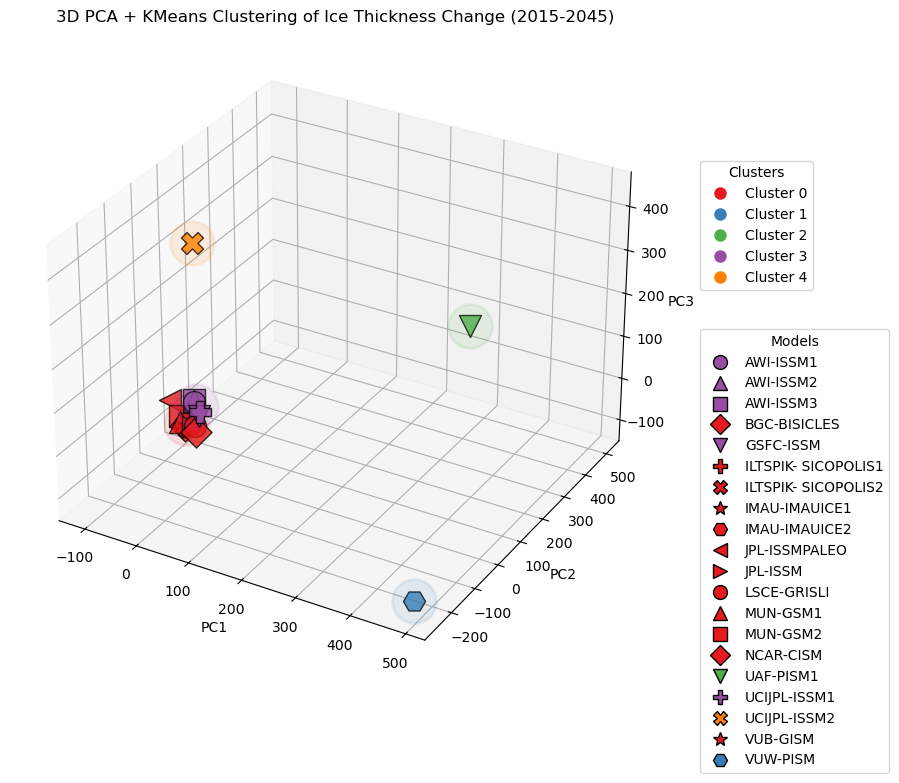

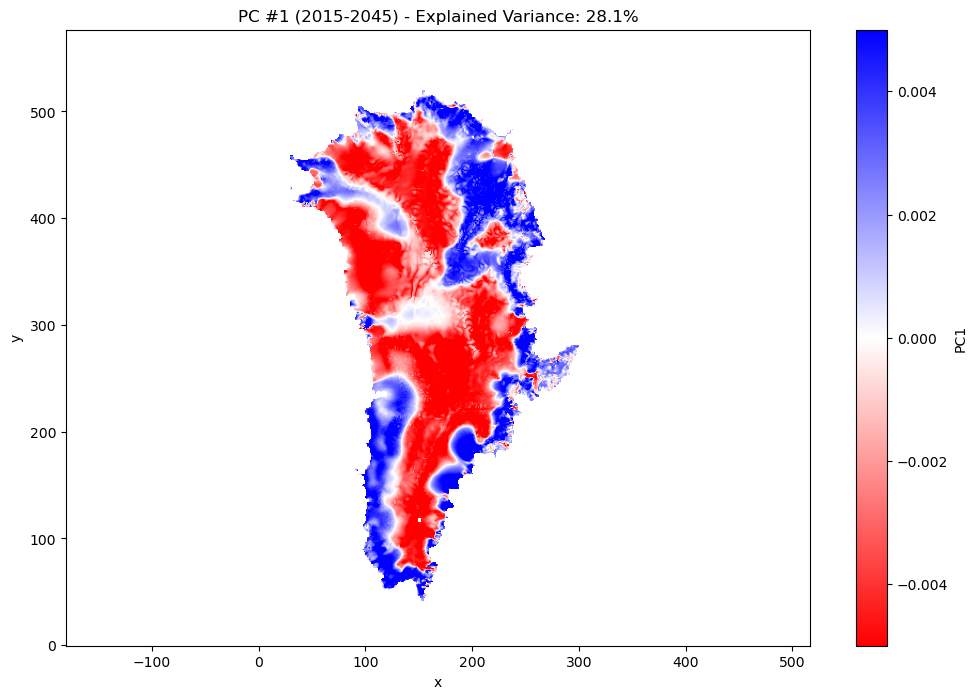

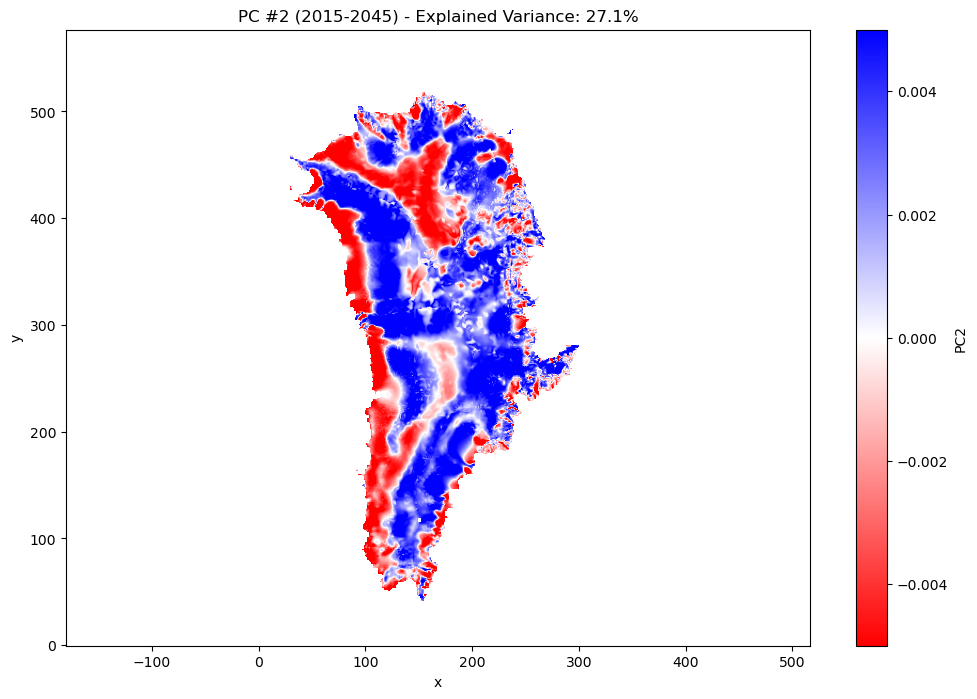

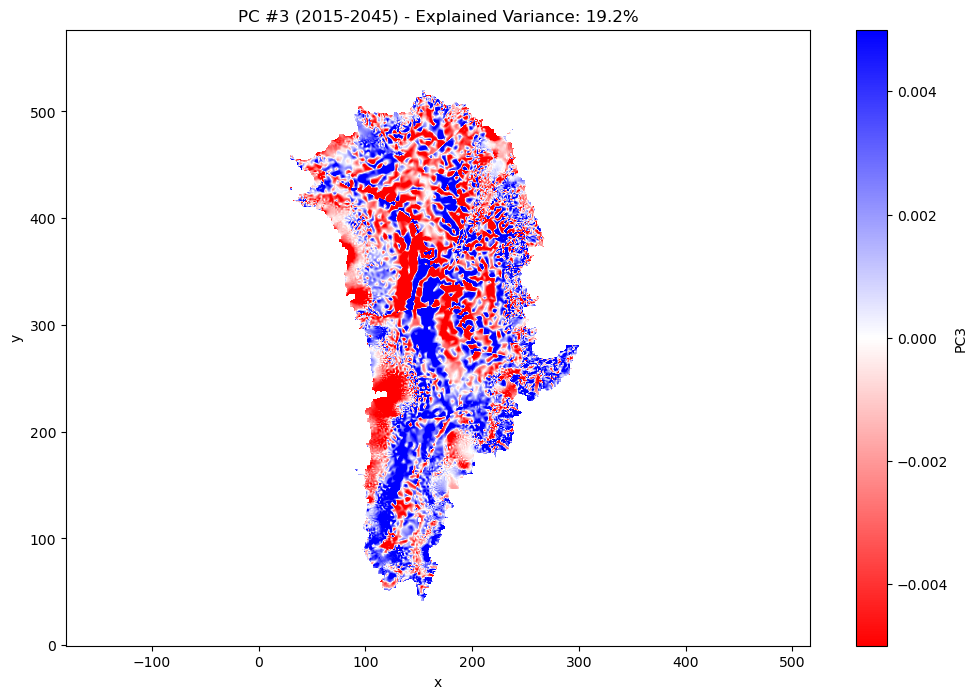

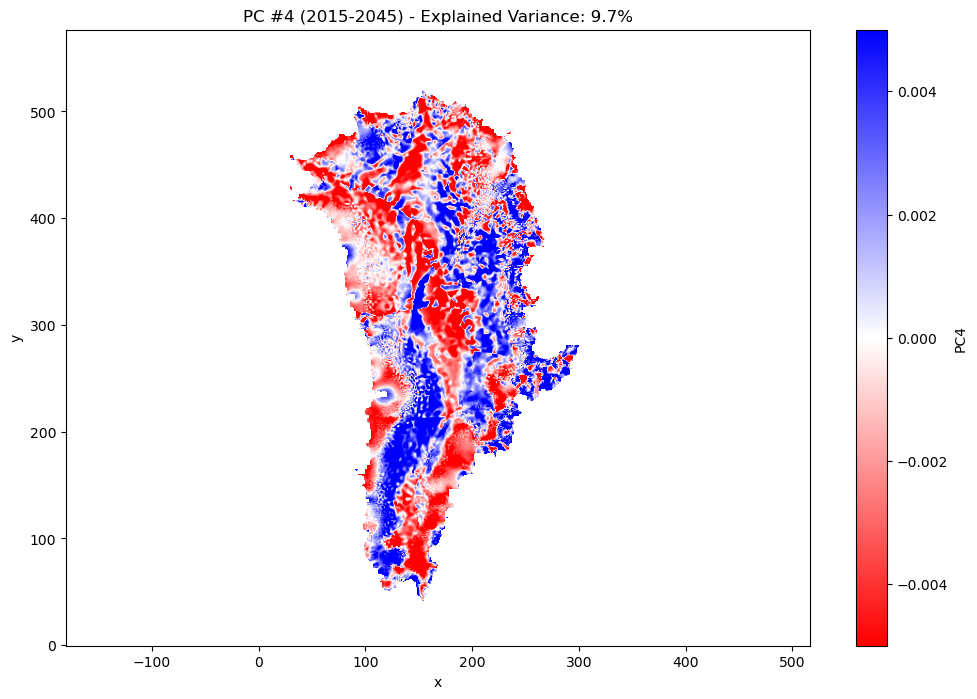

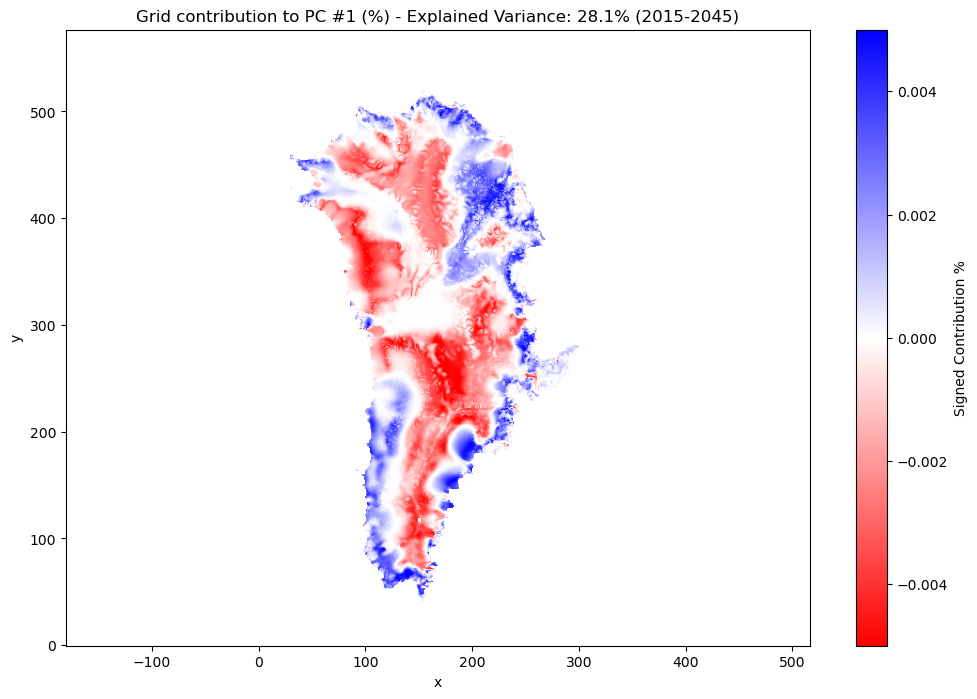

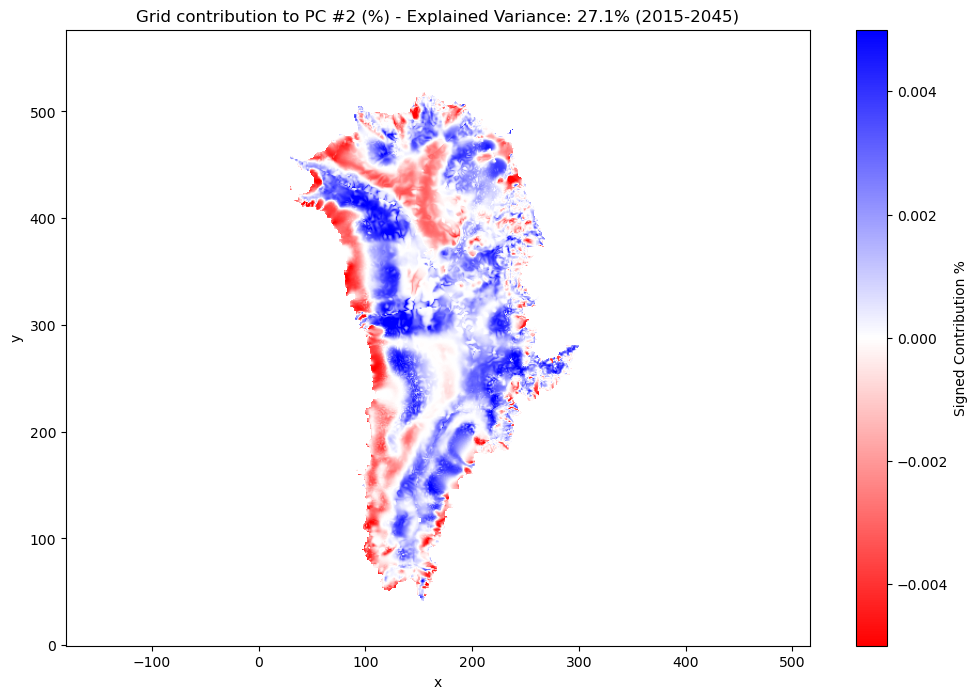

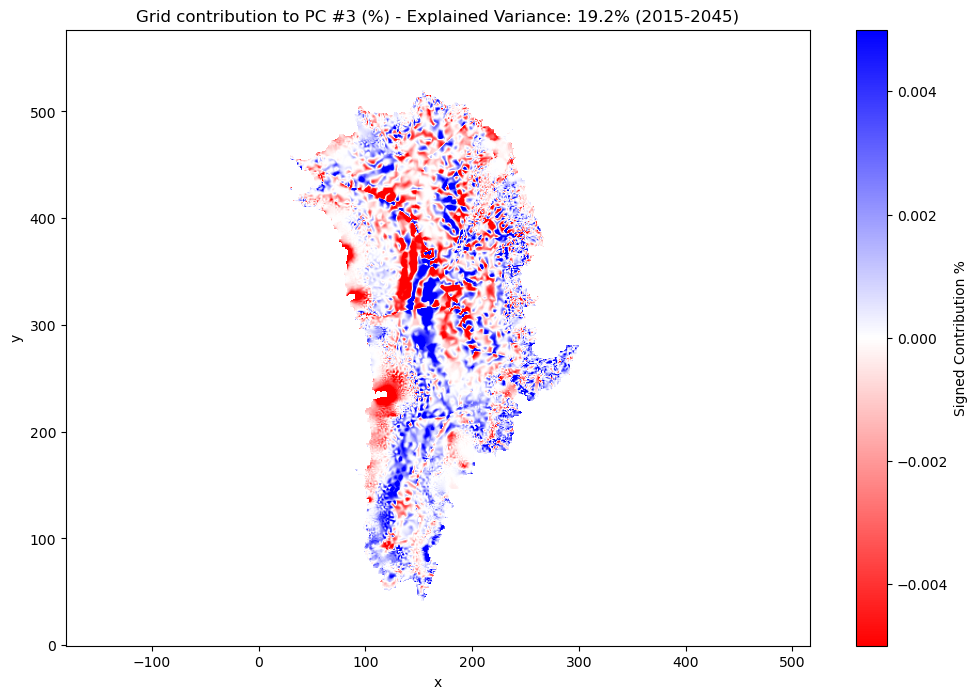

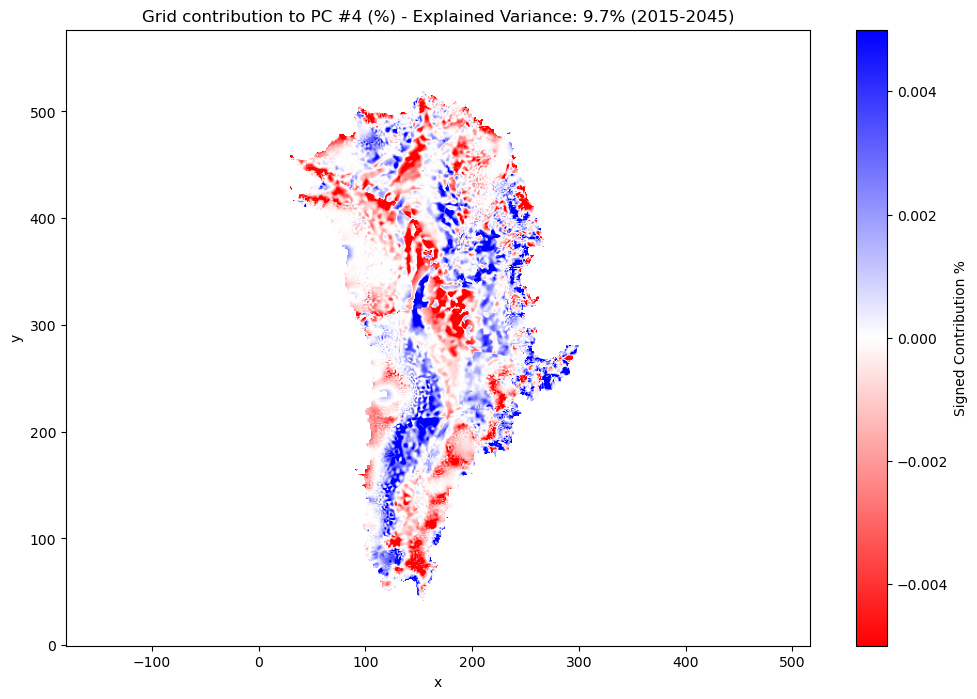


 Generating Sum of PC Vectors plot for 2015-2045...


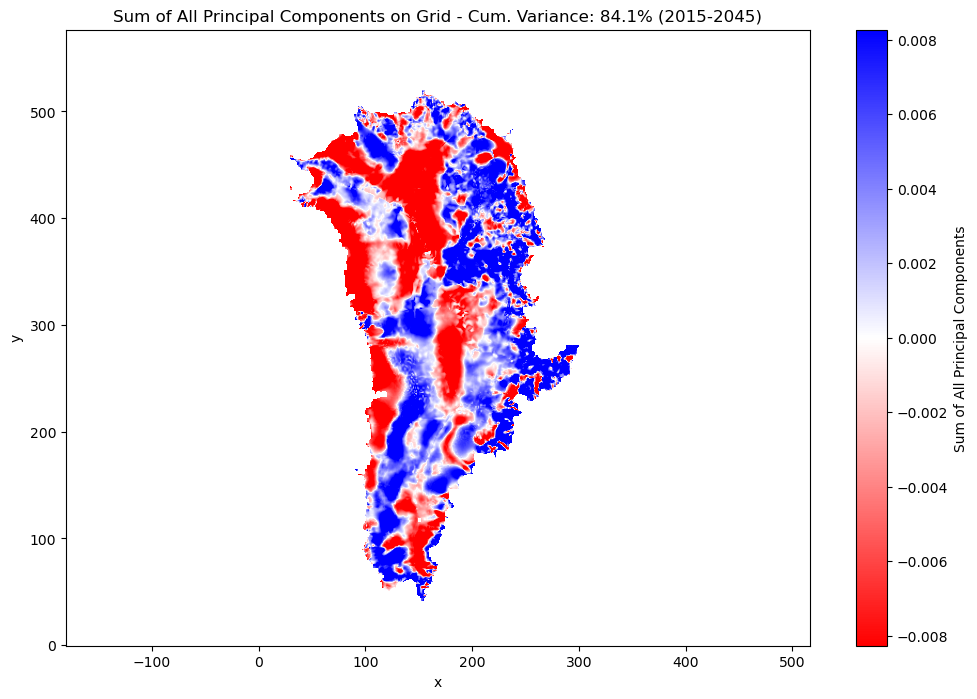


 Processing: 2015-2055...


C:\Users\benra\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\benra\AppData\Local\Temp\ipykernel_5940\2842842716.py:91: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cluster_colors = [cm.get_cmap('Set1')(i) for i in range(n_clusters)]


K-Means cluster results saved to: Research_Plots\exp05_lithk_plots\2015-2055\lithk_exp05_KMeans_Clusters_2015-2055.csv


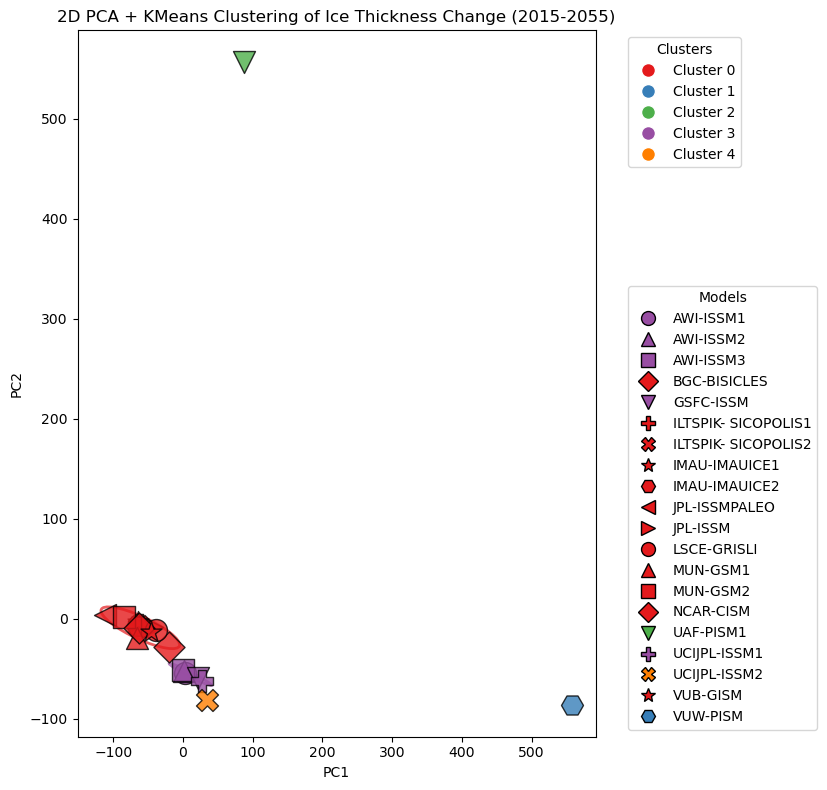

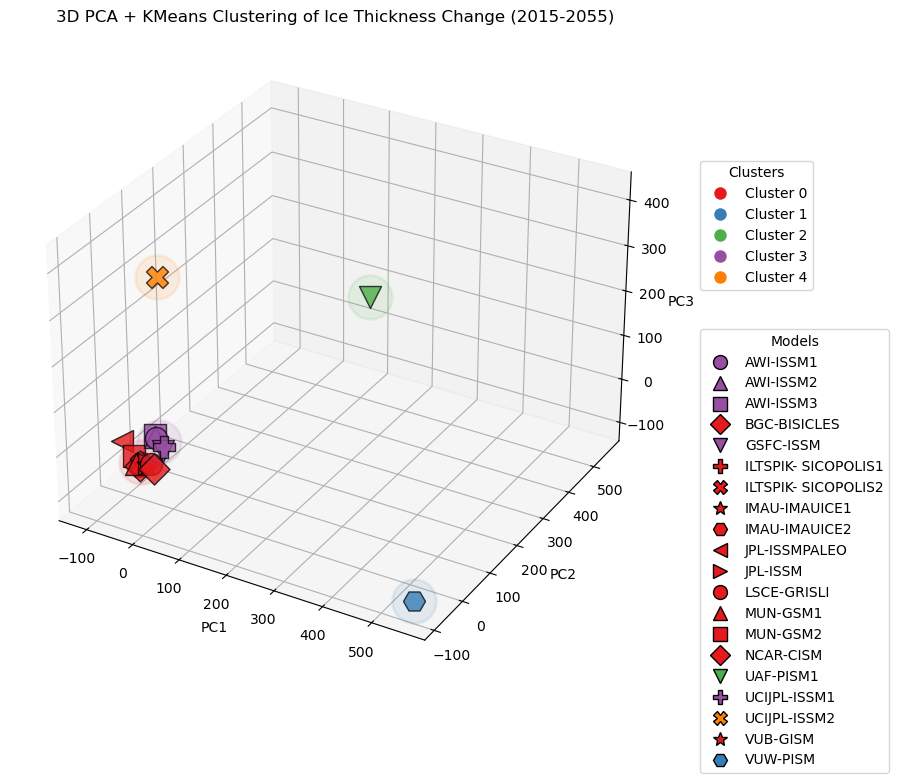

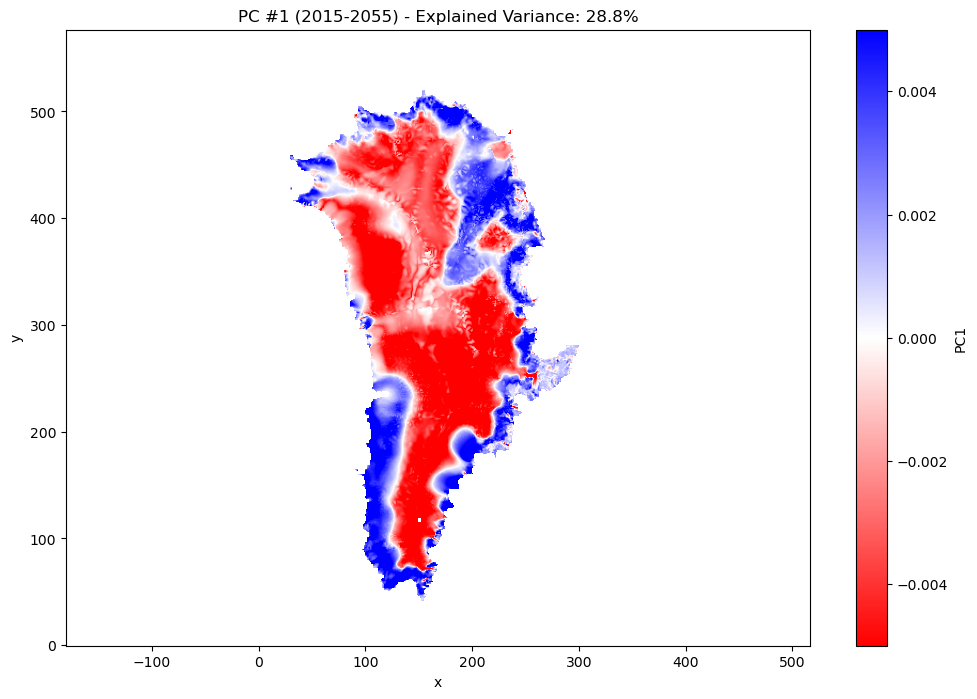

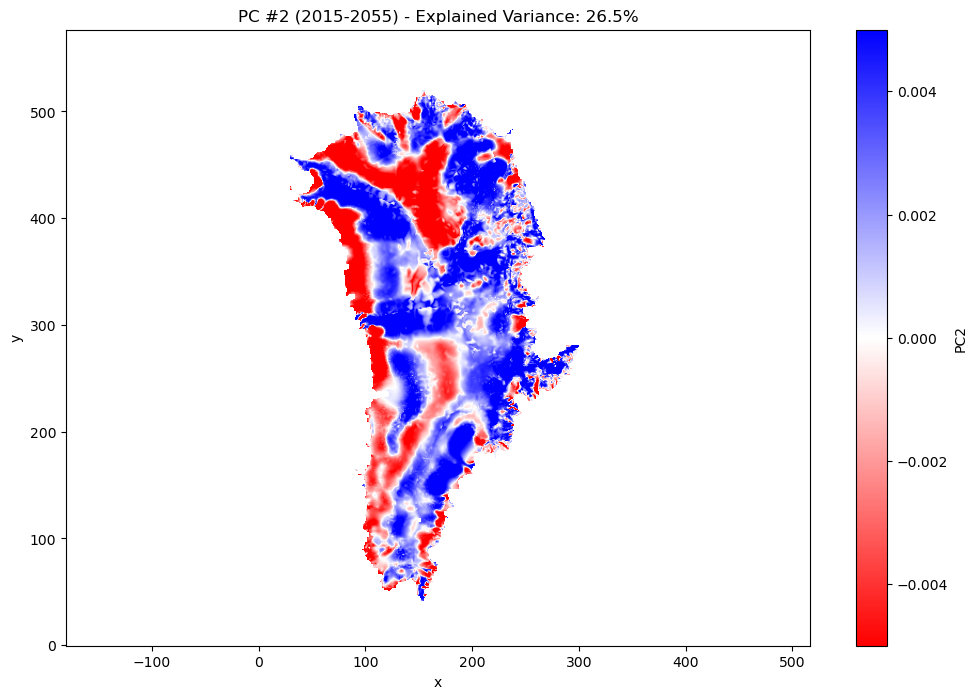

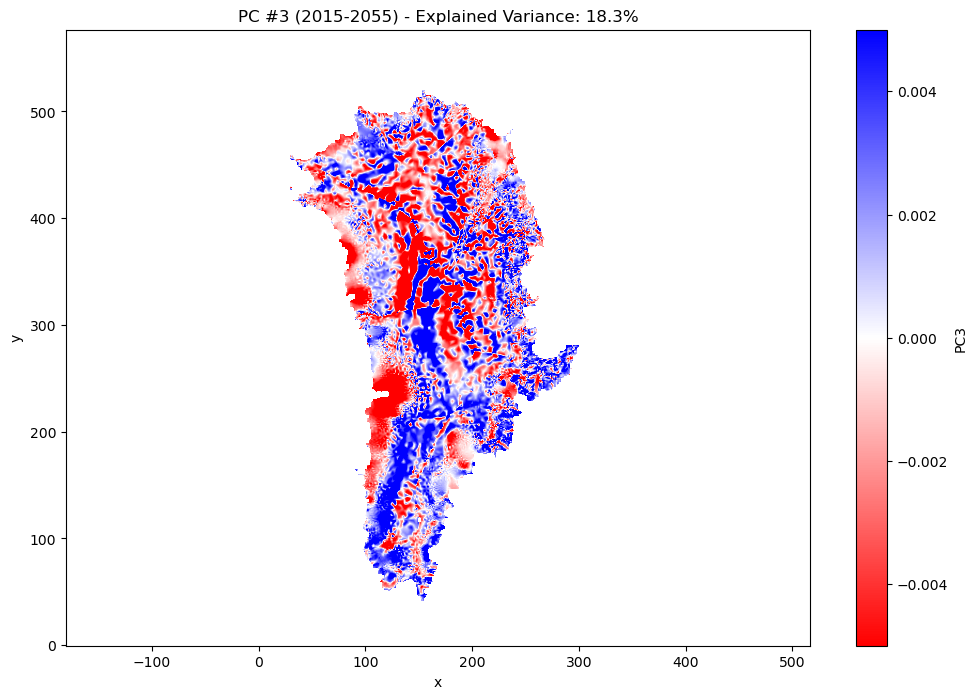

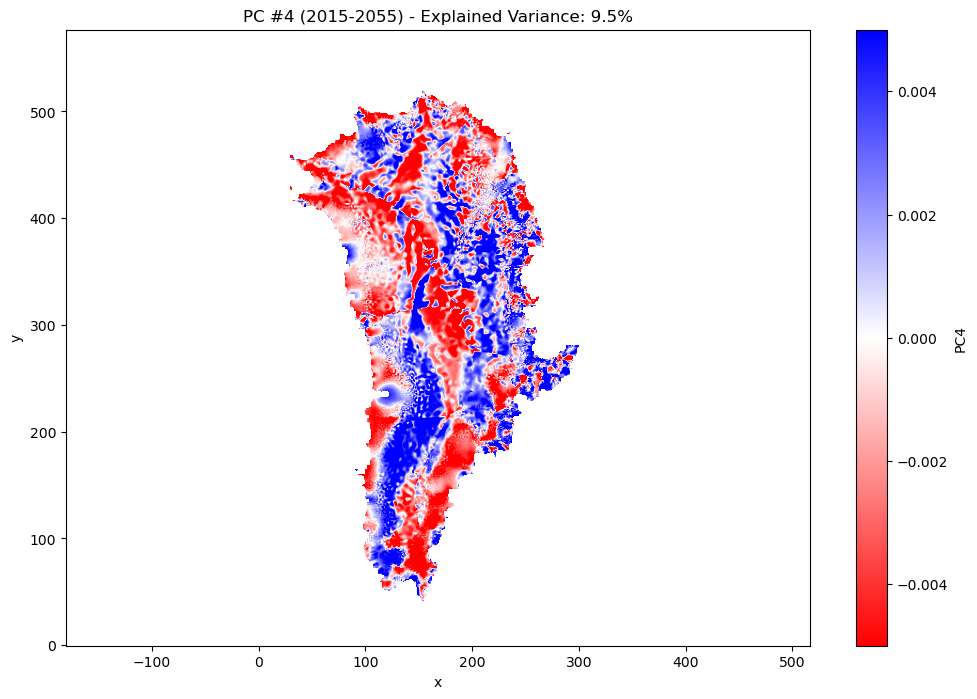

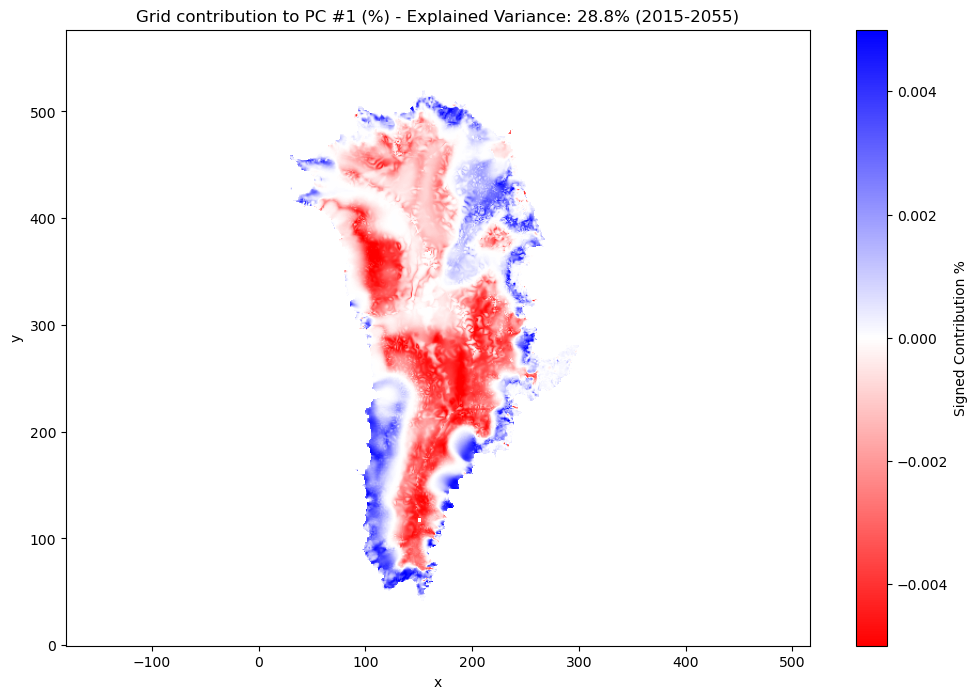

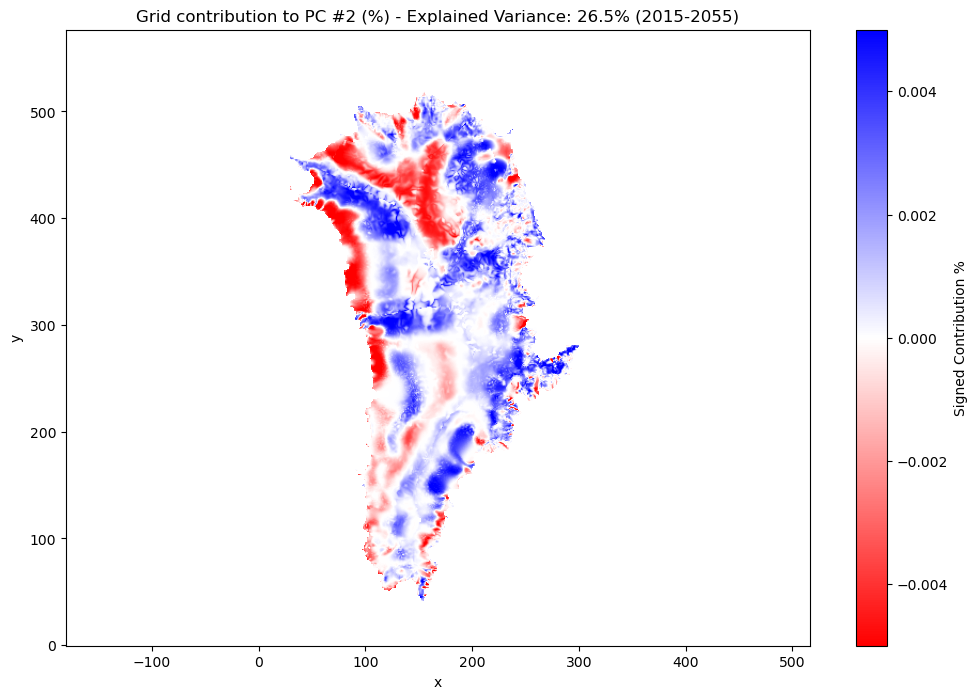

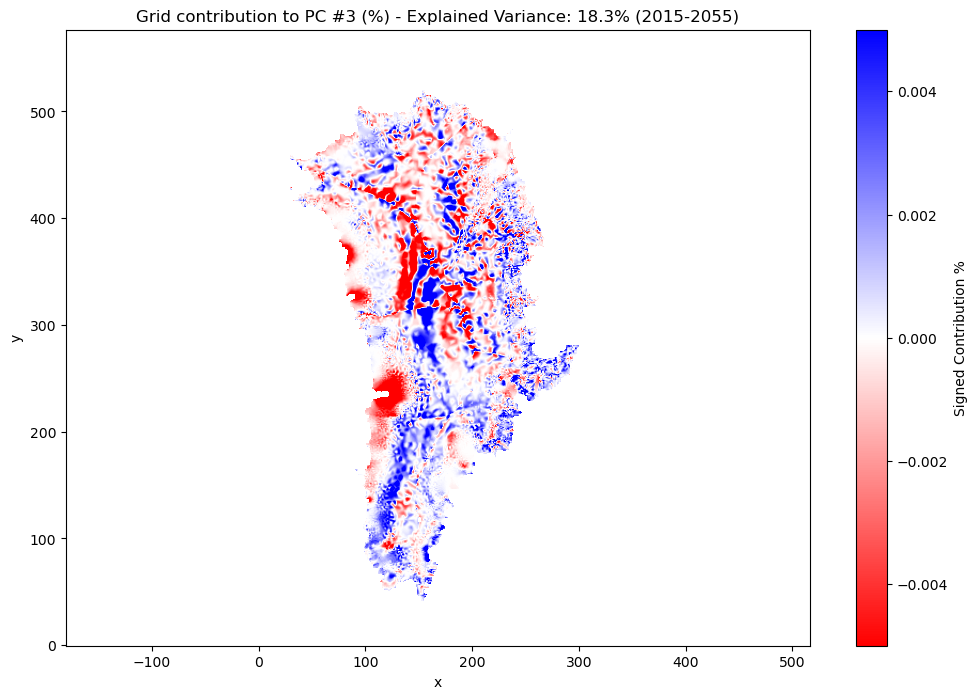

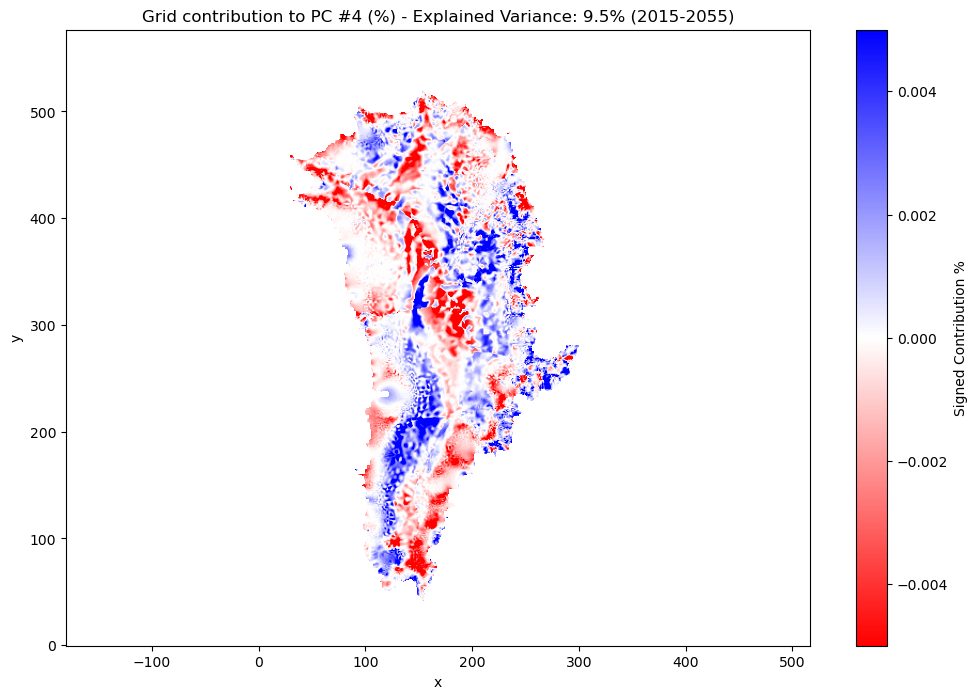


 Generating Sum of PC Vectors plot for 2015-2055...


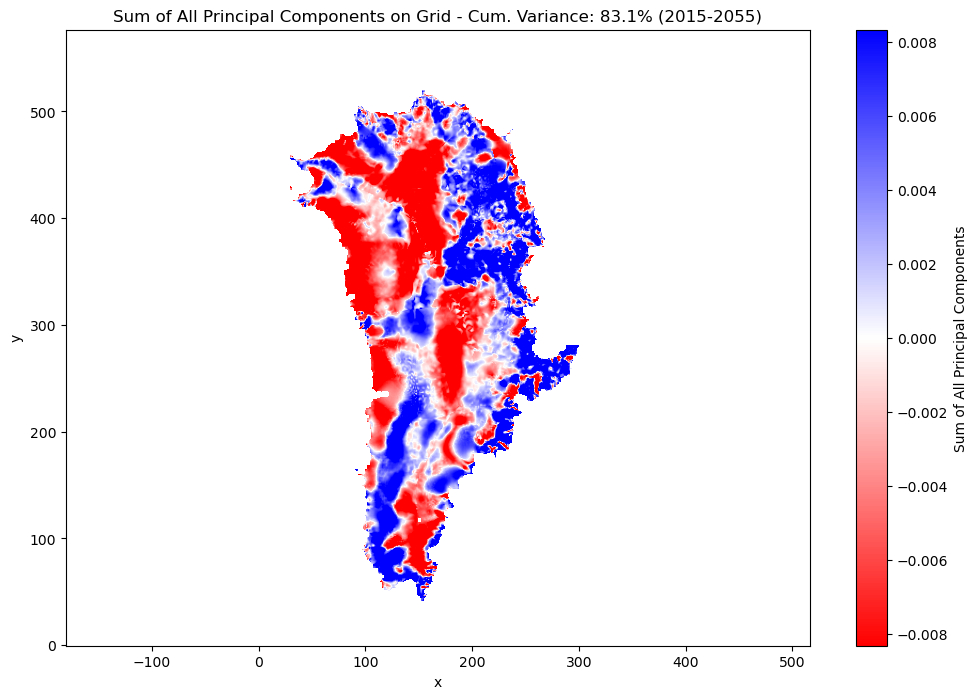


 Processing: 2015-2065...


C:\Users\benra\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\benra\AppData\Local\Temp\ipykernel_5940\2842842716.py:91: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cluster_colors = [cm.get_cmap('Set1')(i) for i in range(n_clusters)]


K-Means cluster results saved to: Research_Plots\exp05_lithk_plots\2015-2065\lithk_exp05_KMeans_Clusters_2015-2065.csv


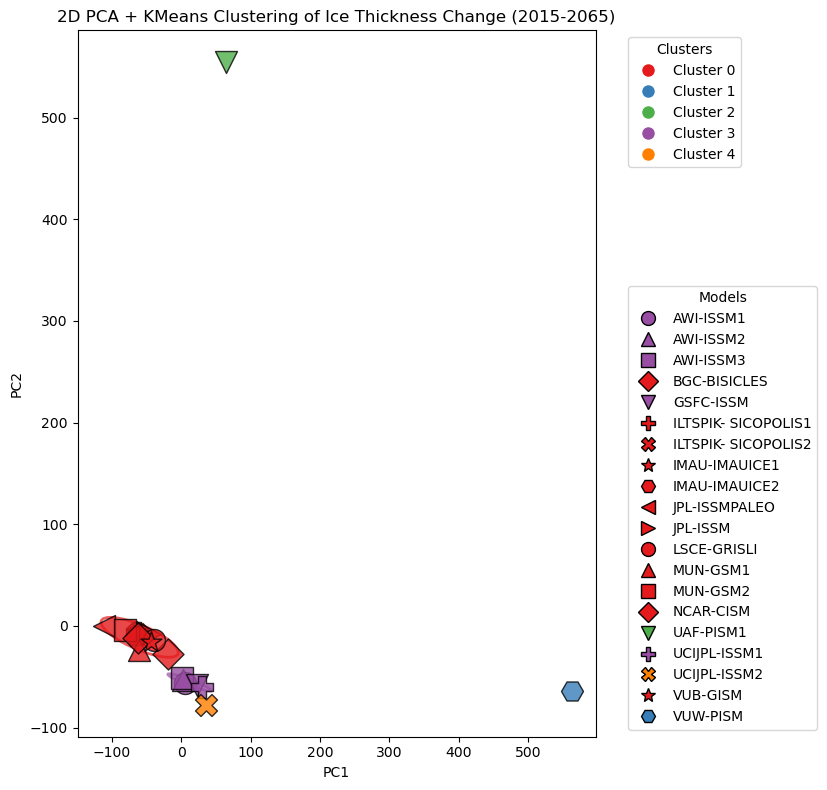

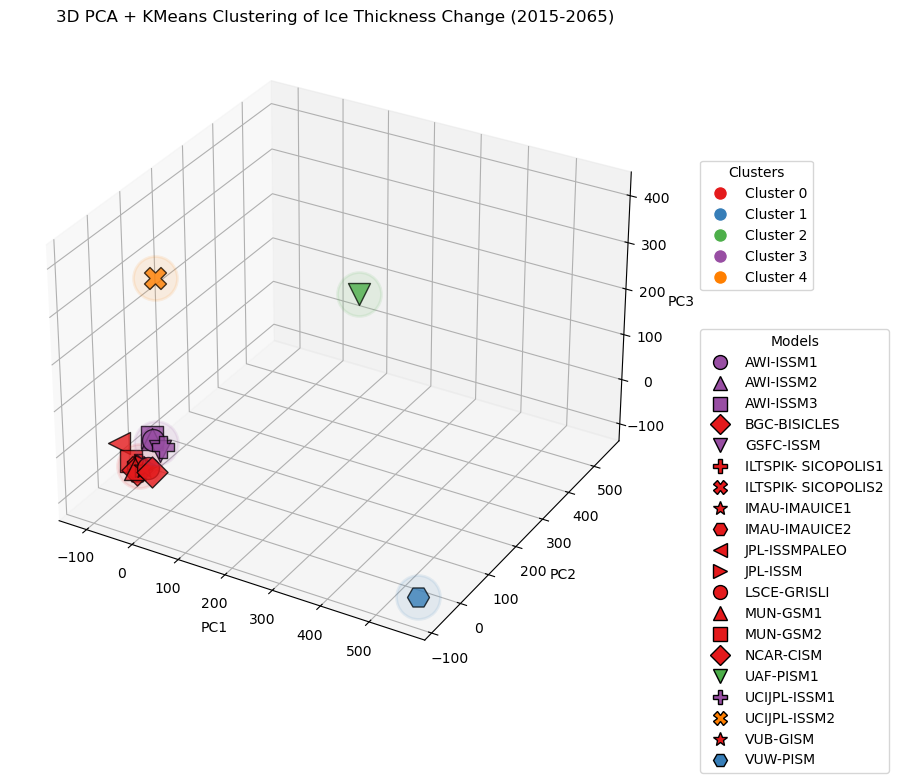

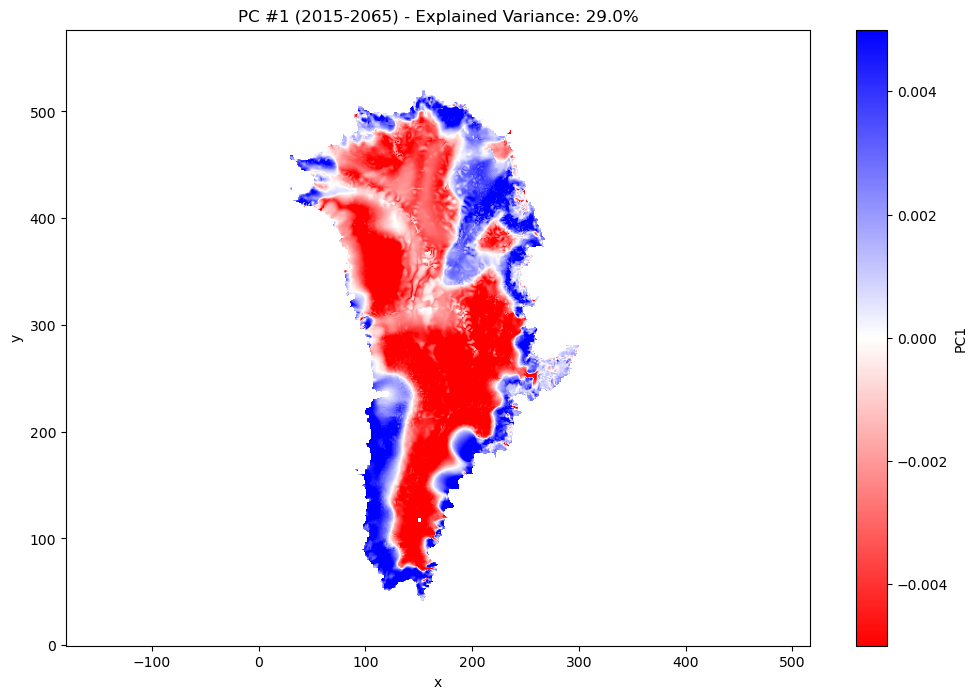

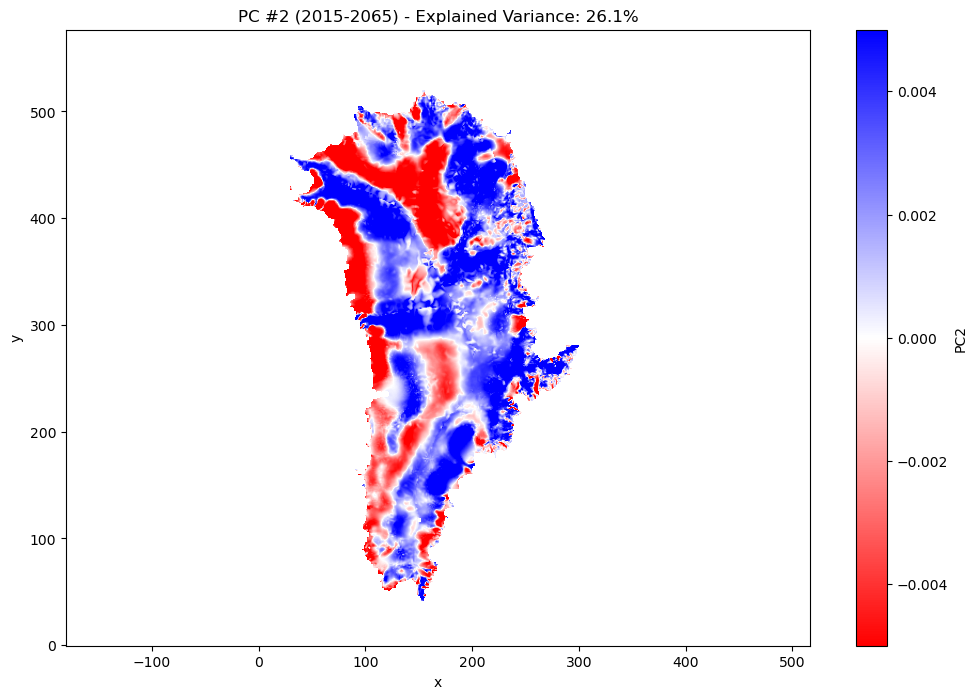

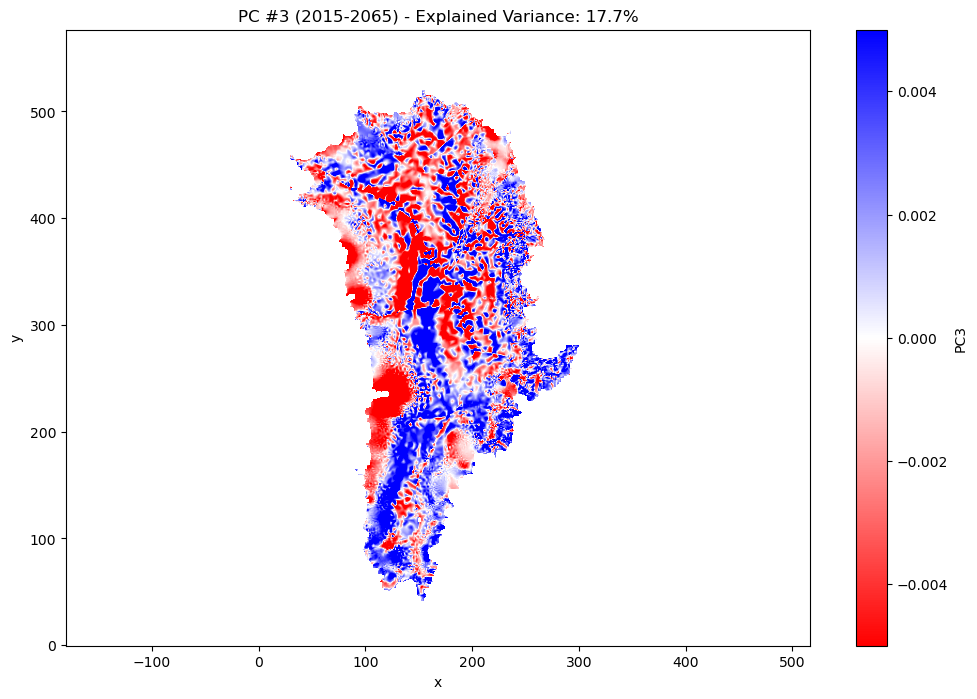

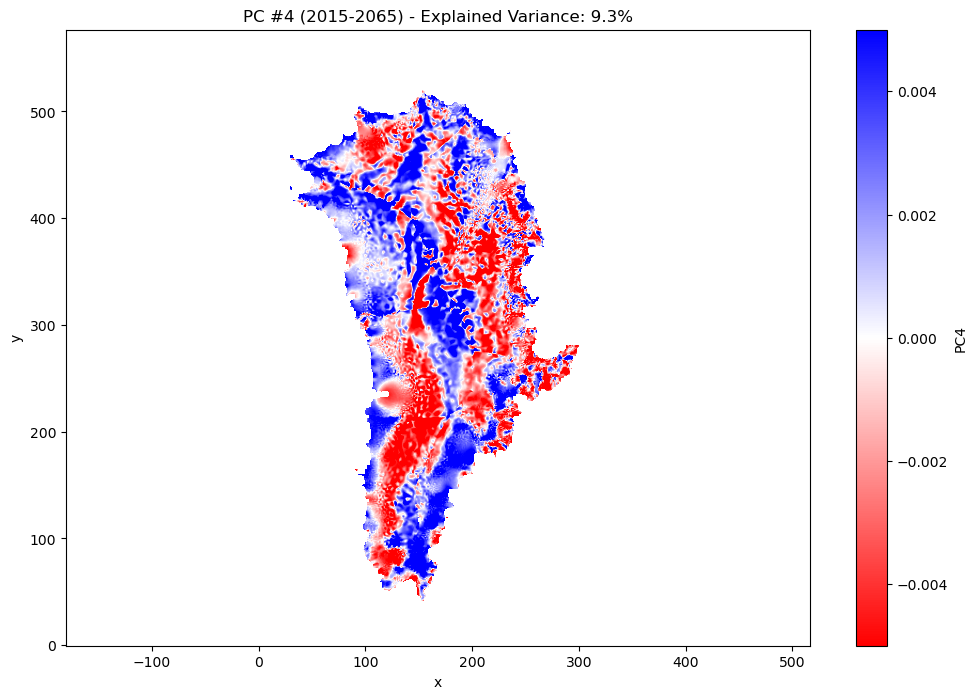

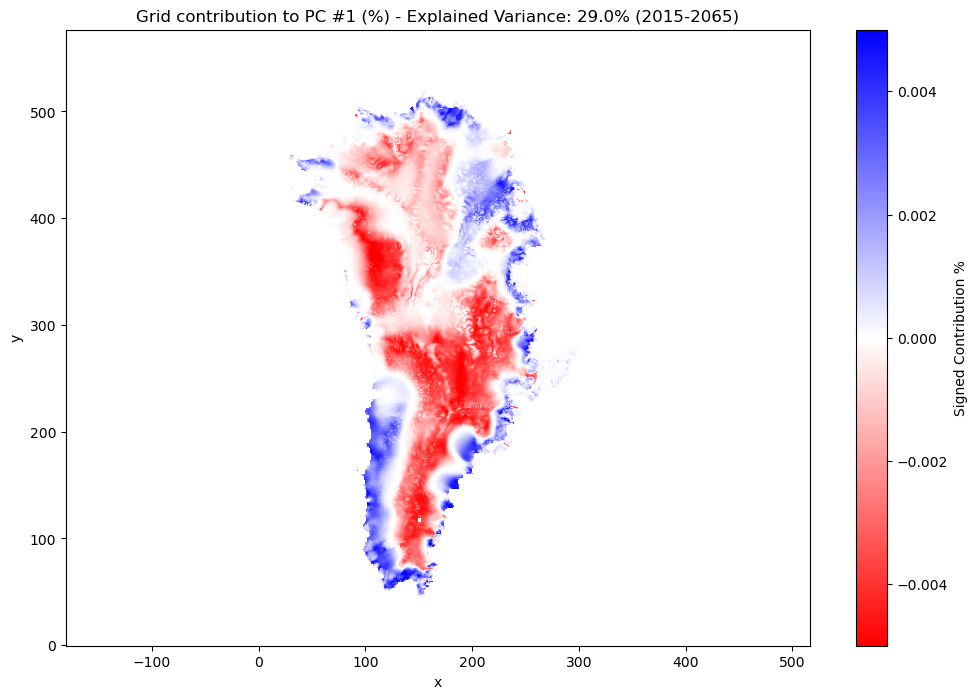

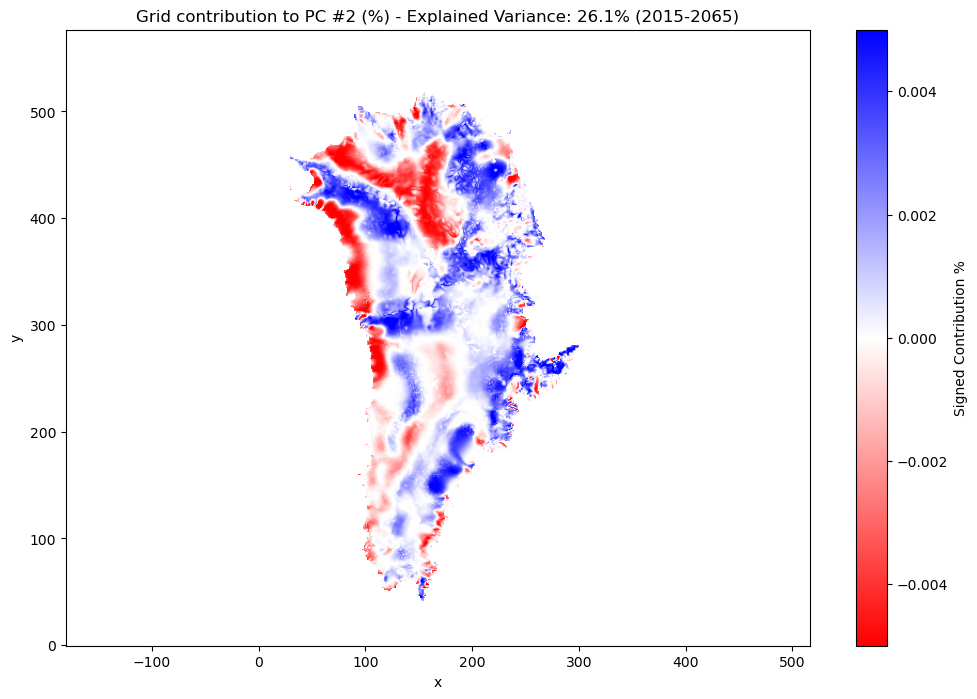

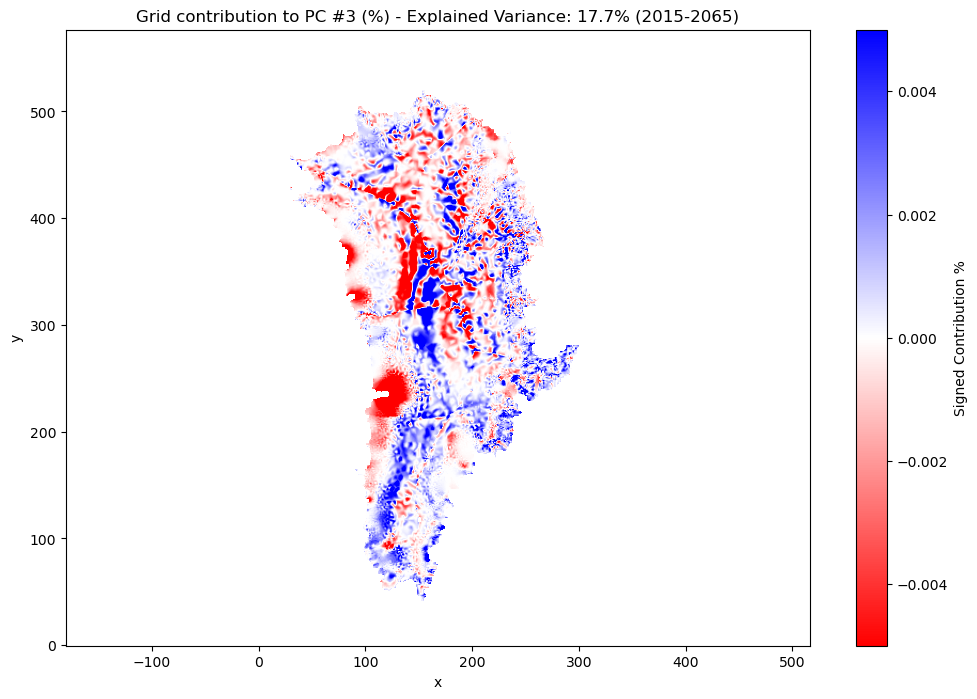

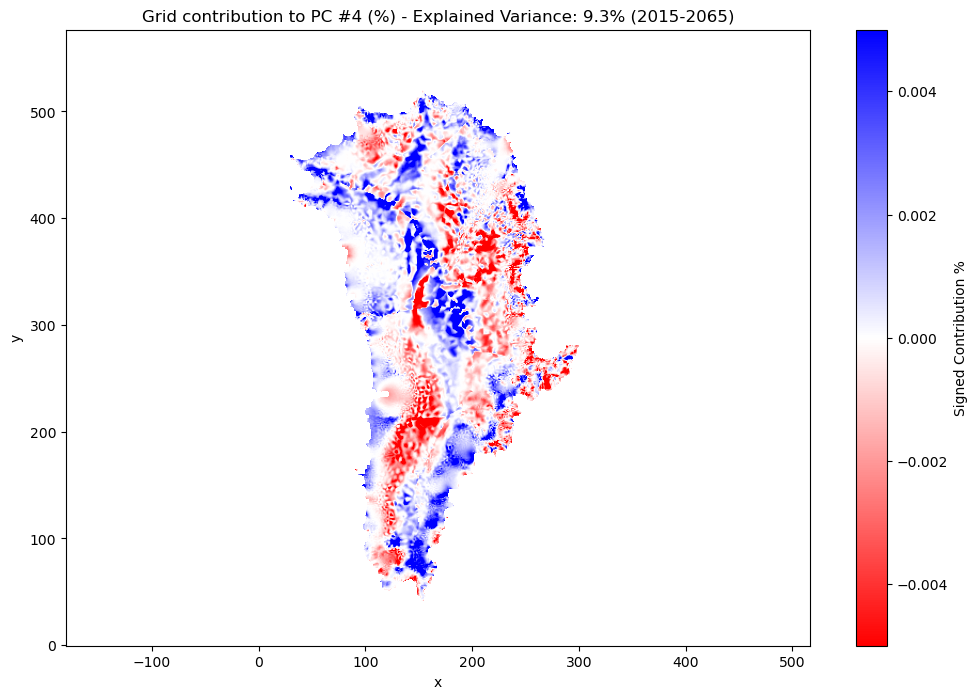


 Generating Sum of PC Vectors plot for 2015-2065...


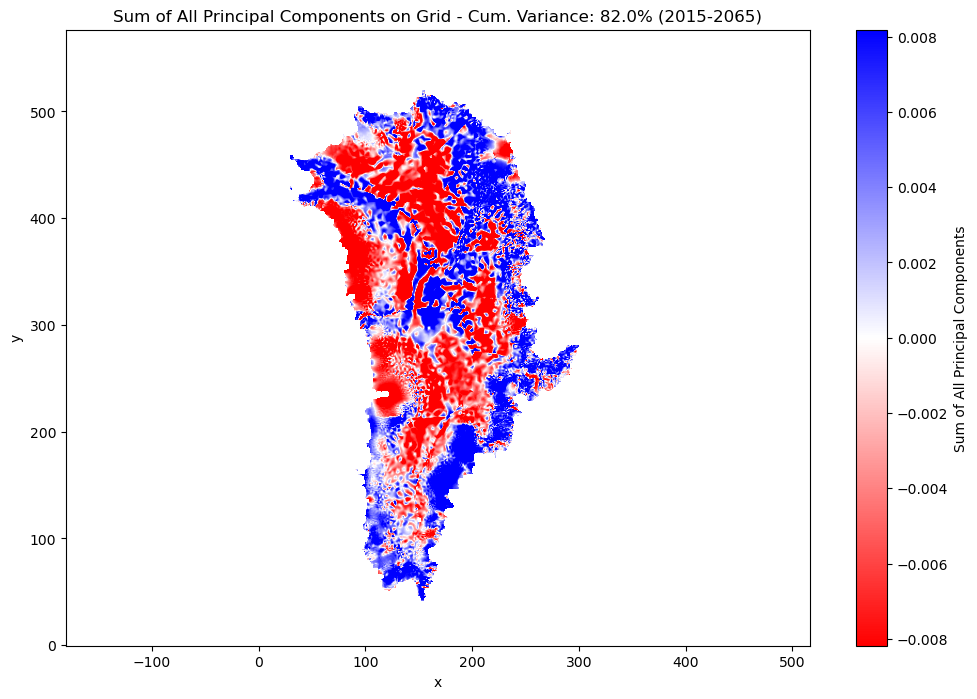


 Processing: 2015-2075...


C:\Users\benra\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\benra\AppData\Local\Temp\ipykernel_5940\2842842716.py:91: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cluster_colors = [cm.get_cmap('Set1')(i) for i in range(n_clusters)]


K-Means cluster results saved to: Research_Plots\exp05_lithk_plots\2015-2075\lithk_exp05_KMeans_Clusters_2015-2075.csv


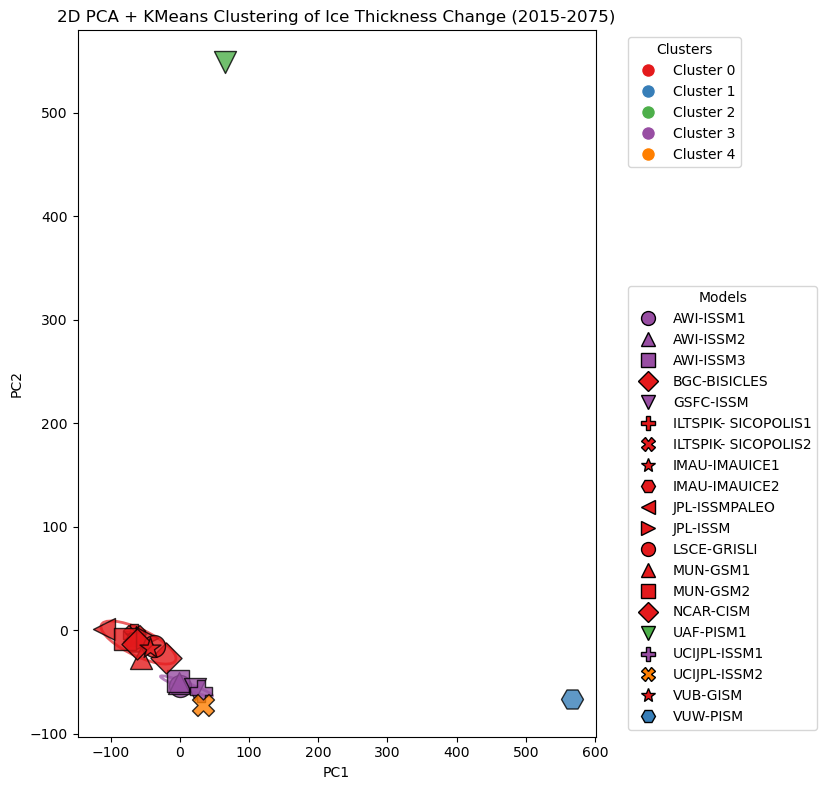

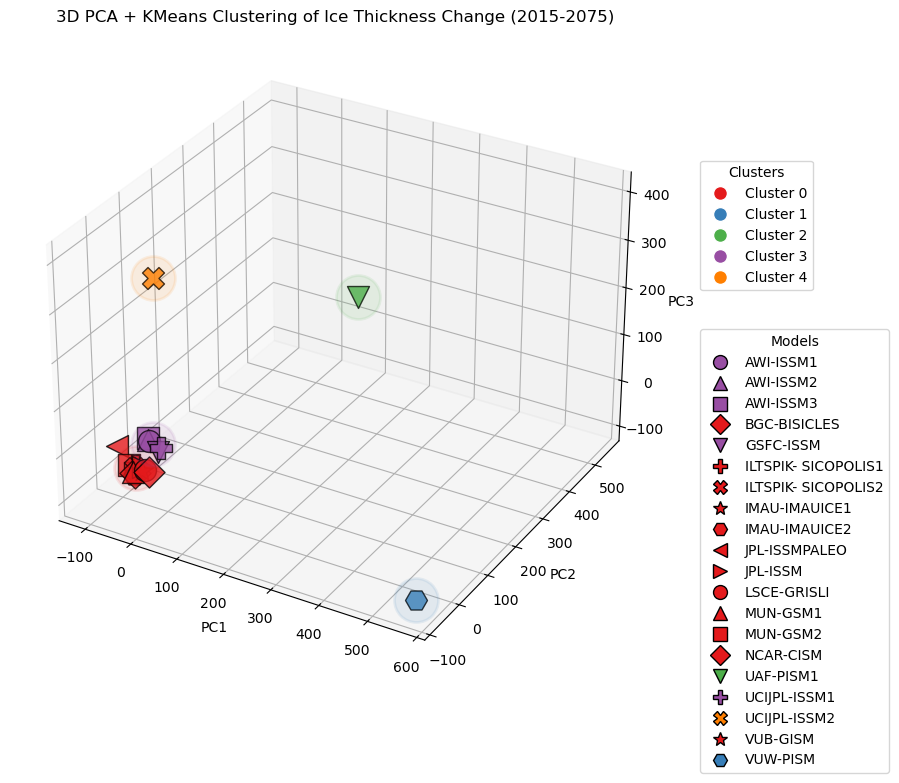

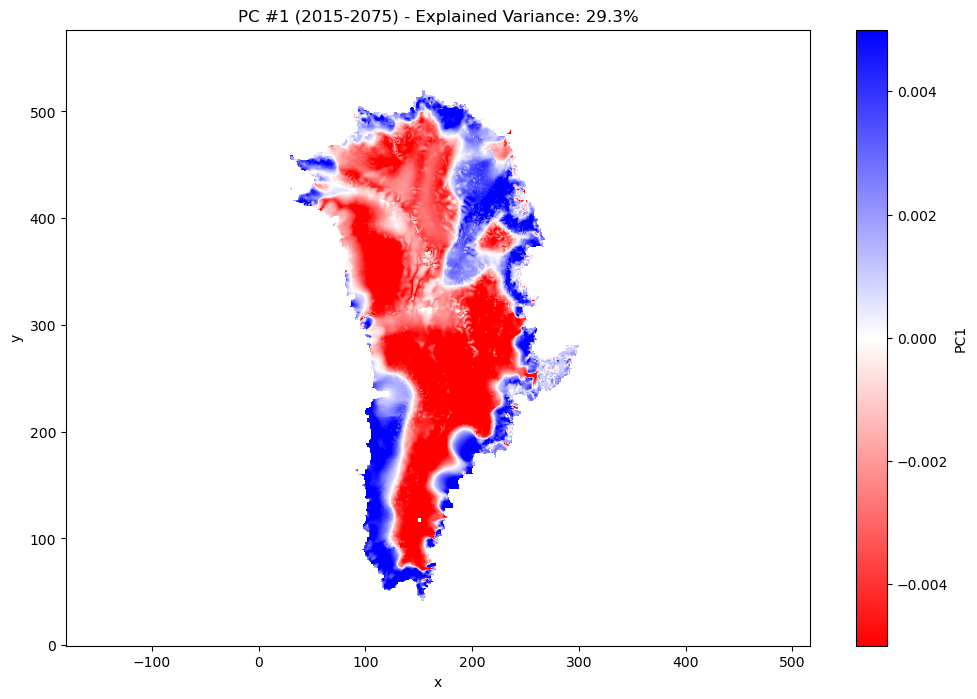

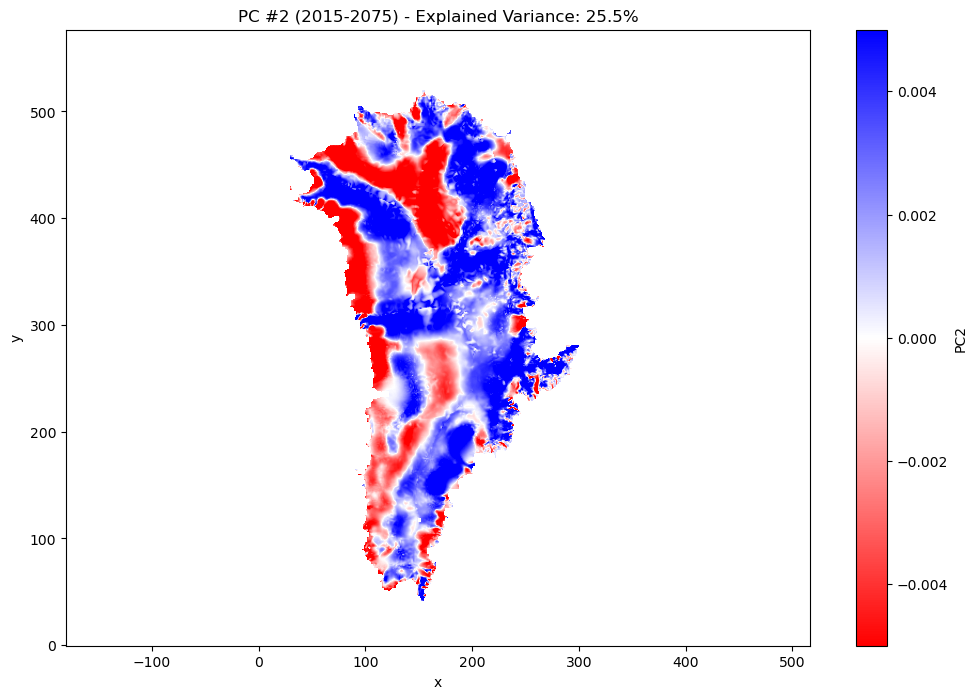

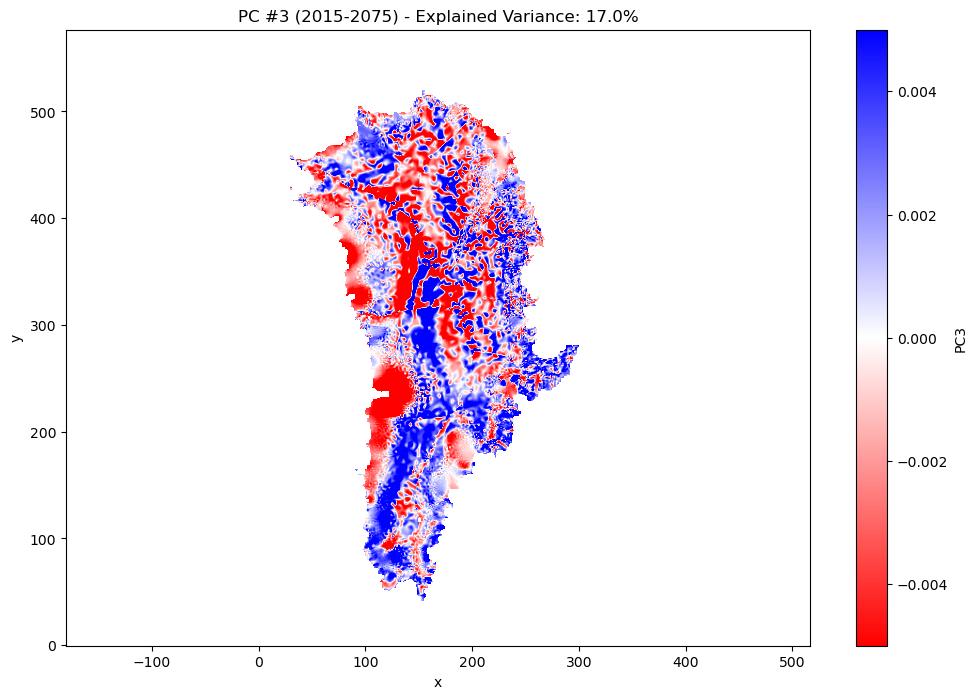

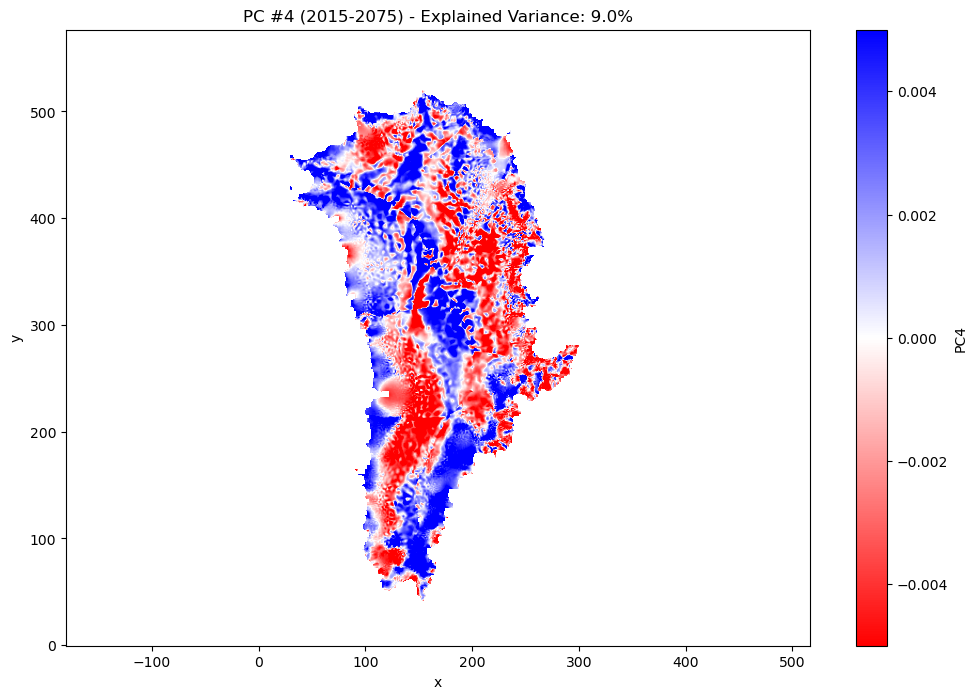

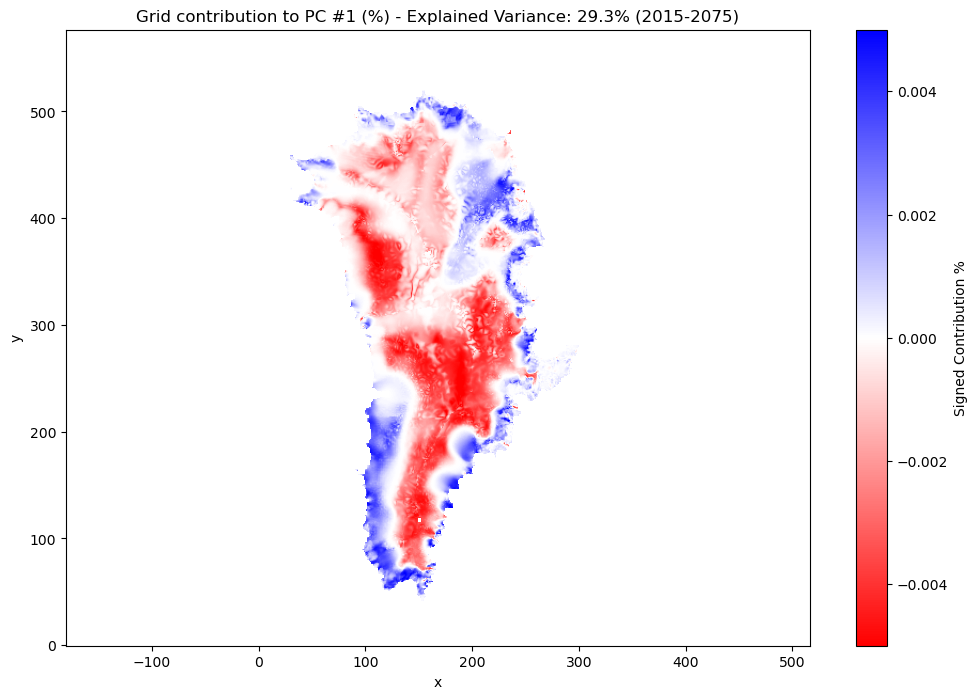

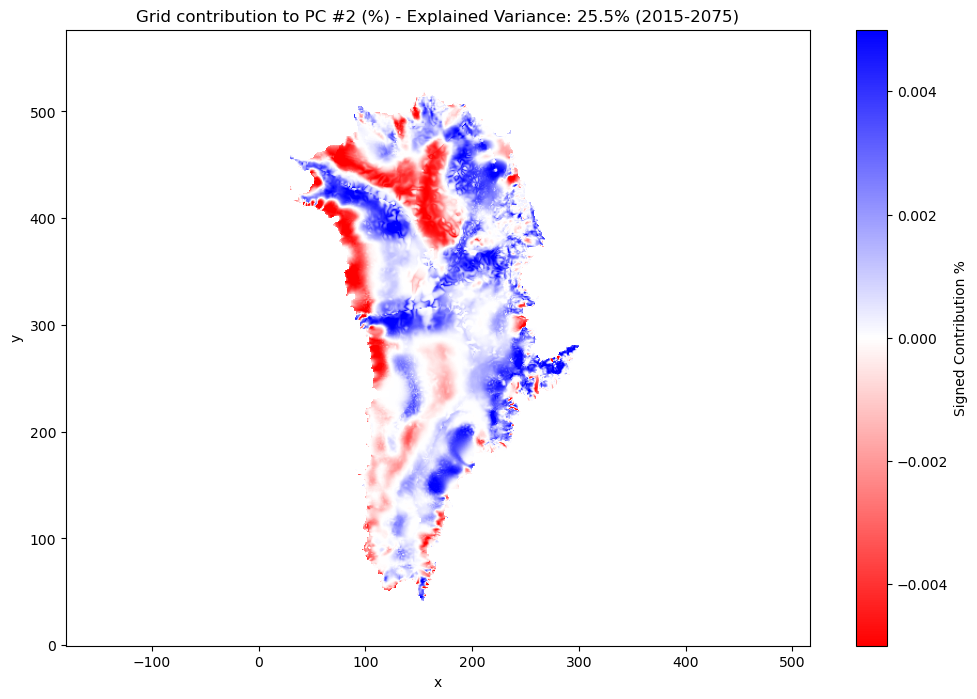

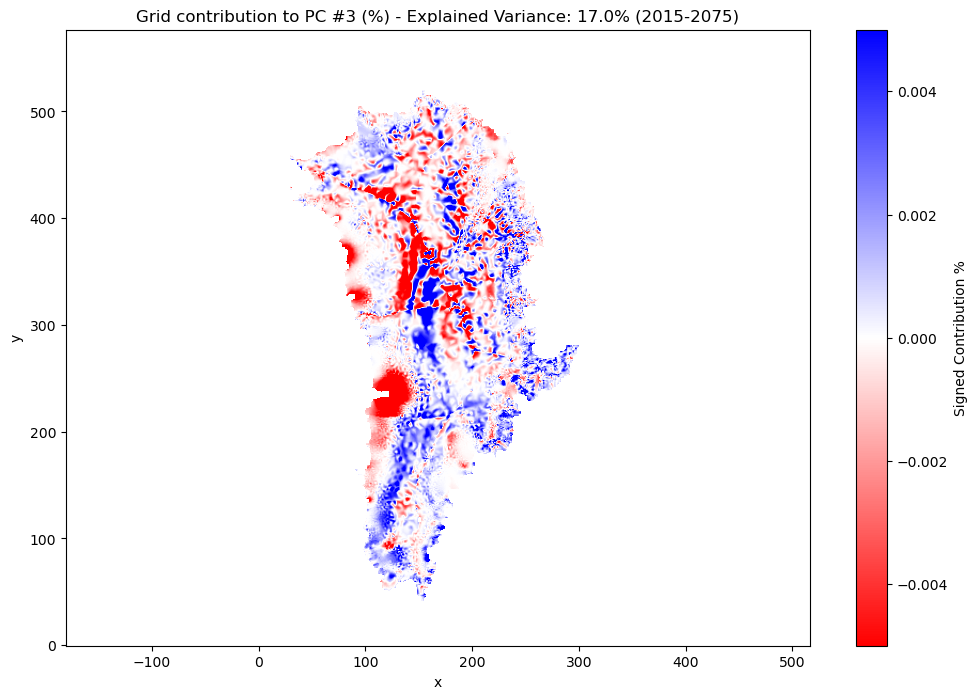

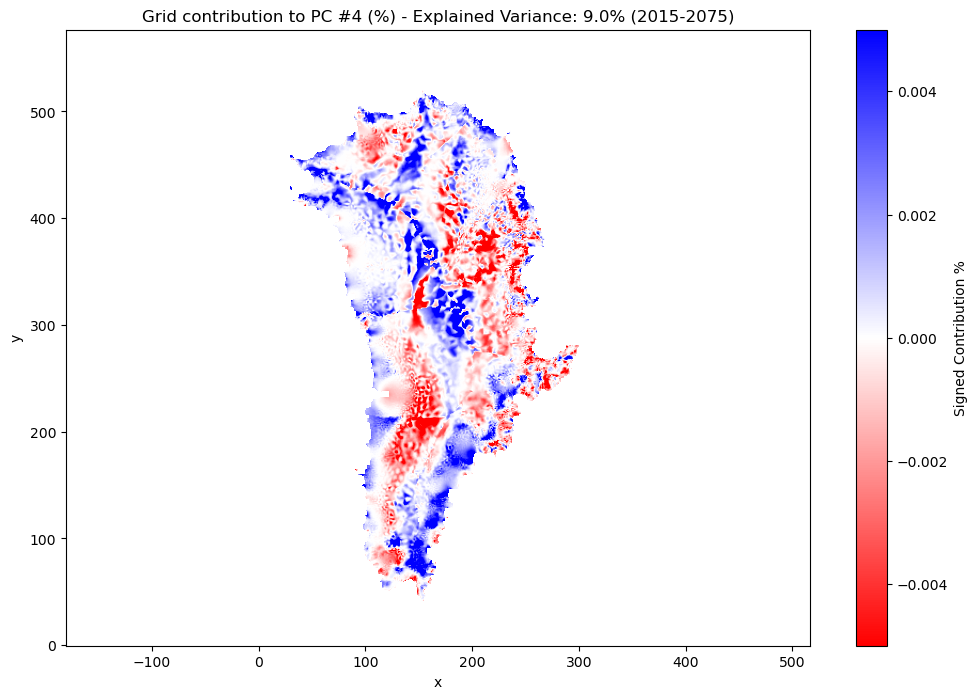


 Generating Sum of PC Vectors plot for 2015-2075...


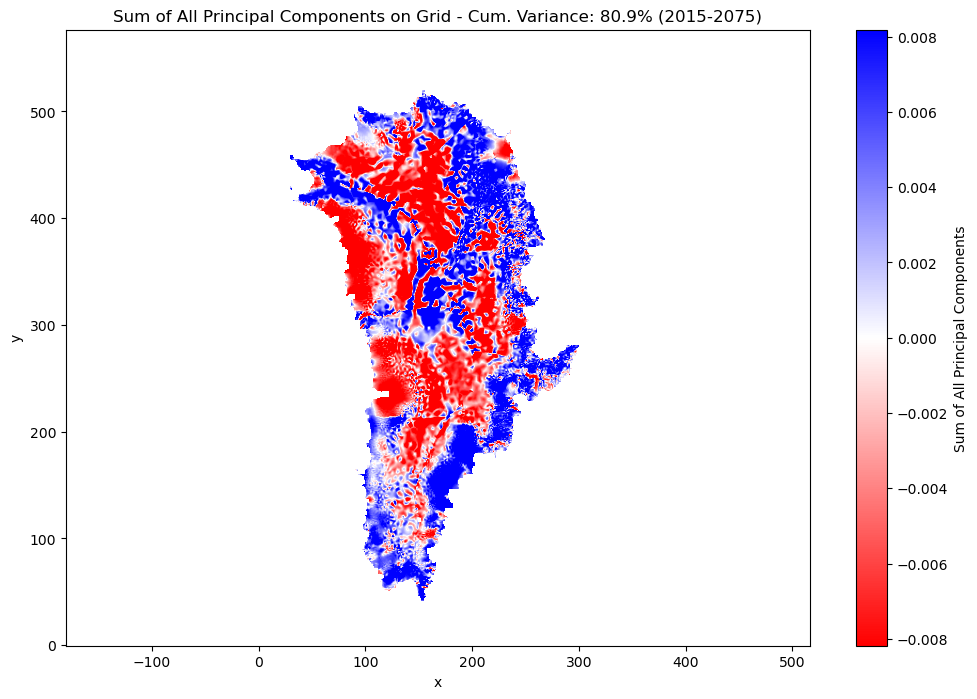


 Processing: 2015-2085...


C:\Users\benra\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\benra\AppData\Local\Temp\ipykernel_5940\2842842716.py:91: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cluster_colors = [cm.get_cmap('Set1')(i) for i in range(n_clusters)]


K-Means cluster results saved to: Research_Plots\exp05_lithk_plots\2015-2085\lithk_exp05_KMeans_Clusters_2015-2085.csv


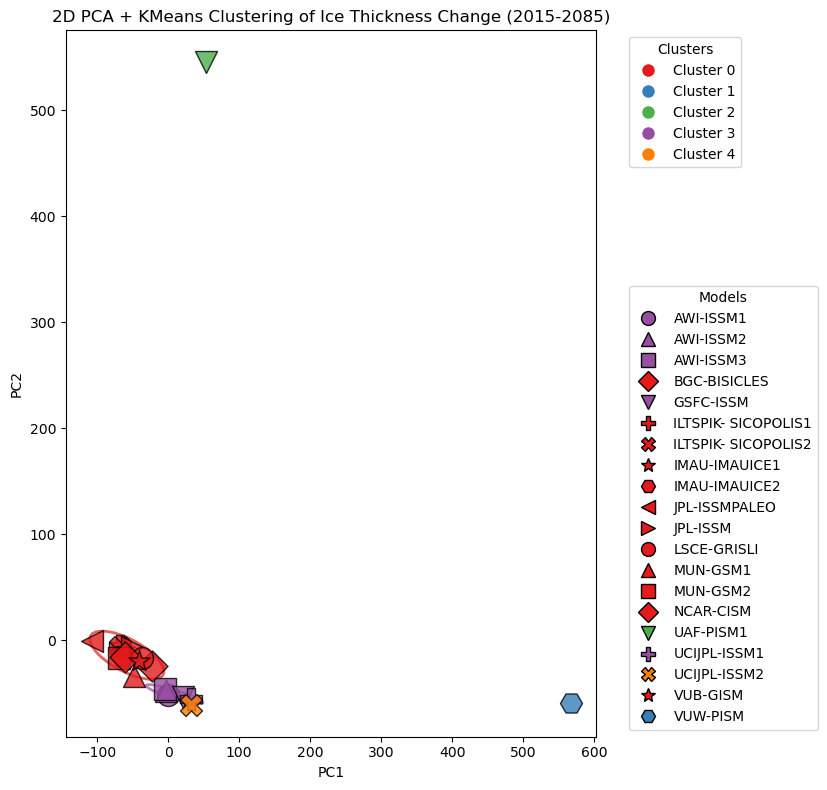

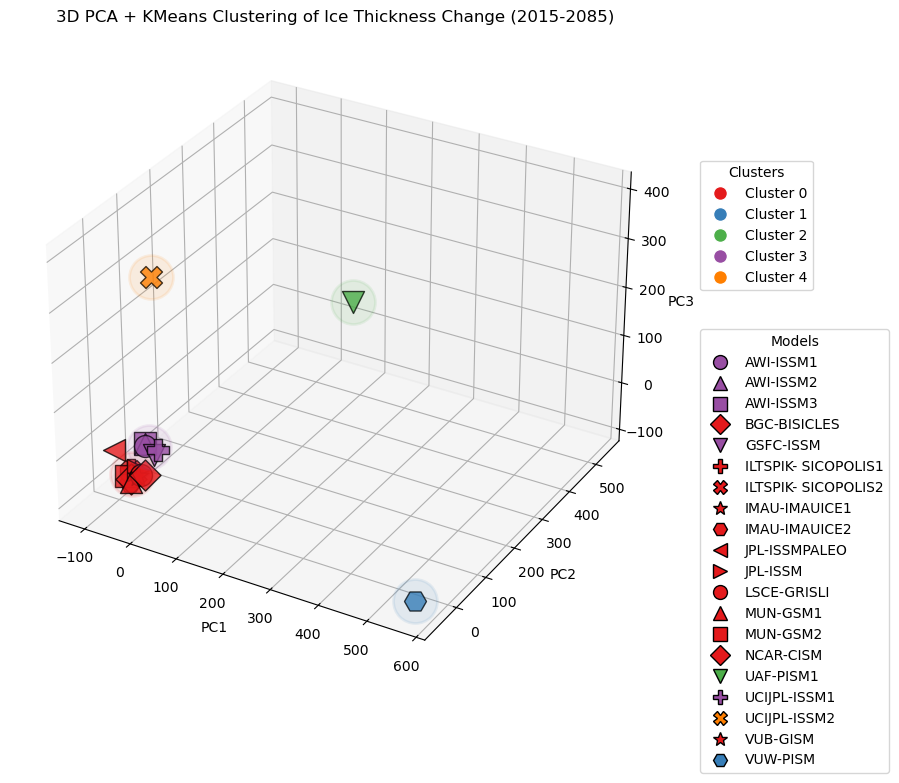

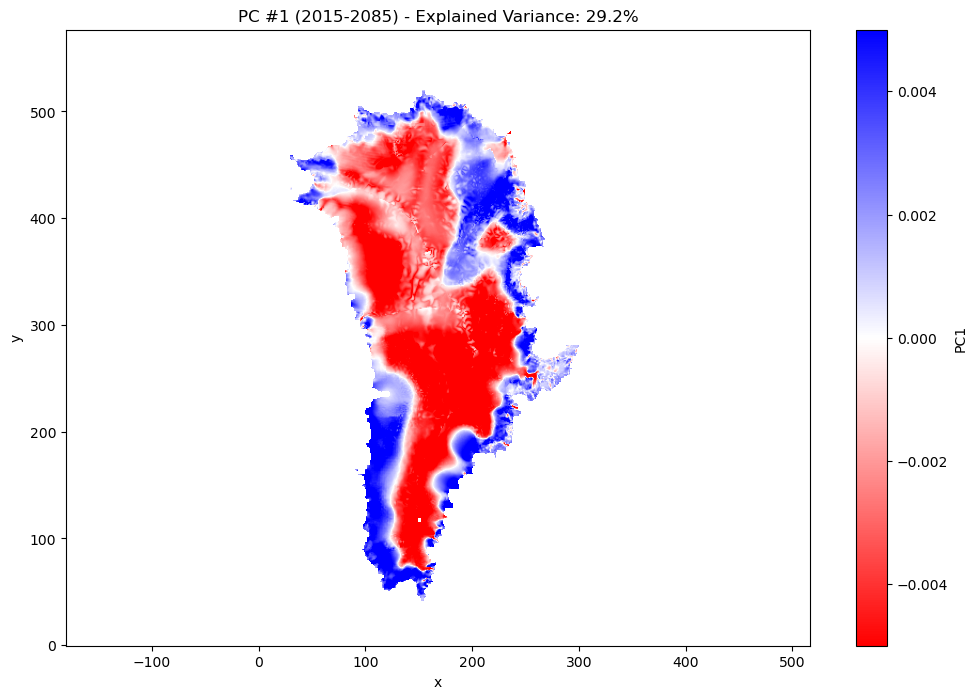

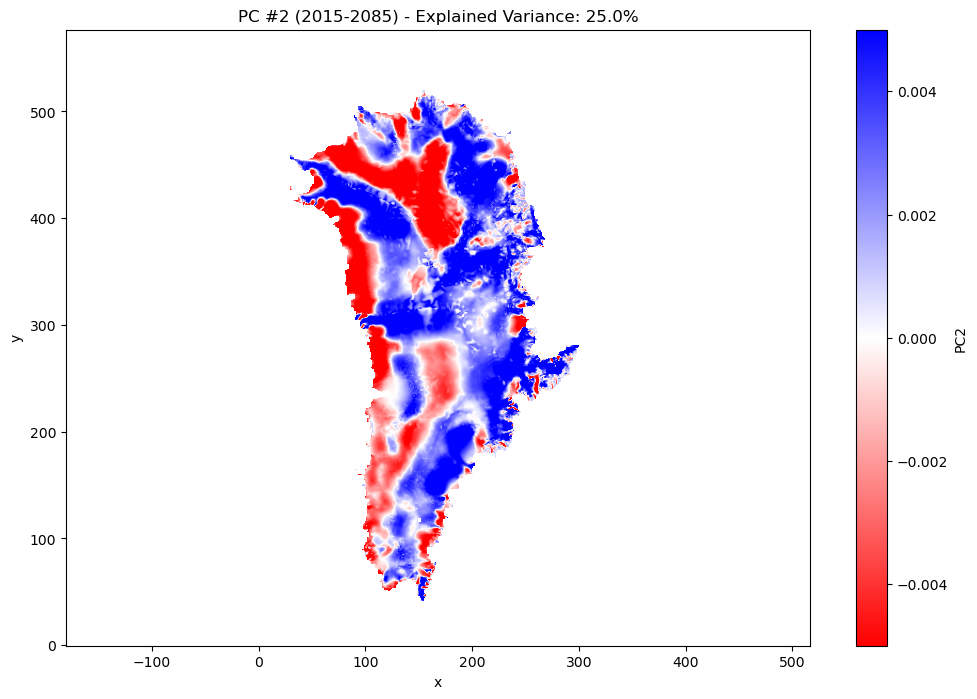

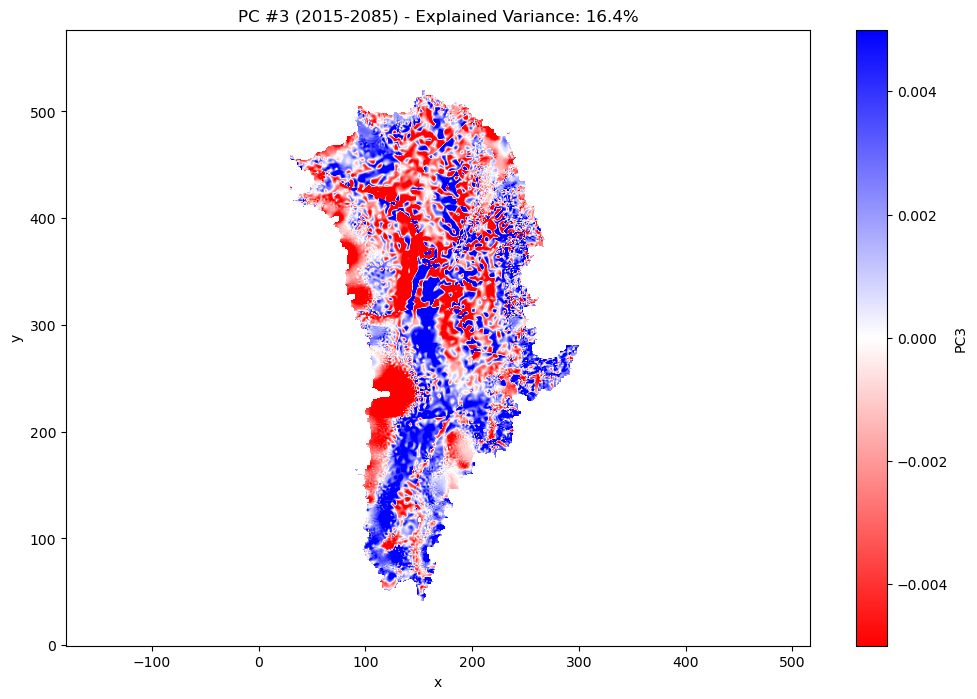

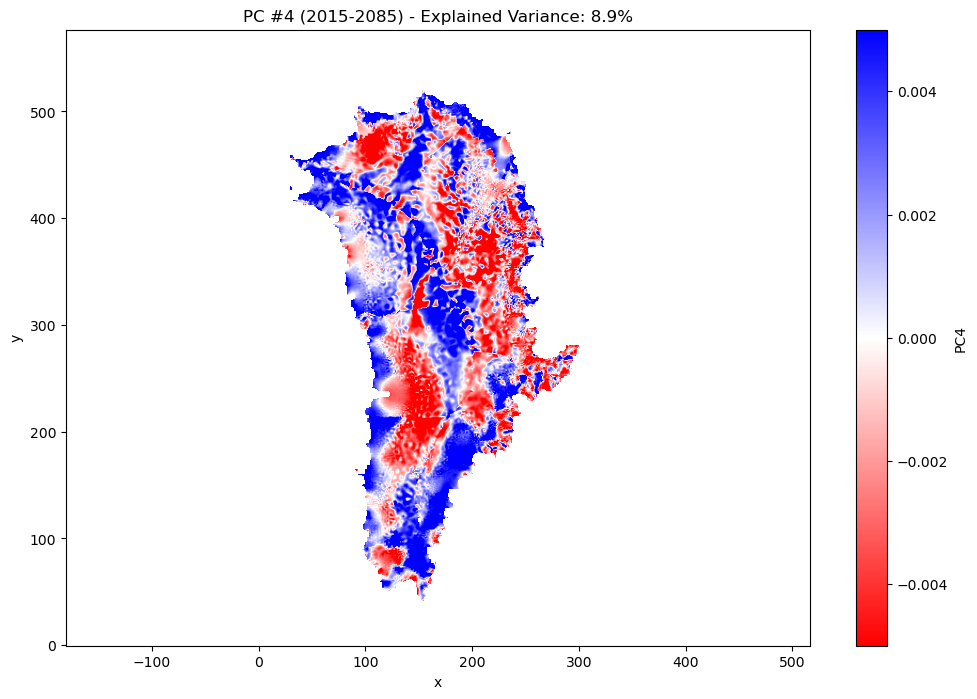

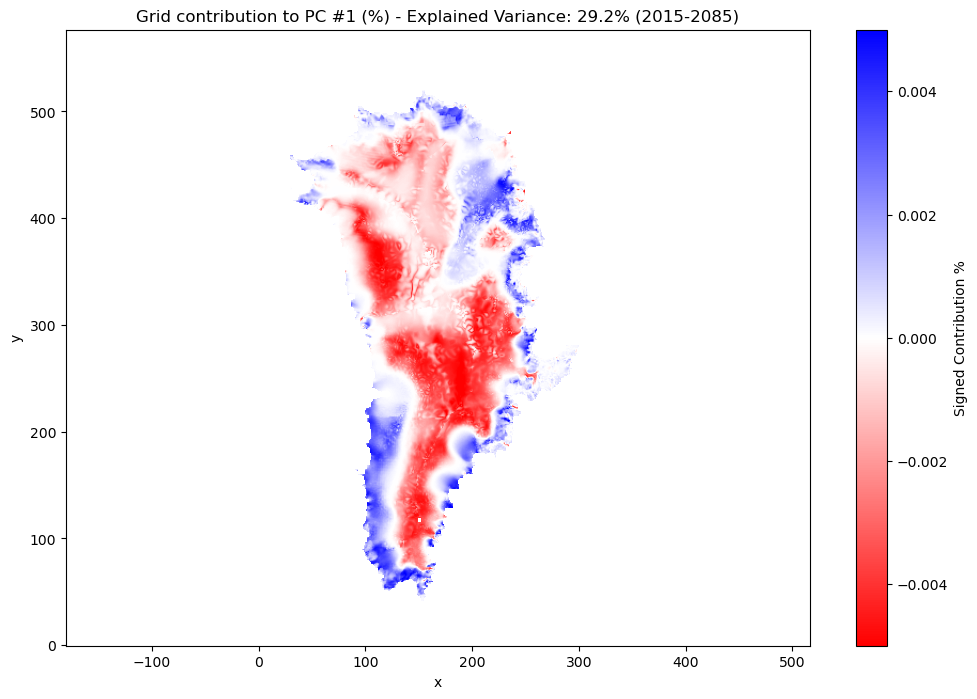

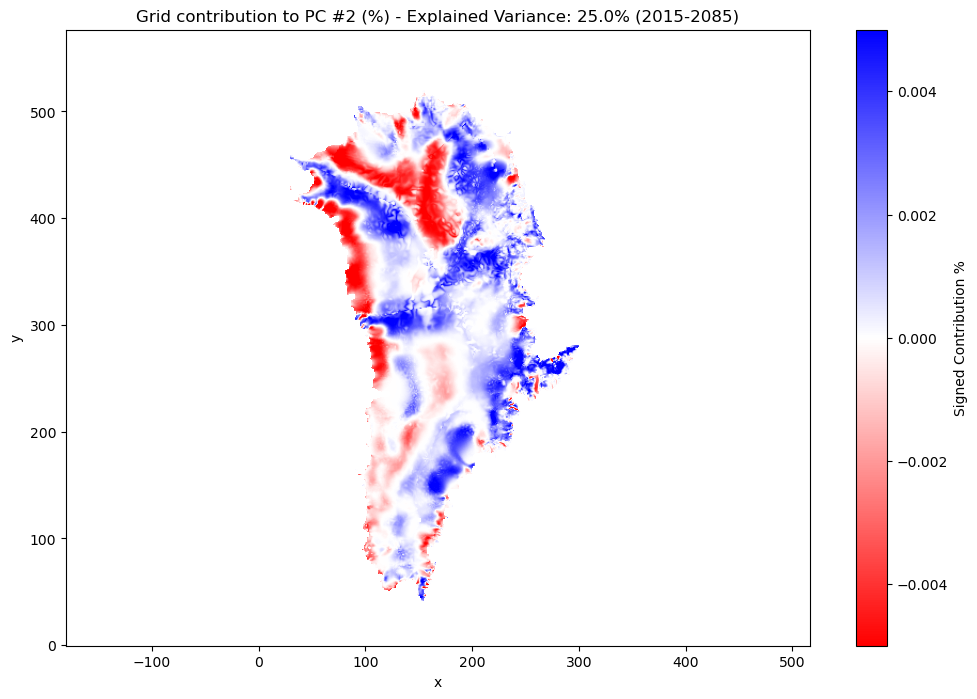

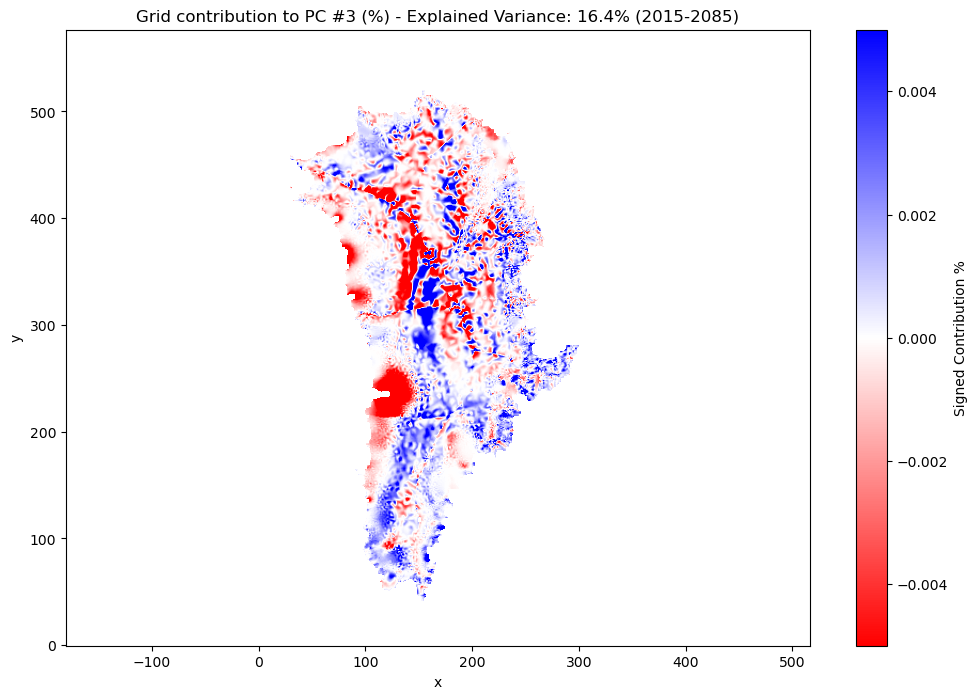

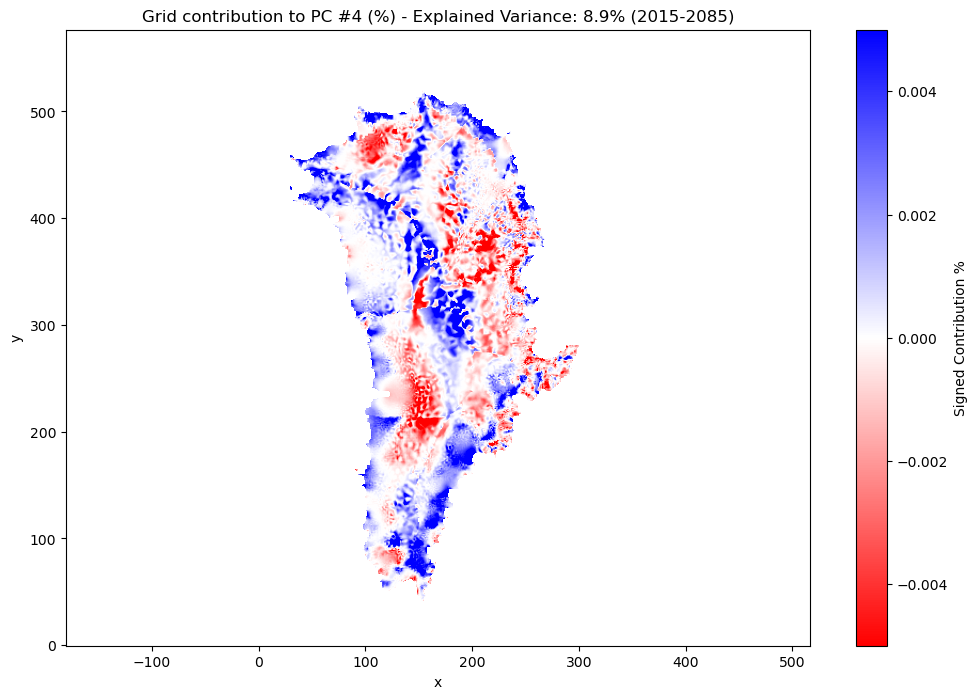


 Generating Sum of PC Vectors plot for 2015-2085...


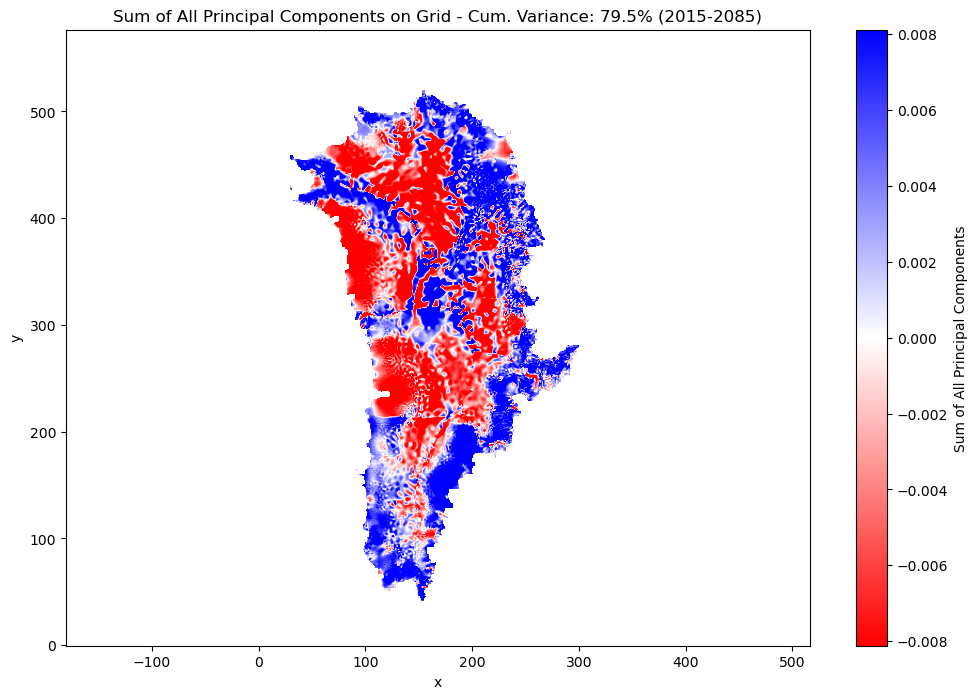


 Processing: 2015-2100...


C:\Users\benra\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\benra\AppData\Local\Temp\ipykernel_5940\2842842716.py:91: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cluster_colors = [cm.get_cmap('Set1')(i) for i in range(n_clusters)]


K-Means cluster results saved to: Research_Plots\exp05_lithk_plots\2015-2100\lithk_exp05_KMeans_Clusters_2015-2100.csv


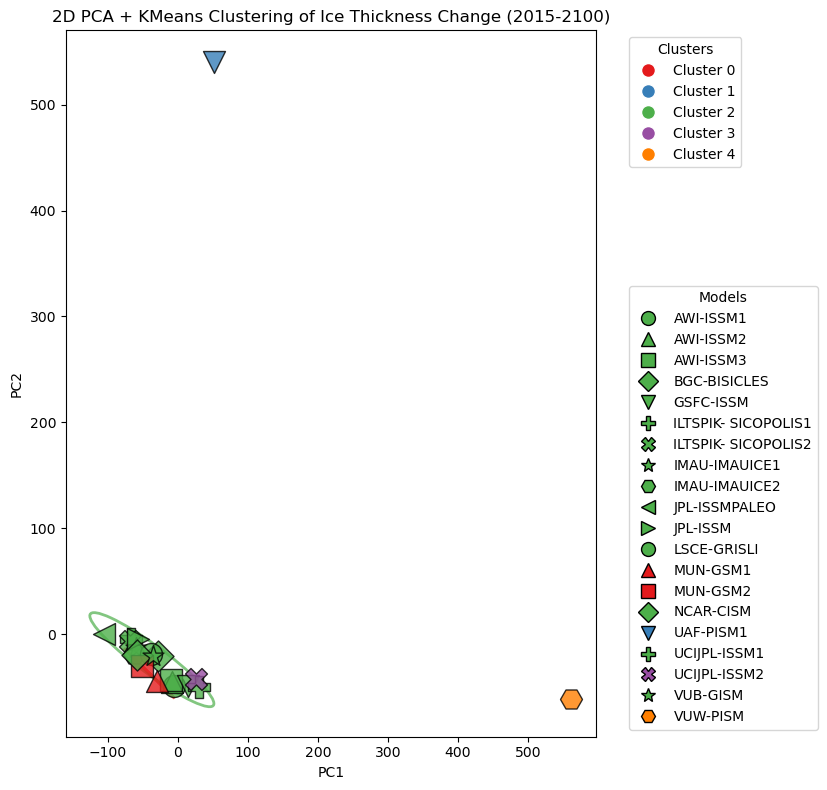

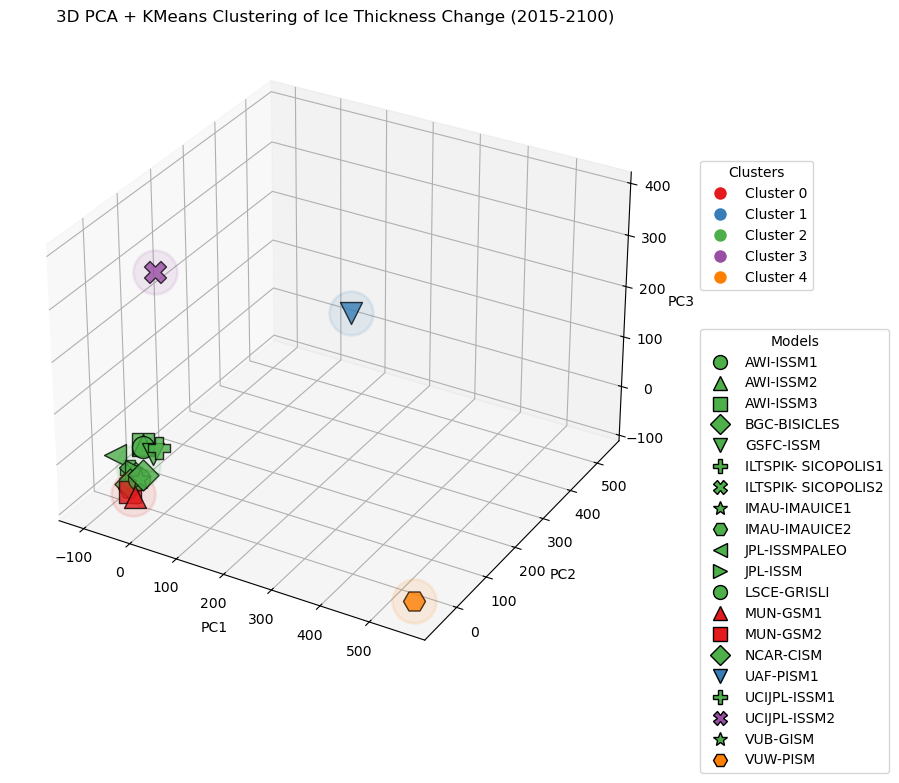

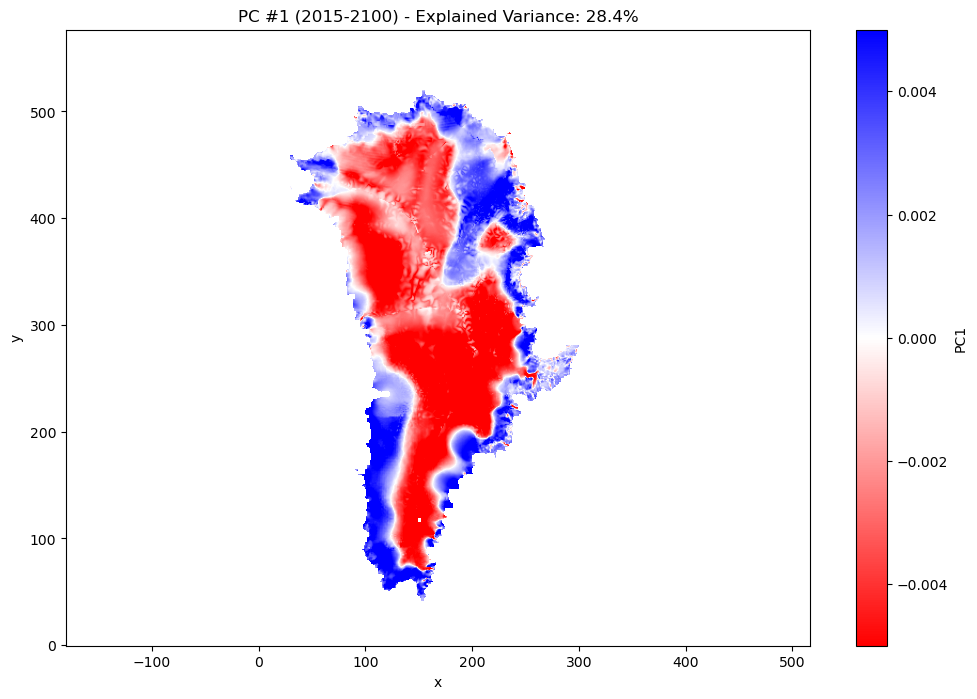

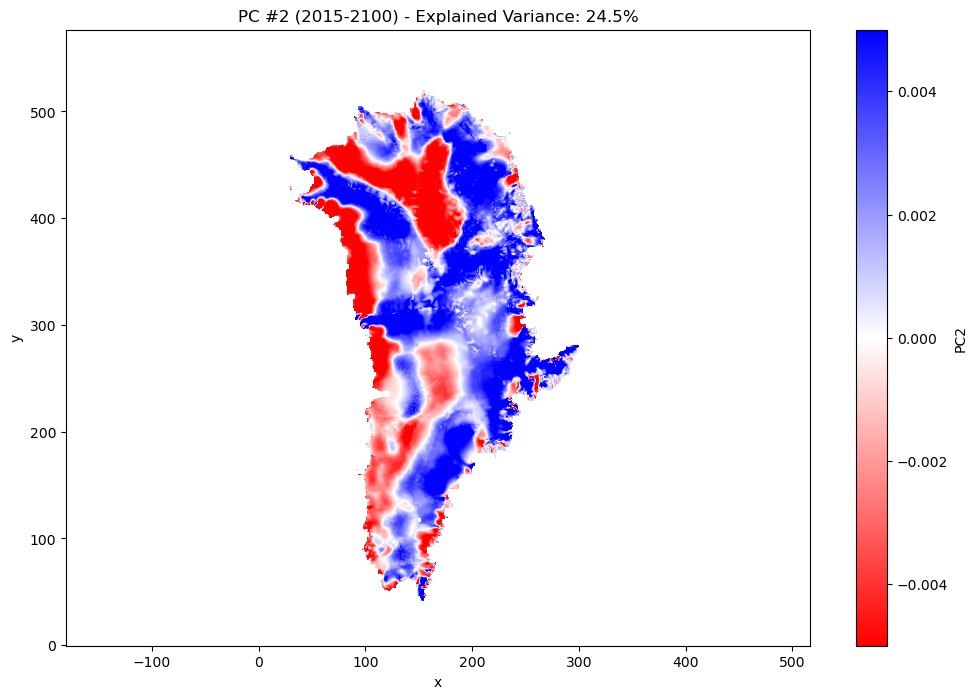

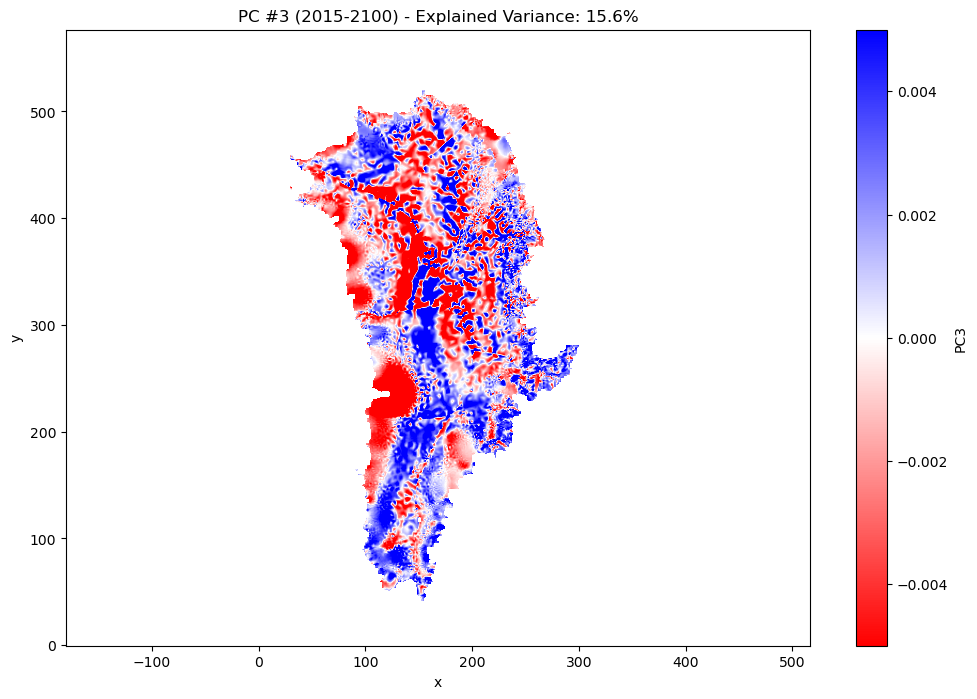

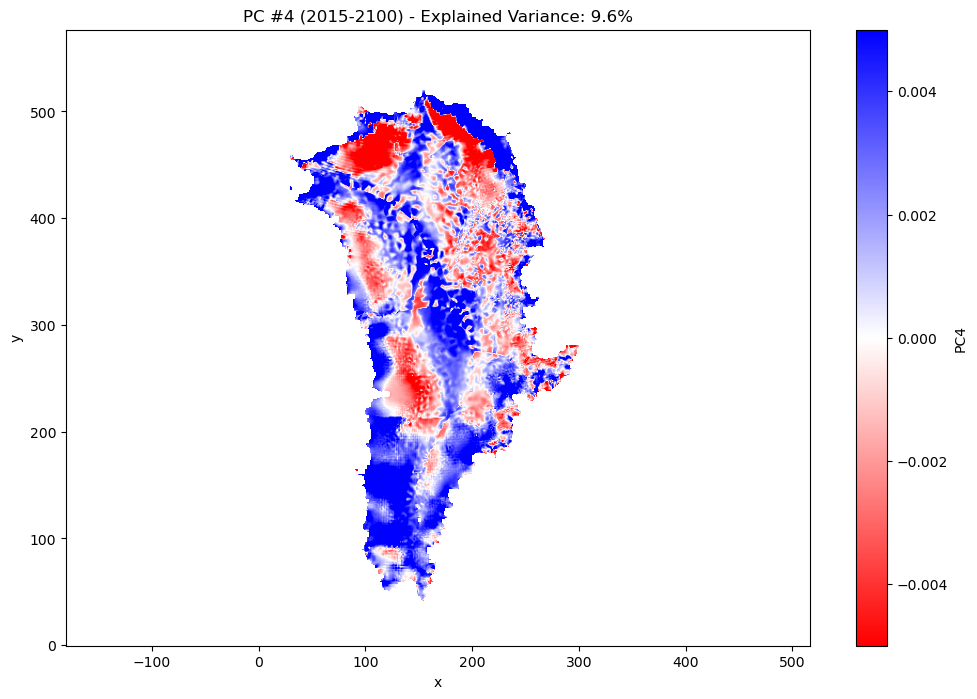

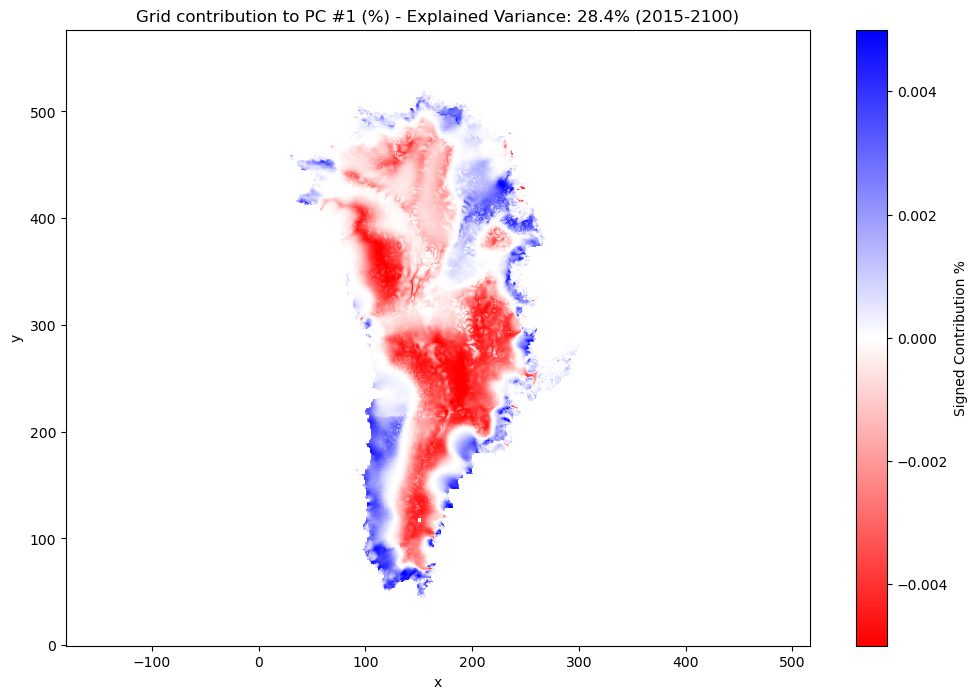

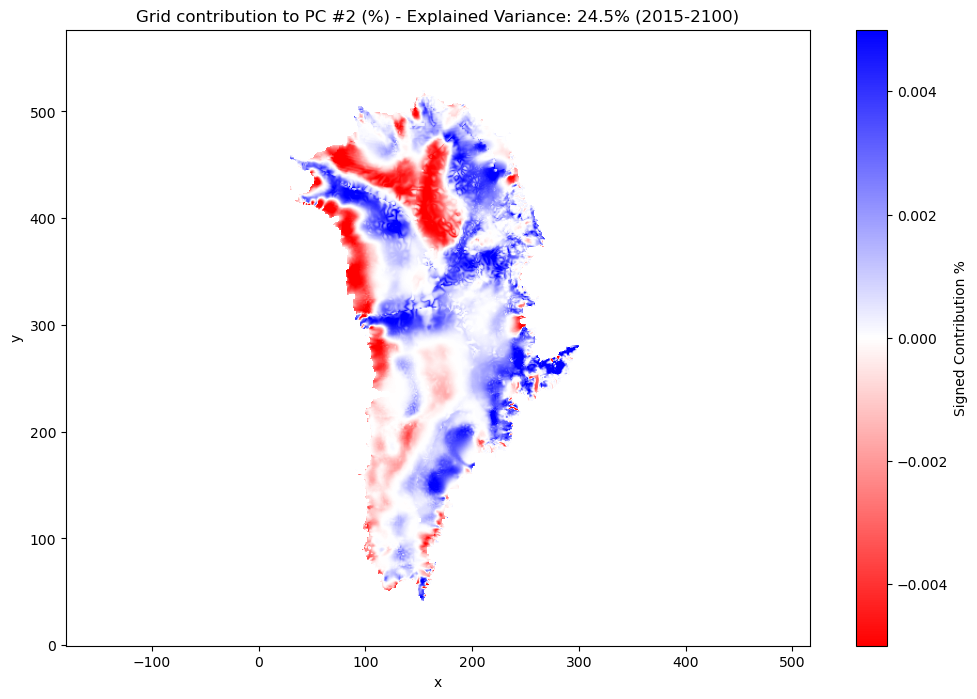

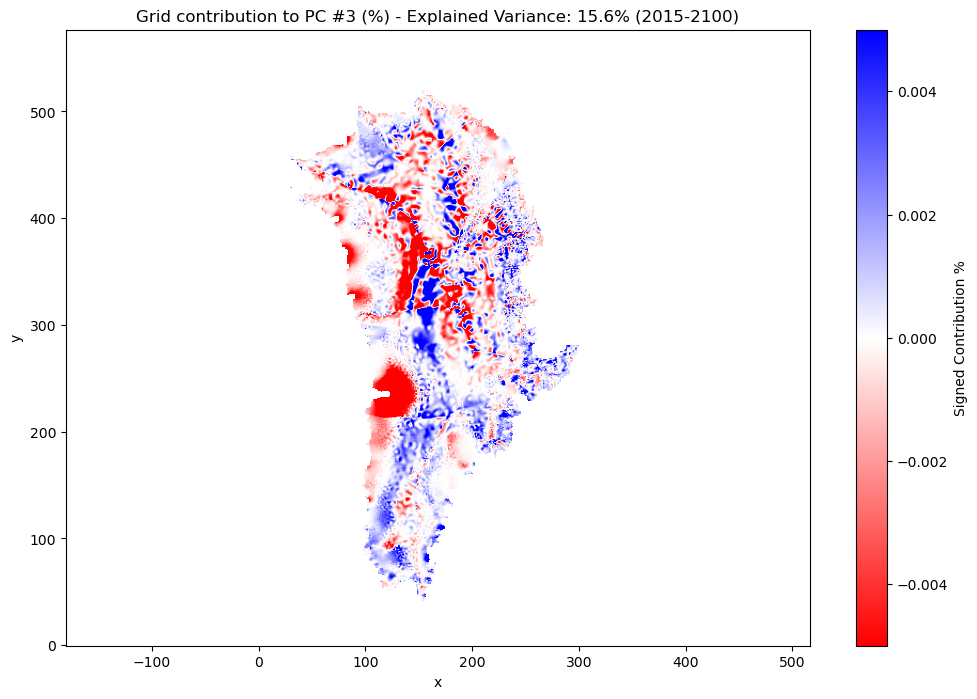

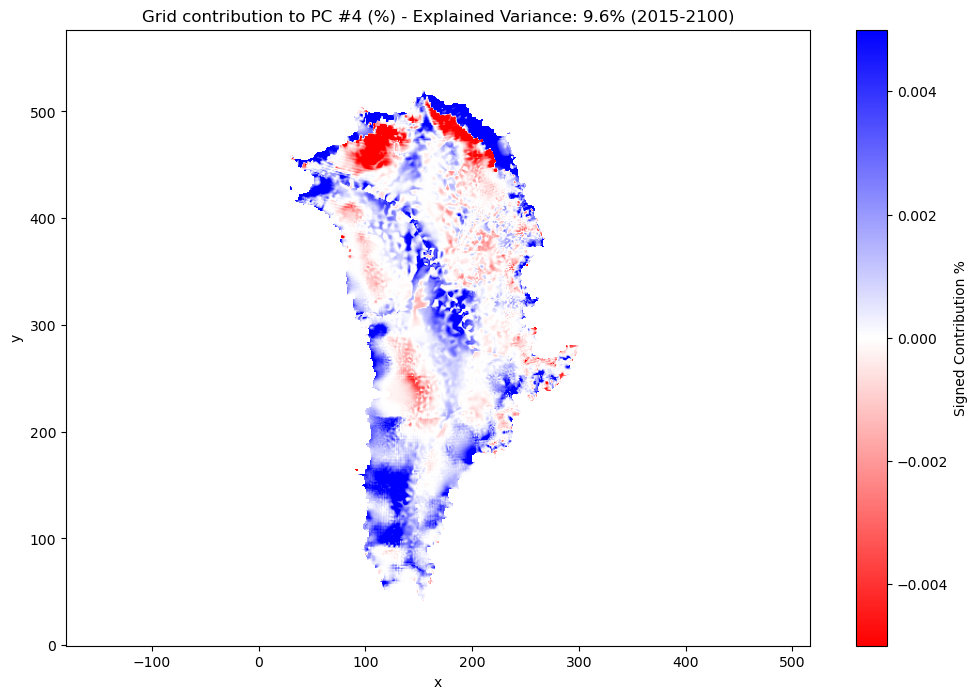


 Generating Sum of PC Vectors plot for 2015-2100...


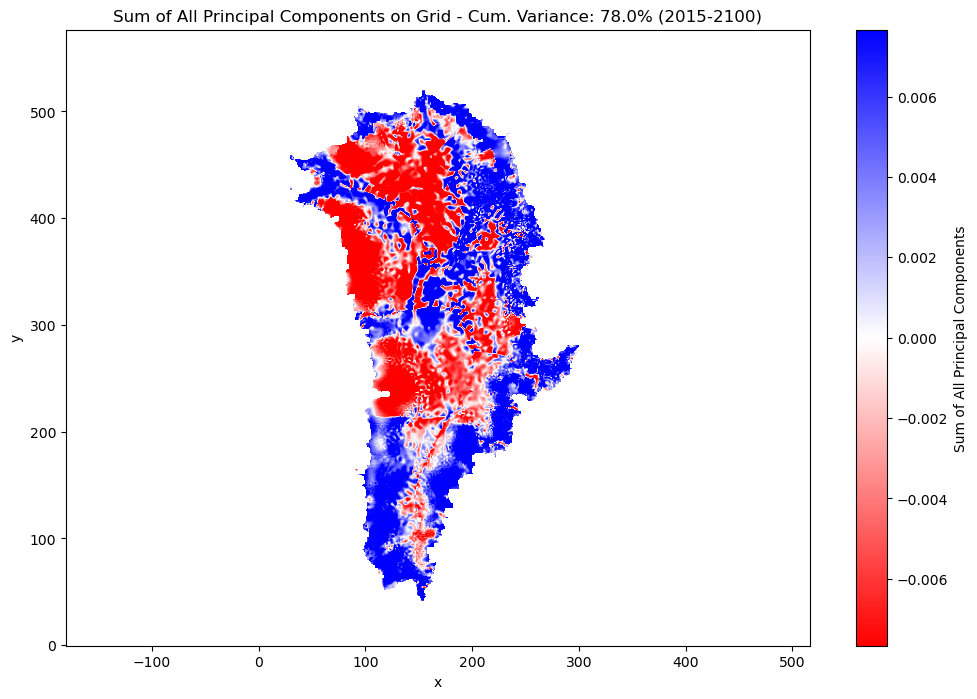

In [4]:
from matplotlib.patches import Ellipse # Import Ellipse for 2D
import scipy.stats as stats # For chi-squared for confidence ellipse scaling

# PCA, K-Means Clustering, and Plotting

# Define base output directory
base_output_dir = os.path.join("Research_Plots", f"{exp_id}_{var_name}_plots")
os.makedirs(base_output_dir, exist_ok=True)

# Loop over all time windows
for time_window_label, (start_idx, end_idx) in time_windows.items():
    print(f"\n Processing: {time_window_label}...")
    
    # Create directory for each time window
    folder_name = time_window_label.replace(" ", "_").replace("(","").replace(")", "")
    time_window_output_dir = os.path.join(base_output_dir, folder_name)
    os.makedirs(time_window_output_dir, exist_ok=True)

    # --- IMPORTANT: Get grid coordinates from the first model in var_list ---
    # This ensures x_coords and y_coords are defined and correct for spatial plots
    # for this experiment. Assumes all models in var_list share the same grid.
    if var_list: # Check if var_list is not empty
        first_var_dataarray = var_list[0]
        # Attempt to get coordinates from the DataArray or its parent Dataset
        x_coords = first_var_dataarray['x'].values if 'x' in first_var_dataarray.coords else first_var_dataarray.coords['x'].values
        y_coords = first_var_dataarray['y'].values if 'y' in first_var_dataarray.coords else first_var_dataarray.coords['y'].values
        
        # Get grid dimensions for spatial plotting
        rows = len(y_coords)
        cols = len(x_coords)
        matrix_size = rows * cols
    else:
        print("Error: var_list is empty. Cannot get grid coordinates for plotting.")
        continue # Skip to next time window if no data

    # Step 1: Compute variable deltas for the current time window and remove NaNs
    current_window_deltas = []
    
    # Loop through each model's data array in var_list
    for i, var_model_data in enumerate(var_list):
        # Calculate delta for the current time window
        delta = var_model_data.isel(time=end_idx) - var_model_data.isel(time=start_idx)
        
        target_shape = (rows, cols) # Use the determined grid shape

        # Resize to target shape before flattening
        delta_array = delta.values if hasattr(delta, 'values') else delta
        resized_delta = resize(delta_array, target_shape, anti_aliasing=True)
        flat_delta = resized_delta.flatten()
        
        current_window_deltas.append(flat_delta)

    all_deltas = np.stack(current_window_deltas)
    mask = ~np.any(np.isnan(all_deltas), axis=0)
    data_matrix = all_deltas[:, mask]  # Final clean matrix (n_models, n_valid_points)
    
    # Get valid grid indices based on the mask
    gd = np.where(mask)[0]

    # Step 2: PCA (This PCA describes the variability across all models for this time window)
    # Standardize

    scaler = StandardScaler()
    data_matrix_scaled = scaler.fit_transform(data_matrix)
    
    pca = PCA(n_components=n_components)
    pca_scores = pca.fit_transform(data_matrix_scaled)
    
    # Store these components, as they are the correct ones for spatial plotting
    correct_pca_components = pca.components_ # Flipped sign during pca/scaling

    # Step 3: K-Means
    kmeans = KMeans(n_clusters=n_clusters, random_state=0, n_init='auto') 
    labels = kmeans.fit_predict(pca_scores)
    
    # Create a DataFrame to store model names and their cluster labels
    cluster_results_df = pd.DataFrame({
        'Model': participating_models,
        'Cluster_Label': labels
    })

    # Define the output path for the CSV file
    csv_filename = os.path.join(time_window_output_dir, f"{var_name}_{exp_id}_KMeans_Clusters_{folder_name}.csv")

    # Save the DataFrame to a CSV file
    cluster_results_df.to_csv(csv_filename, index=False)
    print(f"K-Means cluster results saved to: {csv_filename}")

    # --- Improved Cluster Color Selection ---
    if n_clusters <= 9:
        cluster_colors = [cm.get_cmap('Set1')(i) for i in range(n_clusters)]
    elif n_clusters <= 12:
        cluster_colors = [cm.get_cmap('Set3')(i) for i in range(n_clusters)]
    else:
        print("Warning: Number of clusters is greater than 12. Color distinctness may still be challenging for some due to limitations of visual perception.")
        cluster_colors = [cm.get_cmap('hsv')(i/n_clusters) for i in range(n_clusters)]

    # Define a set of markers
    markers = itertools.cycle(('o', '^', 's', 'D', 'v', 'P', 'X', '*', 'H', '<', '>'))
    
    # Use participating_models for mapping markers and for the legend
    model_to_marker = {model: next(markers) for model in participating_models}

    # --- Step 4a: Plot PCA result in 2D (PC1 vs PC2) with Ellipses ---
    fig_2d, ax_2d = plt.subplots(figsize=(10, 8))

    # Loop through participating_models to ensure correct labels
    for i, model_name in enumerate(participating_models): 
        cluster_id = labels[i]
        color = cluster_colors[cluster_id] # Use the distinct cluster colors
        marker = model_to_marker[model_name]

        # Plot with larger markers (s=150)
        ax_2d.scatter(
            pca_scores[i, 0],
            pca_scores[i, 1],
            c=[color],
            marker=marker,
            label=None, # Set to None here, labels are for custom legend handles below
            s=250, # Increased marker size
            edgecolor='black',
            alpha=0.8
        )
    
    # --- Add Ellipses for each Cluster in 2D Plot ---
    # Chi-squared critical value for 95% confidence with 2 degrees of freedom
    confidence_level = 0.95
    chi2_val = stats.chi2.ppf(confidence_level, df=2) 
    
    for cluster_id in np.unique(labels):
        cluster_points = pca_scores[labels == cluster_id, :2] # Select points for this cluster (PC1, PC2)
        
        if len(cluster_points) < 2: # Need at least 2 points to compute covariance
            continue 

        centroid = np.mean(cluster_points, axis=0)
        covariance = np.cov(cluster_points, rowvar=False)

        eigenvalues, eigenvectors = np.linalg.eigh(covariance)
        
        # Sort eigenvalues and eigenvectors in descending order for correct orientation
        order = eigenvalues.argsort()[::-1]
        eigenvalues = eigenvalues[order]
        eigenvectors = eigenvectors[:, order]

        # Calculate angle of rotation for the ellipse
        angle = np.degrees(np.arctan2(*eigenvectors[:, 0][::-1]))

        # Calculate width and height of the ellipse axes
        width = 2 * np.sqrt(eigenvalues[0] * chi2_val) # Major axis
        height = 2 * np.sqrt(eigenvalues[1] * chi2_val) # Minor axis

        ellipse_color = cluster_colors[cluster_id]
        ellipse = Ellipse(xy=centroid, width=width, height=height, 
                          angle=angle, edgecolor=ellipse_color, fc='None', 
                          lw=2, alpha=0.7, zorder=0) # zorder to keep it behind points
        ax_2d.add_patch(ellipse)
        
    # Create a custom legend for clusters and models
    # For clusters
    cluster_legend_handles = []
    for i in range(n_clusters):
        cluster_legend_handles.append(plt.Line2D([0], [0], marker='o', color='w', 
                                                 markerfacecolor=cluster_colors[i], markersize=10, 
                                                 label=f'Cluster {i}'))
    
    # For models - ENSURE MARKER COLOR MATCHES PLOT COLOR
    model_legend_handles = []
    for i, model_name in enumerate(participating_models):
        cluster_id = labels[i] # Get the cluster ID for the current model
        model_color = cluster_colors[cluster_id] # Get the color associated with that cluster
        model_legend_handles.append(plt.Line2D([0], [0], marker=model_to_marker[model_name], color='w', 
                                                markerfacecolor=model_color, # Use the model's cluster color here
                                                markersize=10, 
                                                label=model_name, markeredgecolor='black'))

    # Add the cluster legend
    first_legend = ax_2d.legend(handles=cluster_legend_handles, loc='upper left', title='Clusters', bbox_to_anchor=(1.05, 1))
    ax_2d.add_artist(first_legend) # Add the first legend manually to allow a second one

    # Add the model legend
    ax_2d.legend(handles=model_legend_handles, loc='lower left', title='Models', bbox_to_anchor=(1.05, 0))


    ax_2d.set_xlabel("PC1")
    ax_2d.set_ylabel("PC2")
    ax_2d.set_title(f"2D PCA + KMeans Clustering of Ice Thickness Change ({time_window_label})")
    plt.tight_layout(rect=[0, 0, 0.85, 1]) # Adjust layout to make space for the legend
    
    # Save 2D plot
    pca_2d_plot_filename = os.path.join(time_window_output_dir, f"{var_name}_{exp_id}_PCA_KMeans_2D_{folder_name}.png")
    plt.savefig(pca_2d_plot_filename, bbox_inches='tight', dpi=300)
    
    plt.show()

    # --- Step 4b: Plot PCA result in 3D with Transparent Centroid Markers ---
    fig_3d = plt.figure(figsize=(12, 8))
    ax_3d = fig_3d.add_subplot(111, projection='3d')

    # Loop through participating_models to ensure correct labels and apply new settings
    for i, model_name in enumerate(participating_models): 
        cluster_id = labels[i]
        color = cluster_colors[cluster_id] # Use the distinct cluster colors
        marker = model_to_marker[model_name]

        # Plot with larger markers (s=150)
        ax_3d.scatter(
            pca_scores[i, 0],
            pca_scores[i, 1],
            pca_scores[i, 2],
            c=[color],
            marker=marker,
            label=None, # Labels are for custom legend handles
            s=250, # Increased marker size
            edgecolor='black',
            alpha=0.8
        )

    # --- Add large, transparent markers at cluster centroids in 3D ---
    for cluster_id in np.unique(labels):
        cluster_points_3d = pca_scores[labels == cluster_id, :] # Select points for this cluster (PC1, PC2, PC3)
        
        if len(cluster_points_3d) > 0: # Ensure there are points in the cluster
            centroid_3d = np.mean(cluster_points_3d, axis=0)
            
            # Plot a large, transparent 'O' marker at the centroid
            ax_3d.scatter(
                centroid_3d[0],
                centroid_3d[1],
                centroid_3d[2],
                c=[cluster_colors[cluster_id]],
                marker='o', # Circular marker
                s=1000, # Very large size for the "circle" effect
                alpha=0.1, # Highly transparent
                edgecolor=cluster_colors[cluster_id], # Edge color matching cluster
                linewidth=2,
                zorder=0 # Place behind individual points
            )

    # Create a custom legend for clusters and models for 3D plot
    # For clusters
    cluster_legend_handles_3d = []
    for i in range(n_clusters):
        cluster_legend_handles_3d.append(plt.Line2D([0], [0], marker='o', color='w', 
                                                 markerfacecolor=cluster_colors[i], markersize=10, 
                                                 label=f'Cluster {i}'))
    
    # For models - ENSURE MARKER COLOR MATCHES PLOT COLOR
    model_legend_handles_3d = []
    for i, model_name in enumerate(participating_models):
        cluster_id = labels[i] # Get the cluster ID for the current model
        model_color = cluster_colors[cluster_id] # Get the color associated with that cluster
        model_legend_handles_3d.append(plt.Line2D([0], [0], marker=model_to_marker[model_name], color='w', 
                                                markerfacecolor=model_color, # Use the model's cluster color here
                                                markersize=10, 
                                                label=model_name, markeredgecolor='black'))

    # Add the cluster legend
    first_legend_3d = ax_3d.legend(handles=cluster_legend_handles_3d, loc='center left', title='Clusters', bbox_to_anchor=(1.05, 0.7))
    ax_3d.add_artist(first_legend_3d) # Add the first legend manually to allow a second one

    # Add the model legend
    ax_3d.legend(handles=model_legend_handles_3d, loc='center left', title='Models', bbox_to_anchor=(1.05, 0.2))


    ax_3d.set_xlabel("PC1")
    ax_3d.set_ylabel("PC2")
    ax_3d.set_zlabel("PC3")
    ax_3d.set_title(f"3D PCA + KMeans Clustering of Ice Thickness Change ({time_window_label})")
    plt.tight_layout(rect=[0, 0, 0.85, 1]) # Adjust layout to make space for the legend
    
    # Save 3D plot
    pca_plot_filename = os.path.join(time_window_output_dir, f"{var_name}_{exp_id}_PCA_KMeans_3D_{folder_name}.png")
    plt.savefig(pca_plot_filename, bbox_inches='tight', dpi=300)
    
    plt.show()
    
    # Step 5: Plot PCs onto the grid (USING COMPONENTS FROM STEP 2)
    for pc_idx in range(n_components):
        pc_values = correct_pca_components[pc_idx, :] 
        
        C = np.full(matrix_size, np.nan)
        C[gd.astype(int)] = pc_values
        pc_map = C.reshape((rows, cols)) 
        
        plt.figure(figsize=(12,8))
        
        vmax = 0.005 # Change for data visualization
        
        im = plt.imshow(pc_map, cmap='bwr_r', origin='lower', vmin=-vmax, vmax=vmax)
        plt.colorbar(im, label=f'PC{pc_idx + 1}')
        plt.xlabel('x')
        plt.ylabel('y')
        plt.title(f'PC #{pc_idx + 1} ({time_window_label}) - Explained Variance: {pca.explained_variance_ratio_[pc_idx]*100:.1f}%')
        plt.axis('equal')
        
        pc_plot_filename = os.path.join(time_window_output_dir, f"{var_name}_{exp_id}_PC_{pc_idx + 1}_{folder_name}.png")
        plt.savefig(pc_plot_filename, bbox_inches='tight', dpi=300)
        
        plt.show()
    
    # Step 6: Plot signed contribution of each PC onto the grid (USING COMPONENTS FROM STEP 2)
    for pc_idx in range(n_components):
        pc_values = correct_pca_components[pc_idx, :] 
        
        # Convert to signed % contribution
        # Ensure sum of squares is not zero to avoid division by zero
        sum_sq_pc = np.sum(pc_values ** 2)
        if sum_sq_pc == 0:
            signed_contrib = np.zeros_like(pc_values)
        else:
            signed_contrib = 100 * np.sign(pc_values) * (pc_values ** 2) / sum_sq_pc
        
        C = np.full(matrix_size, np.nan)
        C[gd.astype(int)] = signed_contrib
        sc_map = C.reshape((rows, cols))
        
        plt.figure(figsize=(12,8))
        
        vmax = 0.005 # Change for data visualization
        
        im = plt.imshow(sc_map, cmap='bwr_r', origin='lower', vmin=-vmax, vmax=vmax)
        plt.colorbar(im, label='Signed Contribution %')
        plt.xlabel('x')
        plt.ylabel('y')
        plt.title(f'Grid contribution to PC #{pc_idx + 1} (%) - Explained Variance: {pca.explained_variance_ratio_[pc_idx]*100:.1f}% ({time_window_label})')
        plt.axis('equal')
        
        sc_plot_filename = os.path.join(time_window_output_dir, f"{var_name}_{exp_id}_Signed_Contrib_PC{pc_idx + 1}_{folder_name}.png")
        plt.savefig(sc_plot_filename, bbox_inches='tight', dpi=300)
        
        plt.show()
    
    # --- Step 7: Plotting the Sum of PC Vectors onto the grid ---
    print(f"\n Generating Sum of PC Vectors plot for {time_window_label}...")

    # Calculate the sum of all principal component values for each grid point
    # correct_pca_components has shape (n_components, n_valid_points)
    # Summing along axis=0 adds up the PC values for each grid point across all components
    summed_pc_values = np.sum(correct_pca_components, axis=0)
    ex_var = pca.explained_variance_ratio_
    cum_ex_var = np.cumsum(ex_var)
    cumulative_variance_of_first_four = cum_ex_var[3] 

    # Create a grid of NaNs and insert the summed PC values at valid grid indices (gd)
    C_summed = np.full(matrix_size, np.nan)
    C_summed[gd.astype(int)] = summed_pc_values
    summed_pc_map = C_summed.reshape((rows, cols)) # Reshape to 2D grid

    # Plotting the summed PC map
    plt.figure(figsize=(12,8))
    
    # Determine a suitable vmax dynamically for the colorbar
    # Using np.percentile can help avoid extreme outliers in color scaling
    vmax_summed = np.percentile(np.abs(summed_pc_values[~np.isnan(summed_pc_values)]), 99) * 0.5 # Using 99th percentile for robust scaling
    if vmax_summed == 0: vmax_summed = 0.01 # Fallback for cases with no variance

    im = plt.imshow(summed_pc_map, cmap='bwr_r', origin='lower', vmin=-vmax_summed, vmax=vmax_summed)
    plt.colorbar(im, label='Sum of All Principal Components')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title(f'Sum of All Principal Components on Grid - Cum. Variance: {cumulative_variance_of_first_four*100:.1f}% ({time_window_label})')
    plt.axis('equal')
    
    # Save the plot
    summed_pc_plot_filename = os.path.join(time_window_output_dir, f"{var_name}_{exp_id}_Summed_PCs_{folder_name}.png")
    plt.savefig(summed_pc_plot_filename, bbox_inches='tight', dpi=300)
    
    plt.show()

 


 Processing: 2015-2025...
 
Cluster distribution: 
cluster
0     2
1     1
2    15
3     1
4     1
Name: count, dtype: int64

INTRA-CLUSTER SIMILARITIES

--- Feature: Numerics ---
cluster  Numerics 
0        FD/FV(5*)    1.000000
1        FD           1.000000
2        FE           0.533333
         FD           0.400000
         FV           0.066667
3        FE           1.000000
4        FD           1.000000
Name: proportion, dtype: float64


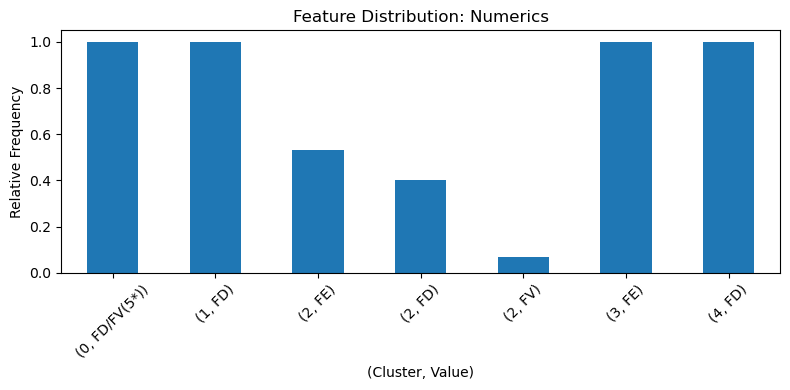

    Cluster 0 is commonly characterized by: Numerics='FD/FV(5*)' (100% of models)
    Cluster 1 is commonly characterized by: Numerics='FD' (100% of models)
    Cluster 2 is commonly characterized by: Numerics='FE' (53% of models)
    Cluster 3 is commonly characterized by: Numerics='FE' (100% of models)
    Cluster 4 is commonly characterized by: Numerics='FD' (100% of models)

--- Feature: Ice flow ---
cluster  Ice flow
0        HYB         1.000000
1        HYB         1.000000
2        HO          0.333333
         SIA         0.266667
         HYB         0.200000
         SSA         0.200000
3        HO          1.000000
4        HYB         1.000000
Name: proportion, dtype: float64


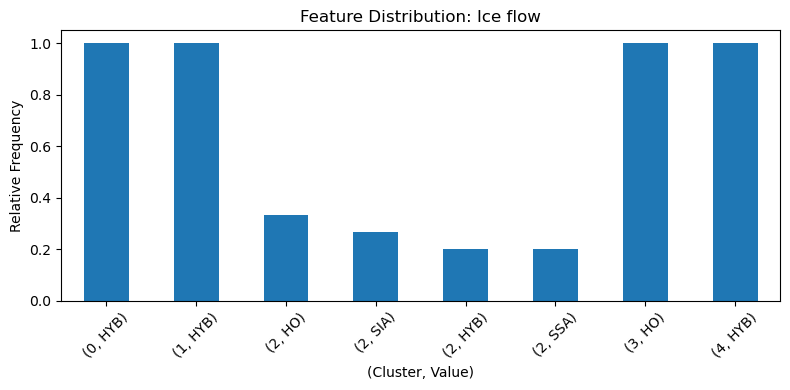

    Cluster 0 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 1 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 3 is commonly characterized by: Ice flow='HO' (100% of models)
    Cluster 4 is commonly characterized by: Ice flow='HYB' (100% of models)

--- Feature: Initialisation ---
cluster  Initialisation
0        CYC/NDm           1.000000
1        CYC/NDs(7*)       1.000000
2        DAv               0.466667
         CYC/NDs           0.133333
         SP/NDm            0.133333
         CYC/DAi(7*)       0.066667
         SP/DAi            0.066667
         SP/DAs(7*)        0.066667
         SP/DAv(3*)        0.066667
3        DAv               1.000000
4        SP/NDs(7*)        1.000000
Name: proportion, dtype: float64


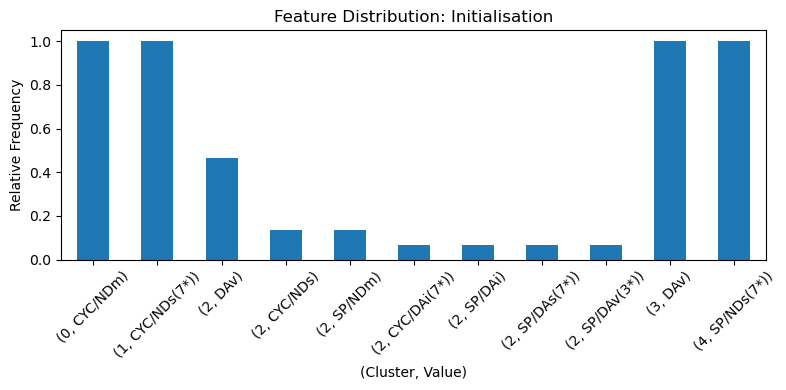

    Cluster 0 is commonly characterized by: Initialisation='CYC/NDm' (100% of models)
    Cluster 1 is commonly characterized by: Initialisation='CYC/NDs(7*)' (100% of models)
    Cluster 3 is commonly characterized by: Initialisation='DAv' (100% of models)
    Cluster 4 is commonly characterized by: Initialisation='SP/NDs(7*)' (100% of models)

--- Feature: Initial year ---
cluster  Initial year
0        1980            1.000000
1        2008            1.000000
2        1990            0.600000
         1979            0.133333
         2007            0.133333
         1995            0.066667
         2000            0.066667
3        2007            1.000000
4        2000            1.000000
Name: proportion, dtype: float64


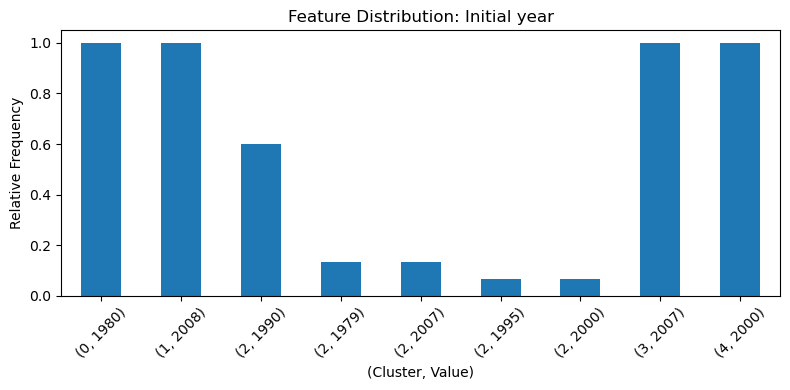

    Cluster 0 is commonly characterized by: Initial year='1980' (100% of models)
    Cluster 1 is commonly characterized by: Initial year='2008' (100% of models)
    Cluster 2 is commonly characterized by: Initial year='1990' (60% of models)
    Cluster 3 is commonly characterized by: Initial year='2007' (100% of models)
    Cluster 4 is commonly characterized by: Initial year='2000' (100% of models)

--- Feature: Initial SMB ---
cluster  Initial SMB
0        MAR            1.000000
1        RA1            1.000000
2        RA3            0.400000
         MAR            0.200000
         ISMB           0.133333
         BOX/MAR(2*)    0.066667
         BOX/RA3(4*)    0.066667
         HIR            0.066667
         RA1            0.066667
3        RA1            1.000000
4        RA1            1.000000
Name: proportion, dtype: float64


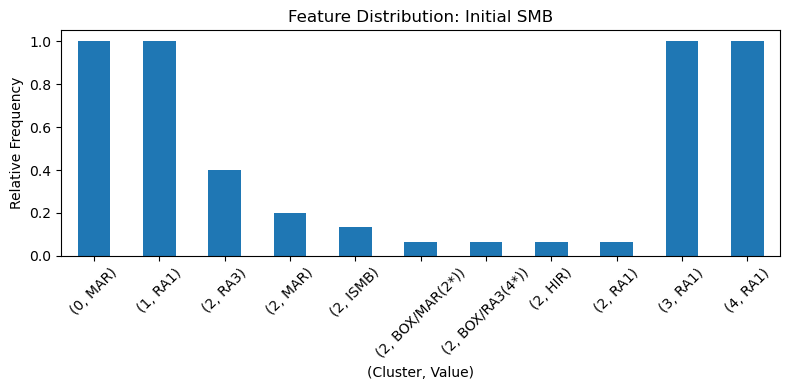

    Cluster 0 is commonly characterized by: Initial SMB='MAR' (100% of models)
    Cluster 1 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 3 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 4 is commonly characterized by: Initial SMB='RA1' (100% of models)

--- Feature: Velocity ---
cluster  Velocity
2        J           0.6
         RM          0.4
3        RM          1.0
Name: proportion, dtype: float64


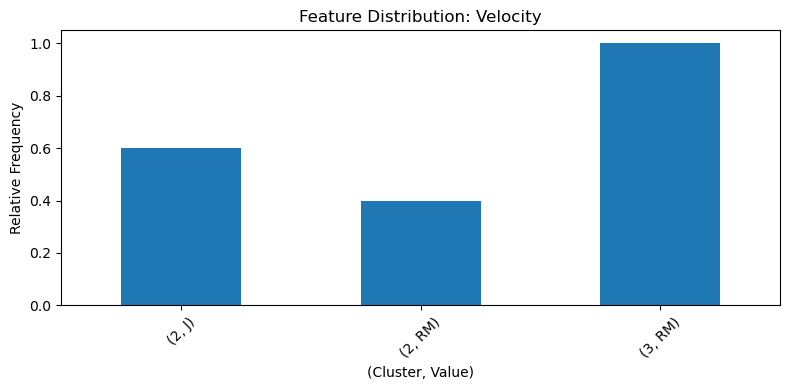

    Cluster 2 is commonly characterized by: Velocity='J' (60% of models)
    Cluster 3 is commonly characterized by: Velocity='RM' (100% of models)

--- Feature: Bed ---
cluster  Bed
0        B      1.0
1        M      1.0
2        M      1.0
3        M      1.0
4        M      1.0
Name: proportion, dtype: float64


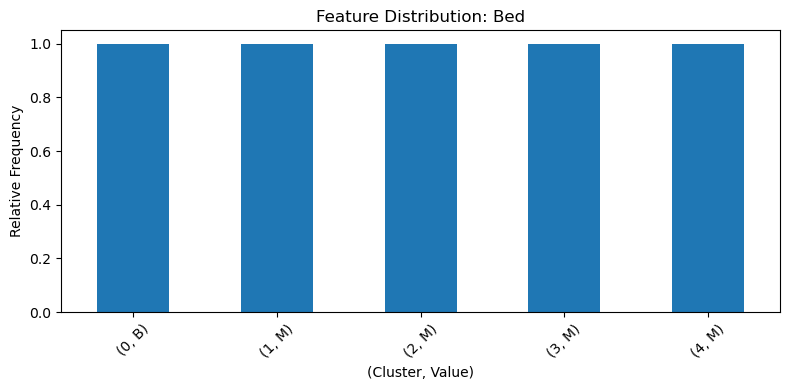

    Cluster 0 is commonly characterized by: Bed='B' (100% of models)
    Cluster 1 is commonly characterized by: Bed='M' (100% of models)
    Cluster 2 is commonly characterized by: Bed='M' (100% of models)
    Cluster 3 is commonly characterized by: Bed='M' (100% of models)
    Cluster 4 is commonly characterized by: Bed='M' (100% of models)

--- Feature: Surface/ Thickness ---
cluster  Surface/ Thickness
1        M                     1.0
2        M                     1.0
Name: proportion, dtype: float64


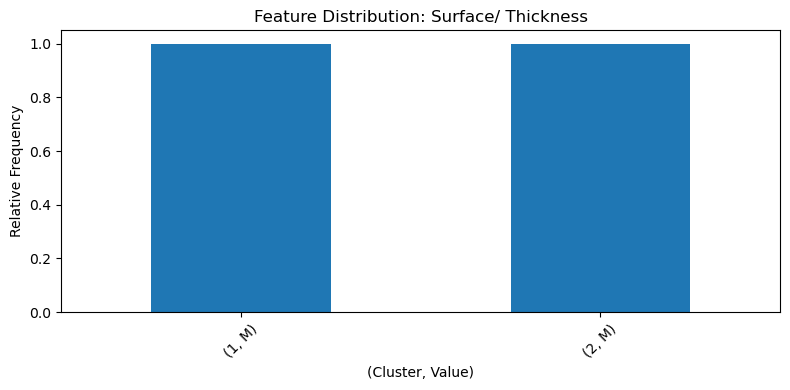

    Cluster 1 is commonly characterized by: Surface/ Thickness='M' (100% of models)
    Cluster 2 is commonly characterized by: Surface/ Thickness='M' (100% of models)

--- Feature: GH F ---
cluster  GH F
0        MIX     1.000000
1        SR      1.000000
2        SR      0.642857
         G       0.357143
3        SR      1.000000
4        SR      1.000000
Name: proportion, dtype: float64


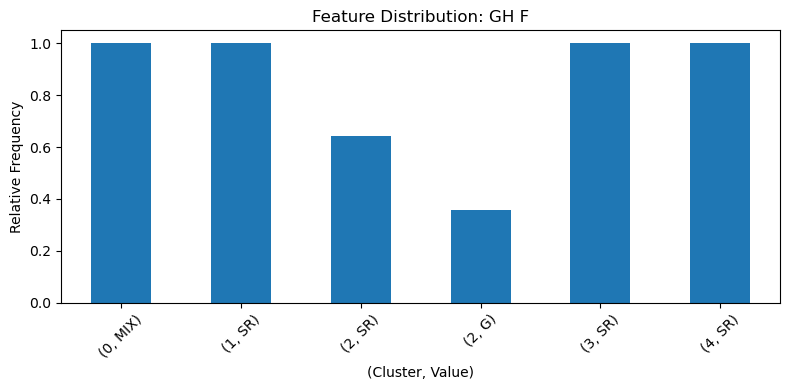

    Cluster 0 is commonly characterized by: GH F='MIX' (100% of models)
    Cluster 1 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 2 is commonly characterized by: GH F='SR' (64% of models)
    Cluster 3 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 4 is commonly characterized by: GH F='SR' (100% of models)

--- Feature: Res min ---
cluster  Res min
0        5          1.000000
1        0.9        1.000000
2        5          0.266667
         1(1*)      0.133333
         0.25       0.066667
         0.5        0.066667
         0.75       0.066667
         1          0.066667
         1.2        0.066667
         16         0.066667
         3          0.066667
         4          0.066667
         8          0.066667
3        0.2        1.000000
4        2          1.000000
Name: proportion, dtype: float64


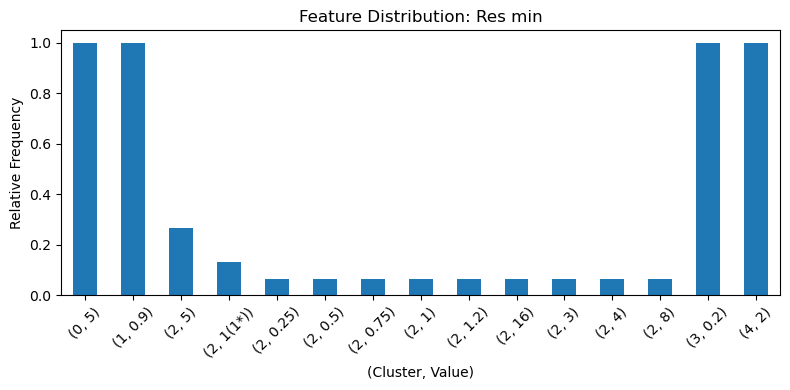

    Cluster 0 is commonly characterized by: Res min='5' (100% of models)
    Cluster 1 is commonly characterized by: Res min='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res min='0.2' (100% of models)
    Cluster 4 is commonly characterized by: Res min='2' (100% of models)

--- Feature: Res max ---
cluster  Res max
0        14(6*)     1.000000
1        0.9        1.000000
2        5          0.266667
         7.5        0.200000
         30         0.133333
         15         0.066667
         16         0.066667
         25         0.066667
         4          0.066667
         4.8        0.066667
         8          0.066667
3        20         1.000000
4        2          1.000000
Name: proportion, dtype: float64


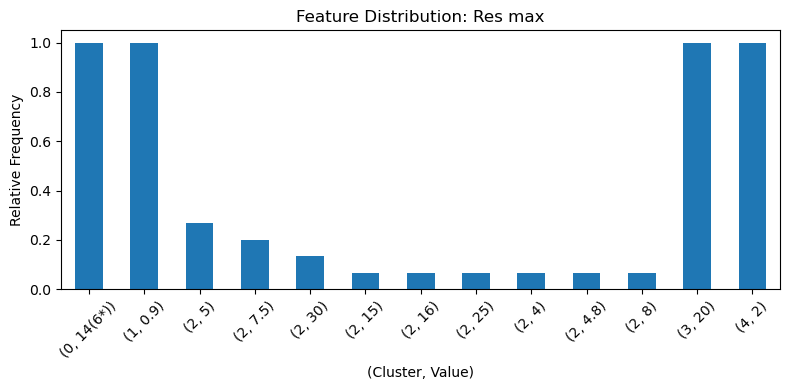

    Cluster 0 is commonly characterized by: Res max='14(6*)' (100% of models)
    Cluster 1 is commonly characterized by: Res max='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res max='20' (100% of models)
    Cluster 4 is commonly characterized by: Res max='2' (100% of models)

INTER-CLUSTER DIFFERENCES

===Features that differ between clusters (based on 50% threshold)===

 Feature: Numerics
  - Cluster 0 → 'FD/FV(5*)'
  - Cluster 1 → 'FD'
  - Cluster 2 → 'FE'
  - Cluster 3 → 'FE'
  - Cluster 4 → 'FD'

 Feature: Ice flow
  - Cluster 0 → 'HYB'
  - Cluster 1 → 'HYB'
  - Cluster 3 → 'HO'
  - Cluster 4 → 'HYB'

 Feature: Initialisation
  - Cluster 0 → 'CYC/NDm'
  - Cluster 1 → 'CYC/NDs(7*)'
  - Cluster 3 → 'DAv'
  - Cluster 4 → 'SP/NDs(7*)'

 Feature: Initial year
  - Cluster 0 → '1980'
  - Cluster 1 → '2008'
  - Cluster 2 → '1990'
  - Cluster 3 → '2007'
  - Cluster 4 → '2000'

 Feature: Initial SMB
  - Cluster 0 → 'MAR'
  - Cluster 1 → 'RA1'
  - Cluster 3 → 'RA1'
  -

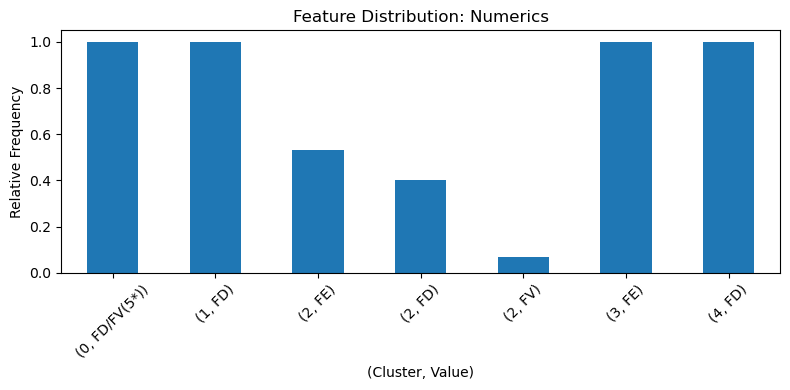

    Cluster 0 is commonly characterized by: Numerics='FD/FV(5*)' (100% of models)
    Cluster 1 is commonly characterized by: Numerics='FD' (100% of models)
    Cluster 2 is commonly characterized by: Numerics='FE' (53% of models)
    Cluster 3 is commonly characterized by: Numerics='FE' (100% of models)
    Cluster 4 is commonly characterized by: Numerics='FD' (100% of models)

--- Feature: Ice flow ---
cluster  Ice flow
0        HYB         1.000000
1        HYB         1.000000
2        HO          0.333333
         SIA         0.266667
         HYB         0.200000
         SSA         0.200000
3        HO          1.000000
4        HYB         1.000000
Name: proportion, dtype: float64


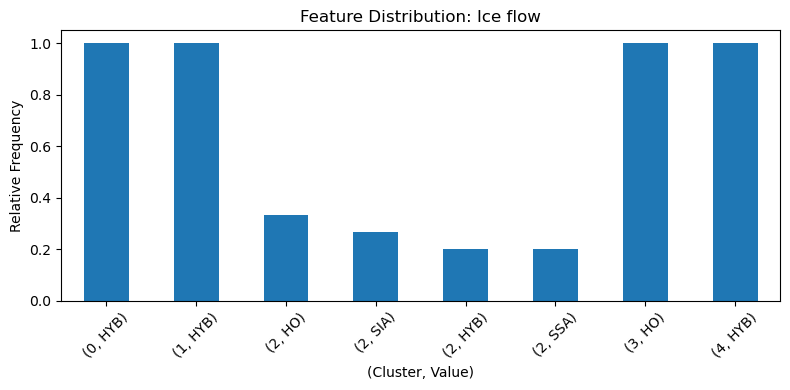

    Cluster 0 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 1 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 3 is commonly characterized by: Ice flow='HO' (100% of models)
    Cluster 4 is commonly characterized by: Ice flow='HYB' (100% of models)

--- Feature: Initialisation ---
cluster  Initialisation
0        CYC/NDm           1.000000
1        CYC/NDs(7*)       1.000000
2        DAv               0.466667
         CYC/NDs           0.133333
         SP/NDm            0.133333
         CYC/DAi(7*)       0.066667
         SP/DAi            0.066667
         SP/DAs(7*)        0.066667
         SP/DAv(3*)        0.066667
3        DAv               1.000000
4        SP/NDs(7*)        1.000000
Name: proportion, dtype: float64


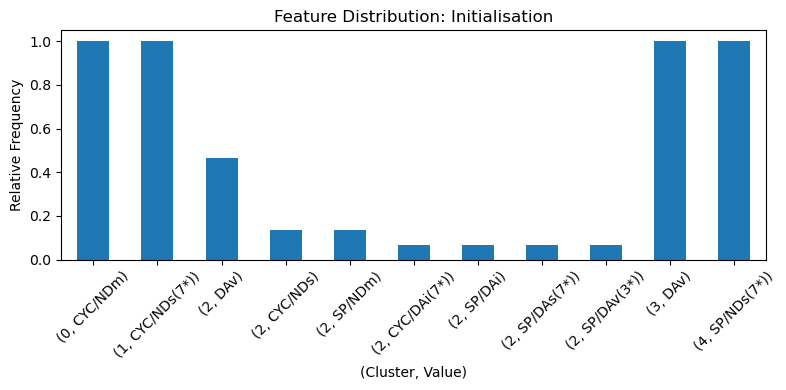

    Cluster 0 is commonly characterized by: Initialisation='CYC/NDm' (100% of models)
    Cluster 1 is commonly characterized by: Initialisation='CYC/NDs(7*)' (100% of models)
    Cluster 3 is commonly characterized by: Initialisation='DAv' (100% of models)
    Cluster 4 is commonly characterized by: Initialisation='SP/NDs(7*)' (100% of models)

--- Feature: Initial year ---
cluster  Initial year
0        1980            1.000000
1        2008            1.000000
2        1990            0.600000
         1979            0.133333
         2007            0.133333
         1995            0.066667
         2000            0.066667
3        2007            1.000000
4        2000            1.000000
Name: proportion, dtype: float64


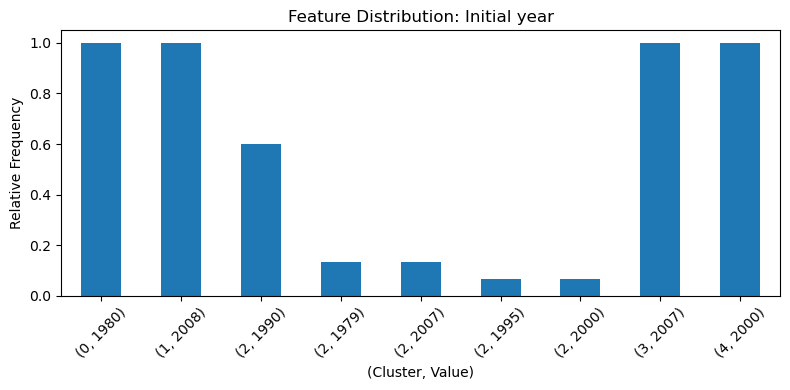

    Cluster 0 is commonly characterized by: Initial year='1980' (100% of models)
    Cluster 1 is commonly characterized by: Initial year='2008' (100% of models)
    Cluster 2 is commonly characterized by: Initial year='1990' (60% of models)
    Cluster 3 is commonly characterized by: Initial year='2007' (100% of models)
    Cluster 4 is commonly characterized by: Initial year='2000' (100% of models)

--- Feature: Initial SMB ---
cluster  Initial SMB
0        MAR            1.000000
1        RA1            1.000000
2        RA3            0.400000
         MAR            0.200000
         ISMB           0.133333
         BOX/MAR(2*)    0.066667
         BOX/RA3(4*)    0.066667
         HIR            0.066667
         RA1            0.066667
3        RA1            1.000000
4        RA1            1.000000
Name: proportion, dtype: float64


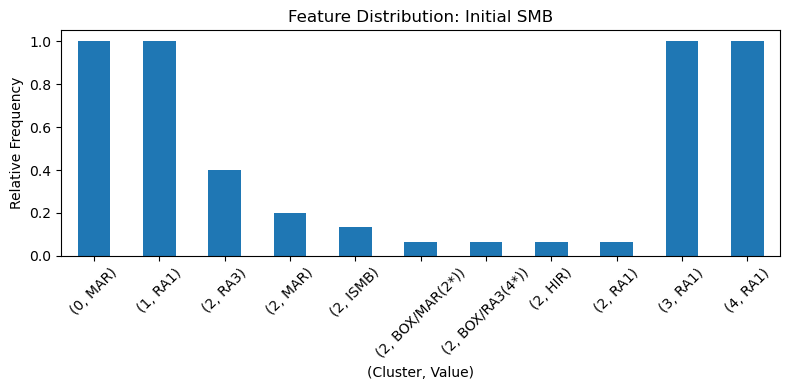

    Cluster 0 is commonly characterized by: Initial SMB='MAR' (100% of models)
    Cluster 1 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 3 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 4 is commonly characterized by: Initial SMB='RA1' (100% of models)

--- Feature: Velocity ---
cluster  Velocity
2        J           0.6
         RM          0.4
3        RM          1.0
Name: proportion, dtype: float64


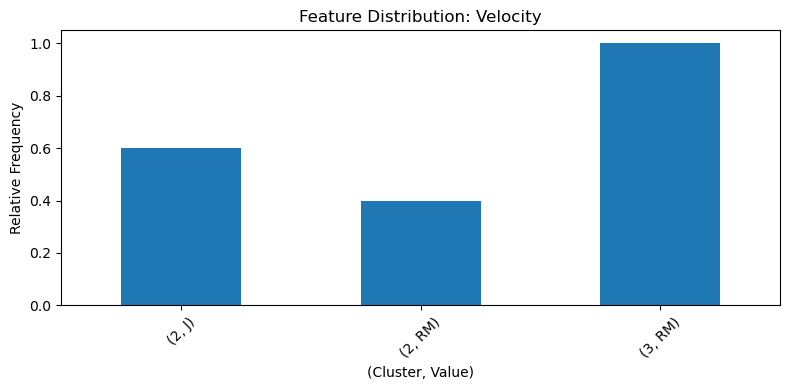

    Cluster 2 is commonly characterized by: Velocity='J' (60% of models)
    Cluster 3 is commonly characterized by: Velocity='RM' (100% of models)

--- Feature: Bed ---
cluster  Bed
0        B      1.0
1        M      1.0
2        M      1.0
3        M      1.0
4        M      1.0
Name: proportion, dtype: float64


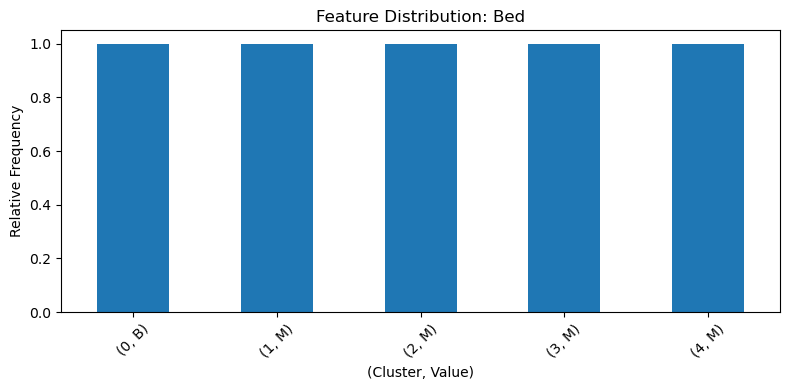

    Cluster 0 is commonly characterized by: Bed='B' (100% of models)
    Cluster 1 is commonly characterized by: Bed='M' (100% of models)
    Cluster 2 is commonly characterized by: Bed='M' (100% of models)
    Cluster 3 is commonly characterized by: Bed='M' (100% of models)
    Cluster 4 is commonly characterized by: Bed='M' (100% of models)

--- Feature: Surface/ Thickness ---
cluster  Surface/ Thickness
1        M                     1.0
2        M                     1.0
Name: proportion, dtype: float64


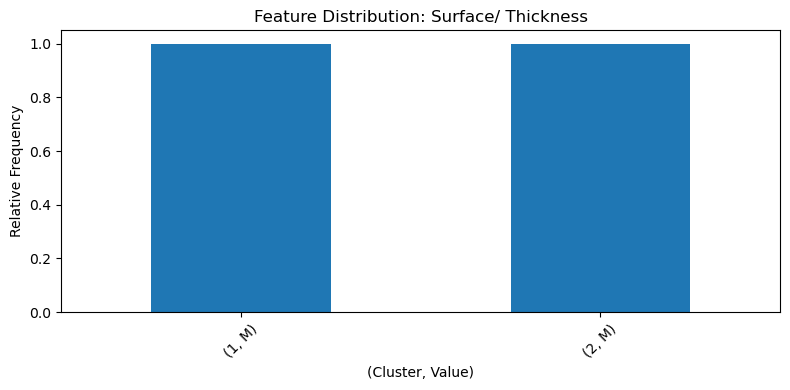

    Cluster 1 is commonly characterized by: Surface/ Thickness='M' (100% of models)
    Cluster 2 is commonly characterized by: Surface/ Thickness='M' (100% of models)

--- Feature: GH F ---
cluster  GH F
0        MIX     1.000000
1        SR      1.000000
2        SR      0.642857
         G       0.357143
3        SR      1.000000
4        SR      1.000000
Name: proportion, dtype: float64


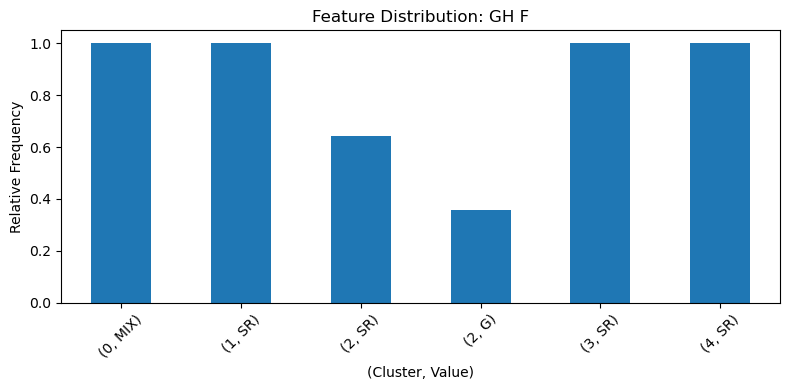

    Cluster 0 is commonly characterized by: GH F='MIX' (100% of models)
    Cluster 1 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 2 is commonly characterized by: GH F='SR' (64% of models)
    Cluster 3 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 4 is commonly characterized by: GH F='SR' (100% of models)

--- Feature: Res min ---
cluster  Res min
0        5          1.000000
1        0.9        1.000000
2        5          0.266667
         1(1*)      0.133333
         0.25       0.066667
         0.5        0.066667
         0.75       0.066667
         1          0.066667
         1.2        0.066667
         16         0.066667
         3          0.066667
         4          0.066667
         8          0.066667
3        0.2        1.000000
4        2          1.000000
Name: proportion, dtype: float64


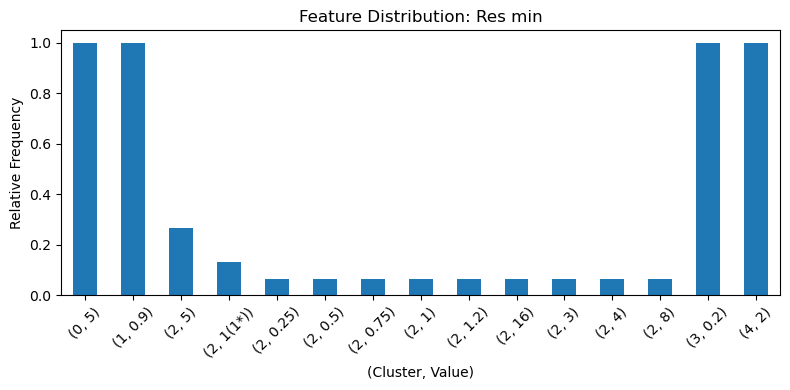

    Cluster 0 is commonly characterized by: Res min='5' (100% of models)
    Cluster 1 is commonly characterized by: Res min='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res min='0.2' (100% of models)
    Cluster 4 is commonly characterized by: Res min='2' (100% of models)

--- Feature: Res max ---
cluster  Res max
0        14(6*)     1.000000
1        0.9        1.000000
2        5          0.266667
         7.5        0.200000
         30         0.133333
         15         0.066667
         16         0.066667
         25         0.066667
         4          0.066667
         4.8        0.066667
         8          0.066667
3        20         1.000000
4        2          1.000000
Name: proportion, dtype: float64


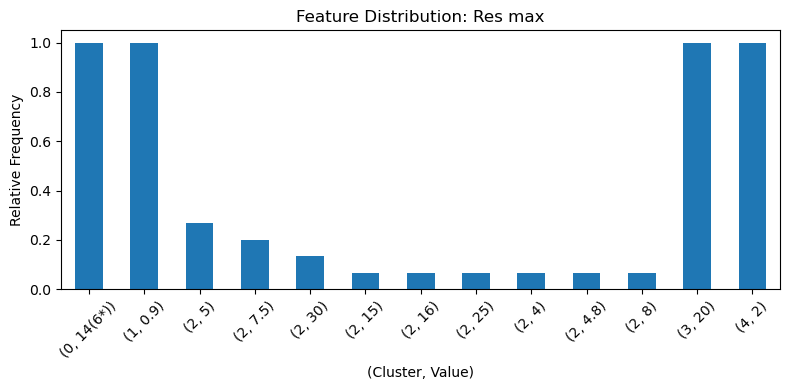

    Cluster 0 is commonly characterized by: Res max='14(6*)' (100% of models)
    Cluster 1 is commonly characterized by: Res max='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res max='20' (100% of models)
    Cluster 4 is commonly characterized by: Res max='2' (100% of models)

INTER-CLUSTER DIFFERENCES

===Features that differ between clusters (based on 50% threshold)===

 Feature: Numerics
  - Cluster 0 → 'FD/FV(5*)'
  - Cluster 1 → 'FD'
  - Cluster 2 → 'FE'
  - Cluster 3 → 'FE'
  - Cluster 4 → 'FD'

 Feature: Ice flow
  - Cluster 0 → 'HYB'
  - Cluster 1 → 'HYB'
  - Cluster 3 → 'HO'
  - Cluster 4 → 'HYB'

 Feature: Initialisation
  - Cluster 0 → 'CYC/NDm'
  - Cluster 1 → 'CYC/NDs(7*)'
  - Cluster 3 → 'DAv'
  - Cluster 4 → 'SP/NDs(7*)'

 Feature: Initial year
  - Cluster 0 → '1980'
  - Cluster 1 → '2008'
  - Cluster 2 → '1990'
  - Cluster 3 → '2007'
  - Cluster 4 → '2000'

 Feature: Initial SMB
  - Cluster 0 → 'MAR'
  - Cluster 1 → 'RA1'
  - Cluster 3 → 'RA1'
  -

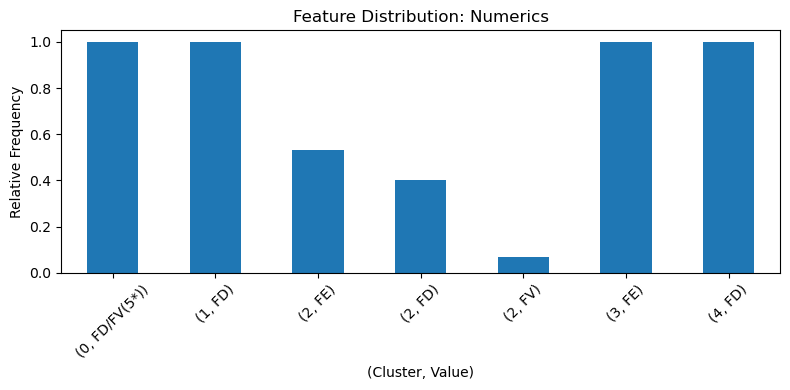

    Cluster 0 is commonly characterized by: Numerics='FD/FV(5*)' (100% of models)
    Cluster 1 is commonly characterized by: Numerics='FD' (100% of models)
    Cluster 2 is commonly characterized by: Numerics='FE' (53% of models)
    Cluster 3 is commonly characterized by: Numerics='FE' (100% of models)
    Cluster 4 is commonly characterized by: Numerics='FD' (100% of models)

--- Feature: Ice flow ---
cluster  Ice flow
0        HYB         1.000000
1        HYB         1.000000
2        HO          0.333333
         SIA         0.266667
         HYB         0.200000
         SSA         0.200000
3        HO          1.000000
4        HYB         1.000000
Name: proportion, dtype: float64


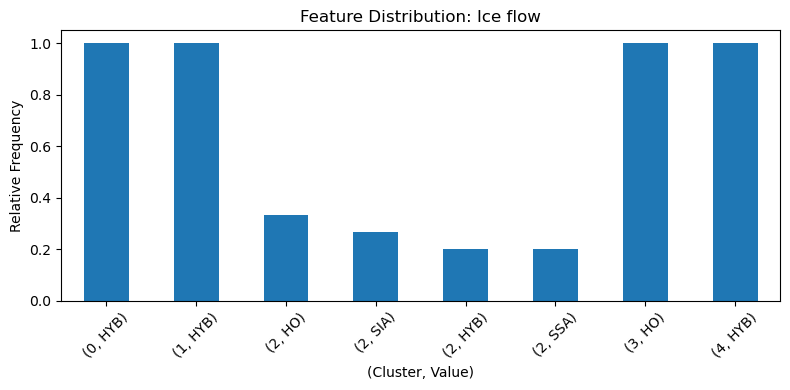

    Cluster 0 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 1 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 3 is commonly characterized by: Ice flow='HO' (100% of models)
    Cluster 4 is commonly characterized by: Ice flow='HYB' (100% of models)

--- Feature: Initialisation ---
cluster  Initialisation
0        CYC/NDm           1.000000
1        CYC/NDs(7*)       1.000000
2        DAv               0.466667
         CYC/NDs           0.133333
         SP/NDm            0.133333
         CYC/DAi(7*)       0.066667
         SP/DAi            0.066667
         SP/DAs(7*)        0.066667
         SP/DAv(3*)        0.066667
3        DAv               1.000000
4        SP/NDs(7*)        1.000000
Name: proportion, dtype: float64


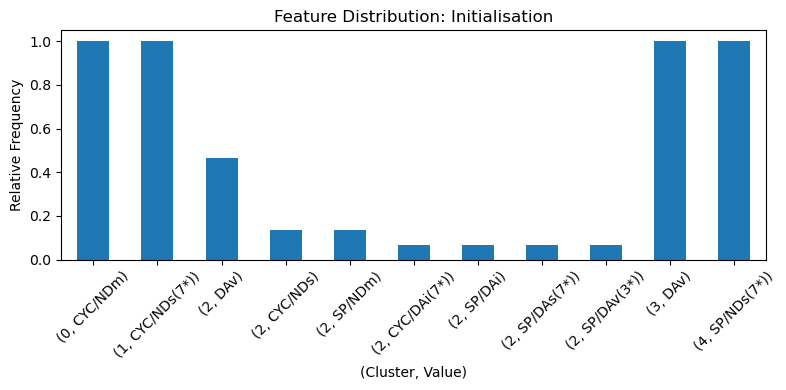

    Cluster 0 is commonly characterized by: Initialisation='CYC/NDm' (100% of models)
    Cluster 1 is commonly characterized by: Initialisation='CYC/NDs(7*)' (100% of models)
    Cluster 3 is commonly characterized by: Initialisation='DAv' (100% of models)
    Cluster 4 is commonly characterized by: Initialisation='SP/NDs(7*)' (100% of models)

--- Feature: Initial year ---
cluster  Initial year
0        1980            1.000000
1        2008            1.000000
2        1990            0.600000
         1979            0.133333
         2007            0.133333
         1995            0.066667
         2000            0.066667
3        2007            1.000000
4        2000            1.000000
Name: proportion, dtype: float64


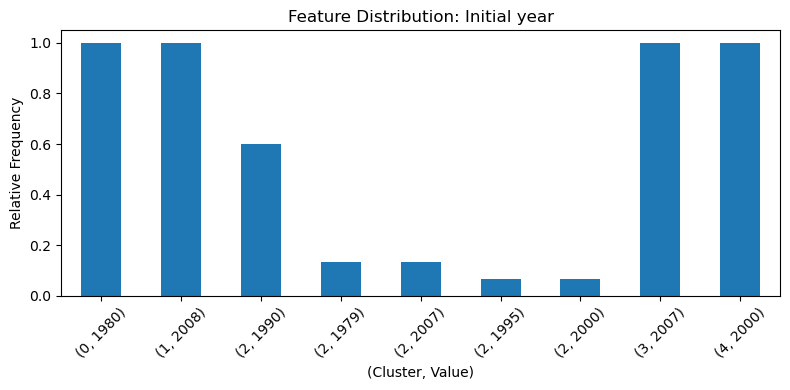

    Cluster 0 is commonly characterized by: Initial year='1980' (100% of models)
    Cluster 1 is commonly characterized by: Initial year='2008' (100% of models)
    Cluster 2 is commonly characterized by: Initial year='1990' (60% of models)
    Cluster 3 is commonly characterized by: Initial year='2007' (100% of models)
    Cluster 4 is commonly characterized by: Initial year='2000' (100% of models)

--- Feature: Initial SMB ---
cluster  Initial SMB
0        MAR            1.000000
1        RA1            1.000000
2        RA3            0.400000
         MAR            0.200000
         ISMB           0.133333
         BOX/MAR(2*)    0.066667
         BOX/RA3(4*)    0.066667
         HIR            0.066667
         RA1            0.066667
3        RA1            1.000000
4        RA1            1.000000
Name: proportion, dtype: float64


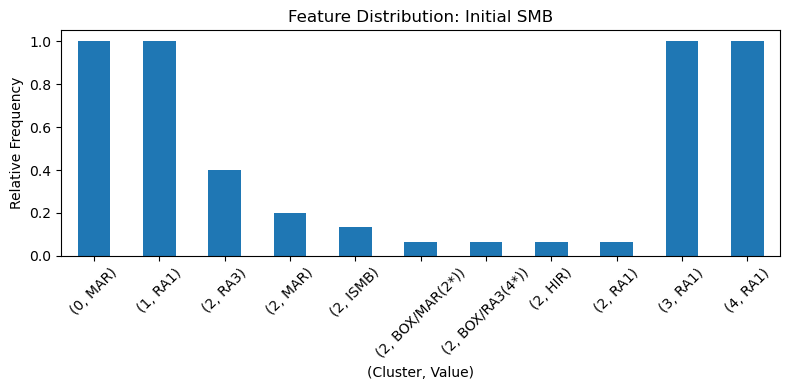

    Cluster 0 is commonly characterized by: Initial SMB='MAR' (100% of models)
    Cluster 1 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 3 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 4 is commonly characterized by: Initial SMB='RA1' (100% of models)

--- Feature: Velocity ---
cluster  Velocity
2        J           0.6
         RM          0.4
3        RM          1.0
Name: proportion, dtype: float64


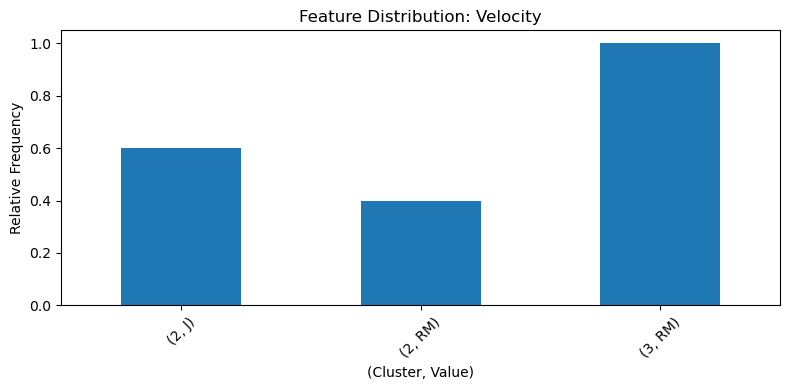

    Cluster 2 is commonly characterized by: Velocity='J' (60% of models)
    Cluster 3 is commonly characterized by: Velocity='RM' (100% of models)

--- Feature: Bed ---
cluster  Bed
0        B      1.0
1        M      1.0
2        M      1.0
3        M      1.0
4        M      1.0
Name: proportion, dtype: float64


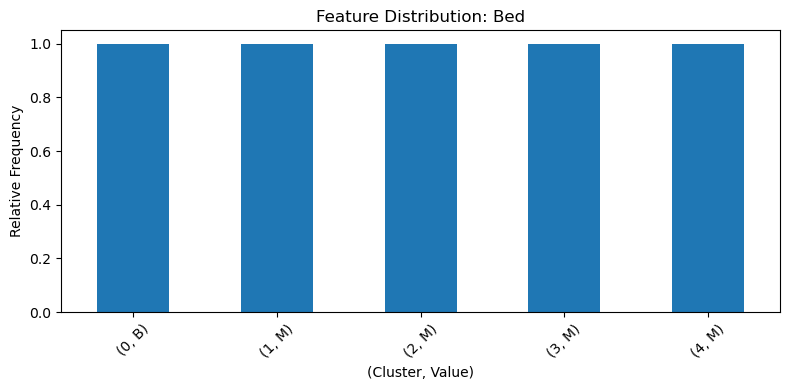

    Cluster 0 is commonly characterized by: Bed='B' (100% of models)
    Cluster 1 is commonly characterized by: Bed='M' (100% of models)
    Cluster 2 is commonly characterized by: Bed='M' (100% of models)
    Cluster 3 is commonly characterized by: Bed='M' (100% of models)
    Cluster 4 is commonly characterized by: Bed='M' (100% of models)

--- Feature: Surface/ Thickness ---
cluster  Surface/ Thickness
1        M                     1.0
2        M                     1.0
Name: proportion, dtype: float64


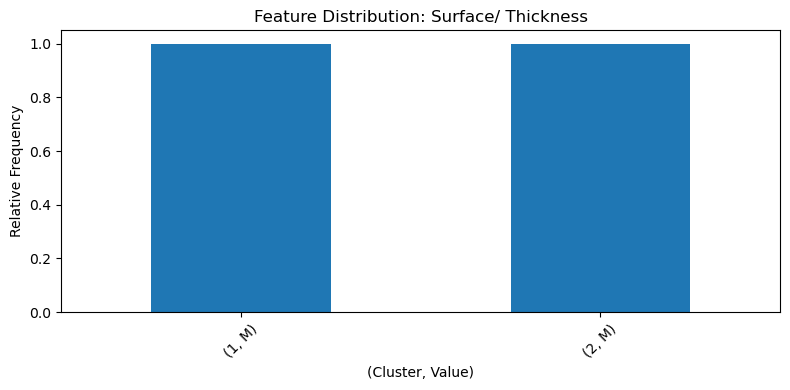

    Cluster 1 is commonly characterized by: Surface/ Thickness='M' (100% of models)
    Cluster 2 is commonly characterized by: Surface/ Thickness='M' (100% of models)

--- Feature: GH F ---
cluster  GH F
0        MIX     1.000000
1        SR      1.000000
2        SR      0.642857
         G       0.357143
3        SR      1.000000
4        SR      1.000000
Name: proportion, dtype: float64


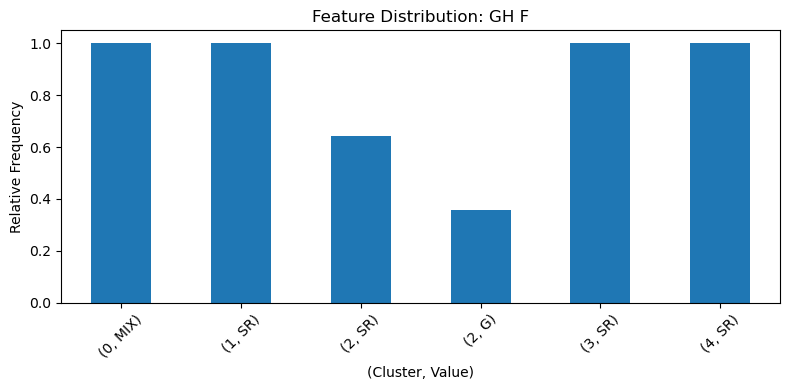

    Cluster 0 is commonly characterized by: GH F='MIX' (100% of models)
    Cluster 1 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 2 is commonly characterized by: GH F='SR' (64% of models)
    Cluster 3 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 4 is commonly characterized by: GH F='SR' (100% of models)

--- Feature: Res min ---
cluster  Res min
0        5          1.000000
1        0.9        1.000000
2        5          0.266667
         1(1*)      0.133333
         0.25       0.066667
         0.5        0.066667
         0.75       0.066667
         1          0.066667
         1.2        0.066667
         16         0.066667
         3          0.066667
         4          0.066667
         8          0.066667
3        0.2        1.000000
4        2          1.000000
Name: proportion, dtype: float64


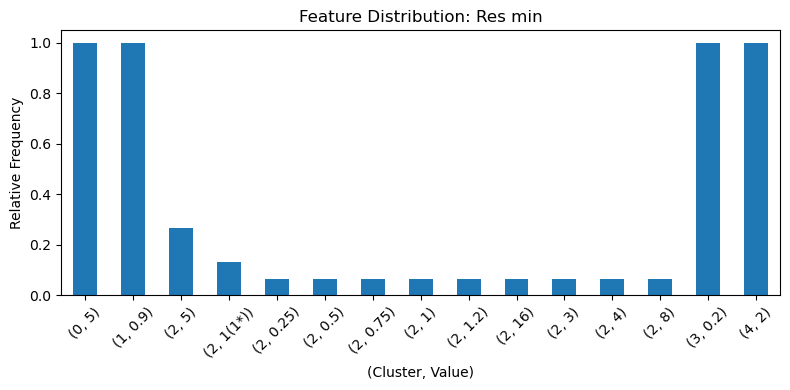

    Cluster 0 is commonly characterized by: Res min='5' (100% of models)
    Cluster 1 is commonly characterized by: Res min='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res min='0.2' (100% of models)
    Cluster 4 is commonly characterized by: Res min='2' (100% of models)

--- Feature: Res max ---
cluster  Res max
0        14(6*)     1.000000
1        0.9        1.000000
2        5          0.266667
         7.5        0.200000
         30         0.133333
         15         0.066667
         16         0.066667
         25         0.066667
         4          0.066667
         4.8        0.066667
         8          0.066667
3        20         1.000000
4        2          1.000000
Name: proportion, dtype: float64


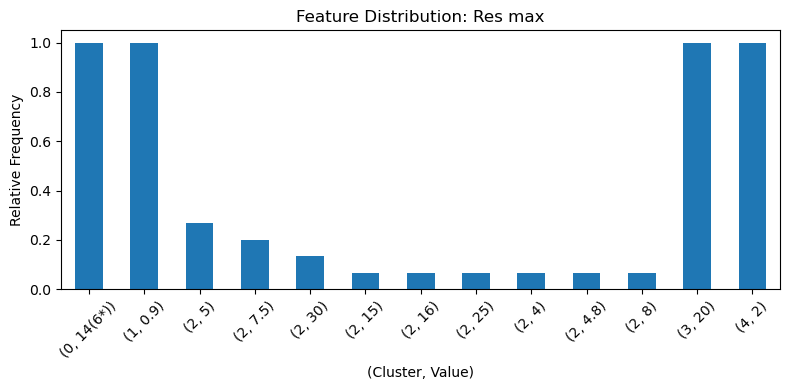

    Cluster 0 is commonly characterized by: Res max='14(6*)' (100% of models)
    Cluster 1 is commonly characterized by: Res max='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res max='20' (100% of models)
    Cluster 4 is commonly characterized by: Res max='2' (100% of models)

INTER-CLUSTER DIFFERENCES

===Features that differ between clusters (based on 50% threshold)===

 Feature: Numerics
  - Cluster 0 → 'FD/FV(5*)'
  - Cluster 1 → 'FD'
  - Cluster 2 → 'FE'
  - Cluster 3 → 'FE'
  - Cluster 4 → 'FD'

 Feature: Ice flow
  - Cluster 0 → 'HYB'
  - Cluster 1 → 'HYB'
  - Cluster 3 → 'HO'
  - Cluster 4 → 'HYB'

 Feature: Initialisation
  - Cluster 0 → 'CYC/NDm'
  - Cluster 1 → 'CYC/NDs(7*)'
  - Cluster 3 → 'DAv'
  - Cluster 4 → 'SP/NDs(7*)'

 Feature: Initial year
  - Cluster 0 → '1980'
  - Cluster 1 → '2008'
  - Cluster 2 → '1990'
  - Cluster 3 → '2007'
  - Cluster 4 → '2000'

 Feature: Initial SMB
  - Cluster 0 → 'MAR'
  - Cluster 1 → 'RA1'
  - Cluster 3 → 'RA1'
  -

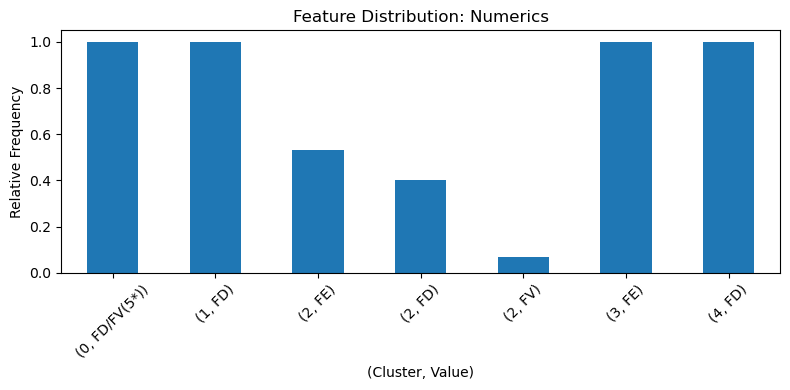

    Cluster 0 is commonly characterized by: Numerics='FD/FV(5*)' (100% of models)
    Cluster 1 is commonly characterized by: Numerics='FD' (100% of models)
    Cluster 2 is commonly characterized by: Numerics='FE' (53% of models)
    Cluster 3 is commonly characterized by: Numerics='FE' (100% of models)
    Cluster 4 is commonly characterized by: Numerics='FD' (100% of models)

--- Feature: Ice flow ---
cluster  Ice flow
0        HYB         1.000000
1        HYB         1.000000
2        HO          0.333333
         SIA         0.266667
         HYB         0.200000
         SSA         0.200000
3        HO          1.000000
4        HYB         1.000000
Name: proportion, dtype: float64


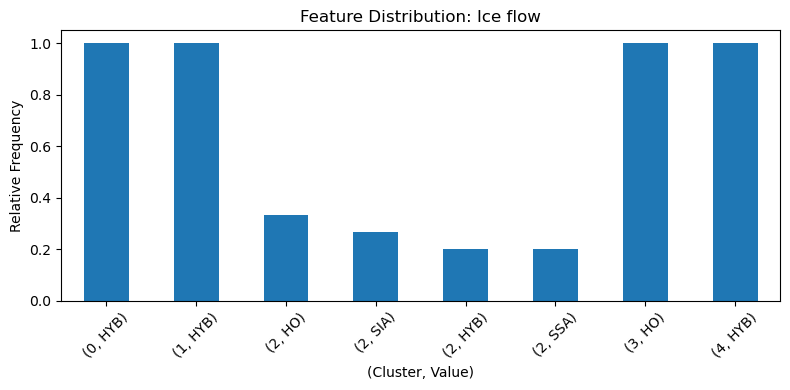

    Cluster 0 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 1 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 3 is commonly characterized by: Ice flow='HO' (100% of models)
    Cluster 4 is commonly characterized by: Ice flow='HYB' (100% of models)

--- Feature: Initialisation ---
cluster  Initialisation
0        CYC/NDm           1.000000
1        CYC/NDs(7*)       1.000000
2        DAv               0.466667
         CYC/NDs           0.133333
         SP/NDm            0.133333
         CYC/DAi(7*)       0.066667
         SP/DAi            0.066667
         SP/DAs(7*)        0.066667
         SP/DAv(3*)        0.066667
3        DAv               1.000000
4        SP/NDs(7*)        1.000000
Name: proportion, dtype: float64


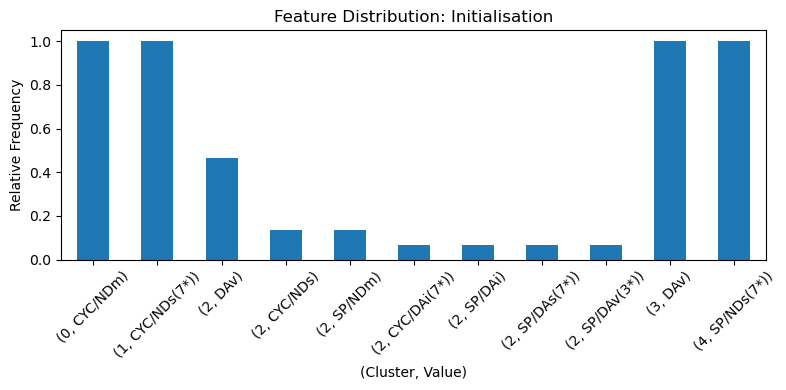

    Cluster 0 is commonly characterized by: Initialisation='CYC/NDm' (100% of models)
    Cluster 1 is commonly characterized by: Initialisation='CYC/NDs(7*)' (100% of models)
    Cluster 3 is commonly characterized by: Initialisation='DAv' (100% of models)
    Cluster 4 is commonly characterized by: Initialisation='SP/NDs(7*)' (100% of models)

--- Feature: Initial year ---
cluster  Initial year
0        1980            1.000000
1        2008            1.000000
2        1990            0.600000
         1979            0.133333
         2007            0.133333
         1995            0.066667
         2000            0.066667
3        2007            1.000000
4        2000            1.000000
Name: proportion, dtype: float64


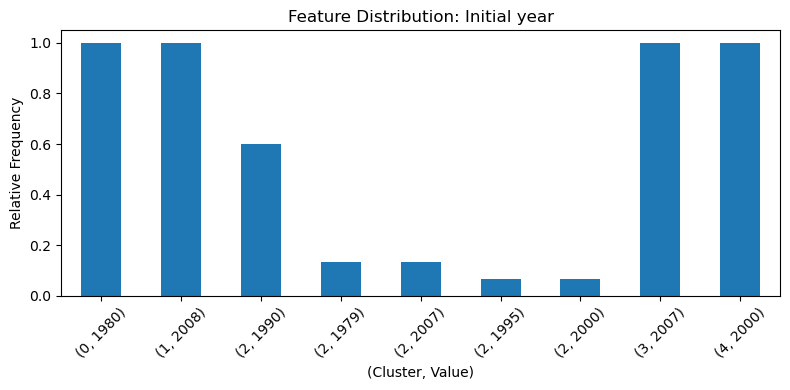

    Cluster 0 is commonly characterized by: Initial year='1980' (100% of models)
    Cluster 1 is commonly characterized by: Initial year='2008' (100% of models)
    Cluster 2 is commonly characterized by: Initial year='1990' (60% of models)
    Cluster 3 is commonly characterized by: Initial year='2007' (100% of models)
    Cluster 4 is commonly characterized by: Initial year='2000' (100% of models)

--- Feature: Initial SMB ---
cluster  Initial SMB
0        MAR            1.000000
1        RA1            1.000000
2        RA3            0.400000
         MAR            0.200000
         ISMB           0.133333
         BOX/MAR(2*)    0.066667
         BOX/RA3(4*)    0.066667
         HIR            0.066667
         RA1            0.066667
3        RA1            1.000000
4        RA1            1.000000
Name: proportion, dtype: float64


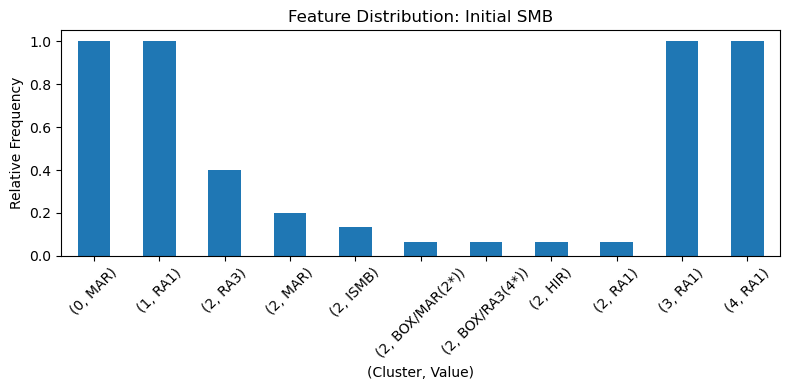

    Cluster 0 is commonly characterized by: Initial SMB='MAR' (100% of models)
    Cluster 1 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 3 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 4 is commonly characterized by: Initial SMB='RA1' (100% of models)

--- Feature: Velocity ---
cluster  Velocity
2        J           0.6
         RM          0.4
3        RM          1.0
Name: proportion, dtype: float64


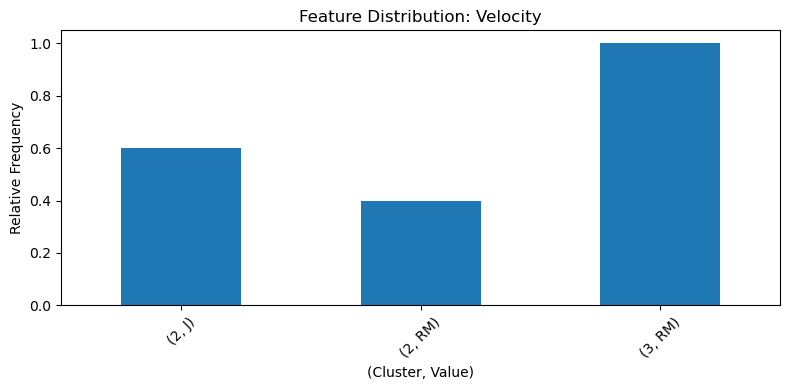

    Cluster 2 is commonly characterized by: Velocity='J' (60% of models)
    Cluster 3 is commonly characterized by: Velocity='RM' (100% of models)

--- Feature: Bed ---
cluster  Bed
0        B      1.0
1        M      1.0
2        M      1.0
3        M      1.0
4        M      1.0
Name: proportion, dtype: float64


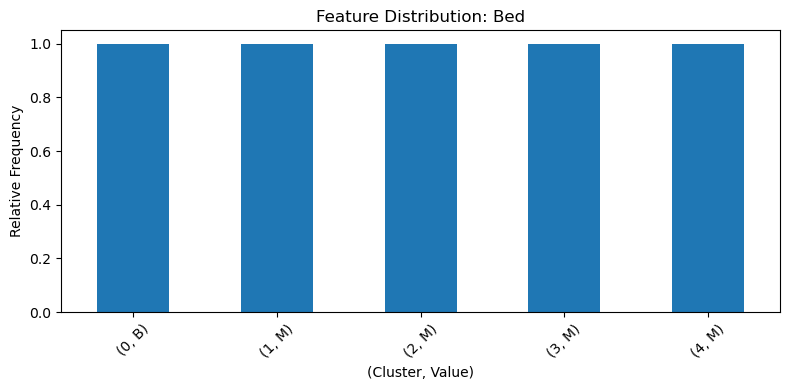

    Cluster 0 is commonly characterized by: Bed='B' (100% of models)
    Cluster 1 is commonly characterized by: Bed='M' (100% of models)
    Cluster 2 is commonly characterized by: Bed='M' (100% of models)
    Cluster 3 is commonly characterized by: Bed='M' (100% of models)
    Cluster 4 is commonly characterized by: Bed='M' (100% of models)

--- Feature: Surface/ Thickness ---
cluster  Surface/ Thickness
1        M                     1.0
2        M                     1.0
Name: proportion, dtype: float64


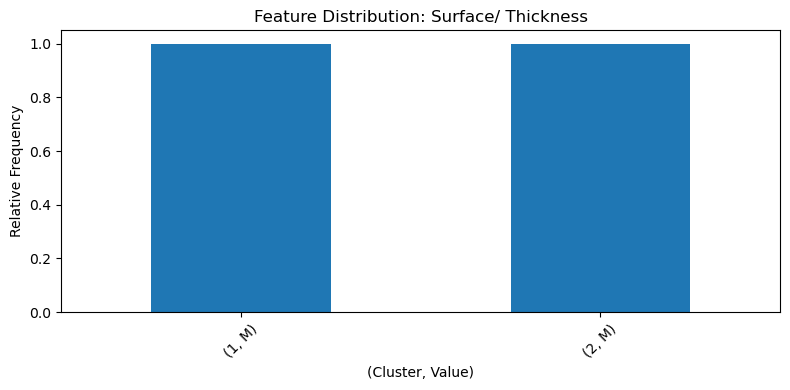

    Cluster 1 is commonly characterized by: Surface/ Thickness='M' (100% of models)
    Cluster 2 is commonly characterized by: Surface/ Thickness='M' (100% of models)

--- Feature: GH F ---
cluster  GH F
0        MIX     1.000000
1        SR      1.000000
2        SR      0.642857
         G       0.357143
3        SR      1.000000
4        SR      1.000000
Name: proportion, dtype: float64


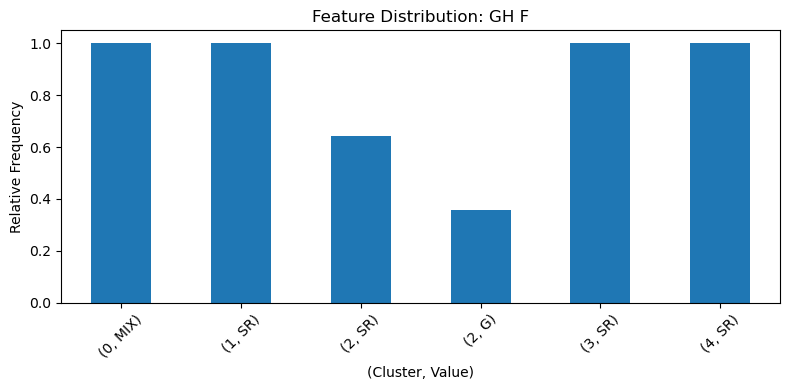

    Cluster 0 is commonly characterized by: GH F='MIX' (100% of models)
    Cluster 1 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 2 is commonly characterized by: GH F='SR' (64% of models)
    Cluster 3 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 4 is commonly characterized by: GH F='SR' (100% of models)

--- Feature: Res min ---
cluster  Res min
0        5          1.000000
1        0.9        1.000000
2        5          0.266667
         1(1*)      0.133333
         0.25       0.066667
         0.5        0.066667
         0.75       0.066667
         1          0.066667
         1.2        0.066667
         16         0.066667
         3          0.066667
         4          0.066667
         8          0.066667
3        0.2        1.000000
4        2          1.000000
Name: proportion, dtype: float64


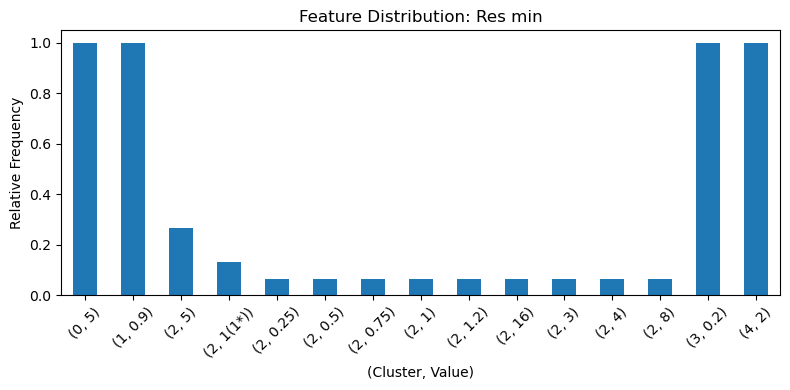

    Cluster 0 is commonly characterized by: Res min='5' (100% of models)
    Cluster 1 is commonly characterized by: Res min='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res min='0.2' (100% of models)
    Cluster 4 is commonly characterized by: Res min='2' (100% of models)

--- Feature: Res max ---
cluster  Res max
0        14(6*)     1.000000
1        0.9        1.000000
2        5          0.266667
         7.5        0.200000
         30         0.133333
         15         0.066667
         16         0.066667
         25         0.066667
         4          0.066667
         4.8        0.066667
         8          0.066667
3        20         1.000000
4        2          1.000000
Name: proportion, dtype: float64


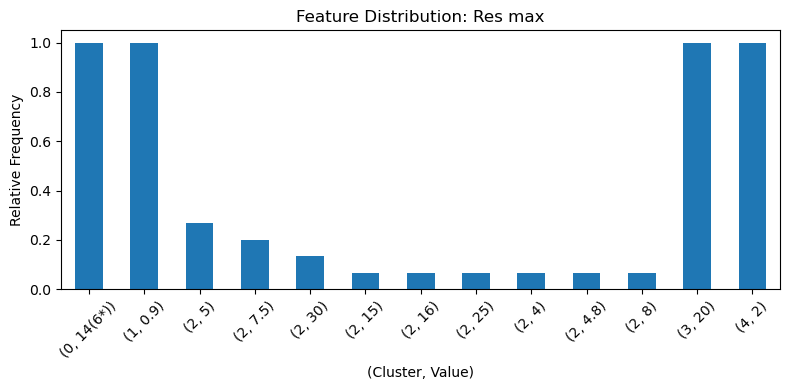

    Cluster 0 is commonly characterized by: Res max='14(6*)' (100% of models)
    Cluster 1 is commonly characterized by: Res max='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res max='20' (100% of models)
    Cluster 4 is commonly characterized by: Res max='2' (100% of models)

INTER-CLUSTER DIFFERENCES

===Features that differ between clusters (based on 50% threshold)===

 Feature: Numerics
  - Cluster 0 → 'FD/FV(5*)'
  - Cluster 1 → 'FD'
  - Cluster 2 → 'FE'
  - Cluster 3 → 'FE'
  - Cluster 4 → 'FD'

 Feature: Ice flow
  - Cluster 0 → 'HYB'
  - Cluster 1 → 'HYB'
  - Cluster 3 → 'HO'
  - Cluster 4 → 'HYB'

 Feature: Initialisation
  - Cluster 0 → 'CYC/NDm'
  - Cluster 1 → 'CYC/NDs(7*)'
  - Cluster 3 → 'DAv'
  - Cluster 4 → 'SP/NDs(7*)'

 Feature: Initial year
  - Cluster 0 → '1980'
  - Cluster 1 → '2008'
  - Cluster 2 → '1990'
  - Cluster 3 → '2007'
  - Cluster 4 → '2000'

 Feature: Initial SMB
  - Cluster 0 → 'MAR'
  - Cluster 1 → 'RA1'
  - Cluster 3 → 'RA1'
  -

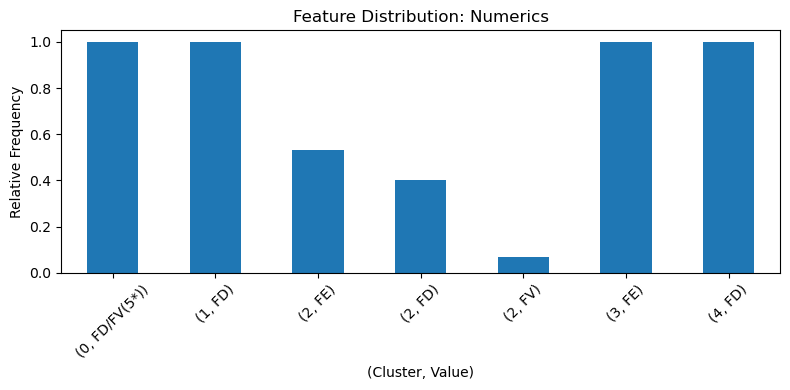

    Cluster 0 is commonly characterized by: Numerics='FD/FV(5*)' (100% of models)
    Cluster 1 is commonly characterized by: Numerics='FD' (100% of models)
    Cluster 2 is commonly characterized by: Numerics='FE' (53% of models)
    Cluster 3 is commonly characterized by: Numerics='FE' (100% of models)
    Cluster 4 is commonly characterized by: Numerics='FD' (100% of models)

--- Feature: Ice flow ---
cluster  Ice flow
0        HYB         1.000000
1        HYB         1.000000
2        HO          0.333333
         SIA         0.266667
         HYB         0.200000
         SSA         0.200000
3        HO          1.000000
4        HYB         1.000000
Name: proportion, dtype: float64


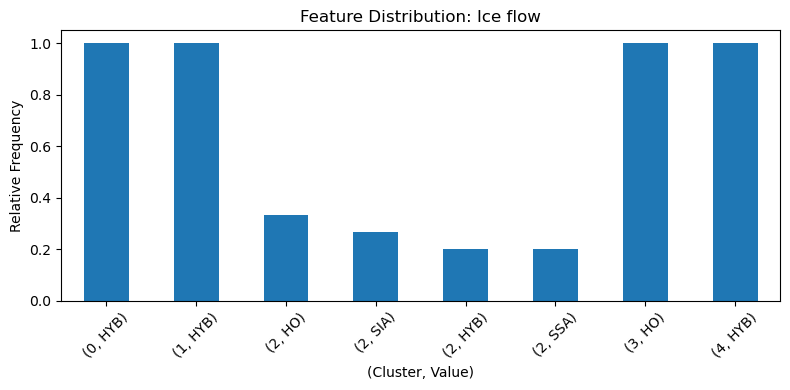

    Cluster 0 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 1 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 3 is commonly characterized by: Ice flow='HO' (100% of models)
    Cluster 4 is commonly characterized by: Ice flow='HYB' (100% of models)

--- Feature: Initialisation ---
cluster  Initialisation
0        CYC/NDm           1.000000
1        CYC/NDs(7*)       1.000000
2        DAv               0.466667
         CYC/NDs           0.133333
         SP/NDm            0.133333
         CYC/DAi(7*)       0.066667
         SP/DAi            0.066667
         SP/DAs(7*)        0.066667
         SP/DAv(3*)        0.066667
3        DAv               1.000000
4        SP/NDs(7*)        1.000000
Name: proportion, dtype: float64


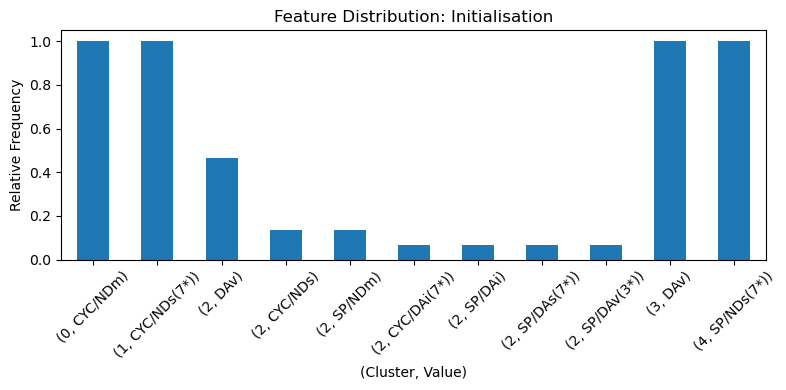

    Cluster 0 is commonly characterized by: Initialisation='CYC/NDm' (100% of models)
    Cluster 1 is commonly characterized by: Initialisation='CYC/NDs(7*)' (100% of models)
    Cluster 3 is commonly characterized by: Initialisation='DAv' (100% of models)
    Cluster 4 is commonly characterized by: Initialisation='SP/NDs(7*)' (100% of models)

--- Feature: Initial year ---
cluster  Initial year
0        1980            1.000000
1        2008            1.000000
2        1990            0.600000
         1979            0.133333
         2007            0.133333
         1995            0.066667
         2000            0.066667
3        2007            1.000000
4        2000            1.000000
Name: proportion, dtype: float64


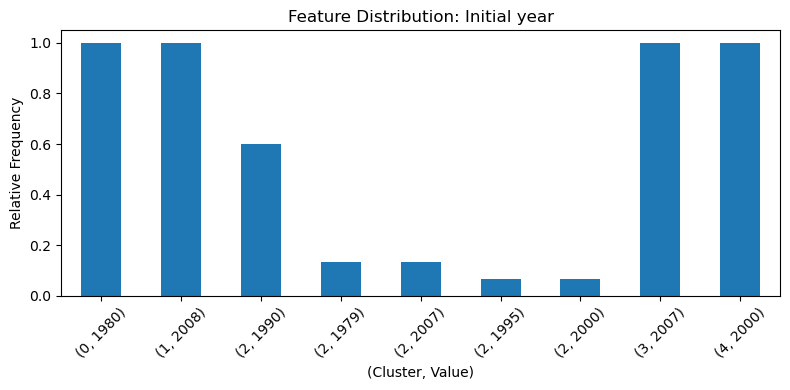

    Cluster 0 is commonly characterized by: Initial year='1980' (100% of models)
    Cluster 1 is commonly characterized by: Initial year='2008' (100% of models)
    Cluster 2 is commonly characterized by: Initial year='1990' (60% of models)
    Cluster 3 is commonly characterized by: Initial year='2007' (100% of models)
    Cluster 4 is commonly characterized by: Initial year='2000' (100% of models)

--- Feature: Initial SMB ---
cluster  Initial SMB
0        MAR            1.000000
1        RA1            1.000000
2        RA3            0.400000
         MAR            0.200000
         ISMB           0.133333
         BOX/MAR(2*)    0.066667
         BOX/RA3(4*)    0.066667
         HIR            0.066667
         RA1            0.066667
3        RA1            1.000000
4        RA1            1.000000
Name: proportion, dtype: float64


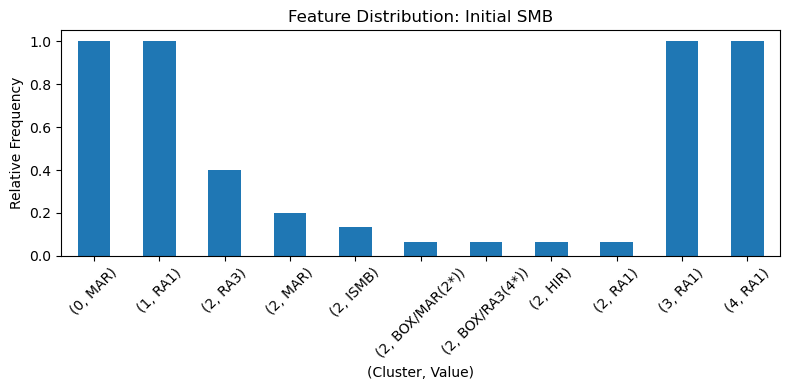

    Cluster 0 is commonly characterized by: Initial SMB='MAR' (100% of models)
    Cluster 1 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 3 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 4 is commonly characterized by: Initial SMB='RA1' (100% of models)

--- Feature: Velocity ---
cluster  Velocity
2        J           0.6
         RM          0.4
3        RM          1.0
Name: proportion, dtype: float64


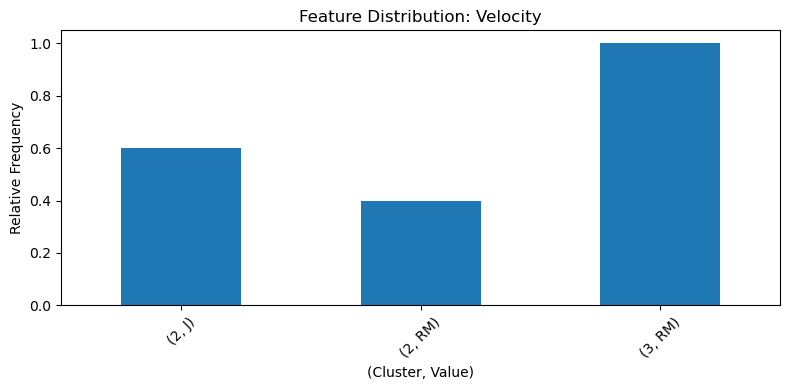

    Cluster 2 is commonly characterized by: Velocity='J' (60% of models)
    Cluster 3 is commonly characterized by: Velocity='RM' (100% of models)

--- Feature: Bed ---
cluster  Bed
0        B      1.0
1        M      1.0
2        M      1.0
3        M      1.0
4        M      1.0
Name: proportion, dtype: float64


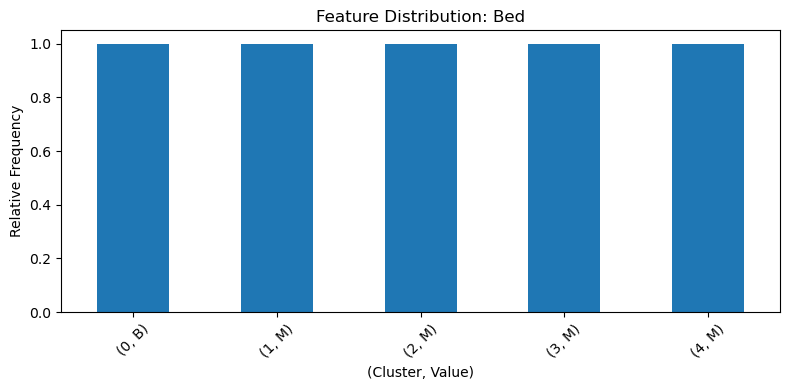

    Cluster 0 is commonly characterized by: Bed='B' (100% of models)
    Cluster 1 is commonly characterized by: Bed='M' (100% of models)
    Cluster 2 is commonly characterized by: Bed='M' (100% of models)
    Cluster 3 is commonly characterized by: Bed='M' (100% of models)
    Cluster 4 is commonly characterized by: Bed='M' (100% of models)

--- Feature: Surface/ Thickness ---
cluster  Surface/ Thickness
1        M                     1.0
2        M                     1.0
Name: proportion, dtype: float64


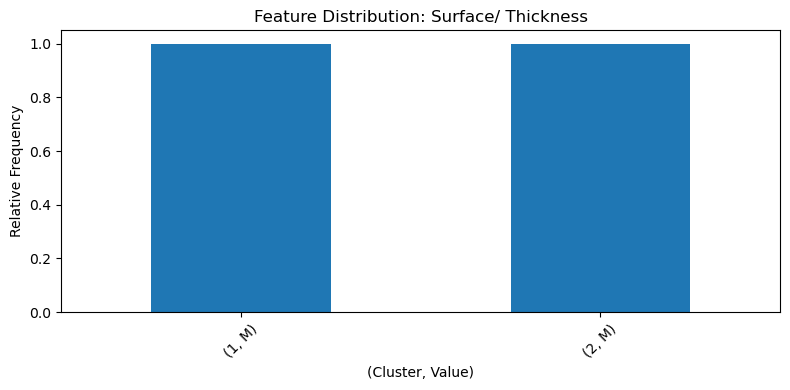

    Cluster 1 is commonly characterized by: Surface/ Thickness='M' (100% of models)
    Cluster 2 is commonly characterized by: Surface/ Thickness='M' (100% of models)

--- Feature: GH F ---
cluster  GH F
0        MIX     1.000000
1        SR      1.000000
2        SR      0.642857
         G       0.357143
3        SR      1.000000
4        SR      1.000000
Name: proportion, dtype: float64


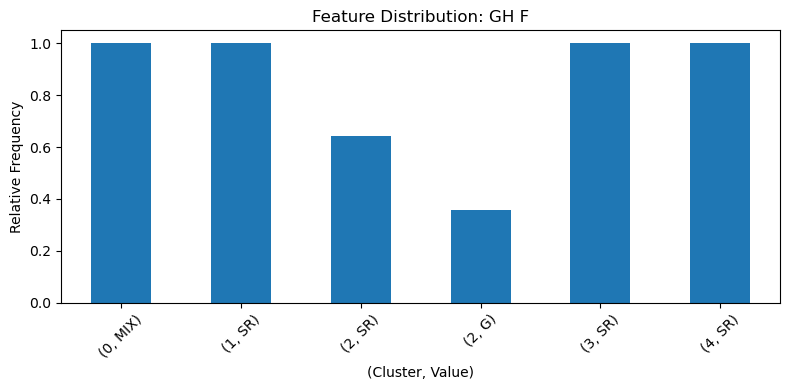

    Cluster 0 is commonly characterized by: GH F='MIX' (100% of models)
    Cluster 1 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 2 is commonly characterized by: GH F='SR' (64% of models)
    Cluster 3 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 4 is commonly characterized by: GH F='SR' (100% of models)

--- Feature: Res min ---
cluster  Res min
0        5          1.000000
1        0.9        1.000000
2        5          0.266667
         1(1*)      0.133333
         0.25       0.066667
         0.5        0.066667
         0.75       0.066667
         1          0.066667
         1.2        0.066667
         16         0.066667
         3          0.066667
         4          0.066667
         8          0.066667
3        0.2        1.000000
4        2          1.000000
Name: proportion, dtype: float64


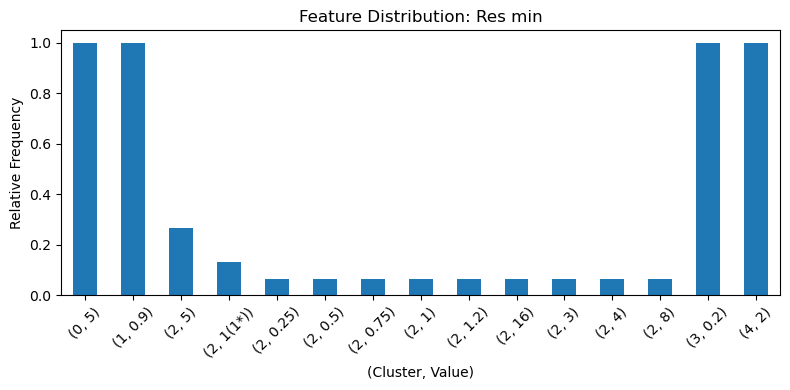

    Cluster 0 is commonly characterized by: Res min='5' (100% of models)
    Cluster 1 is commonly characterized by: Res min='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res min='0.2' (100% of models)
    Cluster 4 is commonly characterized by: Res min='2' (100% of models)

--- Feature: Res max ---
cluster  Res max
0        14(6*)     1.000000
1        0.9        1.000000
2        5          0.266667
         7.5        0.200000
         30         0.133333
         15         0.066667
         16         0.066667
         25         0.066667
         4          0.066667
         4.8        0.066667
         8          0.066667
3        20         1.000000
4        2          1.000000
Name: proportion, dtype: float64


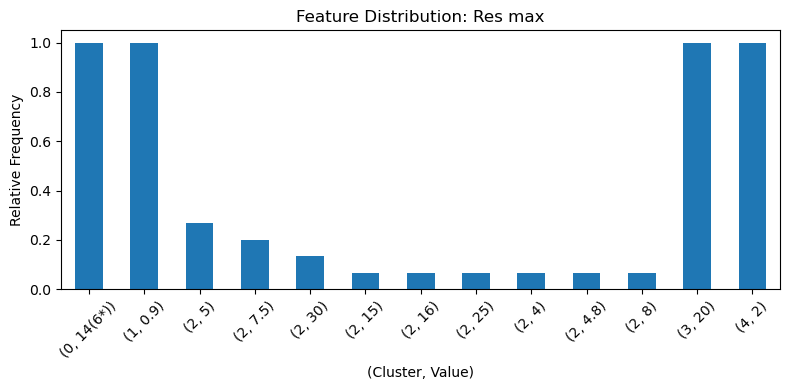

    Cluster 0 is commonly characterized by: Res max='14(6*)' (100% of models)
    Cluster 1 is commonly characterized by: Res max='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res max='20' (100% of models)
    Cluster 4 is commonly characterized by: Res max='2' (100% of models)

INTER-CLUSTER DIFFERENCES

===Features that differ between clusters (based on 50% threshold)===

 Feature: Numerics
  - Cluster 0 → 'FD/FV(5*)'
  - Cluster 1 → 'FD'
  - Cluster 2 → 'FE'
  - Cluster 3 → 'FE'
  - Cluster 4 → 'FD'

 Feature: Ice flow
  - Cluster 0 → 'HYB'
  - Cluster 1 → 'HYB'
  - Cluster 3 → 'HO'
  - Cluster 4 → 'HYB'

 Feature: Initialisation
  - Cluster 0 → 'CYC/NDm'
  - Cluster 1 → 'CYC/NDs(7*)'
  - Cluster 3 → 'DAv'
  - Cluster 4 → 'SP/NDs(7*)'

 Feature: Initial year
  - Cluster 0 → '1980'
  - Cluster 1 → '2008'
  - Cluster 2 → '1990'
  - Cluster 3 → '2007'
  - Cluster 4 → '2000'

 Feature: Initial SMB
  - Cluster 0 → 'MAR'
  - Cluster 1 → 'RA1'
  - Cluster 3 → 'RA1'
  -

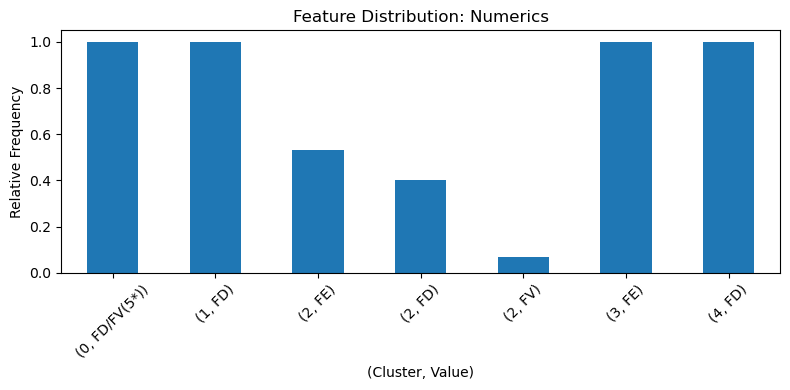

    Cluster 0 is commonly characterized by: Numerics='FD/FV(5*)' (100% of models)
    Cluster 1 is commonly characterized by: Numerics='FD' (100% of models)
    Cluster 2 is commonly characterized by: Numerics='FE' (53% of models)
    Cluster 3 is commonly characterized by: Numerics='FE' (100% of models)
    Cluster 4 is commonly characterized by: Numerics='FD' (100% of models)

--- Feature: Ice flow ---
cluster  Ice flow
0        HYB         1.000000
1        HYB         1.000000
2        HO          0.333333
         SIA         0.266667
         HYB         0.200000
         SSA         0.200000
3        HO          1.000000
4        HYB         1.000000
Name: proportion, dtype: float64


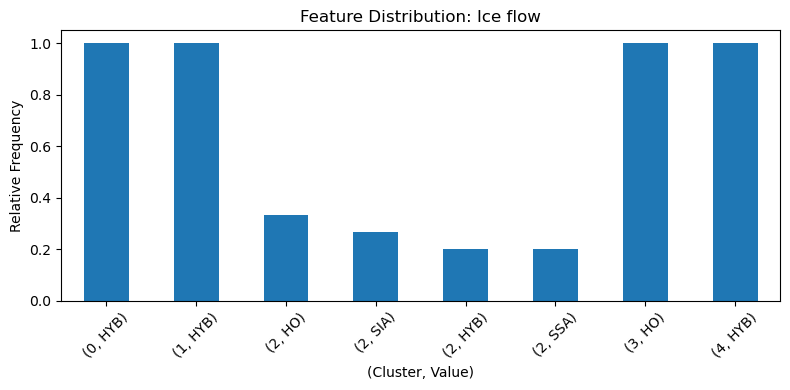

    Cluster 0 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 1 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 3 is commonly characterized by: Ice flow='HO' (100% of models)
    Cluster 4 is commonly characterized by: Ice flow='HYB' (100% of models)

--- Feature: Initialisation ---
cluster  Initialisation
0        CYC/NDm           1.000000
1        CYC/NDs(7*)       1.000000
2        DAv               0.466667
         CYC/NDs           0.133333
         SP/NDm            0.133333
         CYC/DAi(7*)       0.066667
         SP/DAi            0.066667
         SP/DAs(7*)        0.066667
         SP/DAv(3*)        0.066667
3        DAv               1.000000
4        SP/NDs(7*)        1.000000
Name: proportion, dtype: float64


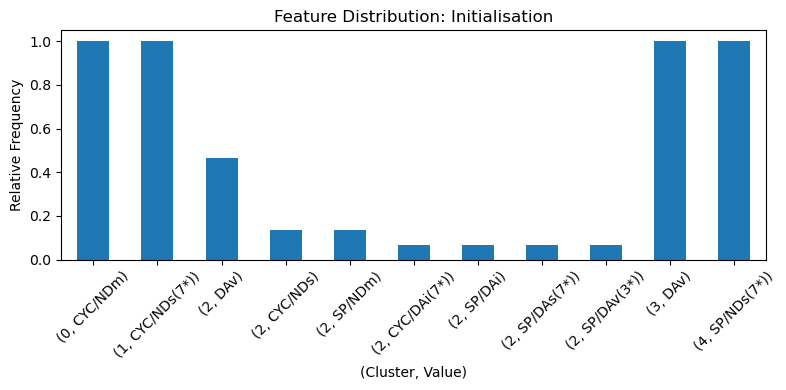

    Cluster 0 is commonly characterized by: Initialisation='CYC/NDm' (100% of models)
    Cluster 1 is commonly characterized by: Initialisation='CYC/NDs(7*)' (100% of models)
    Cluster 3 is commonly characterized by: Initialisation='DAv' (100% of models)
    Cluster 4 is commonly characterized by: Initialisation='SP/NDs(7*)' (100% of models)

--- Feature: Initial year ---
cluster  Initial year
0        1980            1.000000
1        2008            1.000000
2        1990            0.600000
         1979            0.133333
         2007            0.133333
         1995            0.066667
         2000            0.066667
3        2007            1.000000
4        2000            1.000000
Name: proportion, dtype: float64


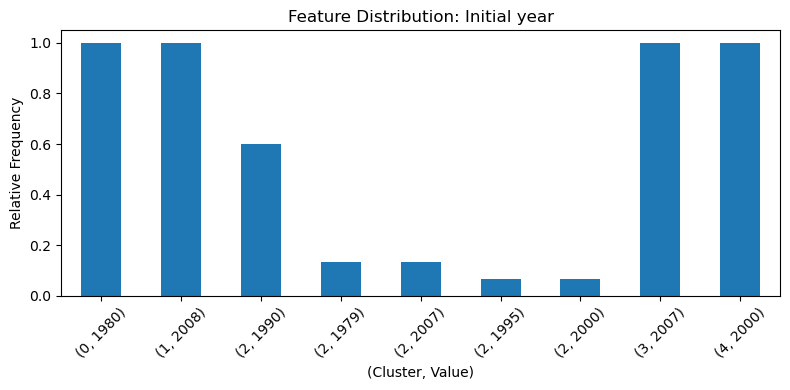

    Cluster 0 is commonly characterized by: Initial year='1980' (100% of models)
    Cluster 1 is commonly characterized by: Initial year='2008' (100% of models)
    Cluster 2 is commonly characterized by: Initial year='1990' (60% of models)
    Cluster 3 is commonly characterized by: Initial year='2007' (100% of models)
    Cluster 4 is commonly characterized by: Initial year='2000' (100% of models)

--- Feature: Initial SMB ---
cluster  Initial SMB
0        MAR            1.000000
1        RA1            1.000000
2        RA3            0.400000
         MAR            0.200000
         ISMB           0.133333
         BOX/MAR(2*)    0.066667
         BOX/RA3(4*)    0.066667
         HIR            0.066667
         RA1            0.066667
3        RA1            1.000000
4        RA1            1.000000
Name: proportion, dtype: float64


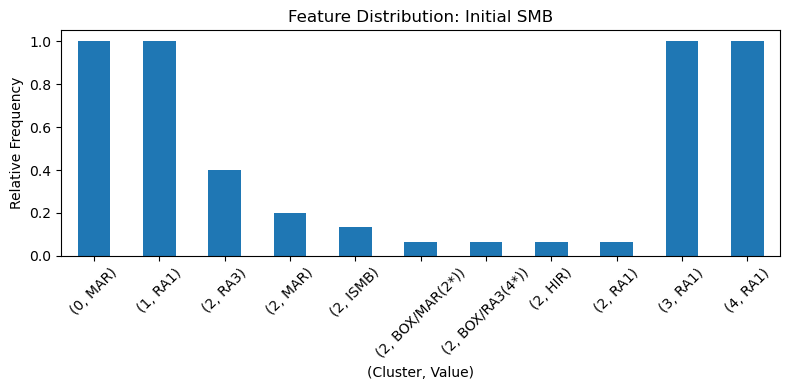

    Cluster 0 is commonly characterized by: Initial SMB='MAR' (100% of models)
    Cluster 1 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 3 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 4 is commonly characterized by: Initial SMB='RA1' (100% of models)

--- Feature: Velocity ---
cluster  Velocity
2        J           0.6
         RM          0.4
3        RM          1.0
Name: proportion, dtype: float64


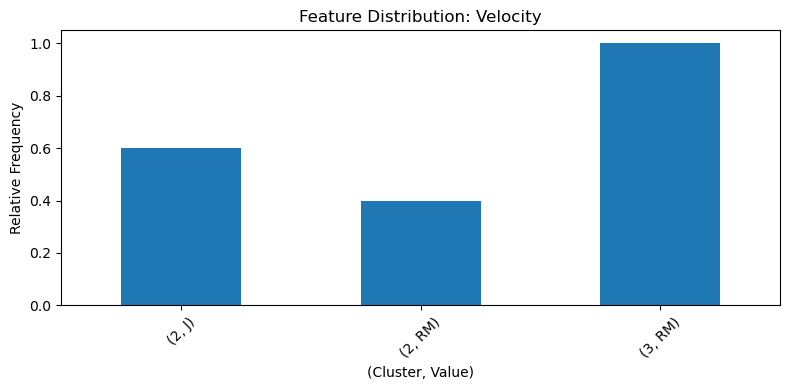

    Cluster 2 is commonly characterized by: Velocity='J' (60% of models)
    Cluster 3 is commonly characterized by: Velocity='RM' (100% of models)

--- Feature: Bed ---
cluster  Bed
0        B      1.0
1        M      1.0
2        M      1.0
3        M      1.0
4        M      1.0
Name: proportion, dtype: float64


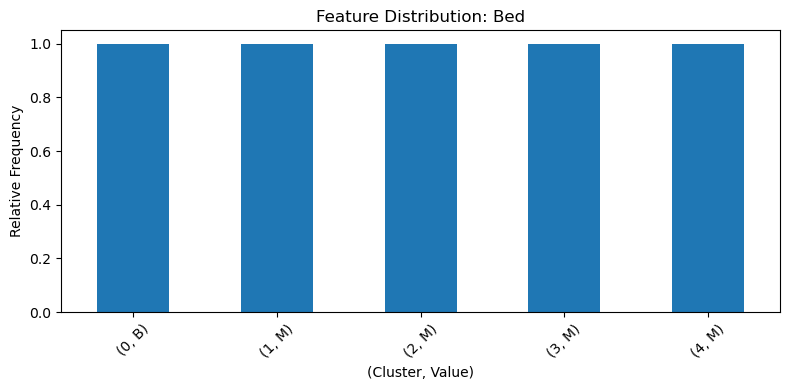

    Cluster 0 is commonly characterized by: Bed='B' (100% of models)
    Cluster 1 is commonly characterized by: Bed='M' (100% of models)
    Cluster 2 is commonly characterized by: Bed='M' (100% of models)
    Cluster 3 is commonly characterized by: Bed='M' (100% of models)
    Cluster 4 is commonly characterized by: Bed='M' (100% of models)

--- Feature: Surface/ Thickness ---
cluster  Surface/ Thickness
1        M                     1.0
2        M                     1.0
Name: proportion, dtype: float64


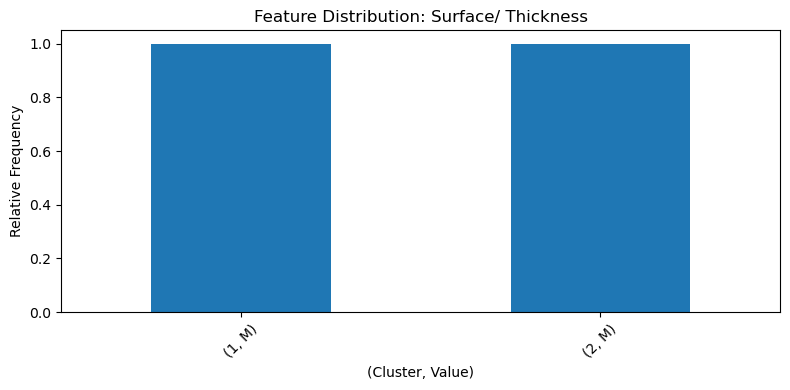

    Cluster 1 is commonly characterized by: Surface/ Thickness='M' (100% of models)
    Cluster 2 is commonly characterized by: Surface/ Thickness='M' (100% of models)

--- Feature: GH F ---
cluster  GH F
0        MIX     1.000000
1        SR      1.000000
2        SR      0.642857
         G       0.357143
3        SR      1.000000
4        SR      1.000000
Name: proportion, dtype: float64


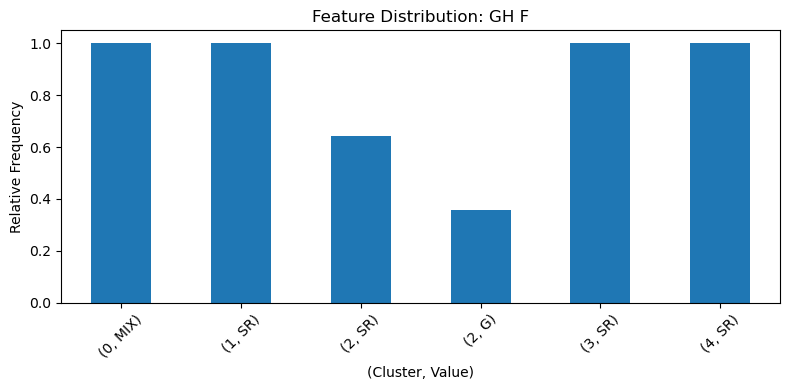

    Cluster 0 is commonly characterized by: GH F='MIX' (100% of models)
    Cluster 1 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 2 is commonly characterized by: GH F='SR' (64% of models)
    Cluster 3 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 4 is commonly characterized by: GH F='SR' (100% of models)

--- Feature: Res min ---
cluster  Res min
0        5          1.000000
1        0.9        1.000000
2        5          0.266667
         1(1*)      0.133333
         0.25       0.066667
         0.5        0.066667
         0.75       0.066667
         1          0.066667
         1.2        0.066667
         16         0.066667
         3          0.066667
         4          0.066667
         8          0.066667
3        0.2        1.000000
4        2          1.000000
Name: proportion, dtype: float64


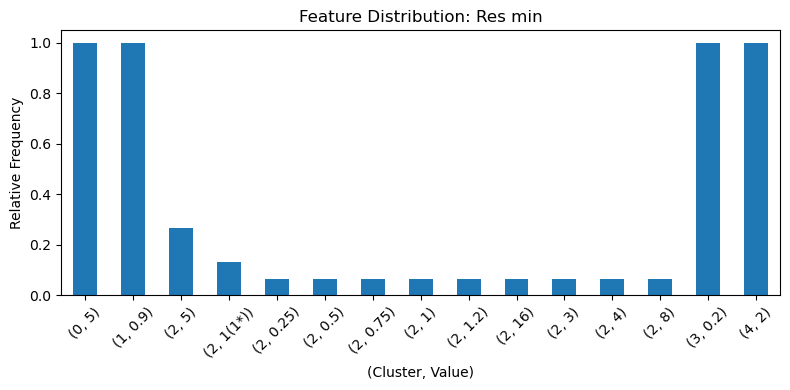

    Cluster 0 is commonly characterized by: Res min='5' (100% of models)
    Cluster 1 is commonly characterized by: Res min='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res min='0.2' (100% of models)
    Cluster 4 is commonly characterized by: Res min='2' (100% of models)

--- Feature: Res max ---
cluster  Res max
0        14(6*)     1.000000
1        0.9        1.000000
2        5          0.266667
         7.5        0.200000
         30         0.133333
         15         0.066667
         16         0.066667
         25         0.066667
         4          0.066667
         4.8        0.066667
         8          0.066667
3        20         1.000000
4        2          1.000000
Name: proportion, dtype: float64


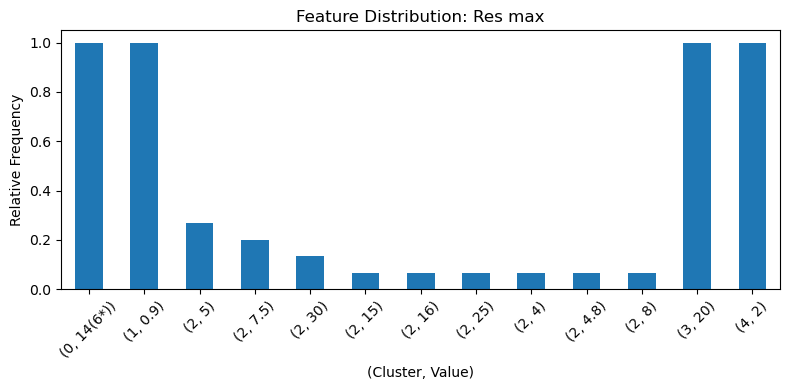

    Cluster 0 is commonly characterized by: Res max='14(6*)' (100% of models)
    Cluster 1 is commonly characterized by: Res max='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res max='20' (100% of models)
    Cluster 4 is commonly characterized by: Res max='2' (100% of models)

INTER-CLUSTER DIFFERENCES

===Features that differ between clusters (based on 50% threshold)===

 Feature: Numerics
  - Cluster 0 → 'FD/FV(5*)'
  - Cluster 1 → 'FD'
  - Cluster 2 → 'FE'
  - Cluster 3 → 'FE'
  - Cluster 4 → 'FD'

 Feature: Ice flow
  - Cluster 0 → 'HYB'
  - Cluster 1 → 'HYB'
  - Cluster 3 → 'HO'
  - Cluster 4 → 'HYB'

 Feature: Initialisation
  - Cluster 0 → 'CYC/NDm'
  - Cluster 1 → 'CYC/NDs(7*)'
  - Cluster 3 → 'DAv'
  - Cluster 4 → 'SP/NDs(7*)'

 Feature: Initial year
  - Cluster 0 → '1980'
  - Cluster 1 → '2008'
  - Cluster 2 → '1990'
  - Cluster 3 → '2007'
  - Cluster 4 → '2000'

 Feature: Initial SMB
  - Cluster 0 → 'MAR'
  - Cluster 1 → 'RA1'
  - Cluster 3 → 'RA1'
  -

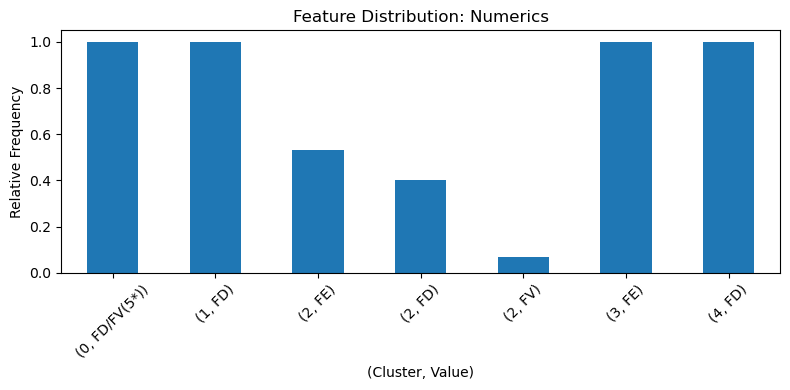

    Cluster 0 is commonly characterized by: Numerics='FD/FV(5*)' (100% of models)
    Cluster 1 is commonly characterized by: Numerics='FD' (100% of models)
    Cluster 2 is commonly characterized by: Numerics='FE' (53% of models)
    Cluster 3 is commonly characterized by: Numerics='FE' (100% of models)
    Cluster 4 is commonly characterized by: Numerics='FD' (100% of models)

--- Feature: Ice flow ---
cluster  Ice flow
0        HYB         1.000000
1        HYB         1.000000
2        HO          0.333333
         SIA         0.266667
         HYB         0.200000
         SSA         0.200000
3        HO          1.000000
4        HYB         1.000000
Name: proportion, dtype: float64


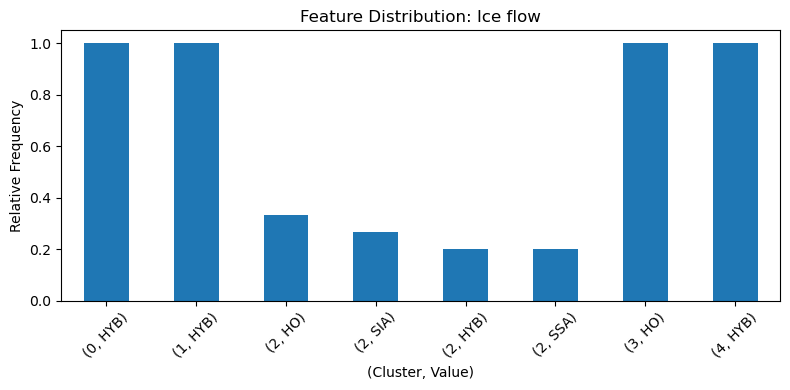

    Cluster 0 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 1 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 3 is commonly characterized by: Ice flow='HO' (100% of models)
    Cluster 4 is commonly characterized by: Ice flow='HYB' (100% of models)

--- Feature: Initialisation ---
cluster  Initialisation
0        CYC/NDm           1.000000
1        CYC/NDs(7*)       1.000000
2        DAv               0.466667
         CYC/NDs           0.133333
         SP/NDm            0.133333
         CYC/DAi(7*)       0.066667
         SP/DAi            0.066667
         SP/DAs(7*)        0.066667
         SP/DAv(3*)        0.066667
3        DAv               1.000000
4        SP/NDs(7*)        1.000000
Name: proportion, dtype: float64


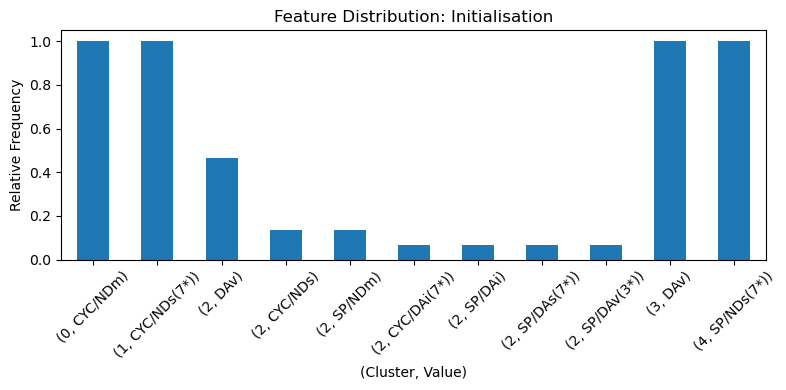

    Cluster 0 is commonly characterized by: Initialisation='CYC/NDm' (100% of models)
    Cluster 1 is commonly characterized by: Initialisation='CYC/NDs(7*)' (100% of models)
    Cluster 3 is commonly characterized by: Initialisation='DAv' (100% of models)
    Cluster 4 is commonly characterized by: Initialisation='SP/NDs(7*)' (100% of models)

--- Feature: Initial year ---
cluster  Initial year
0        1980            1.000000
1        2008            1.000000
2        1990            0.600000
         1979            0.133333
         2007            0.133333
         1995            0.066667
         2000            0.066667
3        2007            1.000000
4        2000            1.000000
Name: proportion, dtype: float64


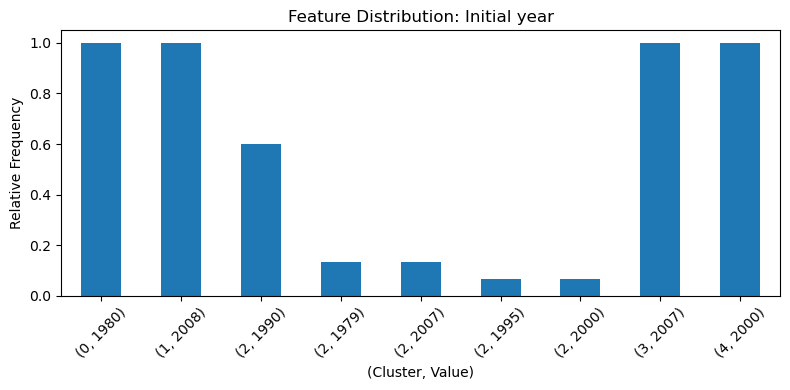

    Cluster 0 is commonly characterized by: Initial year='1980' (100% of models)
    Cluster 1 is commonly characterized by: Initial year='2008' (100% of models)
    Cluster 2 is commonly characterized by: Initial year='1990' (60% of models)
    Cluster 3 is commonly characterized by: Initial year='2007' (100% of models)
    Cluster 4 is commonly characterized by: Initial year='2000' (100% of models)

--- Feature: Initial SMB ---
cluster  Initial SMB
0        MAR            1.000000
1        RA1            1.000000
2        RA3            0.400000
         MAR            0.200000
         ISMB           0.133333
         BOX/MAR(2*)    0.066667
         BOX/RA3(4*)    0.066667
         HIR            0.066667
         RA1            0.066667
3        RA1            1.000000
4        RA1            1.000000
Name: proportion, dtype: float64


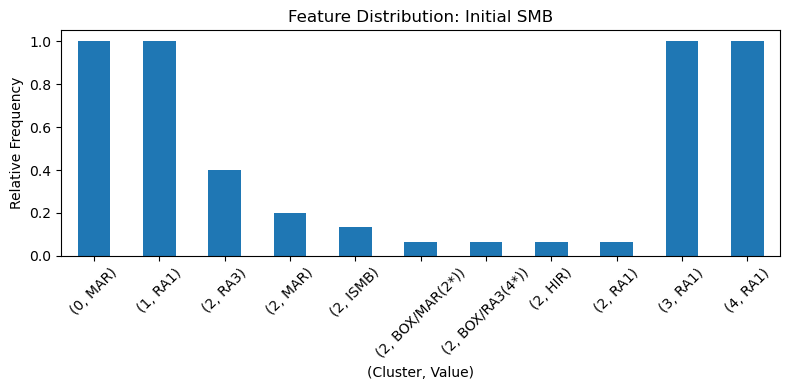

    Cluster 0 is commonly characterized by: Initial SMB='MAR' (100% of models)
    Cluster 1 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 3 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 4 is commonly characterized by: Initial SMB='RA1' (100% of models)

--- Feature: Velocity ---
cluster  Velocity
2        J           0.6
         RM          0.4
3        RM          1.0
Name: proportion, dtype: float64


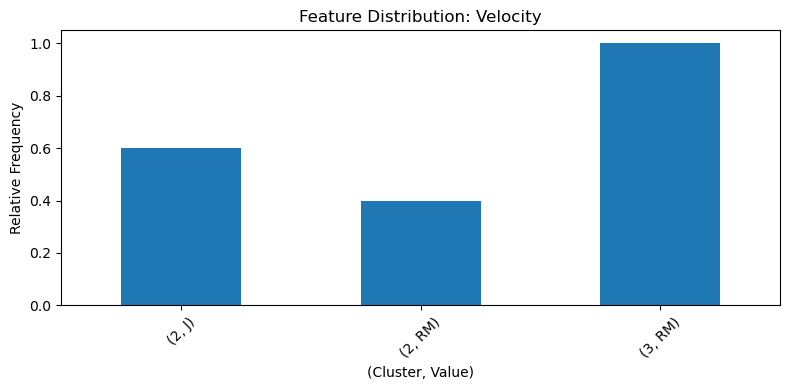

    Cluster 2 is commonly characterized by: Velocity='J' (60% of models)
    Cluster 3 is commonly characterized by: Velocity='RM' (100% of models)

--- Feature: Bed ---
cluster  Bed
0        B      1.0
1        M      1.0
2        M      1.0
3        M      1.0
4        M      1.0
Name: proportion, dtype: float64


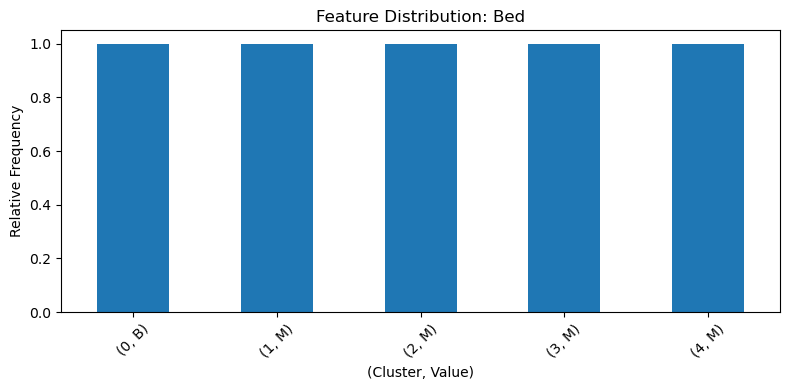

    Cluster 0 is commonly characterized by: Bed='B' (100% of models)
    Cluster 1 is commonly characterized by: Bed='M' (100% of models)
    Cluster 2 is commonly characterized by: Bed='M' (100% of models)
    Cluster 3 is commonly characterized by: Bed='M' (100% of models)
    Cluster 4 is commonly characterized by: Bed='M' (100% of models)

--- Feature: Surface/ Thickness ---
cluster  Surface/ Thickness
1        M                     1.0
2        M                     1.0
Name: proportion, dtype: float64


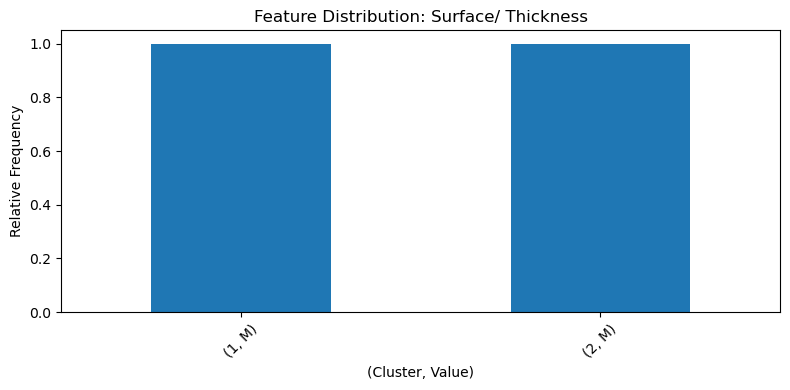

    Cluster 1 is commonly characterized by: Surface/ Thickness='M' (100% of models)
    Cluster 2 is commonly characterized by: Surface/ Thickness='M' (100% of models)

--- Feature: GH F ---
cluster  GH F
0        MIX     1.000000
1        SR      1.000000
2        SR      0.642857
         G       0.357143
3        SR      1.000000
4        SR      1.000000
Name: proportion, dtype: float64


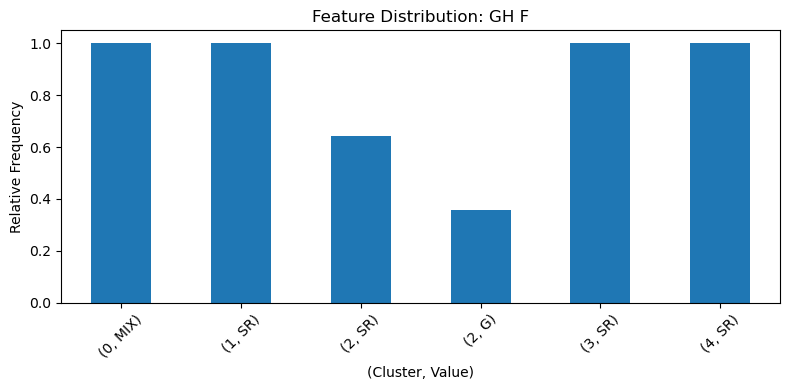

    Cluster 0 is commonly characterized by: GH F='MIX' (100% of models)
    Cluster 1 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 2 is commonly characterized by: GH F='SR' (64% of models)
    Cluster 3 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 4 is commonly characterized by: GH F='SR' (100% of models)

--- Feature: Res min ---
cluster  Res min
0        5          1.000000
1        0.9        1.000000
2        5          0.266667
         1(1*)      0.133333
         0.25       0.066667
         0.5        0.066667
         0.75       0.066667
         1          0.066667
         1.2        0.066667
         16         0.066667
         3          0.066667
         4          0.066667
         8          0.066667
3        0.2        1.000000
4        2          1.000000
Name: proportion, dtype: float64


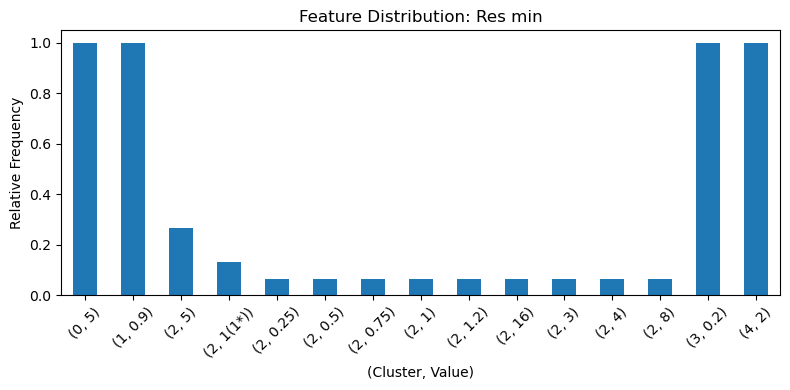

    Cluster 0 is commonly characterized by: Res min='5' (100% of models)
    Cluster 1 is commonly characterized by: Res min='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res min='0.2' (100% of models)
    Cluster 4 is commonly characterized by: Res min='2' (100% of models)

--- Feature: Res max ---
cluster  Res max
0        14(6*)     1.000000
1        0.9        1.000000
2        5          0.266667
         7.5        0.200000
         30         0.133333
         15         0.066667
         16         0.066667
         25         0.066667
         4          0.066667
         4.8        0.066667
         8          0.066667
3        20         1.000000
4        2          1.000000
Name: proportion, dtype: float64


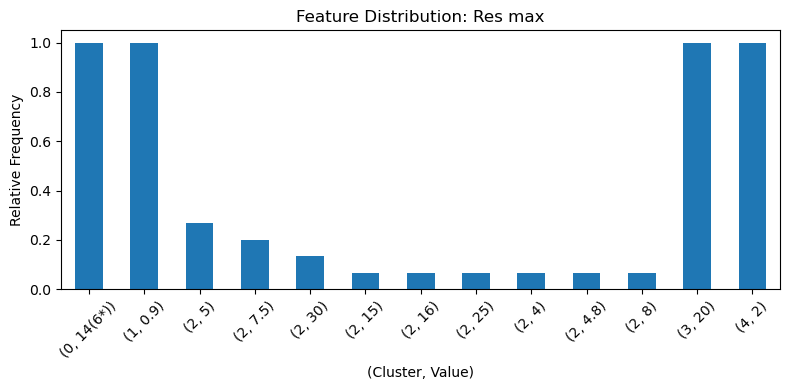

    Cluster 0 is commonly characterized by: Res max='14(6*)' (100% of models)
    Cluster 1 is commonly characterized by: Res max='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res max='20' (100% of models)
    Cluster 4 is commonly characterized by: Res max='2' (100% of models)

INTER-CLUSTER DIFFERENCES

===Features that differ between clusters (based on 50% threshold)===

 Feature: Numerics
  - Cluster 0 → 'FD/FV(5*)'
  - Cluster 1 → 'FD'
  - Cluster 2 → 'FE'
  - Cluster 3 → 'FE'
  - Cluster 4 → 'FD'

 Feature: Ice flow
  - Cluster 0 → 'HYB'
  - Cluster 1 → 'HYB'
  - Cluster 3 → 'HO'
  - Cluster 4 → 'HYB'

 Feature: Initialisation
  - Cluster 0 → 'CYC/NDm'
  - Cluster 1 → 'CYC/NDs(7*)'
  - Cluster 3 → 'DAv'
  - Cluster 4 → 'SP/NDs(7*)'

 Feature: Initial year
  - Cluster 0 → '1980'
  - Cluster 1 → '2008'
  - Cluster 2 → '1990'
  - Cluster 3 → '2007'
  - Cluster 4 → '2000'

 Feature: Initial SMB
  - Cluster 0 → 'MAR'
  - Cluster 1 → 'RA1'
  - Cluster 3 → 'RA1'
  -

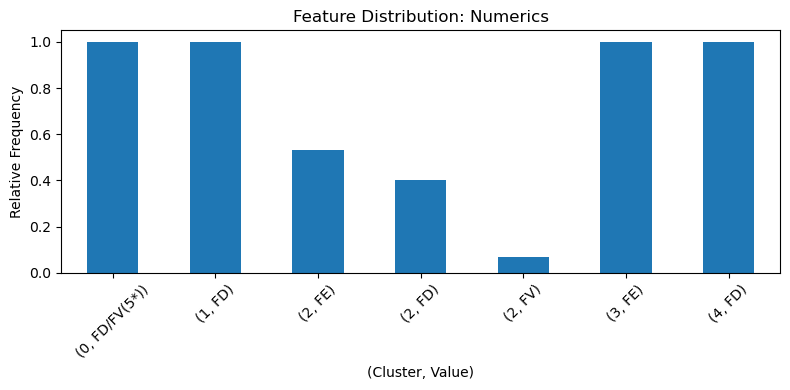

    Cluster 0 is commonly characterized by: Numerics='FD/FV(5*)' (100% of models)
    Cluster 1 is commonly characterized by: Numerics='FD' (100% of models)
    Cluster 2 is commonly characterized by: Numerics='FE' (53% of models)
    Cluster 3 is commonly characterized by: Numerics='FE' (100% of models)
    Cluster 4 is commonly characterized by: Numerics='FD' (100% of models)

--- Feature: Ice flow ---
cluster  Ice flow
0        HYB         1.000000
1        HYB         1.000000
2        HO          0.333333
         SIA         0.266667
         HYB         0.200000
         SSA         0.200000
3        HO          1.000000
4        HYB         1.000000
Name: proportion, dtype: float64


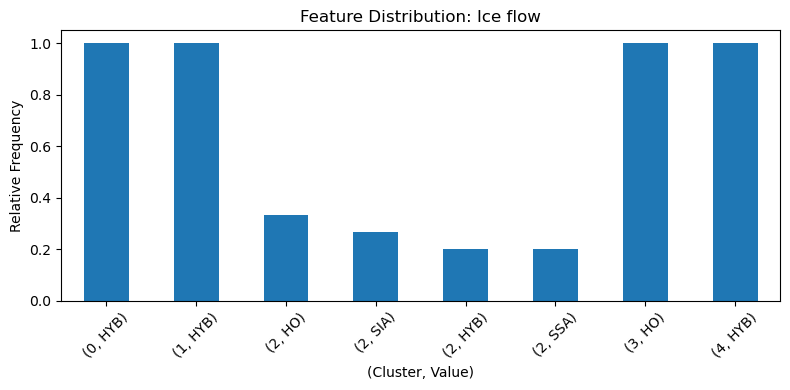

    Cluster 0 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 1 is commonly characterized by: Ice flow='HYB' (100% of models)
    Cluster 3 is commonly characterized by: Ice flow='HO' (100% of models)
    Cluster 4 is commonly characterized by: Ice flow='HYB' (100% of models)

--- Feature: Initialisation ---
cluster  Initialisation
0        CYC/NDm           1.000000
1        CYC/NDs(7*)       1.000000
2        DAv               0.466667
         CYC/NDs           0.133333
         SP/NDm            0.133333
         CYC/DAi(7*)       0.066667
         SP/DAi            0.066667
         SP/DAs(7*)        0.066667
         SP/DAv(3*)        0.066667
3        DAv               1.000000
4        SP/NDs(7*)        1.000000
Name: proportion, dtype: float64


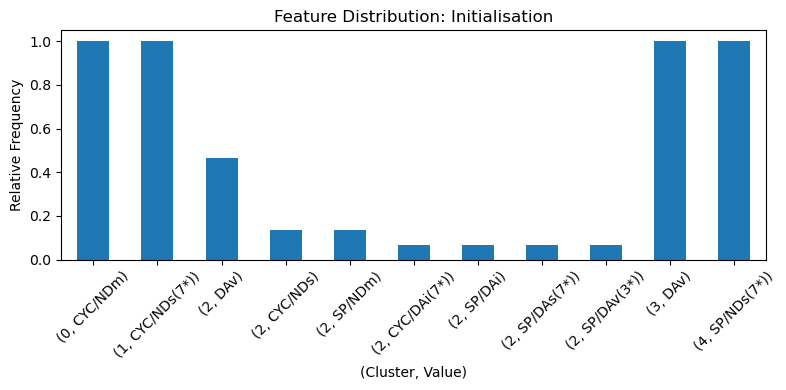

    Cluster 0 is commonly characterized by: Initialisation='CYC/NDm' (100% of models)
    Cluster 1 is commonly characterized by: Initialisation='CYC/NDs(7*)' (100% of models)
    Cluster 3 is commonly characterized by: Initialisation='DAv' (100% of models)
    Cluster 4 is commonly characterized by: Initialisation='SP/NDs(7*)' (100% of models)

--- Feature: Initial year ---
cluster  Initial year
0        1980            1.000000
1        2008            1.000000
2        1990            0.600000
         1979            0.133333
         2007            0.133333
         1995            0.066667
         2000            0.066667
3        2007            1.000000
4        2000            1.000000
Name: proportion, dtype: float64


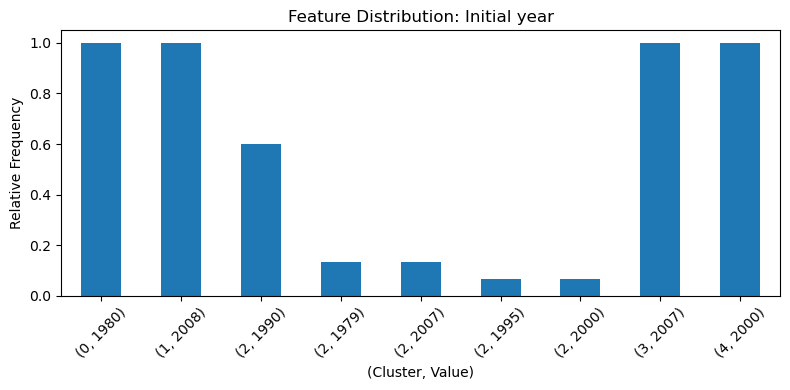

    Cluster 0 is commonly characterized by: Initial year='1980' (100% of models)
    Cluster 1 is commonly characterized by: Initial year='2008' (100% of models)
    Cluster 2 is commonly characterized by: Initial year='1990' (60% of models)
    Cluster 3 is commonly characterized by: Initial year='2007' (100% of models)
    Cluster 4 is commonly characterized by: Initial year='2000' (100% of models)

--- Feature: Initial SMB ---
cluster  Initial SMB
0        MAR            1.000000
1        RA1            1.000000
2        RA3            0.400000
         MAR            0.200000
         ISMB           0.133333
         BOX/MAR(2*)    0.066667
         BOX/RA3(4*)    0.066667
         HIR            0.066667
         RA1            0.066667
3        RA1            1.000000
4        RA1            1.000000
Name: proportion, dtype: float64


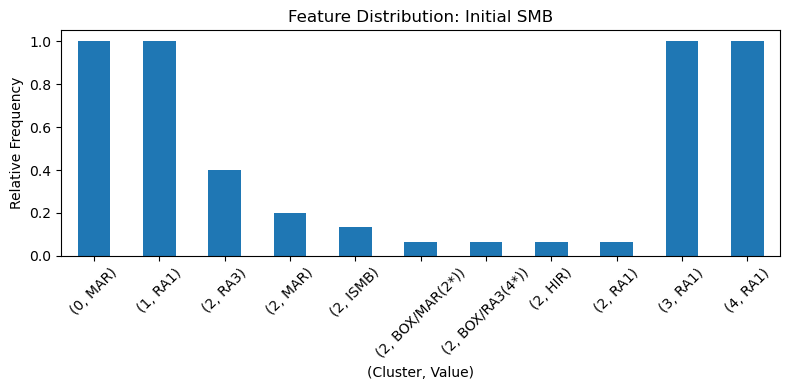

    Cluster 0 is commonly characterized by: Initial SMB='MAR' (100% of models)
    Cluster 1 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 3 is commonly characterized by: Initial SMB='RA1' (100% of models)
    Cluster 4 is commonly characterized by: Initial SMB='RA1' (100% of models)

--- Feature: Velocity ---
cluster  Velocity
2        J           0.6
         RM          0.4
3        RM          1.0
Name: proportion, dtype: float64


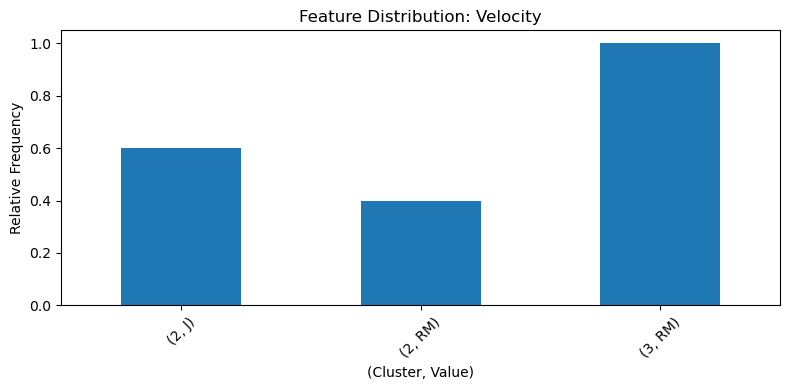

    Cluster 2 is commonly characterized by: Velocity='J' (60% of models)
    Cluster 3 is commonly characterized by: Velocity='RM' (100% of models)

--- Feature: Bed ---
cluster  Bed
0        B      1.0
1        M      1.0
2        M      1.0
3        M      1.0
4        M      1.0
Name: proportion, dtype: float64


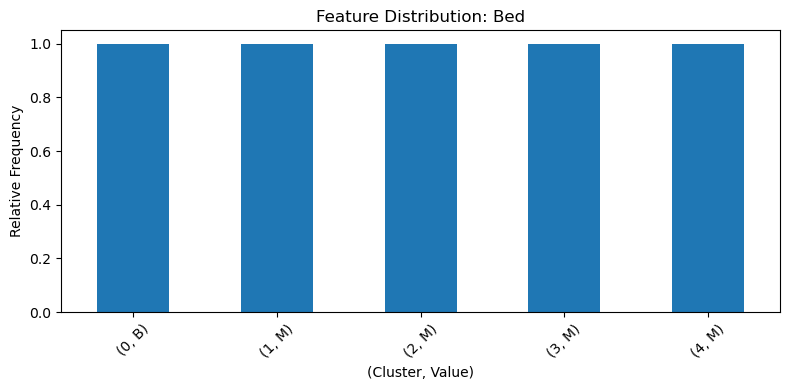

    Cluster 0 is commonly characterized by: Bed='B' (100% of models)
    Cluster 1 is commonly characterized by: Bed='M' (100% of models)
    Cluster 2 is commonly characterized by: Bed='M' (100% of models)
    Cluster 3 is commonly characterized by: Bed='M' (100% of models)
    Cluster 4 is commonly characterized by: Bed='M' (100% of models)

--- Feature: Surface/ Thickness ---
cluster  Surface/ Thickness
1        M                     1.0
2        M                     1.0
Name: proportion, dtype: float64


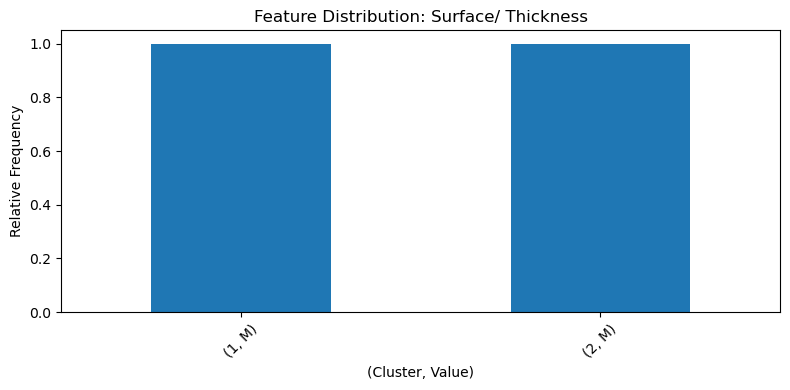

    Cluster 1 is commonly characterized by: Surface/ Thickness='M' (100% of models)
    Cluster 2 is commonly characterized by: Surface/ Thickness='M' (100% of models)

--- Feature: GH F ---
cluster  GH F
0        MIX     1.000000
1        SR      1.000000
2        SR      0.642857
         G       0.357143
3        SR      1.000000
4        SR      1.000000
Name: proportion, dtype: float64


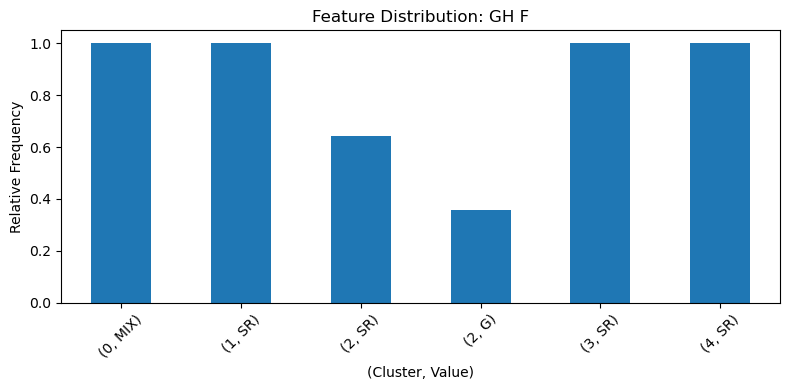

    Cluster 0 is commonly characterized by: GH F='MIX' (100% of models)
    Cluster 1 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 2 is commonly characterized by: GH F='SR' (64% of models)
    Cluster 3 is commonly characterized by: GH F='SR' (100% of models)
    Cluster 4 is commonly characterized by: GH F='SR' (100% of models)

--- Feature: Res min ---
cluster  Res min
0        5          1.000000
1        0.9        1.000000
2        5          0.266667
         1(1*)      0.133333
         0.25       0.066667
         0.5        0.066667
         0.75       0.066667
         1          0.066667
         1.2        0.066667
         16         0.066667
         3          0.066667
         4          0.066667
         8          0.066667
3        0.2        1.000000
4        2          1.000000
Name: proportion, dtype: float64


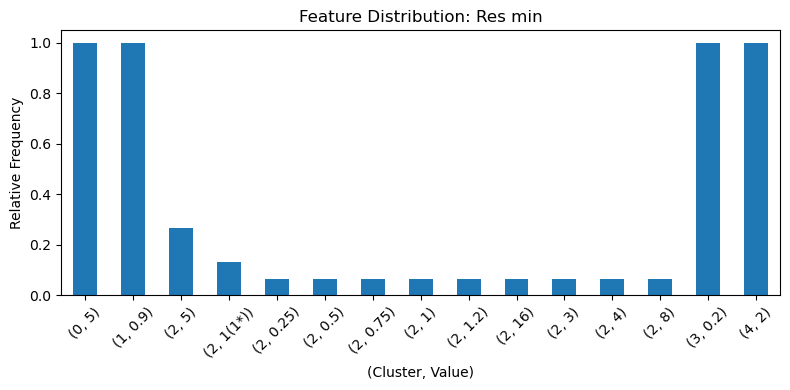

    Cluster 0 is commonly characterized by: Res min='5' (100% of models)
    Cluster 1 is commonly characterized by: Res min='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res min='0.2' (100% of models)
    Cluster 4 is commonly characterized by: Res min='2' (100% of models)

--- Feature: Res max ---
cluster  Res max
0        14(6*)     1.000000
1        0.9        1.000000
2        5          0.266667
         7.5        0.200000
         30         0.133333
         15         0.066667
         16         0.066667
         25         0.066667
         4          0.066667
         4.8        0.066667
         8          0.066667
3        20         1.000000
4        2          1.000000
Name: proportion, dtype: float64


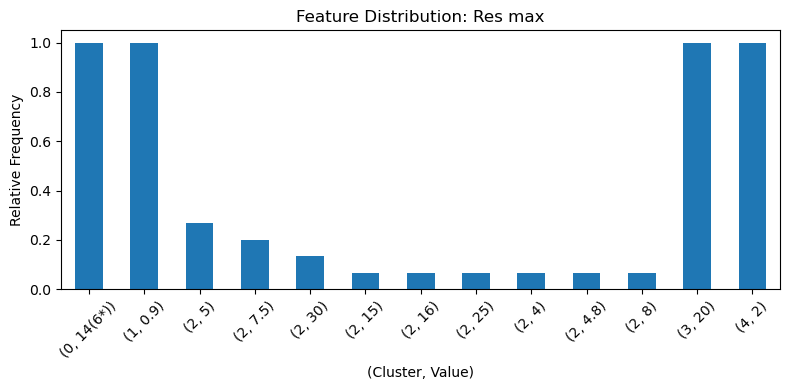

    Cluster 0 is commonly characterized by: Res max='14(6*)' (100% of models)
    Cluster 1 is commonly characterized by: Res max='0.9' (100% of models)
    Cluster 3 is commonly characterized by: Res max='20' (100% of models)
    Cluster 4 is commonly characterized by: Res max='2' (100% of models)

INTER-CLUSTER DIFFERENCES

===Features that differ between clusters (based on 50% threshold)===

 Feature: Numerics
  - Cluster 0 → 'FD/FV(5*)'
  - Cluster 1 → 'FD'
  - Cluster 2 → 'FE'
  - Cluster 3 → 'FE'
  - Cluster 4 → 'FD'

 Feature: Ice flow
  - Cluster 0 → 'HYB'
  - Cluster 1 → 'HYB'
  - Cluster 3 → 'HO'
  - Cluster 4 → 'HYB'

 Feature: Initialisation
  - Cluster 0 → 'CYC/NDm'
  - Cluster 1 → 'CYC/NDs(7*)'
  - Cluster 3 → 'DAv'
  - Cluster 4 → 'SP/NDs(7*)'

 Feature: Initial year
  - Cluster 0 → '1980'
  - Cluster 1 → '2008'
  - Cluster 2 → '1990'
  - Cluster 3 → '2007'
  - Cluster 4 → '2000'

 Feature: Initial SMB
  - Cluster 0 → 'MAR'
  - Cluster 1 → 'RA1'
  - Cluster 3 → 'RA1'
  -

In [5]:
# Analysis and Plotting 
# This is the main analysis cell.

# Load the complete model characteristics file
features_all = pd.read_csv(r"C:\ISMIP6_EXP_ALL - GIS_Model_Characteristics.csv", skiprows=[*range(22, 32)])

# MODIFICATION: Set 'Model ID' as the index to allow for reordering.
features_all = features_all.set_index('Model ID')

# MODIFICATION: Filter AND reorder the characteristics table to exactly match
# the order of the models in our clustered data. This is the key step.
# .reindex() ensures the order is identical to 'participating_models'.
features = features_all.reindex(participating_models).copy()

# Now, we can safely assign the cluster labels. They will match row-for-row.
features['cluster'] = labels

# Reset the index if subsequent code needs 'Model ID' as a column
features = features.reset_index()

# The rest of the analysis can now proceed correctly.
base_output_dir = os.path.join("Research_Plots", f"{exp_id}_{var_name}_plots")
os.makedirs(base_output_dir, exist_ok=True)

# Define a single time window for the entire period

# Finding similarities and differences of models based on cluster
all_time_window_cluster_data = {}

# Loop over all time windows (in this case, only one)
for time_window_label, (start_idx, end_idx) in time_windows.items():
    print(" ")
    print("\n" + "="*100)
    print(f"\n Processing: {time_window_label}...")
    print("="*100)
    print(" ")

    folder_name = time_window_label.replace(" ", "_").replace("(", "").replace(")", "")
    time_window_output_dir = os.path.join(base_output_dir, folder_name)
    os.makedirs(time_window_output_dir, exist_ok=True)

    # Check cluster distribution
    print(f"Cluster distribution: \n{features['cluster'].value_counts().sort_index()}")
    print()

    # Skip unneeded columns for frequency analysis
    skip_cols = ['Model ID', 'cluster']

    print("="*50)
    print("INTRA-CLUSTER SIMILARITIES")
    print("="*50)

    for col in features.columns:
        if col not in skip_cols:
            # Group by k-means clusters
            freq_table = features.groupby('cluster')[col].value_counts(normalize=True)
        
            print(f"\n--- Feature: {col} ---")
            print(freq_table)
        
            # Plot relative frequency
            plt.figure(figsize=(8, 4))
            freq_table.plot(kind='bar')
            plt.title(f'Feature Distribution: {col}')
            plt.xlabel('(Cluster, Value)')
            plt.ylabel('Relative Frequency')
            plt.xticks(rotation=45)
            plt.tight_layout()
            plt.show()
        
            # Print features that are common across a cluster
            threshold = 0.5 # Threshold for determining similar features across a cluster (50%)
        
            for (cluster_label, value), freq in freq_table.items():
                if freq >= threshold:
                    print(f"    Cluster {cluster_label} is commonly characterized by: {col}='{value}' ({freq:.0%} of models)")


    # Finding differences between two clusters
    print("\n" + "="*50)
    print("INTER-CLUSTER DIFFERENCES")
    print("="*50)

    threshold = 0.5 # Threshold for differences in features (50%)
    cluster_feature_modes = {}

    for col in features.columns:
        if col not in skip_cols:
            freq_table = features.groupby('cluster')[col].value_counts(normalize=True)
            for (cluster_label, value), freq in freq_table.items():
                if freq >= threshold:
                    cluster_feature_modes[(cluster_label, col)] = (value, freq)

    print("\n===Features that differ between clusters (based on 50% threshold)===")
    for col in features.columns:
        if col not in skip_cols:
            dom_values = []
            for cluster_label in sorted(features['cluster'].unique()):
                key = (cluster_label, col)
                if key in cluster_feature_modes:
                    dom_values.append((cluster_label, cluster_feature_modes[key][0]))
            
            if len(dom_values) > 1:
                unique_vals = set(val for cluster_label, val in dom_values)
                if len(unique_vals) > 1:
                    print(f"\n Feature: {col}")
                    for cluster_label, value in dom_values:
                        print(f"  - Cluster {cluster_label} → '{value}'")

    current_time_window_df_data = {}
    for (cluster_label, col), (value, freq) in cluster_feature_modes.items():
        if col not in current_time_window_df_data:
            current_time_window_df_data[col] = {}
        current_time_window_df_data[col][cluster_label] = f"{value} ({freq:.0%})"

    all_clusters_for_this_window = sorted(features['cluster'].unique())
    time_window_df = pd.DataFrame(current_time_window_df_data).T
    time_window_df = time_window_df.reindex(columns=all_clusters_for_this_window, fill_value="N/A")
    time_window_df.columns = [f"Cluster {c}" for c in time_window_df.columns]
    all_time_window_cluster_data[time_window_label] = time_window_df

    print(f"\n--- Dominant Features per Cluster ({time_window_label}) ---")
    print(time_window_df.to_string())
    print("\n" + "="*100)
    
    time_step_table_filename = os.path.join(time_window_output_dir, f"{var_name}_{exp_id}_Cluster_Features_{folder_name}.csv")
    time_window_df.to_csv(time_step_table_filename)
    print(f"Saved time step table to: {time_step_table_filename}")

In [ ]:
# Plot same PCs as before but without outlier models

# Step 1: Loop through timesteps and print outlier models

for time_window_label, (start_idx, end_idx) in time_windows.items():
    print(f"\n Processing: {time_window_label}...")
    # Linking Model ID to outlier points

    pc1 = pca_scores[:,0]
    pc2 = pca_scores[:,1]
    pc3 = pca_scores[:,2]

    # PC1 vs PC2 vs PC3 3D Scatter Plot
    # Computing coordinates' distance from centroid
    coords = np.column_stack((pc1, pc2, pc3))
    centroid = coords.mean(axis=0)
    distances = np.linalg.norm(coords - centroid, axis=1)

    # Getting indices of furthest points
    outlier_indices = np.argsort(distances)[-3:] # Finding 3 furthest points (change based on scatter plot results)

    # Print Model IDs for outlier points
    outlier_models = models.iloc[outlier_indices] if isinstance (participating_models, pd.Series) else np.array(participating_models)[outlier_indices]
    print("PC1 vs PC2 vs PC3 Outlier Model IDs:")
    print(outlier_models)

In [ ]:
# Step 2: Plot same PC plots from before, omitting outlier_models

# Define base output directory (should already be defined if following previous steps)
base_output_dir = os.path.join("Research_Plots", f"{exp_id}_{var_name}_plots")
os.makedirs(base_output_dir, exist_ok=True)

# Loop over all time windows
for time_window_label, (start_idx, end_idx) in time_windows.items():
    print(f"\n Processing: {time_window_label}...")
    
    # Create directory for each time window
    folder_name = time_window_label.replace(" ", "_").replace("(","").replace(")", "")
    time_window_output_dir = os.path.join(base_output_dir, folder_name)
    os.makedirs(time_window_output_dir, exist_ok=True)

    # --- IMPORTANT: Get grid coordinates from the first model in var_list ---
    if var_list:
        first_var_dataarray = var_list[0]
        x_coords = first_var_dataarray['x'].values if 'x' in first_var_dataarray.coords else first_var_dataarray.coords['x'].values
        y_coords = first_var_dataarray['y'].values if 'y' in first_var_dataarray.coords else first_var_dataarray.coords['y'].values
        
        rows = len(y_coords)
        cols = len(x_coords)
        matrix_size = rows * cols
    else:
        print("Error: var_list is empty. Cannot get grid coordinates for plotting.")
        continue 

    # Step 1: Compute variable deltas for the current time window and remove NaNs (for all models)
    current_window_deltas = []
    for i, var_model_data in enumerate(var_list):
        delta = var_model_data.isel(time=end_idx) - var_model_data.isel(time=start_idx)
        
        target_shape = (rows, cols) 
        delta_array = delta.values if hasattr(delta, 'values') else delta
        resized_delta = resize(delta_array, target_shape, anti_aliasing=True)
        flat_delta = resized_delta.flatten()
        
        current_window_deltas.append(flat_delta)

    all_deltas = np.stack(current_window_deltas)
    mask = ~np.any(np.isnan(all_deltas), axis=0)
    data_matrix_full = all_deltas[:, mask]  # Full data matrix (n_models, n_valid_points)
    
    # Get valid grid indices based on the mask (same for both full and filtered data)
    gd = np.where(mask)[0]

    # Create a mask for non-outlier models
    all_model_indices = np.arange(len(participating_models))
    non_outlier_indices = np.setdiff1d(all_model_indices, outlier_indices)
    
    # Filter the data matrix to exclude outliers
    data_matrix_filtered = data_matrix_full[non_outlier_indices, :]
    
    # Update the list of participating models to only include non-outliers for later plotting
    participating_models_filtered = np.array(participating_models)[non_outlier_indices].tolist()

    # --- Step 2: PCA (on Filtered Data) ---
    # Standardize
    scaler = StandardScaler()
    data_matrix_filtered_scaled = scaler.fit_transform(data_matrix_filtered)
    # This PCA is now performed on data WITHOUT outliers, and its components will be used for spatial plots
    pca_filtered = PCA(n_components=n_components)
    pca_scores_filtered = pca_filtered.fit_transform(data_matrix_filtered_scaled)
    no_outlier_pca_components = pca_filtered.components_ # Components from filtered data
    
    # Step 3: K-Means (on Filtered Data)
    kmeans_filtered = KMeans(n_clusters=n_clusters, random_state=0, n_init='auto') 
    labels_filtered = kmeans_filtered.fit_predict(pca_scores_filtered)
    
    # Step 4: Plot PCs onto the grid (USING COMPONENTS FROM FILTERED DATA)
    for pc_idx in range(n_components):
        pc_values = no_outlier_pca_components[pc_idx, :] 
        
        C = np.full(matrix_size, np.nan)
        C[gd.astype(int)] = pc_values
        pc_map = C.reshape((rows, cols)) 
        
        plt.figure(figsize=(12,8))
        
        vmax = 0.005 # Change depending on dataset
        
        im = plt.imshow(pc_map, cmap='bwr_r', origin='lower', vmin=-vmax, vmax=vmax)
        plt.colorbar(im, label=f'PC{pc_idx + 1}')
        plt.xlabel('x')
        plt.ylabel('y')
        plt.title(f'PC #{pc_idx + 1} (Excluding Outliers) ({time_window_label}) - Explained Variance: {pca_filtered.explained_variance_ratio_[pc_idx]*100:.1f}%')
        plt.axis('equal')
        
        pc_plot_filename = os.path.join(time_window_output_dir, f"{var_name}_{exp_id}_PC_{pc_idx + 1}_NoOutliers_{folder_name}.png")
        plt.savefig(pc_plot_filename, bbox_inches='tight', dpi=300)
        
        plt.show()
    
    # Step 5: Plot signed contribution of each PC onto the grid (USING COMPONENTS FROM FILTERED DATA)
    for pc_idx in range(n_components):
        pc_values = no_outlier_pca_components[pc_idx, :] 
        
        sum_sq_pc = np.sum(pc_values ** 2)
        if sum_sq_pc == 0:
            signed_contrib = np.zeros_like(pc_values)
        else:
            signed_contrib = 100 * np.sign(pc_values) * (pc_values ** 2) / sum_sq_pc
        
        C = np.full(matrix_size, np.nan)
        C[gd.astype(int)] = signed_contrib
        sc_map = C.reshape((rows, cols))
        
        plt.figure(figsize=(12,8))
        
        vmax = 0.005 # Change depending on dataset
        
        im = plt.imshow(sc_map, cmap='bwr_r', origin='lower', vmin=-vmax, vmax=vmax)
        plt.colorbar(im, label='Signed Contribution %')
        plt.xlabel('x')
        plt.ylabel('y')
        plt.title(f'Grid contribution to PC #{pc_idx + 1} (%) (Excluding Outliers) - Explained Variance: {pca_filtered.explained_variance_ratio_[pc_idx]*100:.1f}% ({time_window_label})')
        plt.axis('equal')
        
        sc_plot_filename = os.path.join(time_window_output_dir, f"{var_name}_{exp_id}_Signed_Contrib_PC{pc_idx + 1}_NoOutliers_{folder_name}.png")
        plt.savefig(sc_plot_filename, bbox_inches='tight', dpi=300)
        
        plt.show()
        
    # --- Step 7: Plotting the Sum of PC Vectors onto the grid ---
    print(f"\n Generating Sum of PC Vectors plot for {time_window_label}...")

    # Calculate the sum of all principal component values for each grid point
    # correct_pca_components has shape (n_components, n_valid_points)
    # Summing along axis=0 adds up the PC values for each grid point across all components
    summed_pc_values = np.sum(no_outlier_pca_components, axis=0)
    ex_var = pca.explained_variance_ratio_
    cum_ex_var = np.cumsum(ex_var)
    cumulative_variance_of_first_four = cum_ex_var[3] 

    # Create a grid of NaNs and insert the summed PC values at valid grid indices (gd)
    C_summed = np.full(matrix_size, np.nan)
    C_summed[gd.astype(int)] = summed_pc_values
    summed_pc_map = C_summed.reshape((rows, cols)) # Reshape to 2D grid

    # Plotting the summed PC map
    plt.figure(figsize=(12,8))
    
    # Determine a suitable vmax dynamically for the colorbar
    # Using np.percentile can help avoid extreme outliers in color scaling
    vmax_summed = np.percentile(np.abs(summed_pc_values[~np.isnan(summed_pc_values)]), 99) * 0.5 # Using 99th percentile for robust scaling
    if vmax_summed == 0: vmax_summed = 0.01 # Fallback for cases with no variance

    im = plt.imshow(summed_pc_map, cmap='bwr_r', origin='lower', vmin=-vmax_summed, vmax=vmax_summed)
    plt.colorbar(im, label='Sum of All Principal Components')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title(f'Sum of All Principal Components on Grid (Excluding Outliers) - Cum. Variance: {cumulative_variance_of_first_four*100:.1f}% ({time_window_label})')
    plt.axis('equal')
    
    # Save the plot
    summed_pc_plot_filename = os.path.join(time_window_output_dir, f"{var_name}_{exp_id}_Summed_PCs_NoOutliers_{folder_name}.png")
    plt.savefig(summed_pc_plot_filename, bbox_inches='tight', dpi=300)
    
    plt.show()

In [ ]:
# Create a timelapse of Sum of All PC plots across all timesteps

# List to hold paths of images in sequence
image_data_list = []
print(f"Preparing timelapse for experiment '{exp_id}'...")

# Load images and find minimum dimensions for resizing
min_height = float('inf')
min_width = float('inf')
valid_filenames = []

# Loop through time windows
for time_window_label, _ in time_windows.items():
    folder_name = time_window_label.replace(" ", "_").replace("(","").replace(")", "")
    # Construct the filename for the summed PC plot for this time window
    image_filename = f"{var_name}_{exp_id}_Summed_PCs_{folder_name}.png"
    image_path = os.path.join(base_output_dir, folder_name, image_filename)
    
    if os.path.exists(image_path):
        try:
            img = imageio.v2.imread(image_path)
            current_height, current_width, _ = img.shape
            
            min_height = min(min_height, current_height)
            min_width = min(min_width, current_width)
            
            image_data_list.append(img) # Store original image data for resizing later
            valid_filenames.append(image_path) # Keep track of which files were successfully loaded
            print(f"Loaded image: '{os.path.basename(image_path)}' with shape: {img.shape}")
        except Exception as e:
            print(f"Warning: Image not found for {time_window_label} at {image_path}. Skipping.")
        
if not image_data_list:
    print("No valid images found for timelapse. Ensure plotting cell ran successfully and paths are correct")
else:
    target_shape = (min_height, min_width, image_data_list[0].shape[2])
    print(f"\nAll images will be resized to a consistent shape of: {target_shape}")
          
    resized_images = []
    for i, img_data in enumerate(image_data_list):
        # Resize the image. 'anti_aliasing=True' for better quality
        # Ensure image data type is float before resizing, then convert back to uint8 for GIF
        img_float = img_data.astype(np.float64) / 255.0 # Normalize to [0,1] for resize
        resized_img = resize(img_float, target_shape, anti_aliasing=True)
        resized_images.append((resized_img * 255).astype(np.uint8)) # Convert back to [0,255]
        
    # Define the output GIF filename
    output_gif_filename = os.path.join(base_output_dir, f"{var_name}_{exp_id}_Summed_PCs_Timelapse.gif")
    
    # Create the GIF
    # Duration is in seconds per frame. Adjust as desired (e.g., 0.5 for 2 fps)
    target_fps = 2.0
    imageio.mimsave(output_gif_filename, resized_images, fps = target_fps, loop=0)
    
    print(f"\nTimelapse GIF created successfully: {output_gif_filename}")


 Processing: 2015-2025...

--- Generating Cluster-Mean Physical Maps ---


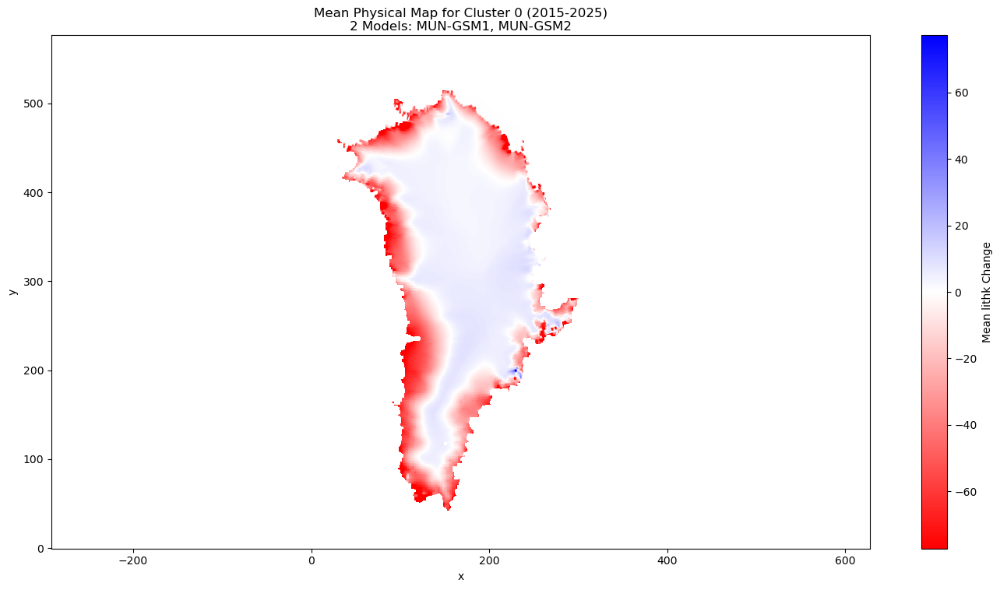

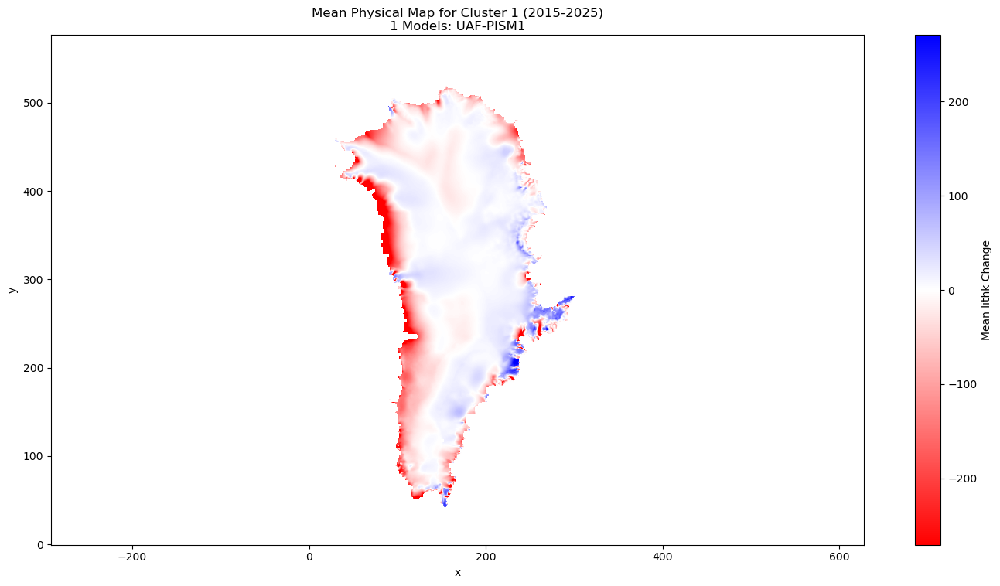

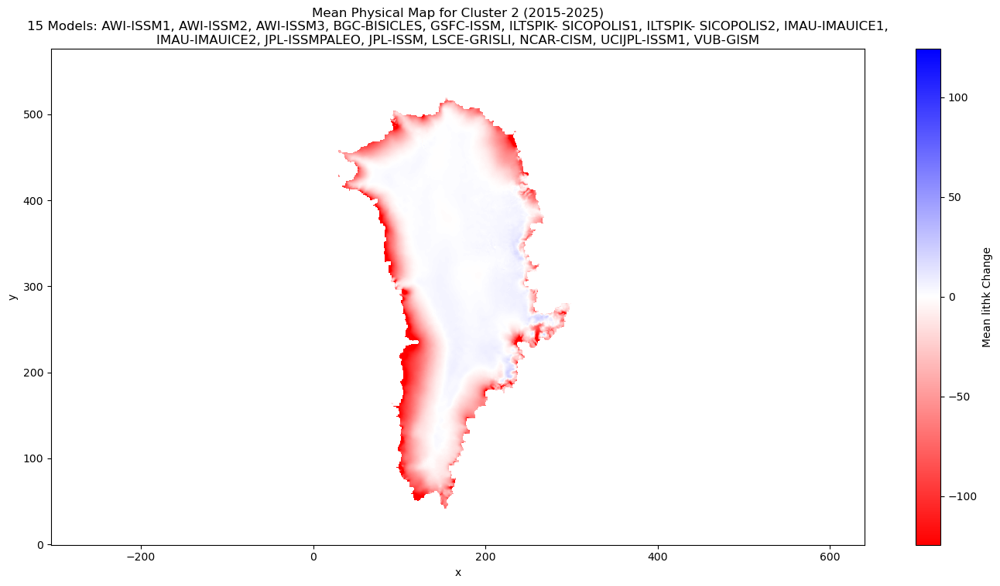

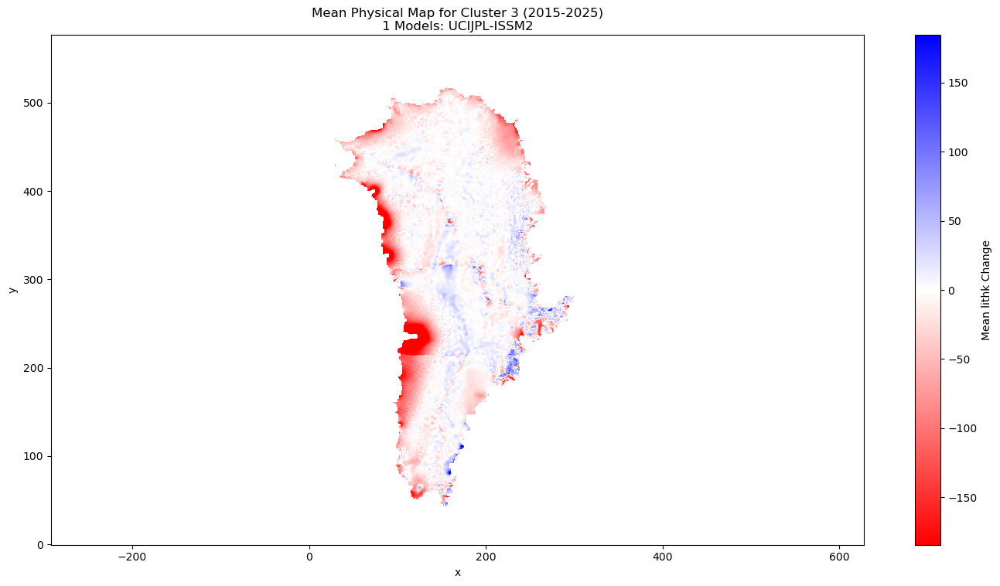

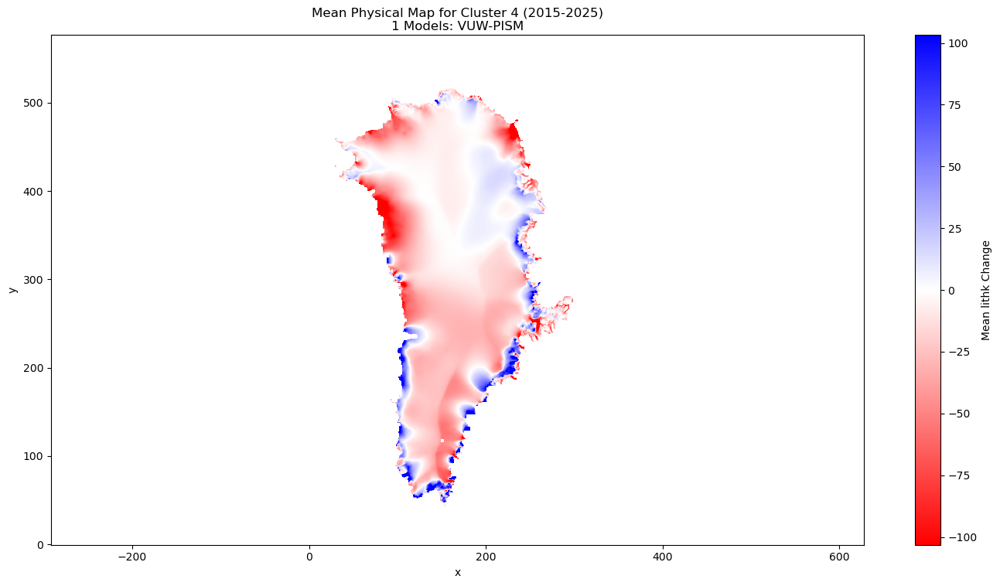


 Processing: 2015-2035...

--- Generating Cluster-Mean Physical Maps ---


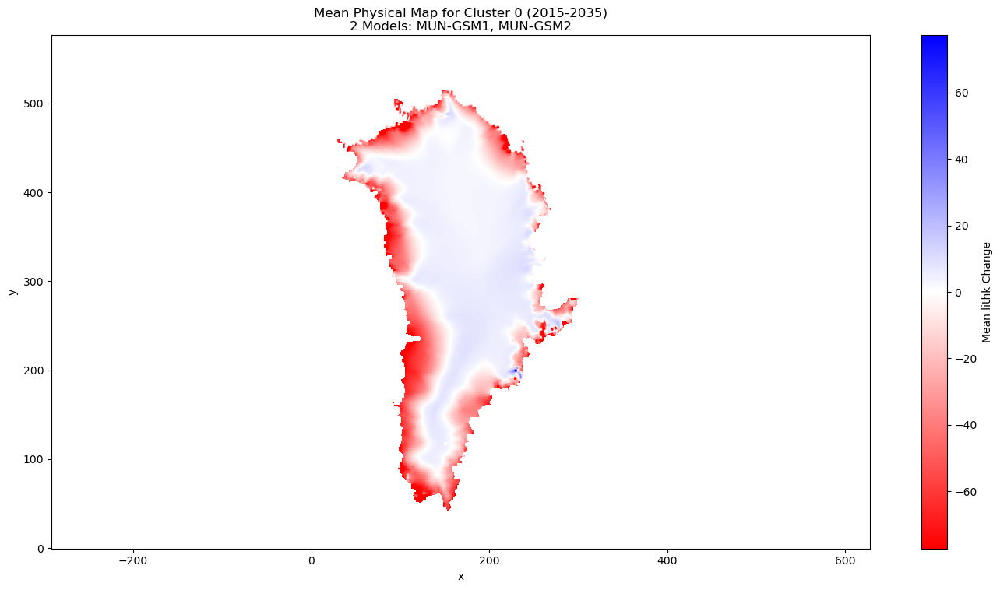

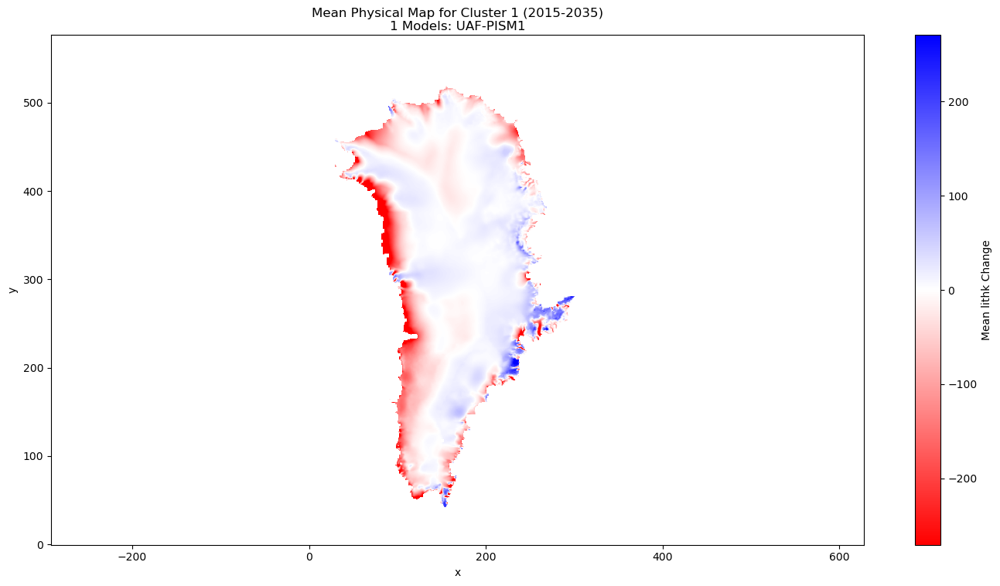

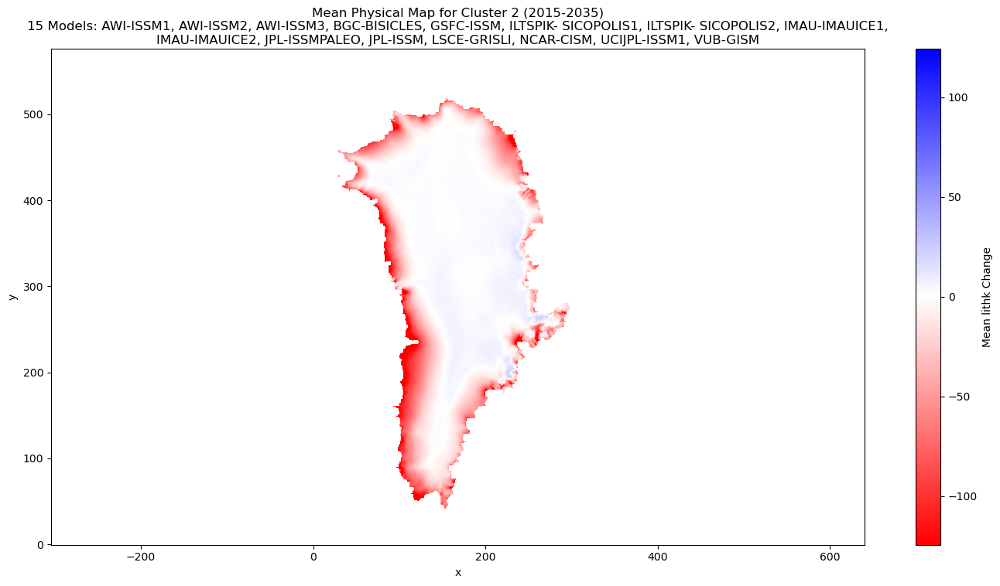

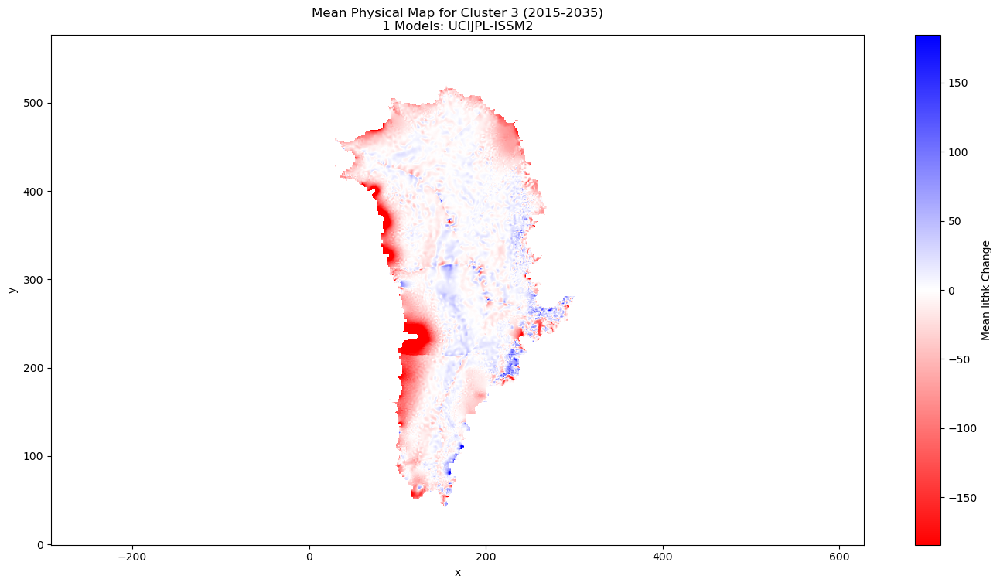

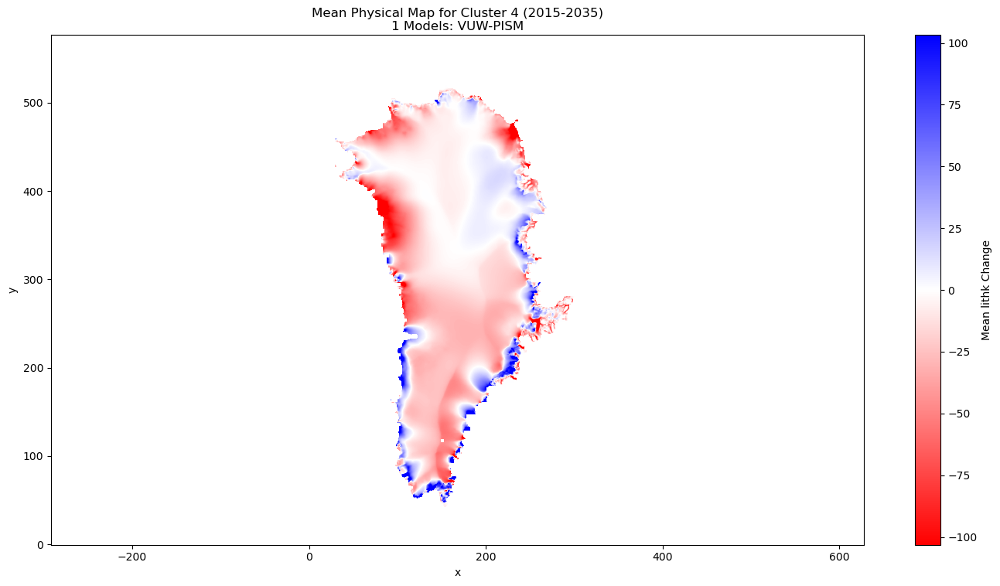


 Processing: 2015-2045...

--- Generating Cluster-Mean Physical Maps ---


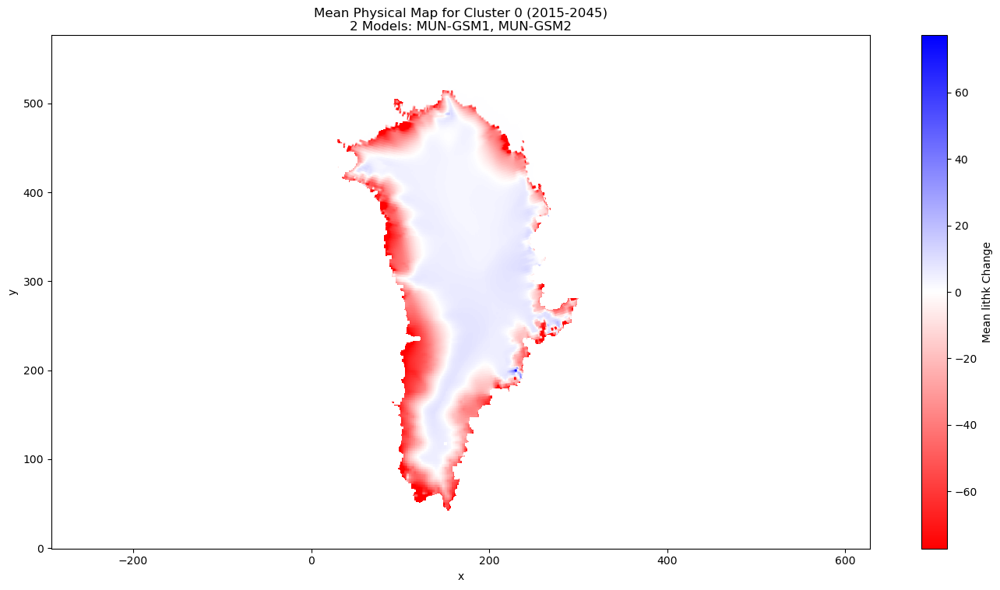

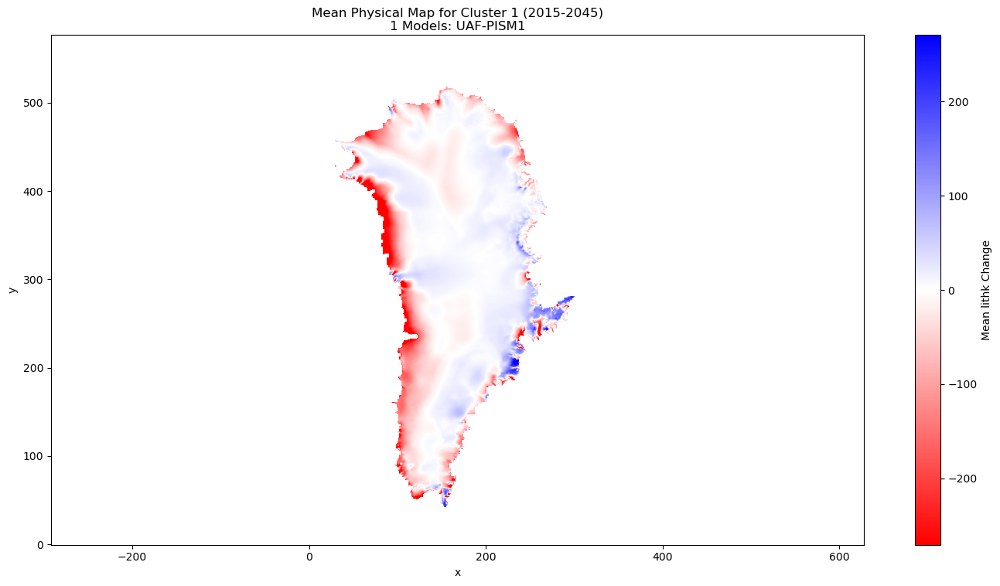

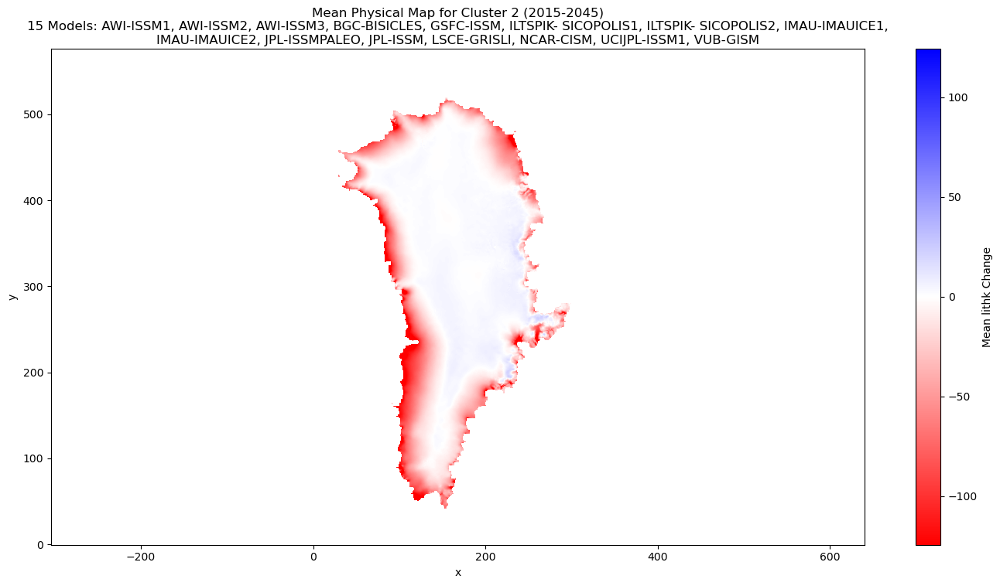

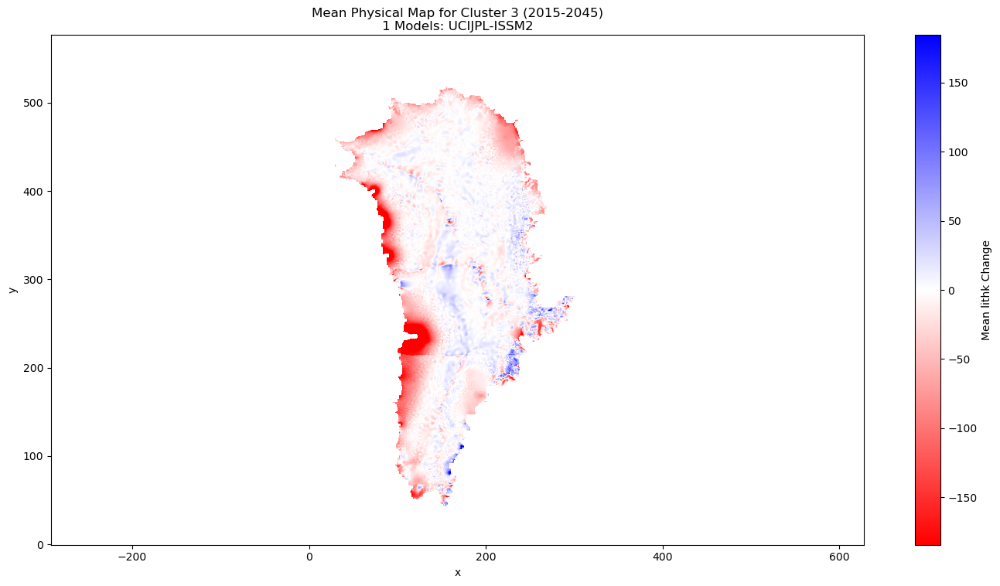

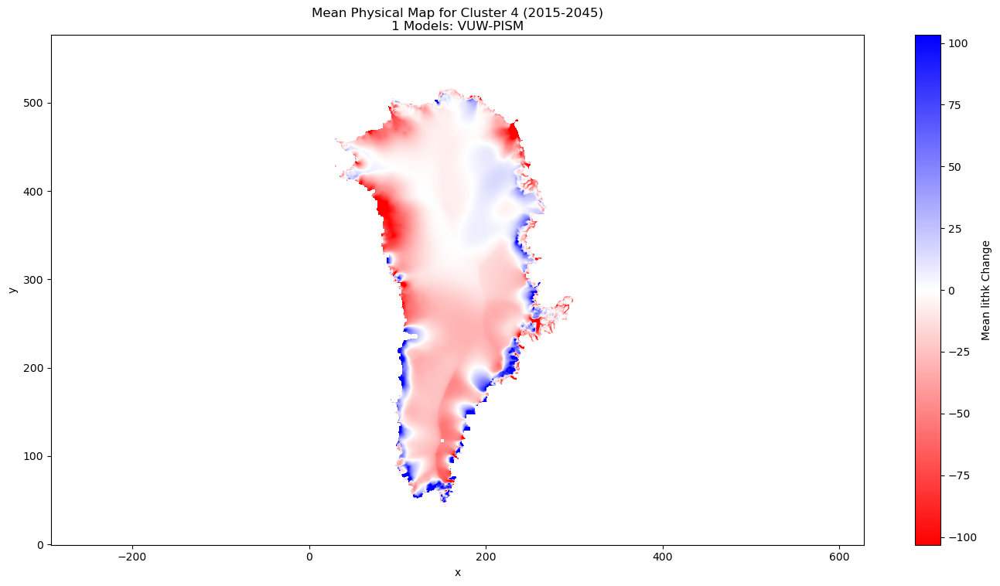


 Processing: 2015-2055...

--- Generating Cluster-Mean Physical Maps ---


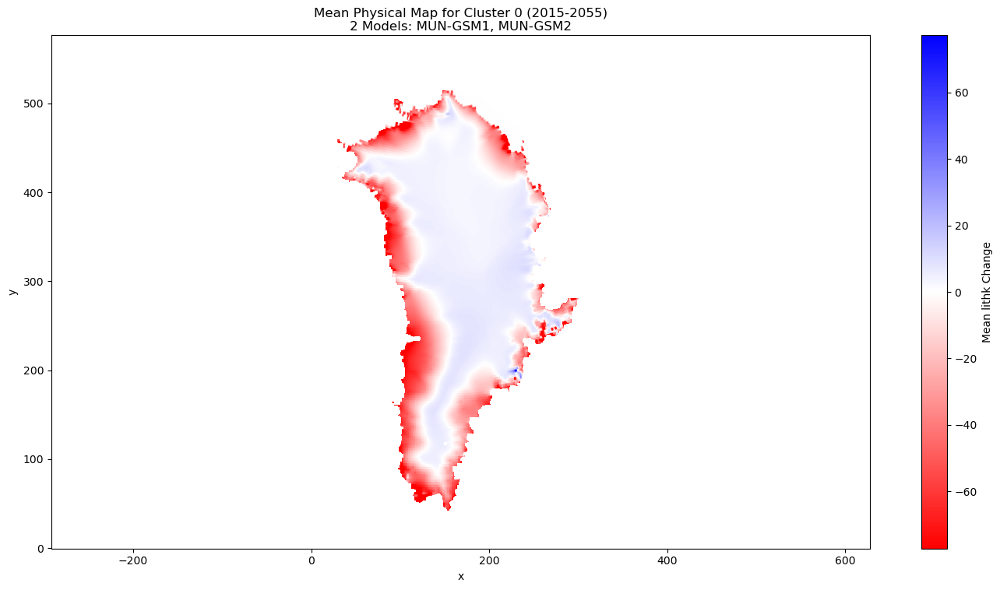

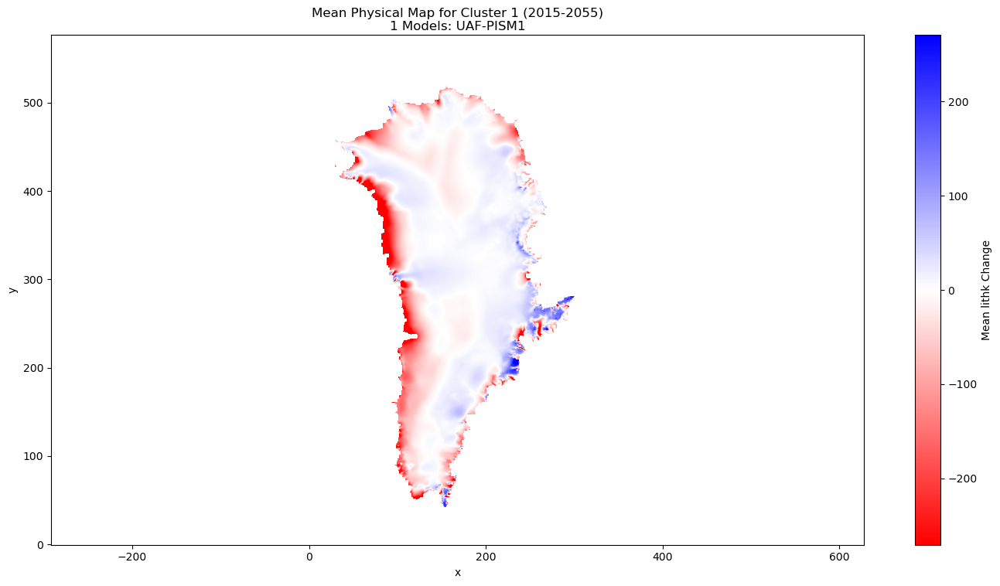

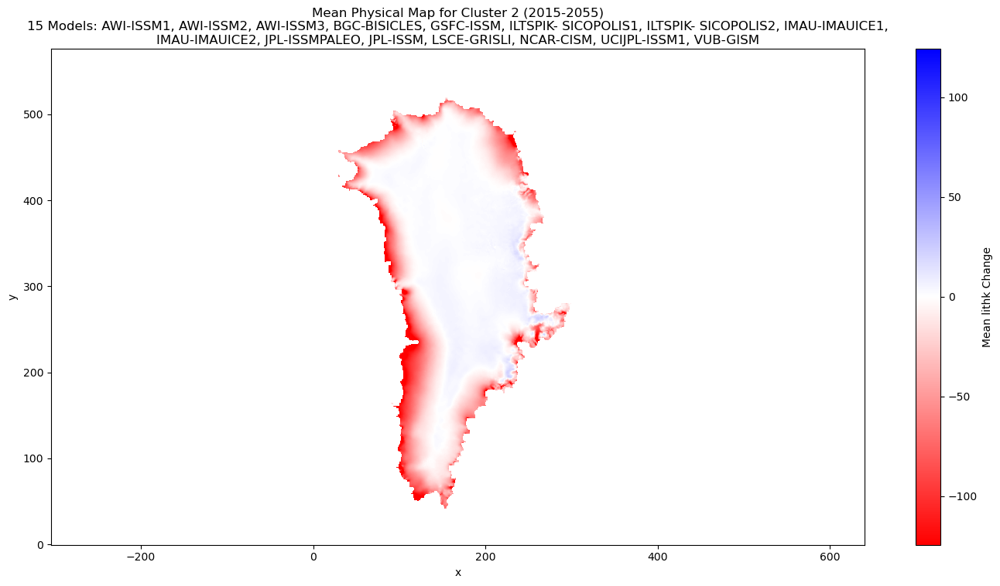

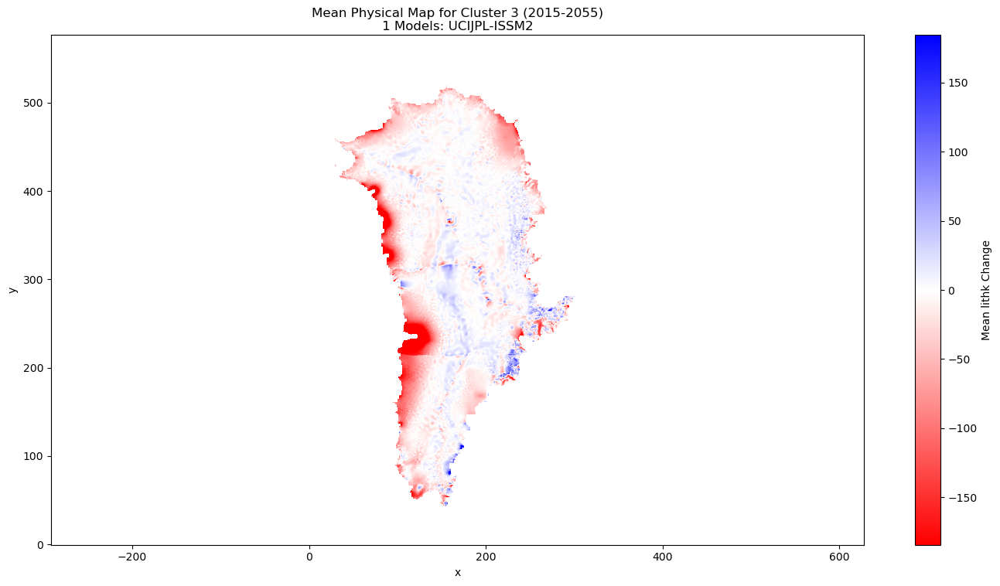

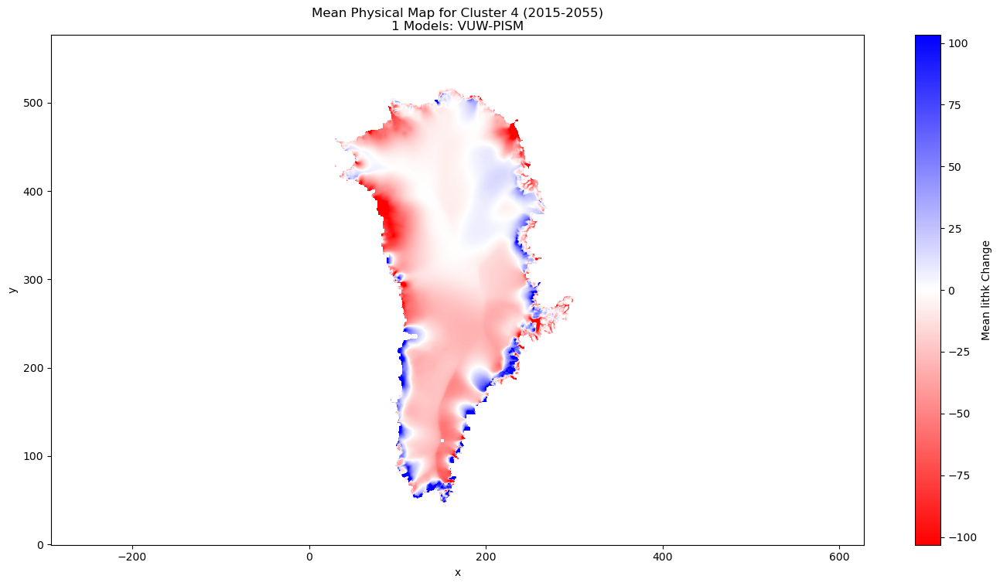


 Processing: 2015-2065...

--- Generating Cluster-Mean Physical Maps ---


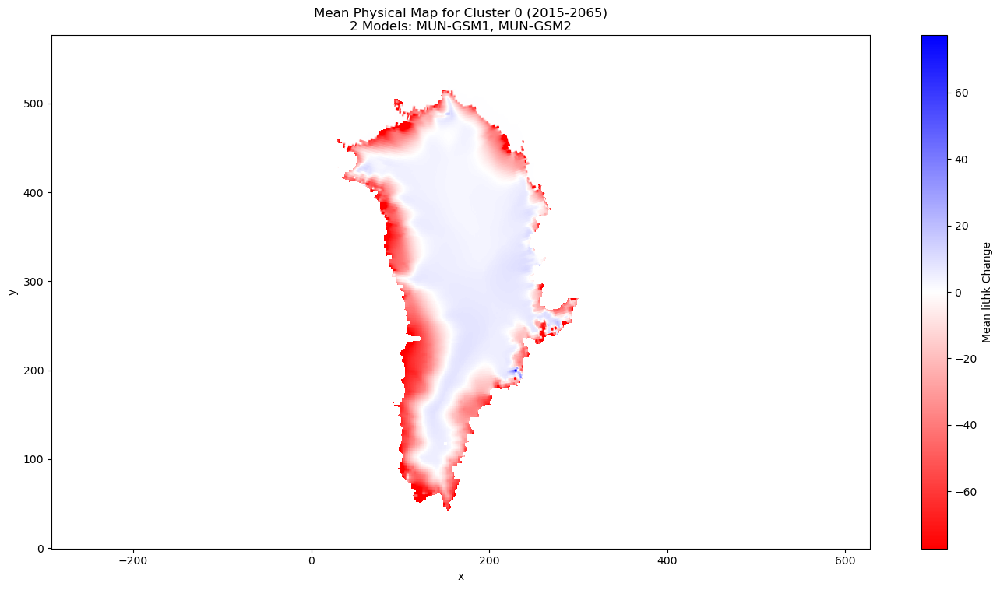

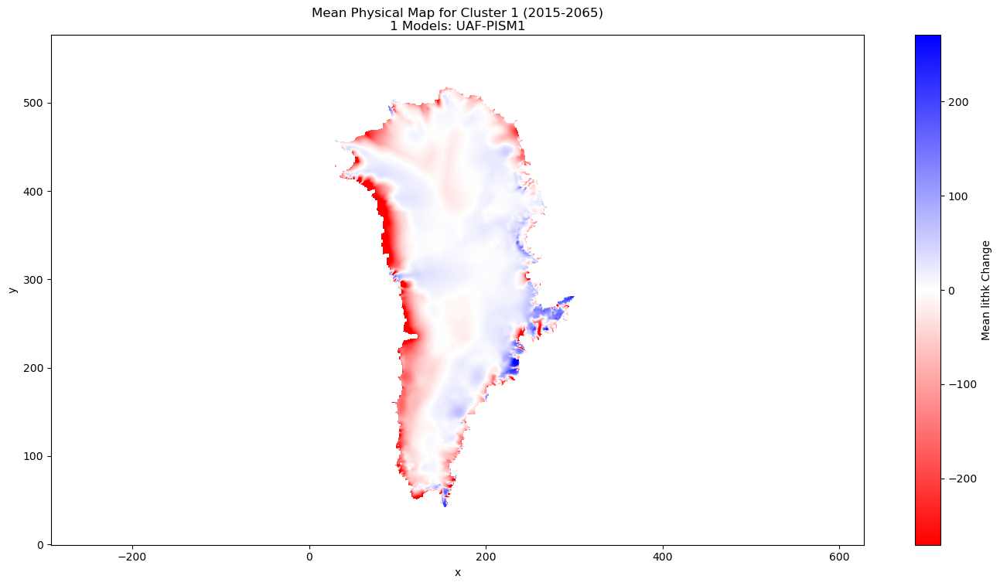

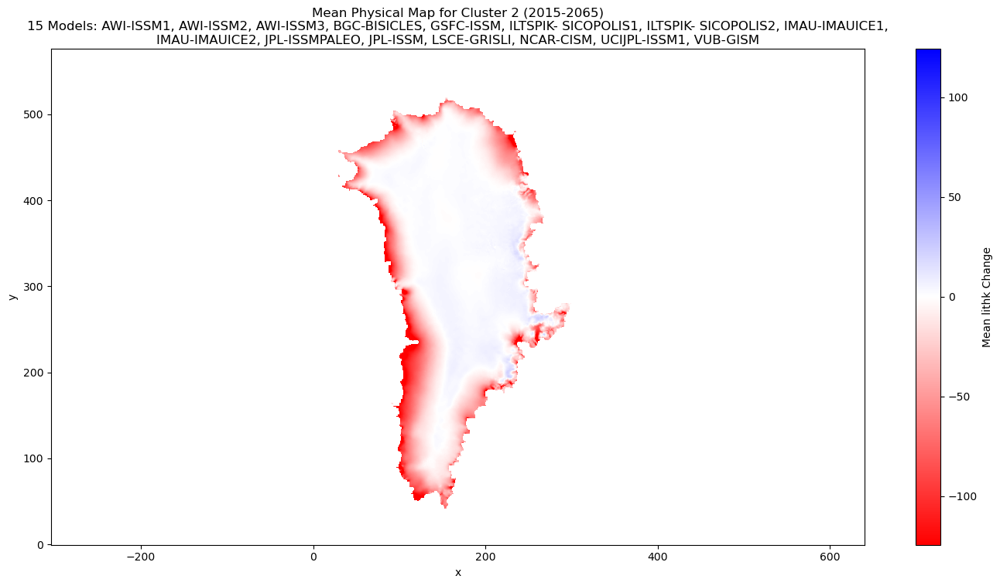

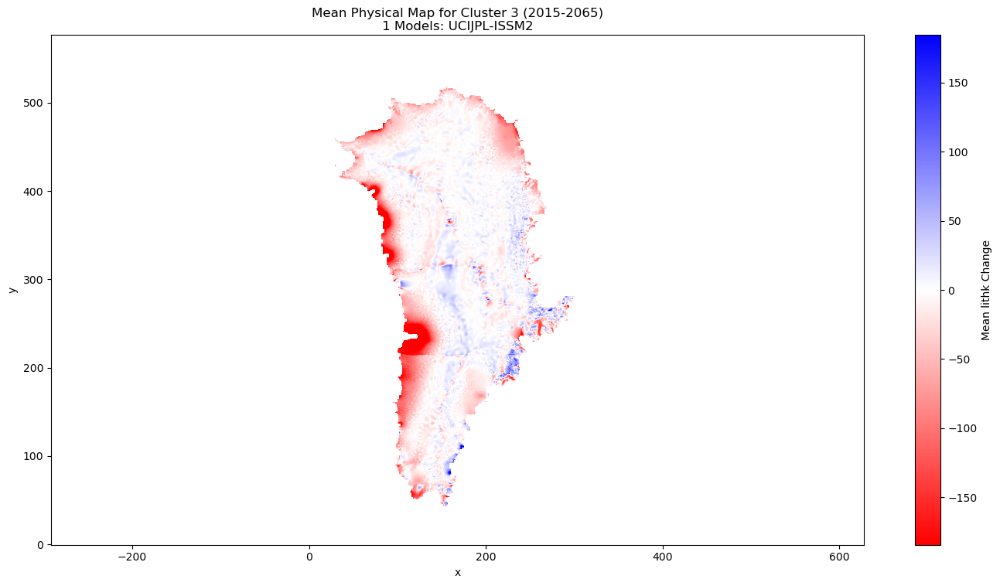

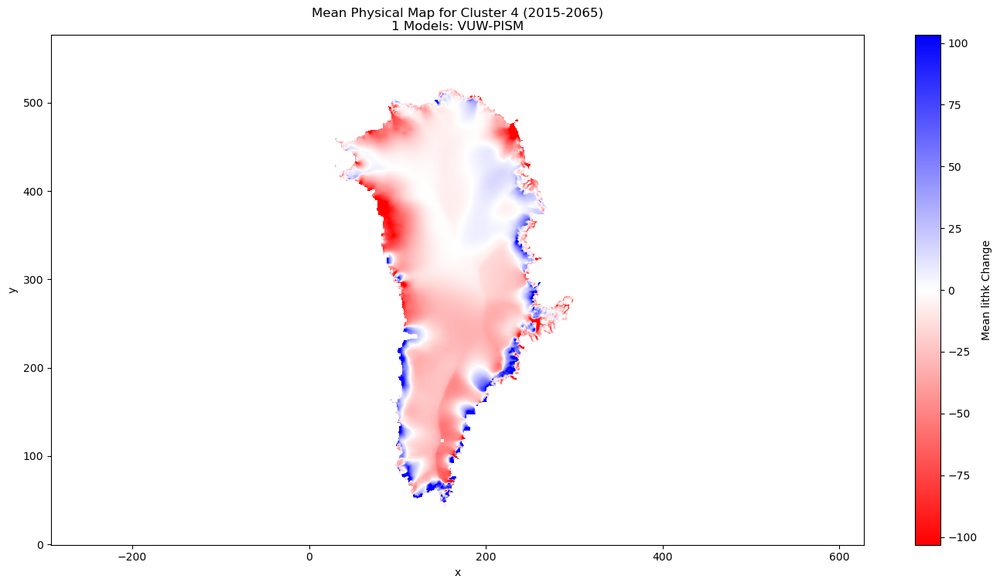


 Processing: 2015-2075...

--- Generating Cluster-Mean Physical Maps ---


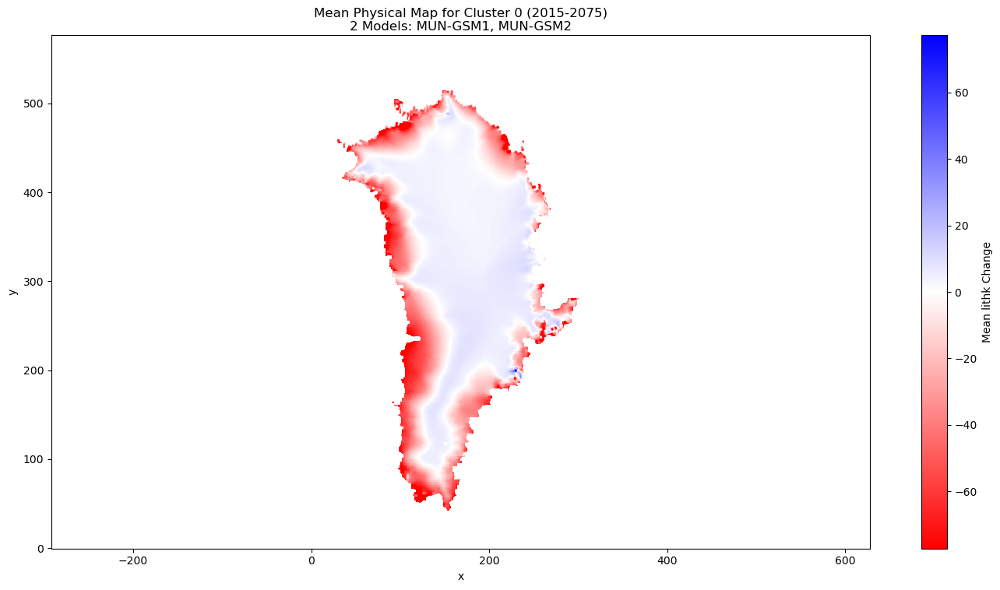

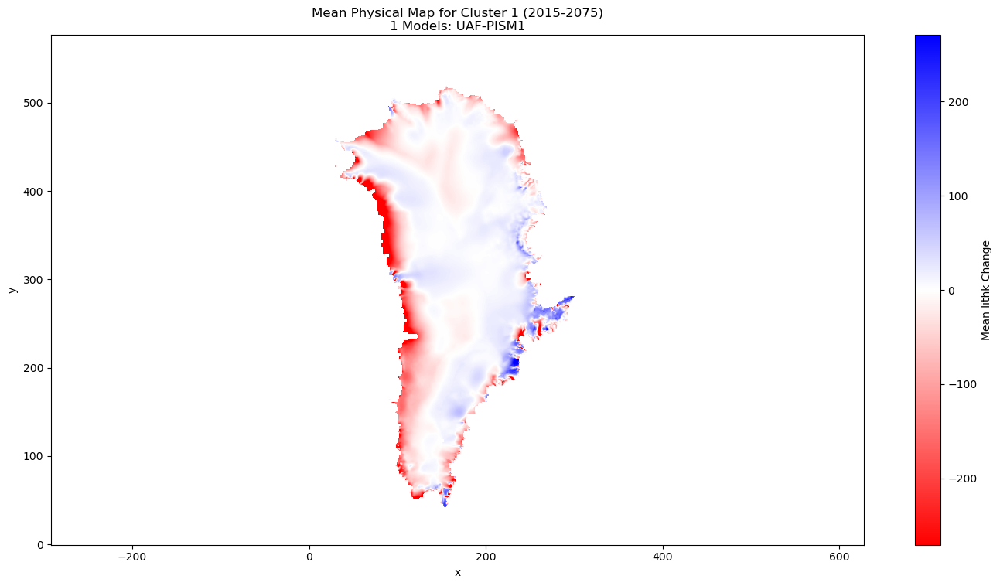

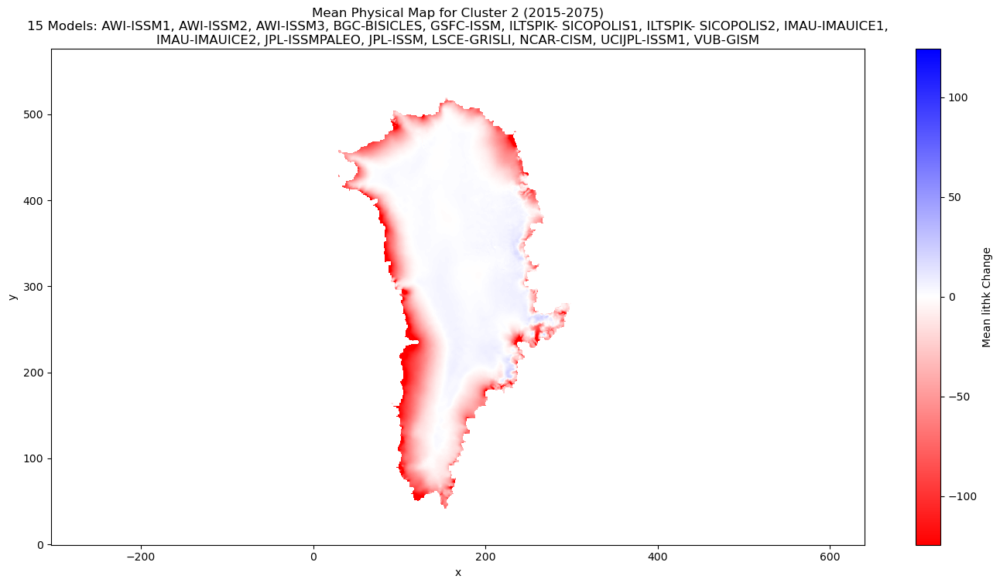

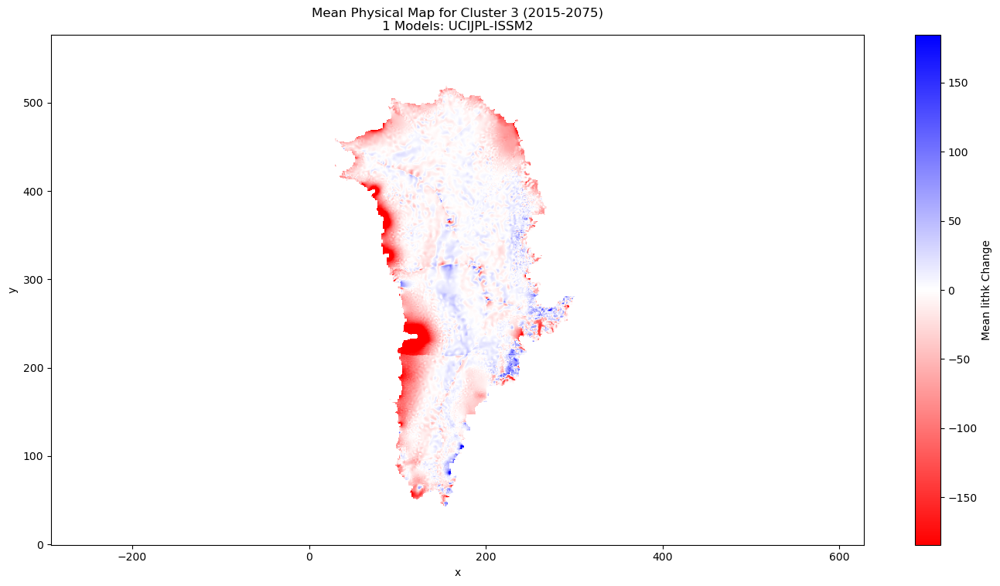

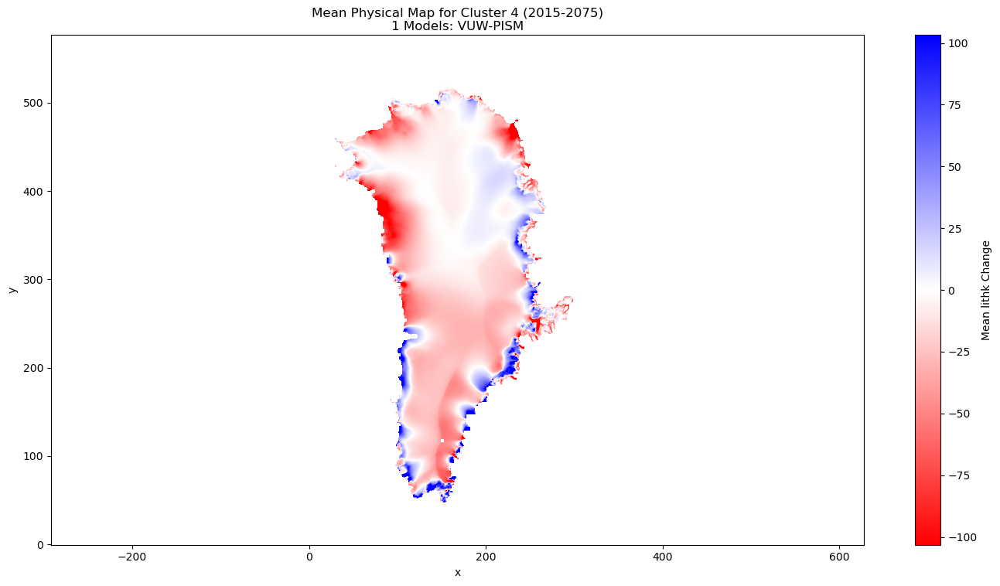


 Processing: 2015-2085...

--- Generating Cluster-Mean Physical Maps ---


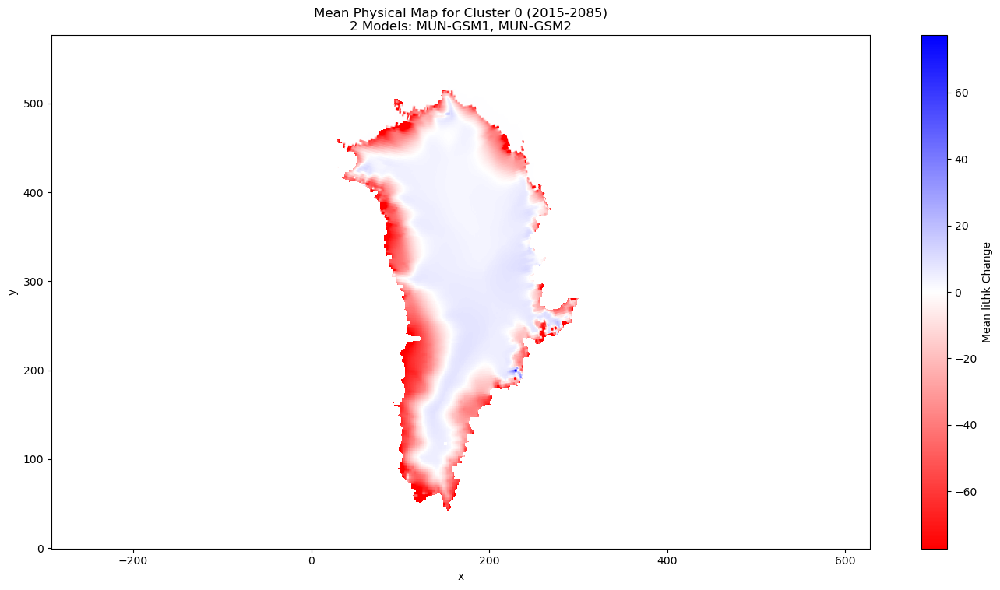

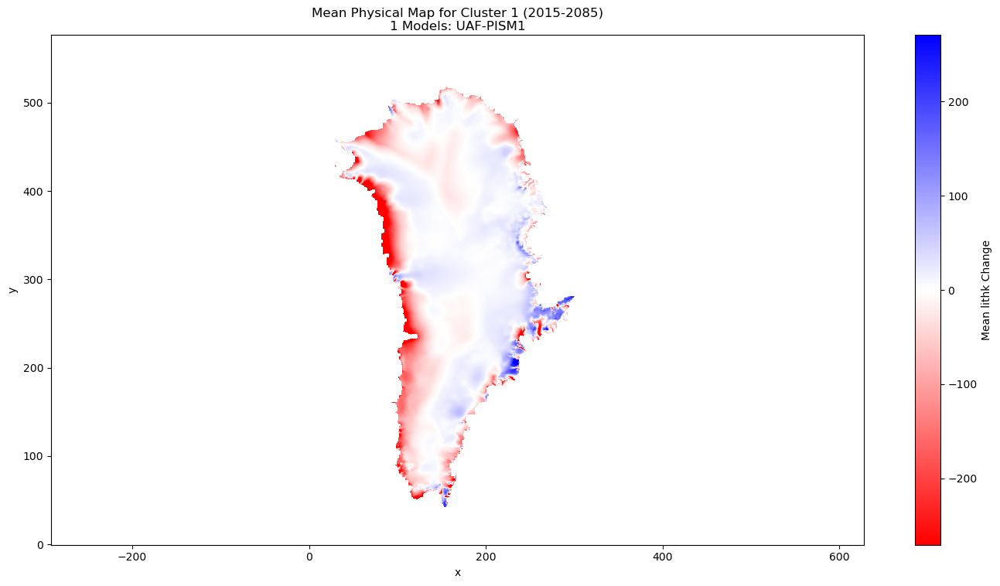

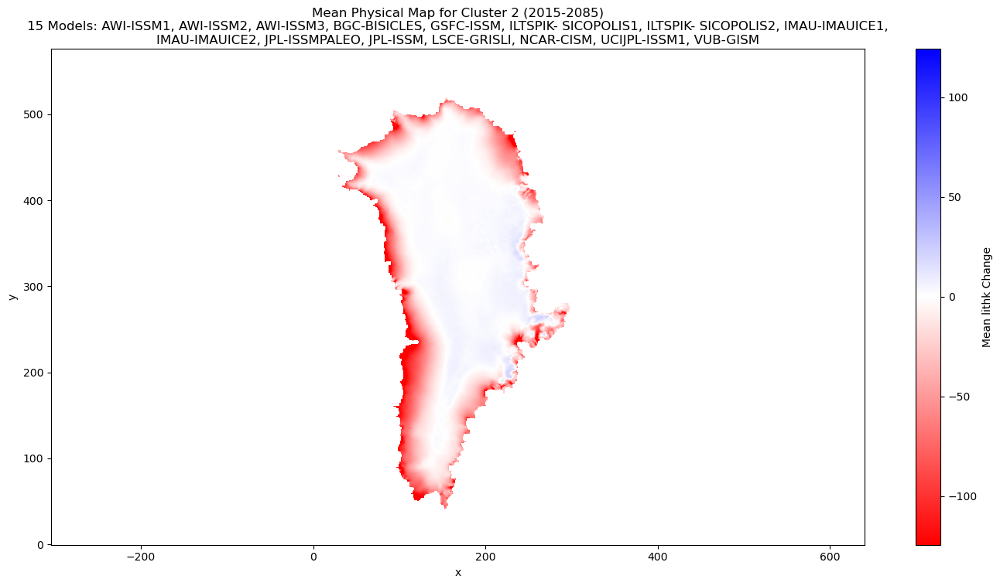

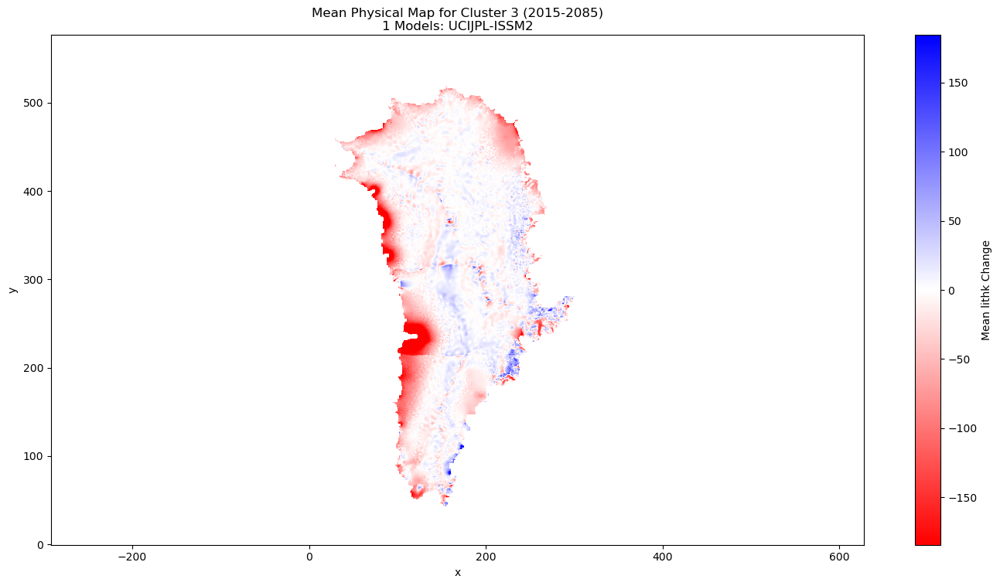

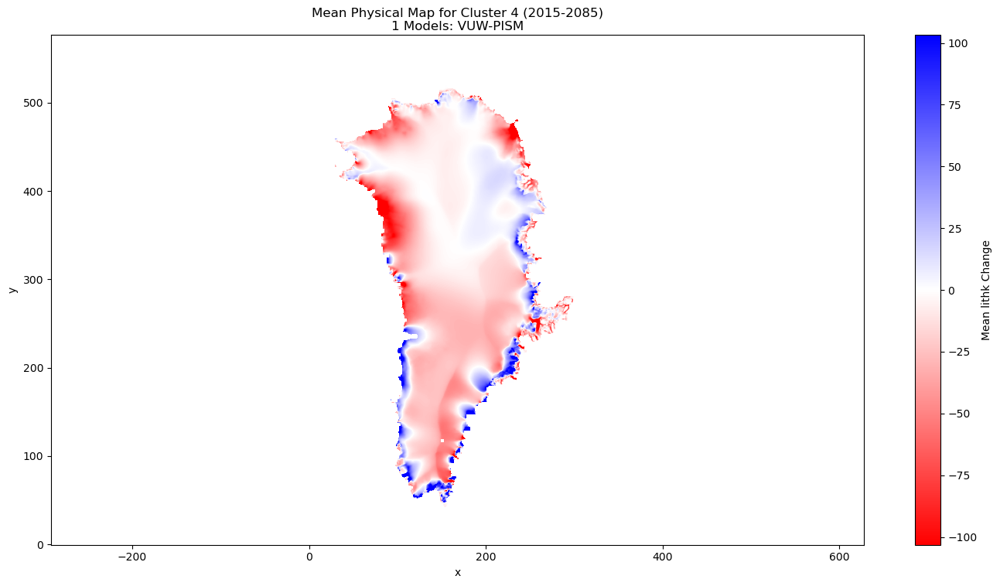


 Processing: 2015-2100...

--- Generating Cluster-Mean Physical Maps ---


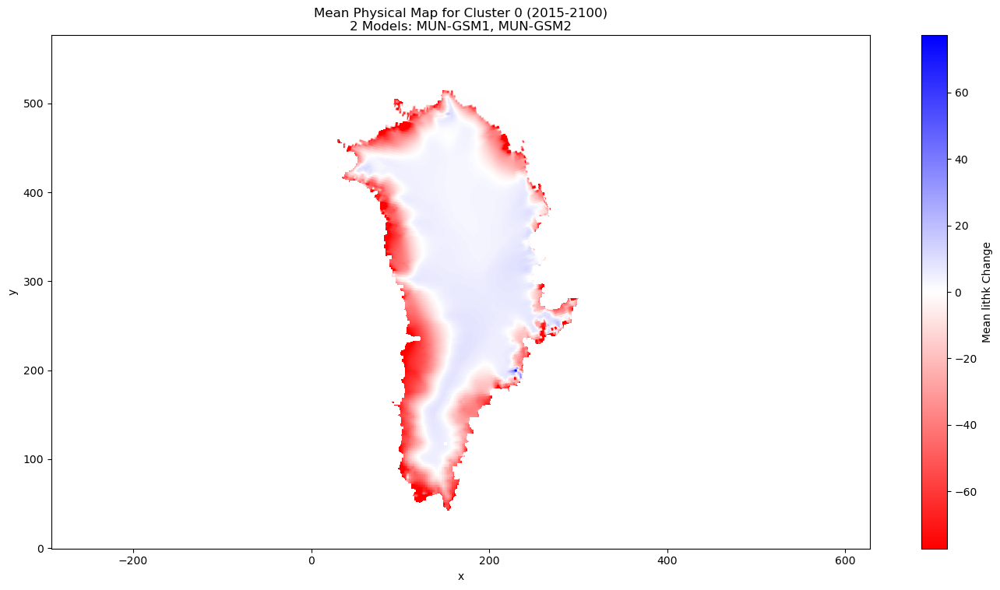

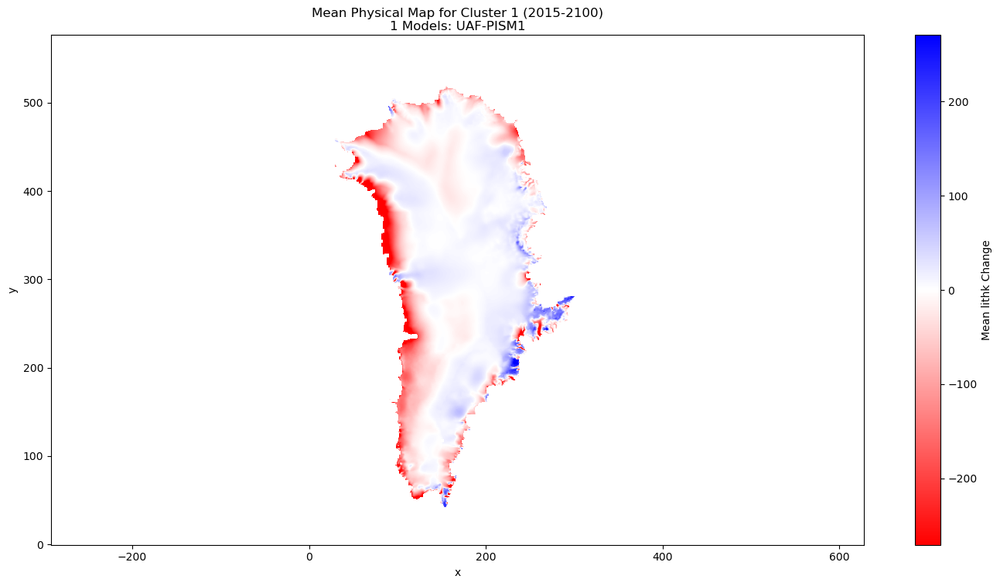

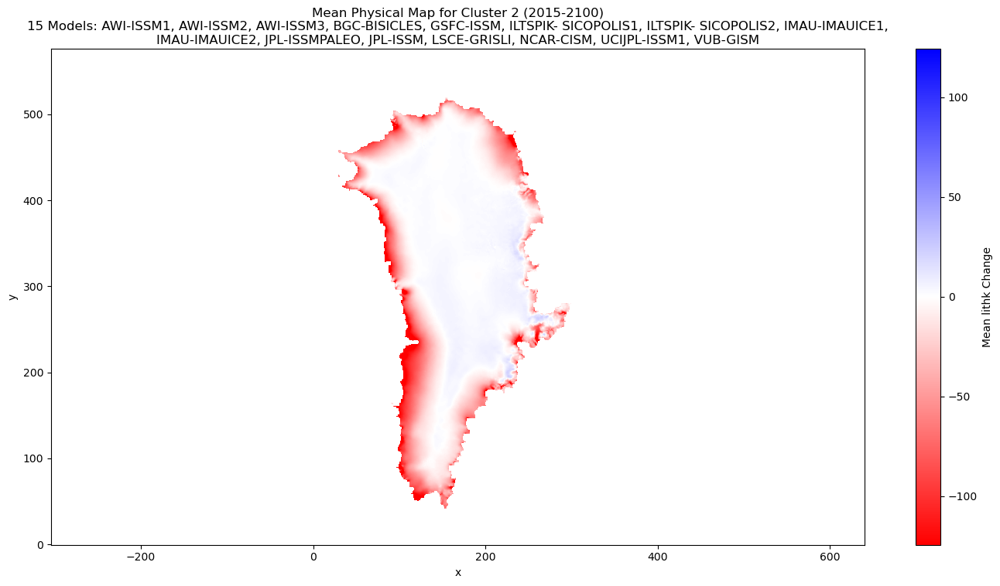

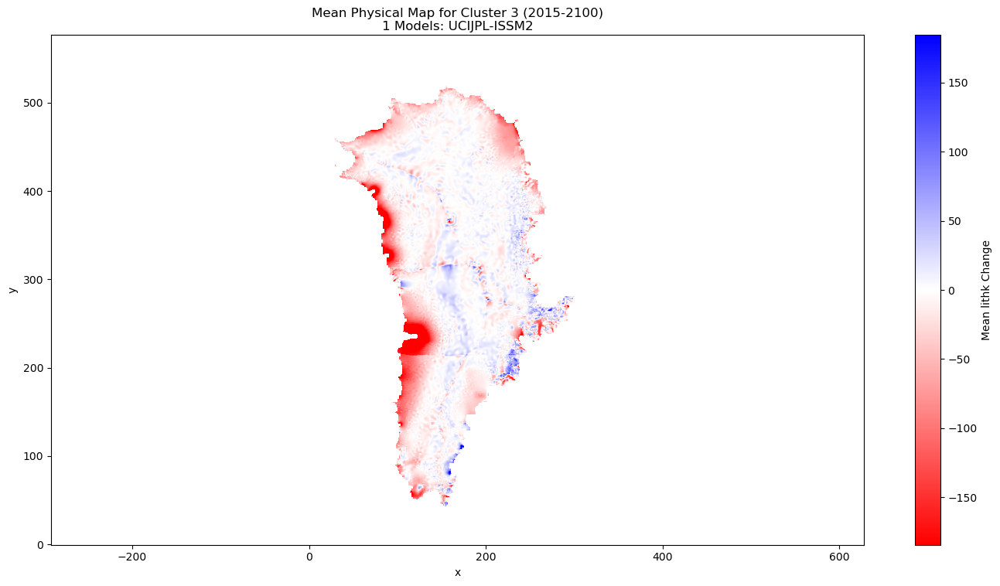

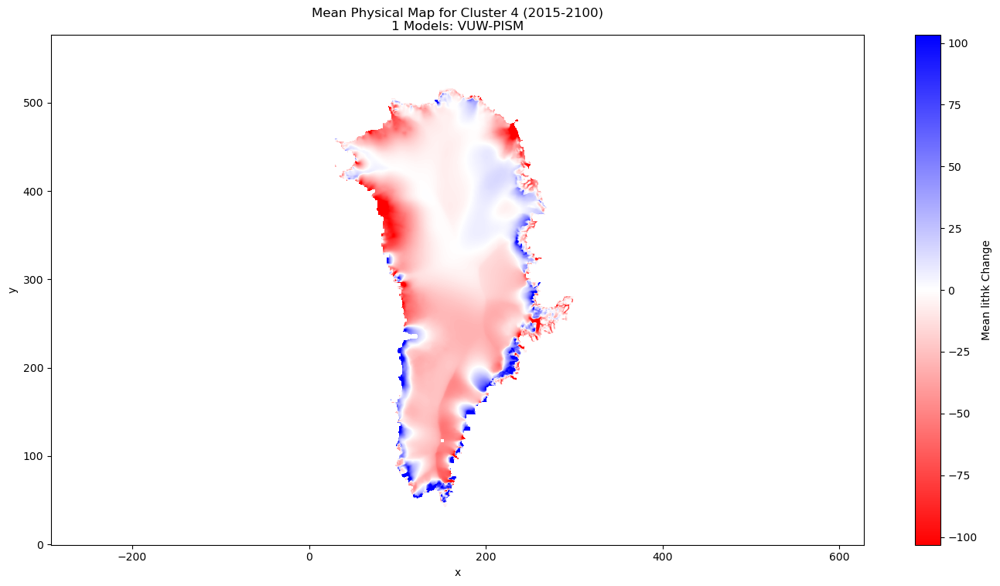

In [6]:
# Create and Plot Cluster-Mean Physical Maps
#
# This step moves from the abstract PC space back to physical reality.
# For each cluster identified by K-Means, we calculate the average
# ice thickness change map from all the models belonging to that cluster.
# This reveals the "prototypical" physical behavior for each group.

for time_window_label, (start_idx, end_idx) in time_windows.items():
    print(f"\n Processing: {time_window_label}...")
    print("\n--- Generating Cluster-Mean Physical Maps ---")

    # Loop through each unique cluster ID from 0 to n_clusters-1
    for cluster_id in range(n_clusters):
    
        # Find the indices of all models that belong to the current cluster
        # np.where returns a tuple, so we take the first element [0]
        model_indices_in_cluster = np.where(labels == cluster_id)[0]
    
        # Check if the cluster has any models in it before proceeding
        if len(model_indices_in_cluster) == 0:
            print(f"Cluster {cluster_id} has no models. Skipping.")
            continue
        
        # Get the names of the models in this cluster for the plot title
        models_in_this_cluster = [participating_models[i] for i in model_indices_in_cluster]
    
        # --- Calculate the Mean Map ---
    
        # Extract the original, flattened delta maps for these models from data_matrix
        # Each row in data_matrix corresponds to a model's flattened delta map
        cluster_delta_maps_flat = data_matrix[model_indices_in_cluster, :]
    
        # Calculate the mean across all models in the cluster (axis=0 is the model axis)
        # The result is the average flattened delta map for this cluster
        cluster_mean_flat = np.mean(cluster_delta_maps_flat, axis=0)
    
        # --- Reconstruct the Full 2D Spatial Map for Plotting ---
    
        # Create a 1D array of NaNs with the size of the full grid
        C_mean = np.full(matrix_size, np.nan)
    
        # Place the calculated mean delta values into the correct grid locations
        # 'gd' contains the indices of the valid (non-NaN) grid points
        C_mean[gd.astype(int)] = cluster_mean_flat
    
        # Reshape the 1D array back into its original 2D grid dimensions
        cluster_mean_map = C_mean.reshape((rows, cols))
    
        # --- Plot the Result ---
    
        plt.figure(figsize=(14, 8))
    
        # Dynamically determine a good color range to avoid outliers dominating the scale
        # We use the 98th percentile of the absolute values for a robust range
        vmax = np.nanpercentile(np.abs(cluster_mean_map), 98)
        if vmax == 0:  # Add a fallback for zero-variance case
            vmax = 0.01 
        
        im = plt.imshow(cluster_mean_map, cmap='bwr_r', origin='lower', vmin=-vmax, vmax=vmax)
    
        # Add a colorbar with a descriptive label
        cbar = plt.colorbar(im)
        cbar.set_label(f'Mean {var_name} Change')
    
        plt.xlabel('x')
        plt.ylabel('y')
    
        # Create a comprehensive title
        title_str = (f'Mean Physical Map for Cluster {cluster_id} ({time_window_label})\n'
                     f'{len(models_in_this_cluster)} Models: {", ".join(models_in_this_cluster)}')
        plt.title(title_str, fontsize=12, wrap=True)
    
        plt.axis('equal')
        plt.tight_layout(rect=[0, 0, 1, 0.96]) # Adjust layout to make room for long titles
    
        # --- Save the Figure ---
    
        cluster_map_filename = os.path.join(time_window_output_dir, f"{var_name}_{exp_id}_Cluster_{cluster_id}_Mean_Map_{folder_name}.png")
        plt.savefig(cluster_map_filename, bbox_inches='tight', dpi=300)
    
        plt.show()

In [ ]:
# ==============================================================================
# Cluster Mean Quantitative Reconstruction and Residual Analysis
# ==============================================================================


for time_window_label, (start_idx, end_idx) in time_windows.items():
    print(f"\n Processing: {time_window_label}...")

    # Define the output directory for the current time window
    # This is the crucial change: construct time_window_output_dir here
    current_time_window_output_dir = os.path.join(base_output_dir, time_window_label)
    os.makedirs(current_time_window_output_dir, exist_ok=True)


    print("\n--- Starting Quantitative Reconstruction and Residual Analysis ---")

    # Define the reconstruction output directory within the current time window's folder
    reconstruction_output_dir = os.path.join(current_time_window_output_dir, "reconstruction_analysis")
    os.makedirs(reconstruction_output_dir, exist_ok=True)

    # --- Reconstruct first, then inverse_transform ---

    # 1. Reconstruct the *entire scaled data matrix* from the PCA results.
    # The pca.transform() gives the scores for the original components.
    effective_scores = pca.transform(data_matrix_scaled) # Ensure data_matrix_scaled corresponds to the current time window if it varies
    reconstructed_scaled_matrix = np.dot(effective_scores, correct_pca_components)

    # 2. Use the scaler to transform the reconstructed data back to physical units.
    # This is the crucial missing step.
    reconstructed_physical_matrix = scaler.inverse_transform(reconstructed_scaled_matrix)


    # Loop through each model to create its analysis plot
    for model_idx, model_name in enumerate(participating_models):

        cluster_id = labels[model_idx]

        # --- 1. Get the Original Data (Ground Truth) ---
        original_data_flat = data_matrix[model_idx, :] # Ensure data_matrix corresponds to the current time window if it varies
        C_original = np.full(matrix_size, np.nan)
        C_original[gd.astype(int)] = original_data_flat
        original_map_2d = C_original.reshape((rows, cols))

        # --- 2. Get the Correctly Scaled Reconstructed Data ---
        reconstructed_flat = reconstructed_physical_matrix[model_idx, :]
        C_reconstructed = np.full(matrix_size, np.nan)
        C_reconstructed[gd.astype(int)] = reconstructed_flat
        reconstructed_map_2d = C_reconstructed.reshape((rows, cols))

        # --- 3. Calculate the True Residual Map ---
        residual_flat = original_data_flat - reconstructed_flat
        C_residual = np.full(matrix_size, np.nan)
        C_residual[gd.astype(int)] = residual_flat
        residual_map_2d = C_residual.reshape((rows, cols))

        # --- 4. Plot the results ---
        fig, axes = plt.subplots(1, 3, figsize=(22, 6))
        fig.suptitle(f'Reconstruction Analysis for: {model_name} (Cluster {cluster_id}) - Time: {time_window_label}', fontsize=16)

        vmax = np.nanpercentile(np.abs(original_map_2d), 99)
        if vmax == 0: vmax = 0.01

        im1 = axes[0].imshow(original_map_2d, cmap='bwr_r', origin='lower', vmin=-vmax, vmax=vmax)
        axes[0].set_title(f'A) Original Delta {var_name}')
        fig.colorbar(im1, ax=axes[0], orientation='horizontal', label='Ice Thickness Change (m)')

        im2 = axes[1].imshow(reconstructed_map_2d, cmap='bwr_r', origin='lower', vmin=-vmax, vmax=vmax)
        axes[1].set_title(f'B) Reconstructed from {n_components} PCs')
        fig.colorbar(im2, ax=axes[1], orientation='horizontal', label='Ice Thickness Change (m)')

        vmax_res = np.nanpercentile(np.abs(residual_map_2d), 99)
        if vmax_res == 0: vmax_res = 0.01
        im3 = axes[2].imshow(residual_map_2d, cmap='PRGn', origin='lower', vmin=-vmax_res, vmax=vmax_res)
        axes[2].set_title('C) Residual (Original - Reconstructed)')
        fig.colorbar(im3, ax=axes[2], orientation='horizontal', label='Residual (m)')

        for ax in axes:
            ax.set_xlabel('x-coordinate')
            ax.set_ylabel('y-coordinate')
        axes[1].set_ylabel('')
        axes[2].set_ylabel('')

        plt.tight_layout(rect=[0, 0.05, 1, 0.95])

        # Ensure folder_name is also dynamic if it's meant to reflect the time window
        # For simplicity, if folder_name is always the time_window_label, you can use that directly
        # Otherwise, make sure folder_name is also updated for each time_window_label
        folder_name_for_plot = time_window_label # Assuming folder_name should be the time_window_label

        recon_filename = os.path.join(reconstruction_output_dir, f"{var_name}_{exp_id}_{model_name}_recon_analysis_{folder_name_for_plot}.png")
        plt.savefig(recon_filename, dpi=300)
        plt.close(fig)

    print(f"\n--- Analysis complete. Plots saved in: {reconstruction_output_dir} ---")

In [ ]:
# ==============================================================================
# Cluster Mean Quantitative Reconstruction and Residual Analysis
# ==============================================================================


for time_window_label, (start_idx, end_idx) in time_windows.items():
    print(f"\n Processing: {time_window_label}...")
    print("\n--- Starting Quantitative Reconstruction and Residual Analysis (Cluster Means) ---")

    # Define the base output directory for the current time window
    # This ensures a unique parent directory for each time window
    current_time_window_base_output_dir = os.path.join(base_output_dir, time_window_label)
    os.makedirs(current_time_window_base_output_dir, exist_ok=True)

    # Define the output directory for cluster mean reconstructions within the current time window's folder
    cluster_recon_output_dir = os.path.join(current_time_window_base_output_dir, "cluster_reconstruction_analysis")
    os.makedirs(cluster_recon_output_dir, exist_ok=True)

    # Loop through each unique cluster ID
    for cluster_id in range(n_clusters):
        # Find the indices of all models that belong to the current cluster
        model_indices_in_cluster = np.where(labels == cluster_id)[0]

        # Check if the cluster has any models in it before proceeding
        if len(model_indices_in_cluster) == 0:
            print(f"Cluster {cluster_id} has no models. Skipping reconstruction analysis.")
            continue

        # Get the names of the models in this cluster for the plot title
        models_in_this_cluster = [participating_models[i] for i in model_indices_in_cluster]

        # --- 1. Get the Original Cluster Mean Data (Ground Truth for the cluster) ---
        # This is the same 'cluster_mean_flat' calculated in the first code block.
        # Ensure data_matrix is correctly sliced for the current time window if it varies
        cluster_delta_maps_flat = data_matrix[model_indices_in_cluster, :]
        cluster_mean_flat_original = np.mean(cluster_delta_maps_flat, axis=0)

        # Reshape the 1D array back into its original 2D grid dimensions for plotting
        C_cluster_mean_original = np.full(matrix_size, np.nan)
        C_cluster_mean_original[gd.astype(int)] = cluster_mean_flat_original
        cluster_mean_map_2d_original = C_cluster_mean_original.reshape((rows, cols))

        # --- 2. Reconstruct the Cluster Mean from PCA ---
        # Apply the same scaler used for the original data_matrix
        # The scaler expects a 2D array, so reshape cluster_mean_flat_original
        cluster_mean_flat_original_reshaped = cluster_mean_flat_original.reshape(1, -1)
        cluster_mean_scaled = scaler.transform(cluster_mean_flat_original_reshaped)

        # Transform the scaled cluster mean to PCA scores.
        cluster_mean_scores = pca.transform(cluster_mean_scaled)

        # Reconstruct the scaled cluster mean from its scores and components
        reconstructed_scaled_cluster_mean = np.dot(cluster_mean_scores, correct_pca_components)

        # Inverse transform the reconstructed scaled data back to physical units
        reconstructed_physical_cluster_mean = scaler.inverse_transform(reconstructed_scaled_cluster_mean)

        # Get the 1D array from the 2D array returned by inverse_transform
        reconstructed_physical_cluster_mean_flat = reconstructed_physical_cluster_mean[0, :]

        # Reshape reconstructed cluster mean to 2D for plotting
        C_cluster_mean_reconstructed = np.full(matrix_size, np.nan)
        C_cluster_mean_reconstructed[gd.astype(int)] = reconstructed_physical_cluster_mean_flat
        cluster_mean_map_2d_reconstructed = C_cluster_mean_reconstructed.reshape((rows, cols))

        # --- 3. Calculate the True Residual Map for the Cluster Mean ---
        residual_cluster_mean_flat = cluster_mean_flat_original - reconstructed_physical_cluster_mean_flat
        C_cluster_mean_residual = np.full(matrix_size, np.nan)
        C_cluster_mean_residual[gd.astype(int)] = residual_cluster_mean_flat
        cluster_mean_map_2d_residual = C_cluster_mean_residual.reshape((rows, cols))

        # --- 4. Plot the results (similar to individual model plots) ---
        fig, axes = plt.subplots(1, 3, figsize=(22, 6))
        # Updated suptitle to include number of models and model names
        title_str = (f'Reconstruction Analysis for Cluster {cluster_id} ({time_window_label})\n'
                     f'{len(models_in_this_cluster)} Models: {", ".join(models_in_this_cluster)}')
        fig.suptitle(title_str, fontsize=16, wrap=True)

        # Dynamically determine a good color range for original and reconstructed plots
        vmax = np.nanpercentile(np.abs(cluster_mean_map_2d_original), 99)
        if vmax == 0: vmax = 0.01

        im1 = axes[0].imshow(cluster_mean_map_2d_original, cmap='bwr_r', origin='lower', vmin=-vmax, vmax=vmax)
        axes[0].set_title(f'A) Original Mean Delta {var_name}')
        fig.colorbar(im1, ax=axes[0], orientation='horizontal', label='Ice Thickness Change (m)')

        im2 = axes[1].imshow(cluster_mean_map_2d_reconstructed, cmap='bwr_r', origin='lower', vmin=-vmax, vmax=vmax)
        axes[1].set_title(f'B) Reconstructed from {n_components} PCs')
        fig.colorbar(im2, ax=axes[1], orientation='horizontal', label='Ice Thickness Change (m)')

        # Dynamically determine a good color range for the residual plot
        vmax_res = np.nanpercentile(np.abs(cluster_mean_map_2d_residual), 99)
        if vmax_res == 0: vmax_res = 0.01
        im3 = axes[2].imshow(cluster_mean_map_2d_residual, cmap='PRGn', origin='lower', vmin=-vmax_res, vmax=vmax_res)
        axes[2].set_title('C) Residual (Original - Reconstructed)')
        fig.colorbar(im3, ax=axes[2], orientation='horizontal', label='Residual (m)')

        # Set common labels for x and y axes, and clear redundant y-labels
        for ax in axes:
            ax.set_xlabel('x-coordinate')
            ax.set_ylabel('y-coordinate')
        axes[1].set_ylabel('') # Remove y-label for the middle plot
        axes[2].set_ylabel('') # Remove y-label for the right plot

        plt.tight_layout(rect=[0, 0.05, 1, 0.95]) # Adjust layout to make room for suptitle

        # Ensure folder_name is also dynamic if it's meant to reflect the time window
        # For simplicity, if folder_name is always the time_window_label, you can use that directly
        folder_name_for_plot = time_window_label # Assuming folder_name should be the time_window_label

        # Save the figure
        cluster_recon_filename = os.path.join(cluster_recon_output_dir, f"{var_name}_{exp_id}_Cluster_{cluster_id}_Recon_Analysis_{folder_name_for_plot}.png")
        plt.savefig(cluster_recon_filename, dpi=300)
        plt.close(fig) # Close the figure to free up memory

    print(f"\n--- Cluster-Mean Reconstruction Analysis complete. Plots saved in: {cluster_recon_output_dir} ---")